<a href="https://colab.research.google.com/github/johcue/NLP_Classification/blob/main/main_clasificacion_textos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importamos Librerias

In [ ]:
!pip install emoji
import emoji

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 431.4/431.4 kB 5.6 MB/s eta 0:00:00


In [ ]:
!pip install nlpaug
import nlpaug.augmenter.word as naw

In [ ]:
!pip install lbl2vec
from lbl2vec import Lbl2Vec

In [ ]:
import time
import random
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from ipywidgets import  interact
from collections import Counter


#NLTK y RE
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.collocations import BigramCollocationFinder, BigramAssocMeasures
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.probability import FreqDist
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

#GENSIM
import gensim
from gensim import corpora
from gensim.models import CoherenceModel
from gensim.corpora.dictionary import Dictionary
from gensim.matutils import Sparse2Corpus
from gensim.models import Doc2Vec

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
#SKLEARN
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, TfidfTransformer, HashingVectorizer
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, MeanShift, SpectralClustering
from sklearn.decomposition import TruncatedSVD

from sklearn.model_selection import train_test_split, cross_validate, KFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression, LinearRegression, RidgeClassifier
from sklearn.svm import LinearSVC
from sklearn.metrics import (accuracy_score, mean_absolute_error, mean_squared_error,
                             classification_report, confusion_matrix, ConfusionMatrixDisplay,
                             homogeneity_score, completeness_score, v_measure_score,
                             adjusted_rand_score, rand_score, silhouette_score,
                             precision_recall_fscore_support)
from sklearn.manifold import TSNE
from sklearn.decomposition import LatentDirichletAllocation

# CORPUS

A continuacion se presentan tres corpus:

* `df_spam`

 Se trata de un conjunto de datos, compuesto por 83.448 mensajes de texto, está equilibrado entre spam (52.73%) y no spam (47.27%), lo que lo convierte en una herramienta valiosa para entrenar modelos de clasificación de spam y realizar investigaciones en el campo del análisis de texto.

* `df_sexista`

 Este conjunto de datos se tomo del paper [The 'Call me sexist but' Dataset (CMSB)](https://search.gesis.org/research_data/SDN-10.7802-2251). El corpus contiene 13.631 tweets recopilados entre 2008 y 2019. Cada post esta etiquetado como `“True”` o `“False”` en la columna `“sexism”` con una distribución desequilibrada de tweets sexistas y no sexistas (13.35% vs 86.65%).

* `df_odio`

 Se tomó de [huggingface](https://huggingface.co/datasets/odegiber/hate_speech18). Estos archivos contienen texto extraído de Stormfront, un foro de supremacía blanca. Se realizó un muestreo aleatorio de publicaciones de varios subforos, dividiendo el texto en oraciones. Estas oraciones fueron etiquetadas manualmente para indicar si contenían discurso de odio o no, siguiendo ciertas pautas de anotación. Este conjunto de datos presenta una distribución desequilibrada de etiquetas, con una gran mayoría de oraciones sin discurso de odio (aprox 87%) y una minoría con discurso de odio (aprox 13%).

In [ ]:
#Funciones para preprocesamiento
# Función para mantener solo caracteres alfabéticos y emojis
def remove_non_alphabetic(text):
    return ''.join([char for char in text if char.isalpha() or char.isspace() or emoji.is_emoji(char)])

# Algoritmo de preprocesamiento
def preprocess_text(df):

    stop_words = set(stopwords.words('english'))

    # Convertir los textos a minúsculas
    df["text"] = df["text"].str.lower()

    # Eliminar caracteres no alfabéticos, manteniendo emojis
    df["text"] = df["text"].apply(remove_non_alphabetic)

    # Eliminar stop-words
    df["text"] = df["text"].apply(lambda x: ' '.join([word for word in x.split() if word not in stop_words]))

    return df

# Aplicar el preprocesamiento al DataFrame
df = preprocess_text(df)

# Inicializar Stemmer y Lemmatizer
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

# Función para hacer stemming y lematización
def stem_and_lemmatize(text):
    tokens = nltk.word_tokenize(text)
    stemmed = [stemmer.stem(token) for token in tokens]
    lemmatized = [lemmatizer.lemmatize(token) for token in stemmed]
    return ' '.join(lemmatized)

# Aplicar stemming y lematización al DataFrame
df["text"] = df["text"].apply(stem_and_lemmatize)

## Para dataset SPAM

Nuestro primer corpus es uno clasico. Se trata de un conjunto de datos, compuesto por 83.448 mensajes de texto, está equilibrado entre spam (52.73%) y no spam (47.27%), lo que lo convierte en una herramienta valiosa para entrenar modelos de clasificación de spam y realizar investigaciones en el campo del análisis de texto.

In [ ]:
df_spam = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/spam.csv")
df_spam = df_spam.iloc[:,[1,0]] #Reorganizamos las columnas
df_spam.head()

,text,label
0,ounce feather bowl hummingbird opec moment ala...,1
1,wulvob get your medircations online qnb ikud v...,1
2,computer connection from cnn com wednesday es...,0
3,university degree obtain a prosperous future m...,1
4,thanks for all your answers guys i know i shou...,0


Verificamos sí hay datos *null*

In [ ]:
df_spam.isnull().sum()

text     0
label    0
dtype: int64

In [ ]:
numeros = [4373, 6696, 9311, 9798, 10213, 18898, 20331, 20697, 24073, 24303, 25120, 32264, 35022, 35448, 38153, 44872, 45784, 52478, 52715, 57039, 57326, 58386, 58711, 66711, 67466, 69828, 70896, 73922, 76612, 81133, 82316]
# Obtener los índices de las filas que contienen los números de la lista
df_spam.iloc[numeros]

,text,label
4373,503 - 464 - 7553,0
6696,970 - 240 - 6206,0
9311,ðï  à ¡ ±,1
9798,here,1
10213,but,1
18898,_ _ _ _ _\n| _ \ _ _ _ | | _ _ _ _ _ _ _\n| | ...,1
20331,.\n,1
20697,! ??????\n???? ????? ?? ??? ??????\n! ????? ??...,1
24073,èõ×óô½à´ô½»ðã±áë¡£îòãç¾¿¾¹êççéèë£¬»¹êç°®èë£¬õâ...,1
24303,our,1


In [ ]:
df_spam.shape

(83448, 2)

Recopilaoms informacion del corpus

In [ ]:
df_spam.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83448 entries, 0 to 83447
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    83448 non-null  object
 1   label   83448 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 1.3+ MB


Ver el resumen estadístico de las variables numéricas que en nuestro caso es `label`

In [ ]:
df_spam.describe()

,label
count,83448.000000
mean,0.526196
std,0.499316
min,0.000000
25%,0.000000
50%,1.000000
75%,1.000000
max,1.000000


Cuantas etiquetas hay segun el tipo

In [ ]:
df_spam['label'].value_counts()

label
1    43910
0    39538
Name: count, dtype: int64

In [ ]:
df_spam['label'].unique()

array([1, 0])

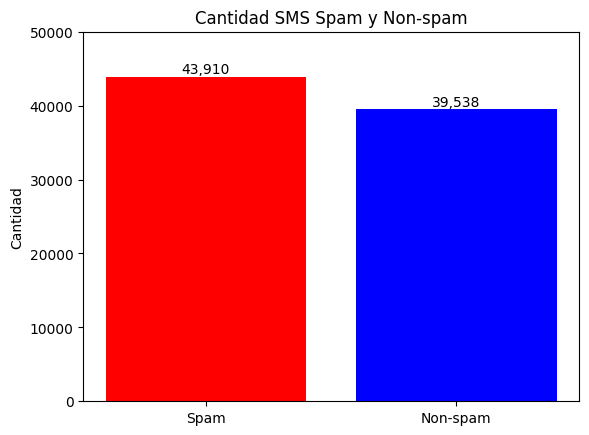

In [ ]:
fig, ax = plt.subplots()
categories = ['Spam', 'Non-spam']
bar_container = ax.bar(categories, df_spam['label'].value_counts(), color=['red', 'blue'])
ax.set(ylabel='Cantidad', title='Cantidad SMS Spam y Non-spam', ylim=(0, 50000))
ax.bar_label(bar_container, fmt='{:,.0f}');

### Preprocesamiento de Datos

En el preprocesamiento de textos de SPAM, la eliminación de textos no alfabéticos y stop words no siempre es necesaria, ya que algunos mensajes no deseados pueden contener información relevante para la clasificación como emojis, símbolos o caracteres especiales. Eliminar estos elementos podría conducir a una pérdida de información crucial para la identificación precisa del spam.

Por otro lado, las stop words pueden aportar contexto al mensaje pues este mismo podría contener solo una palabra y esta ser una stop word.

Observemos cuantos mensajes continen solo stopwords

In [ ]:
df_spam["text"]= df_spam["text"].str.lower() #Convertir los textos a minusculas
stop_words = set(stopwords.words('english')) #Eliminar las stop-words
df_spam["text"] = df_spam["text"].apply(lambda x: ' '.join([word for word in x.split() if word not in stop_words]))

In [ ]:
#["text"] == stopwords and char
idx_stopwords_chars = [4373, 6696, 9311, 9798, 10213, 18898, 20331, 20697, 24073, 24303, 25120, 32264, 35022, 35448, 38153, 44872, 45784, 52478, 52715, 57039, 57326, 58386, 58711, 66711, 67466, 69828, 70896, 73922, 76612, 81133, 82316]

#["text"] == stopwords
idx_stopwords = [76612, 81133, 82316, 66711, 10213, 9798]

df_spam.iloc[idx_stopwords_chars]

df_spam["label"].iloc[idx_stopwords_chars].value_counts()

Sí se aplica la normalizacion con eliminacion de stopwords, se estarían perdiendo 6 SMS con solo etiqueta SPAM de 43910, es decir el 0.013687%. Como no es un porcentaje mayor, se procede a eliminar stop words con el fin de reducir la dimensionalidad del corpus y mejorar el rendimiento computacional del modelo de clasificación.

In [ ]:
# Aplicar el preprocesamiento al DataFrame
df_spam = preprocess_text(df_spam)
df_spam.head()

,text,label
0,ounce feather bowl hummingbird opec moment ala...,1
1,wulvob get medircations online qnb ikud viagra...,1
2,computer connection cnn com wednesday escapenu...,0
3,university degree obtain prosperous future mon...,1
4,thanks answers guys know checked rsync manual ...,0


In [ ]:
# SPAM
df_spam['Lematizado_Stemming'] = df_spam['text'].apply(stem_and_lemmatize)
df_spam.head()

,text,label,Lematizado_Stemming
0,ounce feather bowl hummingbird opec moment ala...,1,ounc feather bowl hummingbird opec moment alab...
1,wulvob get medircations online qnb ikud viagra...,1,wulvob get medirc onlin qnb ikud viagra escape...
2,computer connection cnn com wednesday escapenu...,0,comput connect cnn com wednesday escapenumb ma...
3,university degree obtain prosperous future mon...,1,univers degre obtain prosper futur money earn ...
4,thanks answers guys know checked rsync manual ...,0,thank answer guy know check rsync manual would...


In [ ]:
df_spam.to_csv("df_spam.csv", index = False, encoding="utf-8")
df_spam = pd.read_csv("/content/df_spam.csv")
df_spam.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

## Para dataset Sexism

Este conjunto de datos se tomo del paper [The 'Call me sexist but' Dataset (CMSB)](https://search.gesis.org/research_data/SDN-10.7802-2251). El corpus contiene 13.631 tweets recopilados entre 2008 y 2019. Cada post esta etiquetado como `“True”` o `“False”` en la columna `“sexism”` con una distribución desequilibrada de tweets sexistas y no sexistas (13.35% vs 86.65%).

En este corpous se eliminan estas columnas debido a que no son necesarias para el análisis posterior. Sin embargo, estas columnas podrian ser utilizadas en un proximo estudio. Además, se reemplazan los valores booleanos en la columna `“sexism”` por 1 (`“True”`) y 0 (`“False”`).

In [ ]:
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/sexism_data.csv")
df_sexista = df_sexista.drop(columns=["toxicity","id", "dataset", "of_id"]) #no son nenecsarias
df_sexista["sexist"].replace({True:1, False:0},inplace=True)#reemplazamos 1 = True, 0=false
df_sexista.head()

,text,sexist
0,MENTION3481 i didn't even know random was an o...,0
1,Bottom two should've gone! #mkr,0
2,MENTION3111 MENTION3424 ladyboner deserves so ...,0
3,She shall now be known as Sourpuss #MKR #KatAn...,0
4,Tarah W threw a bunch of women under the bus s...,0


In [ ]:
numeros = [200, 284, 946, 1025, 1146, 1361, 1841, 2917, 3052, 3286, 3582, 3605, 3797, 3954, 3966, 4598, 4689, 4937, 5285, 5470, 5716, 5825, 6495, 6651, 6714, 6743, 6908, 7075, 7116, 7220, 7366, 7828, 7923, 8014, 8023, 8030, 8058, 8648, 8930, 9549, 10549, 10600, 10690, 10824, 10826, 11081, 11219, 11308, 11586, 11779, 12247, 12732, 12755, 13148, 13496]
# Obtener los índices de las filas que contienen los números de la lista
df_sexista.iloc[numeros]

,text,sexist
200,MENTION4038 no :(,0
284,MENTION4375 ME TOO,0
946,MENTION810 ❤️❤️,0
1025,MENTION4685 Why...?,0
1146,MENTION2721 ?,0
1361,MENTION237 MENTION512 How so?,0
1841,MENTION573 ❤️,0
2917,MENTION2969 😳,0
3052,MENTION2461 ❤️❤️❤️❤️,0
3286,I ❤️ MENTION1802,0


In [ ]:
df_spam.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

In [ ]:
df_sexista.shape

(13631, 2)

In [ ]:
df_sexista.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13631 entries, 0 to 13630
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    13631 non-null  object
 1   sexist  13631 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 213.1+ KB


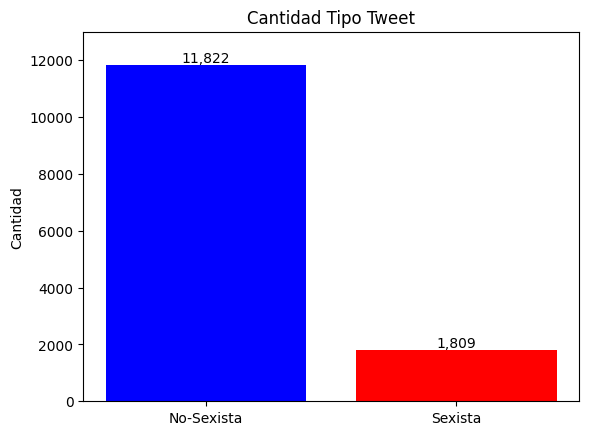

In [ ]:
fig, ax = plt.subplots()
categories = ['No-Sexista', 'Sexista']
bar_container = ax.bar(categories, df_sexista['sexist'].value_counts(), color=['blue', 'red'])
ax.set(ylabel='Cantidad', title='Cantidad Tipo Tweet', ylim=(0, 13000))
ax.bar_label(bar_container, fmt='{:,.0f}');

### Preprocesamiento de Datos

In [ ]:
# Aplicar el preprocesamiento al DataFrame
df_sexista = preprocess_text(df_sexista)
df_sexista.head()

,text,sexist
0,mention didnt even know random option,0
1,bottom two shouldve gone mkr,0
2,mention mention ladyboner deserves much credit...,0
3,shall known sourpuss mkr katandre failedfoodies,0
4,tarah w threw bunch women bus could get wadhwa...,0


In [ ]:
numeros = [200, 284, 946, 1025, 1146, 1361, 1841, 2917, 3052, 3286, 3582, 3605, 3797, 3954, 3966, 4598, 4689, 4937, 5285, 5470, 5716, 5825, 6495, 6651, 6714, 6743, 6908, 7075, 7116, 7220, 7366, 7828, 7923, 8014, 8023, 8030, 8058, 8648, 8930, 9549, 10549, 10600, 10690, 10824, 10826, 11081, 11219, 11308, 11586, 11779, 12247, 12732, 12755, 13148, 13496]
# Obtener los índices de las filas que contienen los números de la lista
df_sexista.iloc[numeros]

,text,sexist
200,mention,0
284,mention,0
946,mention ❤❤,0
1025,mention,0
1146,mention,0
1361,mention mention,0
1841,mention ❤,0
2917,mention 😳,0
3052,mention ❤❤❤❤,0
3286,❤ mention,0


Vemos que la palabra mention que hace referencia un @ en twitter (X) para indicar nombres de usuario en los posts. Sí se quisiera eliminar se tendría que añadir al grupo de stop words.



```
newStopWords = ['stopWord1','stopWord2']
stop_words.extend(newStopWords)
stop_words.append("mention")
```



In [ ]:
stop_words1 = nltk.corpus.stopwords.words('english') #Eliminar las stop-words
stop_words1.append("mention")
df_sexista["text"] = df_sexista["text"].apply(lambda x: ' '.join([word for word in x.split() if word not in stop_words1]))
df_sexista.head()

,text,sexist
0,didnt even know random option,0
1,bottom two shouldve gone mkr,0
2,ladyboner deserves much credit dudeboner boner...,0
3,shall known sourpuss mkr katandre failedfoodies,0
4,tarah w threw bunch women bus could get wadhwa...,0


In [ ]:
#hacer stemming y lematización
df_sexista['Lematizado_Stemming'] = df_sexista['text'].apply(stem_and_lemmatize)
df_sexista.isnull().sum()

text                   0
sexist                 0
Lematizado_Stemming    0
dtype: int64

In [ ]:
df_sexista.to_csv("df_sexista.csv", index = False, encoding="utf-8")
df_sexista = pd.read_csv("/content/df_sexista.csv")
df_sexista.isnull().sum()

## Para dataset Odio

La base de datos de Odio esta compuesta por diccionarios de archivos tipo JSON:

```
{'text': 'As of March 13th , 2014 , the booklet had been downloaded over 18,300 times and counting .',
 'user_id': 572066,
 'subforum_id': 1346,
 'num_contexts': 0,
 'label': 0}
```
**Descripción diccionario**
- `text`:
- `user_id`:
- `num_contexts`:
- `label`: Este corpus se encuentra organizado mediante el siguiente sistema de etiquetas o `labels`:

 * 0 (Sin Discurso de Odio): Se incluyen publicaciones que no expresan odio o discriminación hacia ningún grupo o individuo de forma explícita.

 * 1 (Discurso de Odio): Abarca publicaciones que contienen lenguaje discriminatorio, incitación a la violencia o promoción de ideas supremacistas de manera evidente.

 * 2 (No en Inglés): Agrupa publicaciones redactadas en idiomas distintos al inglés, requiriendo traducción para su análisis.

 * 3 (Relación): Engloba publicaciones que, de forma individual, no manifiestan discurso de odio, pero al combinarse con otras publicaciones dentro del mismo hilo o contexto, sí lo expresan.

In [ ]:
! pip install datasets transformers

In [ ]:
from datasets import load_dataset
dataset_odio = load_dataset("hate_speech18", split ="train")

In [ ]:
print(dataset_odio)

Dataset({
    features: ['text', 'user_id', 'subforum_id', 'num_contexts', 'label'],
    num_rows: 10944
})


In [ ]:
dataset_odio[0]

{'text': 'As of March 13th , 2014 , the booklet had been downloaded over 18,300 times and counting .',
 'user_id': 572066,
 'subforum_id': 1346,
 'num_contexts': 0,
 'label': 0}

In [ ]:
text = [d.get("text") for d in dataset_odio]
text[0]

'As of March 13th , 2014 , the booklet had been downloaded over 18,300 times and counting .'

In [ ]:
def dataset_to_dataframe(dataset):
    # Inicializar listas para cada feature
    text_list = []
    user_id_list = []
    subforum_id_list = []
    num_contexts_list = []
    label_list = []

    # Extraer valores de cada feature del dataset
    for data_val in dataset:
        text_list.append(data_val.get('text', None))
        user_id_list.append(data_val.get('user_id', None))
        subforum_id_list.append(data_val.get('subforum_id', None))
        num_contexts_list.append(data_val.get('num_contexts', None))
        label_list.append(data_val.get('label', None))

    # Crear DataFrame a partir de las listas de features
    df = pd.DataFrame({
        'text': text_list,
        'user_id': user_id_list,
        'subforum_id': subforum_id_list,
        'num_contexts': num_contexts_list,
        'label': label_list
    })

    return df

Guardamos nuestra base de datos en un formato csv para evitar correr las celdas anteriores cada vez que se quiera utilizar el corpus.

In [ ]:
df_odio = dataset_to_dataframe(dataset_odio)
df_odio.to_csv("df.csv", index=False)

Se eliminan tres columnas del DataFrame df_odio: `"user_id"`, `"subforum_id"` y `"num_contexts"`. No son relevantes para el análisis de clasificación posterior.

In [ ]:
df_odio = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df_odio = df_odio.drop(columns=["user_id", "subforum_id", "num_contexts"])
df_odio.head()

,text,label
0,"As of March 13th , 2014 , the booklet had been...",0
1,In order to help increase the booklets downloa...,0
2,( Simply copy and paste the following text int...,0
3,Click below for a FREE download of a colorfull...,1
4,Click on the `` DOWNLOAD ( 7.42 MB ) '' green ...,0


In [ ]:
df_odio.shape

(10944, 2)

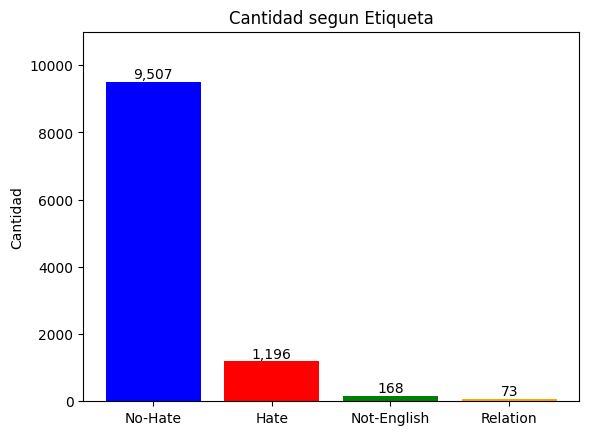

In [ ]:
fig, ax = plt.subplots()
categories = ['No-Hate', 'Hate', 'Not-English', 'Relation']
bar_container = ax.bar(categories, df_odio['label'].value_counts(), color=['blue', 'red', 'green', 'orange'])
# ax.yaxis.set_visible(False)
ax.set(ylabel='Cantidad', title='Cantidad segun Etiqueta', ylim=(0, 11000))
ax.bar_label(bar_container, fmt='{:,.0f}');

Debido a que los textos con etiqueta 2 están escritos en un idioma diferente al del sistema de clasificación, su inclusión genera ruido que afecta negativamente la precisión del proceso. Por tal motivo, se ha tomado la decisión de eliminar estos textos del corpus para optimizar el rendimiento del sistema

In [ ]:
df_odio = df_odio.drop((df_odio[df_odio["label"] == 2]).index)
df_odio["label"].value_counts()

label
0    9507
1    1196
3     168
Name: count, dtype: int64

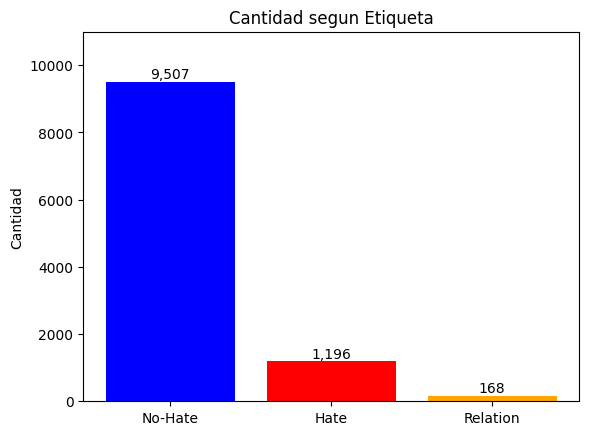

In [ ]:
fig, ax = plt.subplots()
categories = ['No-Hate', 'Hate', 'Relation']
bar_container = ax.bar(categories, df_odio['label'].value_counts(), color=['blue', 'red', 'orange'])
ax.set(ylabel='Cantidad', title='Cantidad segun Etiqueta', ylim=(0, 11000))
ax.bar_label(bar_container, fmt='{:,.0f}');

**Distribución de clases**
- Label 0: 9507 caracteristicas (mayoria)
- Label 1: 1196 caracteristicas (minoria)
- Label 3: 168 caracteristicas (minoria)

Es decir, existe una desproporción significativa en la cantidad de caracteristicas entre las clases. La clase 0 domina el corpus, mientras que las clases 1 y 3 están subrepresentadas. Es obvio entonces que nuestro corpus presenta un desequilibrio de clases.

Tenemos dos opciones: Eliminar los posts de la etiqueta 3, lo que reduciría el tamaño del corpus pero sacrificaría información, afectando así la diversidad y representatividad de los datos.

O bien, agregarlas a una de las otras clases, lo que introduciría ruido y sesgo en los datos. Además, podría afectar la precisión del modelo y la interpretación de los resultados.

Vamos separar nuestro dataset de odio en dos:
* `df_odio_relation`: Reemplazar las etiquetas 3 con 1, diciendole al sistema que las trate como `odio`.
* `df_odio_NOrelation` : Eliminar los posts de la etiqueta 3.

In [ ]:
df_odio_relation = df_odio.copy(deep=True)
df_odio_relation['label'].replace(3, 1, inplace = True) #Le decimos al sistema que trate la etiqueta Relation como Hate
df_odio_relation['label'].value_counts()

label
0    9507
1    1364
Name: count, dtype: int64

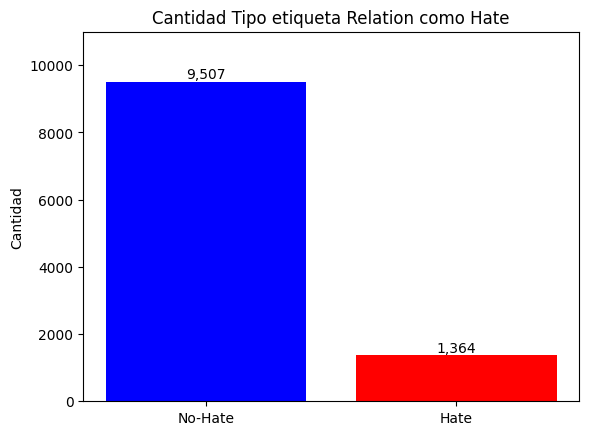

In [ ]:
#Graficamos
fig, ax = plt.subplots()
categories = ['No-Hate', 'Hate']
bar_container = ax.bar(categories, df_odio_relation['label'].value_counts(), color=['blue', 'red'])
# ax.yaxis.set_visible(False)
ax.set(ylabel='Cantidad', title='Cantidad Tipo etiqueta Relation como Hate', ylim=(0, 11000))
ax.bar_label(bar_container, fmt='{:,.0f}');

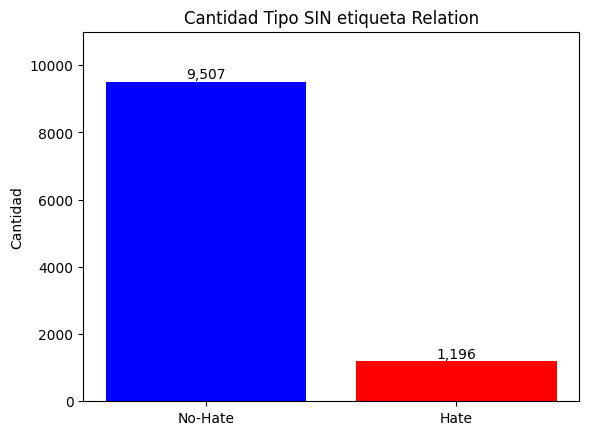

In [ ]:
#separamos nuestros Datset
df_odio_NOrelation = df_odio.drop((df_odio[df_odio["label"] >= 2]).index)
#Graficamos
fig, ax = plt.subplots()
categories = ['No-Hate', 'Hate']
bar_container = ax.bar(categories, df_odio_NOrelation['label'].value_counts(), color=['blue', 'red'])
ax.set(ylabel='Cantidad', title='Cantidad Tipo SIN etiqueta Relation', ylim=(0, 11000))
ax.bar_label(bar_container, fmt='{:,.0f}');

Con el fin de evitar correr este proceso cada vez que se requiera hacer pruebas, se guardaron los corpus en `df_odio_relation` y `df_odio_NOrelation`, respectivamente.

### Preprocesamiento de Datos

#### Para `df_odio_relation`

In [ ]:
df_odio = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df_odio = df_odio.drop(columns=["user_id", "subforum_id", "num_contexts"])
df_odio = df_odio.drop((df_odio[df_odio["label"] == 2]).index)

df_odio_relation = df_odio.copy(deep=True)
df_odio_relation['label'].replace(3, 1, inplace = True) #Le decimos al sistema que trate la etiqueta Relation como Hate
df_odio_relation.head()

,text,label
0,"As of March 13th , 2014 , the booklet had been...",0
1,In order to help increase the booklets downloa...,0
2,( Simply copy and paste the following text int...,0
3,Click below for a FREE download of a colorfull...,1
4,Click on the `` DOWNLOAD ( 7.42 MB ) '' green ...,0


In [ ]:
# Aplicar el preprocesamiento al DataFrame
df_odio_relation = preprocess_text(df_odio_relation)
df_odio_relation.head()

,text,label
0,march th booklet downloaded times counting,0
1,order help increase booklets downloads would g...,0
2,simply copy paste following text youtube video...,0
3,click free download colorfully illustrated pag...,1
4,click download mb green banner link,0


In [ ]:
# Función para hacer stemming y lematización
df_odio_relation['Lematizado_Stemming'] = df_odio_relation['text'].apply(stem_and_lemmatize)
df_odio_relation.isnull().sum()
df_odio_relation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


In [ ]:
df_odio_relation.to_csv("df_odio_relation.csv", index = False, encoding="utf-8")
df_odio_relation = pd.read_csv("/content/df_odio_relation.csv")
df_odio_relation.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

#### Para `df_odio_NOrelation`

In [ ]:
df_odio = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df_odio = df_odio.drop(columns=["user_id", "subforum_id", "num_contexts"])
df_odio = df_odio.drop((df_odio[df_odio["label"] == 2]).index)

df_odio_NOrelation = df_odio.copy(deep=True)
df_odio_NOrelation = df_odio.drop((df_odio[df_odio["label"] >= 2]).index)

df_odio_NOrelation["text"]= df_odio_NOrelation["text"].str.lower() #Convertir los textos a minusculas
df_odio_NOrelation["text"] = df_odio_NOrelation["text"].apply(lambda x: re.sub(r'[^a-z\s]', '', x)) #Eliminar los caracteres no alfabéticos
stop_words = set(stopwords.words('english')) #Eliminar las stop-words
df_odio_NOrelation["text"] = df_odio_NOrelation["text"].apply(lambda x: ' '.join([word for word in x.split() if word not in stop_words]))
df_odio_NOrelation.head()

,text,label
0,march th booklet downloaded times counting,0
1,order help increase booklets downloads would g...,0
2,simply copy paste following text youtube video...,0
3,click free download colorfully illustrated pag...,1
4,click download mb green banner link,0


In [ ]:
# Inicializar Stemmer y Lemmatizer
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

# Función para hacer stemming y lematización
def stem_and_lemmatize(text):
    tokens = nltk.word_tokenize(text)
    stemmed = [stemmer.stem(token) for token in tokens]
    lemmatized = [lemmatizer.lemmatize(token) for token in stemmed]
    return ' '.join(lemmatized)

df_odio_NOrelation['Lematizado_Stemming'] = df_odio_NOrelation['text'].apply(stem_and_lemmatize)
df_odio_NOrelation.isnull().sum()
df_odio_NOrelation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


In [ ]:
df_odio_NOrelation.to_csv("df_odio_NOrelation.csv", index = False, encoding="utf-8")
df_odio_NOrelation = pd.read_csv("/content/df_odio_NOrelation.csv")
df_odio_NOrelation.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

# Subir corpus

Con el fin de ahorranos este paso de preprocesamiento, se almacenan en un archivo .csv

```
df_spam.to_csv("df_spam.csv", index=False)
df_sexista.to_csv("df_sexista.csv", index=False)
df_odio_relation.to_csv("df_odio_relation.csv", index=False)
df_odio_NOrelation.to_csv("df_odio_NOrelation.csv", index=False)
```



Para optimizar el proceso de análisis y evitar la carga repetitiva de corpus en el notebook, se ha realizado la configuración de Google Drive. Esta configuración permite la conexión directa al almacenamiento en la nube, eliminando la necesidad de subir manualmente los archivos cada vez que se ejecute un análisis. La ejecución de una única línea de código es suficiente para establecer la conexión.

Cabe destacar que, en caso de que solo se requiera subir un archivo individual, la opción de carga manual sigue siendo viable. Sin embargo, es importante tener en cuenta que el archivo df_spam presenta un tamaño considerable, lo que podría afectar el rendimiento del proceso de carga manual.



```
# Montar drive
from google.colab import drive
drive.mount('/content/drive')

# Subir archivo indiviual
from google.colab import files
uploaded = files.upload()

```



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df_spam = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_spam.csv")
df_spam.head()
print(df_spam.isnull().sum())

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64


In [ ]:
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_sexista.csv")
df_sexista = df_sexista.rename(columns = {"sexist":"label"})
print(df_sexista.isnull().sum())

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64


In [ ]:
df_sexista.head()

,text,label,Lematizado_Stemming
0,mention didnt even know random option,0,mention didnt even know random option
1,bottom two shouldve gone mkr,0,bottom two shouldv gone mkr
2,mention mention ladyboner deserves much credit...,0,mention mention ladybon deserv much credit dud...
3,shall known sourpuss mkr katandre failedfoodies,0,shall known sourpuss mkr katandr failedfoodi
4,tarah w threw bunch women bus could get wadhwa...,0,tarah w threw bunch woman bu could get wadhwa ...


In [ ]:
df_odio_NOrelation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_NOrelation.csv")
df_odio_NOrelation.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

In [ ]:
df_odio_NOrelation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


In [ ]:
df_odio_relation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_relation.csv")
df_odio_relation.isnull().sum()

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64

In [ ]:
df_odio_relation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


# Vectorización

* **Ponderación TF-IDF `TfidfVectorizer`**

 Este esquema asigna a cada palabra en un documento un peso que refleja tanto su importancia dentro del documento (TF) como su importancia en el corpus de documentos en su conjunto (IDF). Esto ayuda a destacar las palabras más relevantes mientras mitiga el efecto de las palabras comunes que no aportan mucha información distintiva.

 Los parámetros `max_df`, `min_df`, y `stop_words` controlan la inclusión de palabras comunes y poco comunes, mientras que lowercase convierte todo el texto a minúsculas. `norm="l2"` normaliza los vectores resultantes y `smooth_idf=True` suaviza los pesos IDF para prevenir divisiones por cero.


   > ```
   vectorizer_TFIDF = TfidfVectorizer(max_df=0.3,
                             min_df=8,
                             stop_words="english",
                             lowercase=True,
                             use_idf=True,
                             norm="l2",
                             smooth_idf=True
                                   )
  ```

* **`CountVectorizer`**

 Su función es contar el número de veces que cada palabra aparece en cada documento del corpus. Esta implementación produce una representación dispersa de los recuentos usando `scipy.sparse.csr_matrix`.

 Los parámetros `strip_accents` elimina acentos, `lowercase` convierte todo a minúsculas y `stop_words` remueve palabras comunes. `max_df` controla la exclusión de palabras que aparecen en más del 30% de los documentos.


  > - **OJO**: Si no proporciona un diccionario a-priori y no utiliza un analizador que realice algún tipo de selección de características, el número de características será igual al tamaño del vocabulario encontrado al analizar los datos.

> ``` #CountVectorizer
vectorizer_CVec = CountVectorizer(strip_accents = "ascii",
                                  lowercase = True,
                                  stop_words = "english",
                                  max_df = 0.3)
```


* **`HashingVectorizer`**

 HashingVectorizer convierte texto en una matriz de ocurrencias de tokens y reduce la dimensionalidad de los datos mediante funciones hash. Es útil cuando se trabaja con grandes volúmenes de texto y vocabularios extensos, aunque sacrifica la interpretabilidad de palabras individuales. Es rápido y escalable, ideal para aplicaciones donde la velocidad y la eficiencia son esenciales.

 Los parámetros `lowercase` convierte todo a minúsculas, `stop_words` remueve palabras comunes y `norm="l2"` normaliza los vectores resultantes.


 > ```
vectorizer_Hashing = HashingVectorizer(lowercase = True,
                                       stop_words = "english",
                                       norm = "l2"
                                       )
```



In [ ]:
# normalizar los textos

# TfidfVectorizer
vectorizer_TFIDF = TfidfVectorizer(max_df=0.3,
                             min_df=8,
                             stop_words="english",
                             lowercase=True,
                             use_idf=True,
                             norm="l2",
                             smooth_idf=True
                                   )

#CountVectorizer
vectorizer_CVec = CountVectorizer(strip_accents = "ascii",
                                  lowercase = True,
                                  stop_words = "english",
                                  max_df = 0.3)

#HashingVectorizer
vectorizer_Hashing = HashingVectorizer(lowercase = True,
                                       stop_words = "english",
                                       norm = "l2"
                                       )

# Clasificacion Supervisada

Se van a realizar 4 modelos de clasificacion.



Con el fin de evaluarlos se va a utilizan las medidas de error y el `classification_report` de sklearn.
**Métricas**:

- **Medidas de Error:**
   * Error medio absoluto (MAE): Mide la media de las diferencias absolutas entre los valores predichos y los reales.

   
   * Error cuadrático medio (RMSE): Mide cuánto varían las predicciones del modelo respecto a los valores reales, considerando la magnitud de los errores y penalizando los errores grandes de manera proporcional.


- **Métricas del `classification_report`**
   * **Accuracy**: Es la proporción de predicciones correctas entre el total de predicciones realizadas.

   * **Precision** : Es la proporción de verdaderos positivos entre el total de predicciones positivas. Indica la precisión de las predicciones positivas del modelo.

   * **Recall** : Es la proporción de verdaderos positivos entre el total de positivos reales. Indica la capacidad del modelo para encontrar todos los positivos reales.

   * **F1-score** : Es la media armónica de la precisión y el recall. Es una medida que equilibra ambas métricas, especialmente útil cuando se tiene un conjunto de datos desequilibrado.  


- **Métricas Matriz de Confusion**

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))#, zero_division=0))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

## Para SPAM

In [ ]:
df_spam = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_spam.csv")
df_spam.head()

,text,label,Lematizado_Stemming
0,ounce feather bowl hummingbird opec moment ala...,1,ounc feather bowl hummingbird opec moment alab...
1,wulvob get medircations online qnb ikud viagra...,1,wulvob get medirc onlin qnb ikud viagra escape...
2,computer connection cnn com wednesday escapenu...,0,comput connect cnn com wednesday escapenumb ma...
3,university degree obtain prosperous future mon...,1,univers degre obtain prosper futur money earn ...
4,thanks answers guys know checked rsync manual ...,0,thank answer guy know check rsync manual would...


Se realizaran pruebas para cada tipo de Vectorizacion.

In [ ]:
#text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_spam["Lematizado_Stemming"])

In [ ]:
X = text_norm_VecTFIDF #text_norm_CountVec, text_norm_HashingVec
t = df_spam["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(X, t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

In [ ]:
print("Tamaño Caracteristicas de Entrenamiento: ",X_train.shape)
print("Tamaño Caracteristicas de Prueba: ",X_test.shape)
print("Tamaño Etiquetas de Entrenamiento: ",y_train.shape)
print("Tamaño Etiquetas de Prueba: ",y_test.shape)

Tamaño Caracteristicas de Entrenamiento:  (58413, 37175)
Tamaño Caracteristicas de Prueba:  (25035, 37175)
Tamaño Etiquetas de Entrenamiento:  (58413,)
Tamaño Etiquetas de Prueba:  (25035,)


### Regresión Logaritmica

MAE: 0.014
RMSE: 0.116


              precision    recall  f1-score   support

           0       0.99      0.98      0.99     11862
           1       0.98      0.99      0.99     13173

    accuracy                           0.99     25035
   macro avg       0.99      0.99      0.99     25035
weighted avg       0.99      0.99      0.99     25035



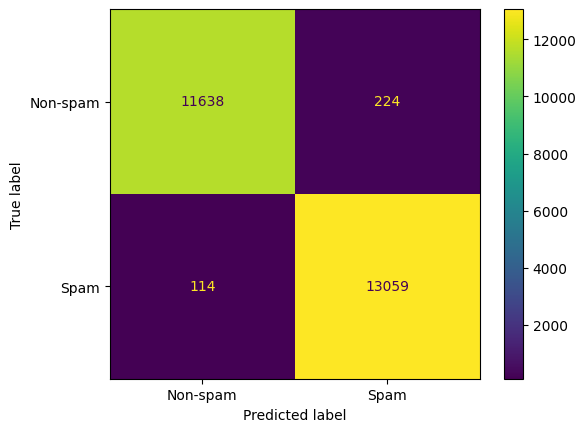

In [ ]:
model_LogisticRegression = LogisticRegression(C = 5, max_iter = 10000)
model_LogisticRegression.fit(X_train, y_train)
y_pred_LogisticRegression = model_LogisticRegression.predict(X_test)
categories = ["Non-spam", "Spam"]
evaluate_model(y_test, y_pred_LogisticRegression, labels=np.unique(df_spam["label"]), display_labels = categories)

In [ ]:
correct_labels = sum(y_test == y_pred_LogisticRegression)
print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))

Se etiquetaron correctamente 24697 de un total de 25035 muestras.


Al realizar pruebas con cada normalizacion se encontró:

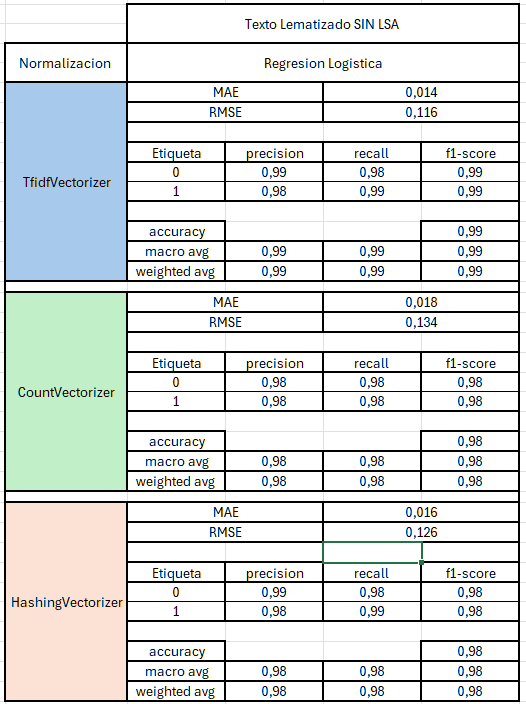

Por la medida del error, la normalizacion `TfidfVectorizer`se escoje para continuar haciendo pruebas.

### Regresión Ridge

Se etiquetaron correctamente 24718 de un total de 25035 muestras.


MAE: 0.013
RMSE: 0.113


              precision    recall  f1-score   support

           0       0.99      0.98      0.99     11862
           1       0.98      0.99      0.99     13173

    accuracy                           0.99     25035
   macro avg       0.99      0.99      0.99     25035
weighted avg       0.99      0.99      0.99     25035



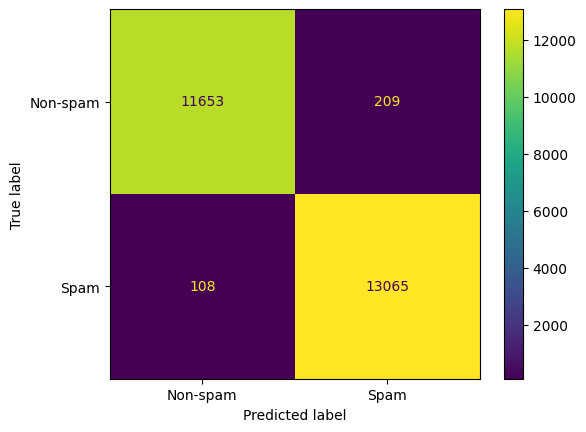

In [ ]:
# alpha = 1, lambda = 0.0001
model_Ridge = RidgeClassifier(tol=1e-2, solver="sparse_cg")
model_Ridge.fit(X_train, y_train)
y_pred_Ridge = model_Ridge.predict(X_test)

correct_labels = sum(y_test == y_pred_Ridge)
print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
print( "\n")

categories = ["Non-spam", "Spam"]
evaluate_model(y_test, y_pred_Ridge, labels=np.unique(df_spam["label"]), display_labels = categories)

Al igual que el modelo anterior, la vectorización `TfidfVectorizer` tuvo mejores resultados. Por tanto se continuara utilizando para hacer más pruebas.

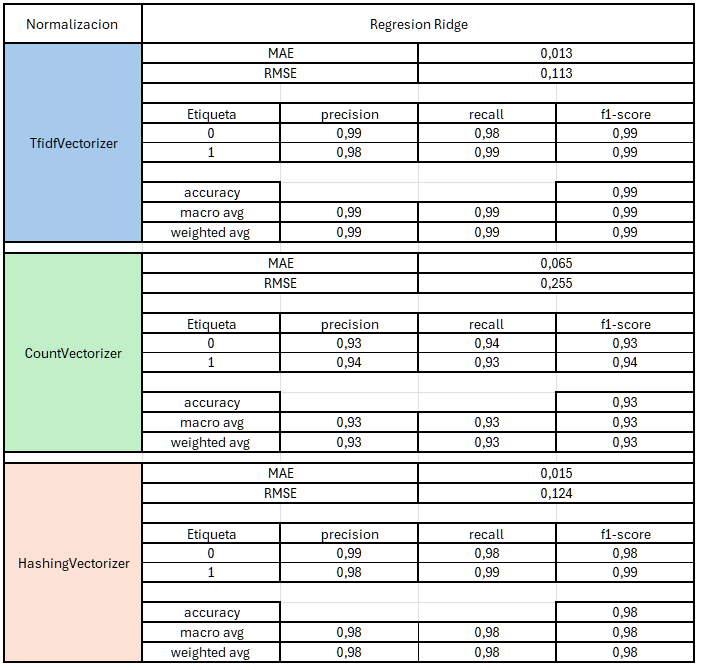

### Árboles de decisiones

In [ ]:
X = text_norm_HashingVec #text_norm_CountVec#text_norm_VecTFIDF #text_norm_CountVec, text_norm_HashingVec
t = df_spam["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(X, t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

Se etiquetaron correctamente 24015 de un total de 25035 muestras.


Se etiquetaron correctamente 24015 de un total de 25035 muestras.
Errores
MAE: 0.041
MSE: 0.202


              precision    recall  f1-score   support

           0       0.96      0.96      0.96     11862
           1       0.96      0.96      0.96     13173

    accuracy                           0.96     25035
   macro avg       0.96      0.96      0.96     25035
weighted avg       0.96      0.96      0.96     25035



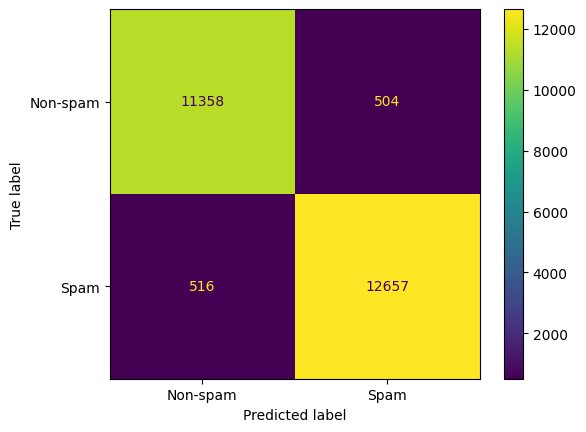

In [ ]:
model_DesicionTree = DecisionTreeClassifier()
model_DesicionTree.fit(X_train, y_train)
y_pred_DesicionTree = model_DesicionTree.predict(X_test)

correct_labels = sum(y_test == y_pred_DesicionTree)
print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
print( "\n")

categories = ["Non-spam", "Spam"]
evaluate_model(y_test, y_pred_DesicionTree, labels=np.unique(df_spam["label"]), display_labels = categories)

### Máquina de Soporte Vectorial Lineal Escalable

Se etiquetaron correctamente 24545 de un total de 25035 muestras.


Se etiquetaron correctamente 24545 de un total de 25035 muestras.
Errores
MAE: 0.02
MSE: 0.14


              precision    recall  f1-score   support

           0       0.99      0.97      0.98     11862
           1       0.97      0.99      0.98     13173

    accuracy                           0.98     25035
   macro avg       0.98      0.98      0.98     25035
weighted avg       0.98      0.98      0.98     25035



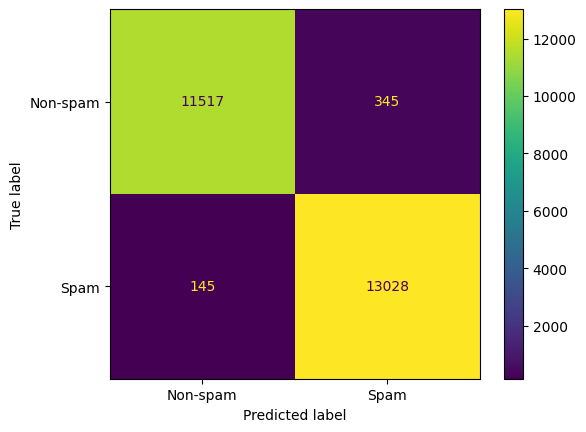

In [ ]:
model_SVC = LinearSVC(C=0.1, dual=False, max_iter=1000)
model_SVC.fit(X_train, y_train)
y_pred_SVC = model_SVC.predict(X_test)

correct_labels = sum(y_test == y_pred_SVC)
print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
print( "\n")

categories = ["Non-spam", "Spam"]
evaluate_model(y_test, y_pred_SVC, labels=np.unique(df_spam["label"]), display_labels = categories)

### Comparación de Métricas en modelos con normalización Tf-idf Vectorizer

#### **Errores en las predicciones**

Observemos cual de los modelos tuvo menor error en la prediccion manteniendo la normalizacion por TfidfVectorizer pues vimos que era a la que mejor le iba en cada caso

La comparación de errores en la prediccion de modelos decon normalización Tf-idf Vectorizer permitirá identificar el modelo más preciso y confiable para la tarea de predicción. La normalización Tf-idf Vectorizer garantizará una comparación justa entre los modelos y contribuirá a mejorar la calidad de las predicciones.

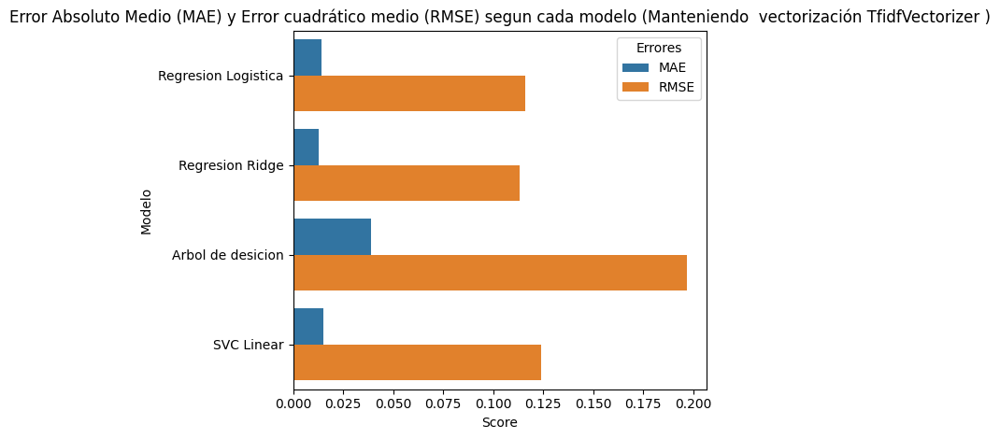

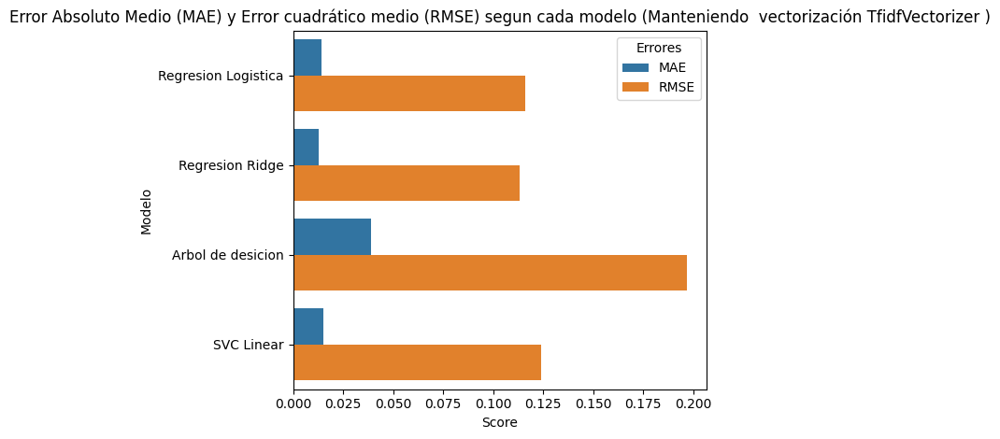

In [ ]:
# Crear un DataFrame de las métricas de MAE y RMSE
metrics_error = pd.DataFrame({
    'Modelo': ["Regresion Logistica", "Regresion Ridge", "Arbol de desicion", "SVC Linear"],
    'MAE': [mean_absolute_error(y_test, y_pred_LogisticRegression),
            mean_absolute_error(y_test, y_pred_Ridge),
            mean_absolute_error(y_test, y_pred_DesicionTree),
            mean_absolute_error(y_test, y_pred_SVC)],
    'RMSE': [np.sqrt(mean_squared_error(y_test, y_pred_LogisticRegression)),
             np.sqrt(mean_squared_error(y_test, y_pred_Ridge)),
             np.sqrt(mean_squared_error(y_test, y_pred_DesicionTree)),
             np.sqrt(mean_squared_error(y_test, y_pred_SVC))]
})

# Convertir los valores de MAE y RMSE a redondeo de 3 decimales
metrics_error[['MAE', 'RMSE']] = metrics_error[['MAE', 'RMSE']].round(3)

# Combine las métricas y renombramiento en melt
metrics_error_combined = metrics_error.melt(id_vars='Modelo',
                                           var_name='Errores',
                                           value_name='Score')

# Crear el gráfico de barras horizontal con Seaborn
sns.barplot(x='Score', y='Modelo', hue='Errores', data=metrics_error_combined)
plt.xlabel('Score')
plt.ylabel('Modelo')
plt.title('Error Absoluto Medio (MAE) y Error cuadrático medio (RMSE) segun cada modelo (Manteniendo vectorización TfidfVectorizer )')
plt.legend(title='Errores')
plt.tight_layout()  # Mejorar automáticamente el diseño
plt.show();

#### **Presición de las Predicciones**

Para el corpus de SPAM, todos los modelos obtuvieron buenos resultados. Pero el modelo de clasificación con mayor precisión es Regresión Ridge con una precisión de 0.987.

La superioridad de la Regresión Ridge en este caso se puede atribuir a su capacidad para manejar la multicolinealidad, un fenómeno común en los datos de texto donde las características pueden estar altamente correlacionadas entre sí. La Regresión Ridge regulariza los coeficientes del modelo, lo que ayuda a evitar el sobreajuste y mejora la generalización a nuevos datos




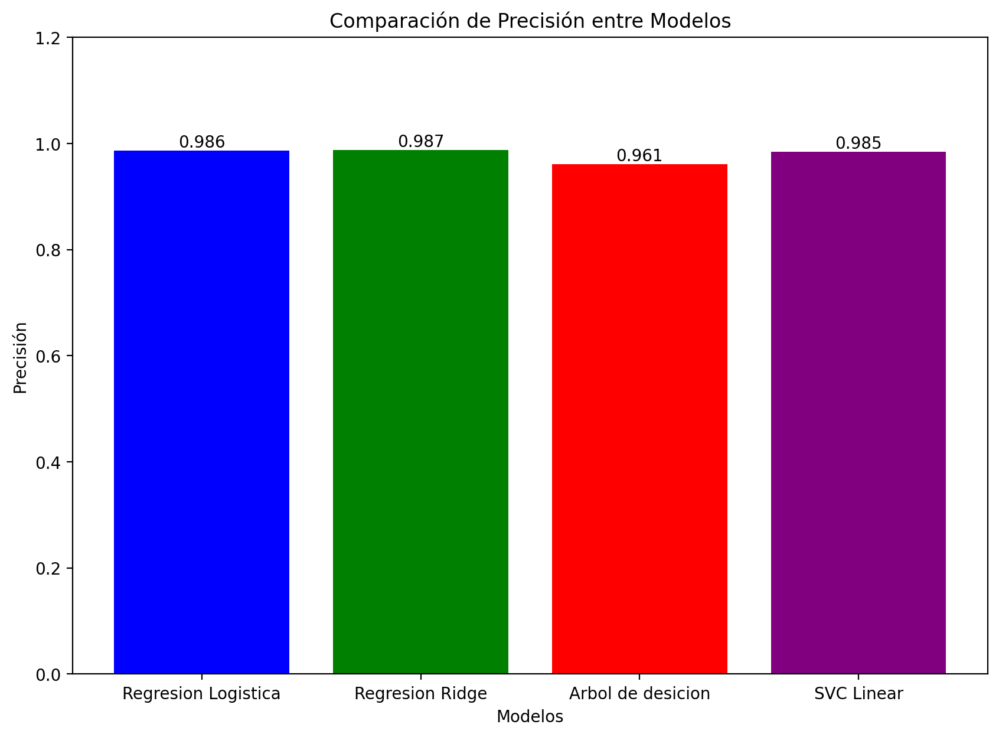

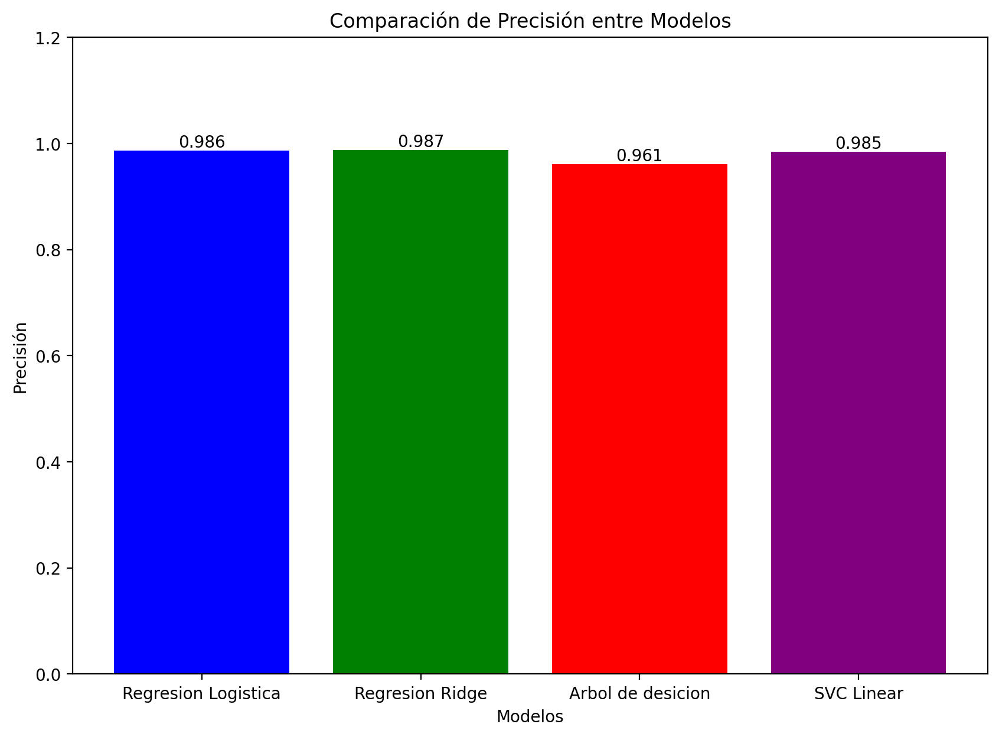

In [ ]:
# Calcular la precisión de cada modelo
accuracy_LogisticRegression = accuracy_score(y_test, y_pred_LogisticRegression)
accuracy_Ridge = accuracy_score(y_test, y_pred_Ridge)
accuracy_DesicionTree = accuracy_score(y_test, y_pred_DesicionTree)
accuracy_SVC = accuracy_score(y_test, y_pred_SVC)

# Preparar datos para la gráfica de barras
mod = ["Regresion Logistica", "Regresion Ridge", "Arbol de desicion", "SVC Linear"]
acc = [accuracy_LogisticRegression, accuracy_Ridge, accuracy_DesicionTree, accuracy_SVC]

# Crear gráfica de barras
plt.figure(figsize=(10, 7), dpi = 200)
bars = plt.bar(mod, acc, color=['blue', 'green', 'red', 'purple'])

# Añadir etiquetas y título
plt.xlabel('Modelos')
plt.ylabel('Precisión')
plt.title('Comparación de Precisión entre Modelos')
plt.ylim(0, 1.2)

# Añadir etiquetas de valor en las barras
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 3), ha='center', va='bottom')

plt.show()

In [ ]:
unique_labels = np.unique(y_test)
unique_labels

array([0, 1])

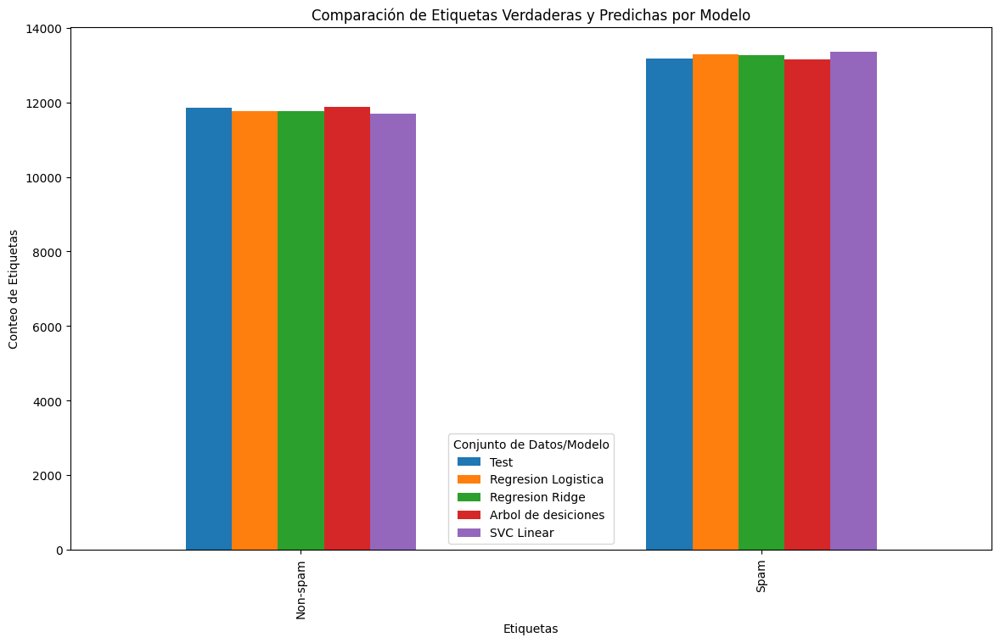

In [ ]:
# Contar instancias de cada etiqueta en y_test y en las predicciones de cada modelo
unique_labels = np.unique(y_test)
label_names = {0: "Non-spam", 1: "Spam"}

# Conteo de etiquetas en y_test
y_test_counts = [np.sum(y_test == label) for label in unique_labels]


# Conteo de etiquetas predichas por cada modelo
pred_counts = {
    'Regresion Logistica': [np.sum(y_pred_LogisticRegression == label) for label in unique_labels],
    'Regresion Ridge': [np.sum(y_pred_Ridge == label) for label in unique_labels],
    'Arbol de desiciones': [np.sum(y_pred_DesicionTree == label) for label in unique_labels],
    'SVC Linear': [np.sum(y_pred_SVC == label) for label in unique_labels]
}

# Crear DataFrame para graficar
df_test_counts = pd.DataFrame({'Test': y_test_counts}, index=[label_names[label] for label in unique_labels])
df_pred_counts = pd.DataFrame(pred_counts, index=[label_names[label] for label in unique_labels])

# Combinar DataFrame para graficar
df_combined = pd.concat([df_test_counts, df_pred_counts], axis=1)

# Crear gráfica de barras agrupada por modelo
df_combined.plot(kind='bar', figsize=(14, 8))

# Añadir etiquetas y título
plt.xlabel('Etiquetas')
plt.ylabel('Conteo de Etiquetas')
plt.title('Comparación de Etiquetas Verdaderas y Predichas por Modelo')
plt.legend(title='Conjunto de Datos/Modelo')

# Mostrar la gráfica
plt.show()

#### **Validación Cruzada**

En este apartado, llevaremos a cabo un proceso de Validación Cruzada para evaluar el desempeño del modelo de Regresión Ridge al enfrentarlo a datos no vistos.

Es fundamental destacar que probar un modelo de clasificación con los mismos datos utilizados para su entrenamiento representa un error metodológico. Si el modelo simplemente replica lo que ya ha aprendido, podría obtener una puntuación perfecta, pero carecería de utilidad para procesar nuevos datos. Este fenómeno se conoce como sobreajuste. La Validación Cruzada surge como una técnica efectiva para evitar este problema y obtener una estimación más precisa de cómo se comportará el modelo al ser aplicado a nuevos datos no contemplados durante la fase de entrenamiento.

¿Cómo funciona en `sklearn`?

* Divide el conjunto de datos original en k subconjuntos (folds) aleatorios y disjuntos (no comparten elementos).
* Se realiza un proceso de entrenamiento y validación en k iteraciones.
* En cada iteración:
   * Se utiliza un fold como conjunto de validación (datos que no ha visto el modelo para entrenar).
   * Los restantes k-1 folds se utilizan como conjunto de entrenamiento.
   * Se entrena el modelo con el conjunto de entrenamiento y se evalúa su rendimiento en el conjunto de validación.

`kfold = KFold(n_splits = 10, shuffle = True, random_state=123)`
* `n_splits`: (entero, por defecto 5), Número de pliegues (folds) en que se dividirá el conjunto de datos.
* `shuffle` (booleano, por defecto False), Si se barajan los datos antes de dividirlos en pliegues.
* `random_state` (entero, RandomState instance o None, por defecto None), Semilla aleatoria.

In [ ]:
print("Etiquetas del corpus SPAM")
print(t)

Etiquetas del corpus SPAM
0        1
1        1
2        0
3        1
4        0
        ..
83443    0
83444    1
83445    1
83446    0
83447    1
Name: label, Length: 83448, dtype: int64


In [ ]:
print("Primer elemento Corpus SPAM Vectorizado")
print(X[1])

Primer elemento Corpus SPAM Vectorizado
  (0, 35974)	0.11187579229705838
  (0, 35516)	0.09581166862121936
  (0, 22900)	0.09388640777081772
  (0, 17625)	0.24414342738111564
  (0, 4332)	0.12652076407253926
  (0, 20183)	0.10444189627403982
  (0, 7691)	0.1084825793328631
  (0, 21233)	0.27207462499419005
  (0, 36552)	0.164216651931681
  (0, 20712)	0.09074332495818911
  (0, 32492)	0.18008063508790842
  (0, 27658)	0.12982077813482878
  (0, 36007)	0.12767365397256195
  (0, 19709)	0.10384712540337782
  (0, 27024)	0.09606222520045839
  (0, 16992)	0.11700271591025094
  (0, 10296)	0.10769192841096674
  (0, 24509)	0.23732584717410235
  (0, 1684)	0.14991490249181127
  (0, 21222)	0.27207462499419005
  (0, 24869)	0.1040845805015925
  (0, 20676)	0.10945200282682012
  (0, 2543)	0.13936998105535905
  (0, 36471)	0.12256278059412422
  (0, 31699)	0.10187014917625563
  (0, 21414)	0.20512078302896908
  (0, 30885)	0.172071746395819
  (0, 36686)	0.27207462499419005
  (0, 35031)	0.181390502200081
  (0, 1254)	0.1

In [ ]:
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']
kfold = KFold(n_splits = 10,
              shuffle = True,
              random_state=123)
scores = cross_validate(model_Ridge, X, t, cv=kfold, scoring=scoring)
print("Accuracy:", np.round(np.mean(scores['test_accuracy']), 3))
print("Precision:", np.round(np.mean(scores['test_precision_macro']), 3))
print("Recall:", np.round(np.mean(scores['test_recall_macro']), 3))
print("F1 Score:", np.round(np.mean(scores['test_f1_macro']), 3))

Accuracy: 0.987
Precision: 0.988
Recall: 0.987
F1 Score: 0.987


#### Tiempos de Procesamiento

In [ ]:
# Función para entrenar y evaluar modelos
def train_and_evaluate(X_train, X_test, y_train, y_test):
    models = {
        "Regresion Logistica": model_LogisticRegression,
        "Regresion Ridge": model_Ridge,
        "Árboles de desiciones": model_DesicionTree,
        "Linear SVC": model_SVC
    }

    results = []

    for model_name, model in models.items():
        start_time = time.time()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        end_time = time.time()
        results.append({
            "model": model_name,
            "time": end_time - start_time
        })

    df_tiempo = pd.DataFrame(results)

    return df_tiempo

In [ ]:
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_spam["Lematizado_Stemming"])

In [ ]:
X = text_norm_VecTFIDF #text_norm_CountVec, text_norm_HashingVec
t = df_spam["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(X, t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

tiempo_VecTFIDF = train_and_evaluate(X_train, X_test, y_train, y_test)
tiempo_VecTFIDF.head()

,model,time
0,Regresion Logistica,9.751651
1,Regresion Ridge,1.101147
2,Árboles de desiciones,143.768586
3,Linear SVC,3.421968


In [ ]:
X = text_norm_CountVec #text_norm_CountVec, text_norm_HashingVec
t = df_spam["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(X, t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

tiempo_VecCount = train_and_evaluate(X_train, X_test, y_train, y_test)


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


,model,time
0,Regresion Logistica,131.447513
1,Regresion Ridge,535.652741
2,Árboles de desiciones,102.556594
3,Linear SVC,99.221938


In [ ]:
X = text_norm_HashingVec #text_norm_CountVec, text_norm_HashingVec
t = df_spam["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(X, t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

tiempo_VecCount = train_and_evaluate(X_train, X_test, y_train, y_test)

tiempo_VecHash = train_and_evaluate(X_train, X_test, y_train, y_test)
print(tiempo_VecHash)

[{'model': 'Regresion Logistica', 'time': 70.66892981529236}, {'model': 'Regresion Ridge', 'time': 9.496012687683105}, {'model': 'Árboles de desiciones', 'time': 241.16699528694153}, {'model': 'Linear SVC', 'time': 5.479589223861694}]


## Para SEXISM

Se ha detallado la implementación, el análisis y el tiempo de procesamiento de la vectorización para los 4 modelos de clasificación. Para agilizar el informe, los demás análisis de esta sección se realizarán utilizando la función:


```
# Función para evaluar el modelo
def evaluate_model(y_test, y_pred, labels, display_labels):
    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))#, zero_division=0))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

# Función principal que entrena y evalúa los modelos
def train_and_evaluate_models(df, X, labels, tam_test):
    t = df["label"]
    X_train, X_test, y_train, y_test = train_test_split(X, t, test_size=tam_test, random_state=123, stratify=t, shuffle=True)

    # Definición de modelos
    models = {
        "Regresion Logistica": LogisticRegression(C=5, max_iter=10000),
        "Regresion Ridge": RidgeClassifier(tol=1e-2, solver="sparse_cg"),
        "Árbol de desiciones": DecisionTreeClassifier(),
        "Linear SVC": LinearSVC(C=0.1, dual=False, max_iter=1000)
    }

    predictions = {}
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[model_name] = y_pred
        evaluate_model(y_test, y_pred, labels=np.unique(df["label"]), display_labels=labels)

    # Calcular métricas de error
    metrics_error = pd.DataFrame({
        'Modelo': list(models.keys()),
        'MAE': [mean_absolute_error(y_test, predictions[model_name]) for model_name in models.keys()],
        'RMSE': [np.sqrt(mean_squared_error(y_test, predictions[model_name])) for model_name in models.keys()]
    })

    # Convertir los valores de MAE y RMSE a redondeo de 3 decimales
    metrics_error[['MAE', 'RMSE']] = metrics_error[['MAE', 'RMSE']].round(3)

    # Combine las métricas y renombramiento en melt
    metrics_error_combined = metrics_error.melt(id_vars='Modelo', var_name='Errores', value_name='Score')

    # Crear el gráfico de barras horizontal con Seaborn
    sns.barplot(x='Score', y='Modelo', hue='Errores', data=metrics_error_combined)
    plt.xlabel('Score')
    plt.ylabel('Modelo')
    plt.title('Error Absoluto Medio (MAE) y Error cuadrático medio (RMSE) según cada modelo (Manteniendo vectorización TfidfVectorizer)')
    plt.legend(title='Errores')
    plt.tight_layout()  # Mejorar automáticamente el diseño
    plt.show()

    # Calcular la precisión de cada modelo
    accuracies = {model_name: accuracy_score(y_test, predictions[model_name]) for model_name in models.keys()}

    # Preparar datos para la gráfica de barras
    mod = list(models.keys())
    acc = list(accuracies.values())

    # Crear gráfica de barras
    plt.figure(figsize=(10, 7), dpi=200)
    bars = plt.bar(mod, acc, color=['blue', 'green', 'red', 'purple'])

    # Añadir etiquetas y título
    plt.xlabel('Modelos')
    plt.ylabel('Precisión')
    plt.title('Comparación de Precisión entre Modelos')
    plt.ylim(0, 1)

    # Añadir etiquetas de valor en las barras
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 3), ha='center', va='bottom')

    plt.show()

    # Conteo de etiquetas en y_test
    unique_labels = np.unique(y_test)
    label_names = {0: "NO sexist", 1: "sexist"}
    y_test_counts = [np.sum(y_test == label) for label in unique_labels]

    # Conteo de etiquetas predichas por cada modelo
    pred_counts = {
        'Regresion Logistica': [np.sum(predictions['Regresion Logistica'] == label) for label in unique_labels],
        'Regresion Ridge': [np.sum(predictions['Regresion Ridge'] == label) for label in unique_labels],
        'Árbol de desiciones': [np.sum(predictions['Árbol de desiciones'] == label) for label in unique_labels],
        'Linear SVC': [np.sum(predictions['Linear SVC'] == label) for label in unique_labels]
    }

    # Crear DataFrame para graficar
    df_test_counts = pd.DataFrame({'Test': y_test_counts}, index=[label_names[label] for label in unique_labels])
    df_pred_counts = pd.DataFrame(pred_counts, index=[label_names[label] for label in unique_labels])

    # Combinar DataFrame para graficar
    df_combined = pd.concat([df_test_counts, df_pred_counts], axis=1)

    # Crear gráfica de barras agrupada por modelo
    df_combined.plot(kind='bar', figsize=(14, 8))

    # Añadir etiquetas y título
    plt.xlabel('Etiquetas')
    plt.ylabel('Conteo de Etiquetas')
    plt.title('Comparación de Etiquetas Verdaderas y Predichas por Modelo')
    plt.legend(title='Conjunto de Datos/Modelo')

    # Mostrar la gráfica
    plt.show()

    # Función para entrenar y evaluar modelos
    def train_and_evaluate_time(X_train, X_test, y_train, y_test):
        results = []

        for model_name, model in models.items():
            start_time = time.time()
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            end_time = time.time()
            results.append({
                "model": model_name,
                "time": end_time - start_time
            })

        df_tiempo = pd.DataFrame(results)
        return df_tiempo

    results = train_and_evaluate_time(X_train, X_test, y_train, y_test)
    
    return results
```



In [ ]:
# Función para evaluar el modelo
def evaluate_model(y_test, y_pred, labels, display_labels):
    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))#, zero_division=0))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

# Función principal que entrena y evalúa los modelos
def train_and_evaluate_models(df, X, labels, tam_test):
    t = df["label"]
    X_train, X_test, y_train, y_test = train_test_split(X, t, test_size=tam_test, random_state=123, stratify=t, shuffle=True)

    # Definición de modelos
    models = {
        "Regresion Logistica": LogisticRegression(C=5, max_iter=10000),
        "Regresion Ridge": RidgeClassifier(tol=1e-2, solver="sparse_cg"),
        "Árbol de desiciones": DecisionTreeClassifier(),
        "Linear SVC": LinearSVC(C=0.1, dual=False, max_iter=1000)
    }

    predictions = {}
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[model_name] = y_pred
        evaluate_model(y_test, y_pred, labels=np.unique(df["label"]), display_labels=labels)

    # Calcular métricas de error
    metrics_error = pd.DataFrame({
        'Modelo': list(models.keys()),
        'MAE': [mean_absolute_error(y_test, predictions[model_name]) for model_name in models.keys()],
        'RMSE': [np.sqrt(mean_squared_error(y_test, predictions[model_name])) for model_name in models.keys()]
    })

    # Convertir los valores de MAE y RMSE a redondeo de 3 decimales
    metrics_error[['MAE', 'RMSE']] = metrics_error[['MAE', 'RMSE']].round(3)

    # Combine las métricas y renombramiento en melt
    metrics_error_combined = metrics_error.melt(id_vars='Modelo', var_name='Errores', value_name='Score')

    # Crear el gráfico de barras horizontal con Seaborn
    sns.barplot(x='Score', y='Modelo', hue='Errores', data=metrics_error_combined)
    plt.xlabel('Score')
    plt.ylabel('Modelo')
    plt.title('Error Absoluto Medio (MAE) y Error cuadrático medio (RMSE) según cada modelo (Manteniendo vectorización TfidfVectorizer)')
    plt.legend(title='Errores')
    plt.tight_layout()  # Mejorar automáticamente el diseño
    plt.show()

    # Calcular la precisión de cada modelo
    accuracies = {model_name: accuracy_score(y_test, predictions[model_name]) for model_name in models.keys()}

    # Preparar datos para la gráfica de barras
    mod = list(models.keys())
    acc = list(accuracies.values())

    # Crear gráfica de barras
    plt.figure(figsize=(10, 7), dpi=200)
    bars = plt.bar(mod, acc, color=['blue', 'green', 'red', 'purple'])

    # Añadir etiquetas y título
    plt.xlabel('Modelos')
    plt.ylabel('Precisión')
    plt.title('Comparación de Precisión entre Modelos')
    plt.ylim(0, 1)

    # Añadir etiquetas de valor en las barras
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 3), ha='center', va='bottom')

    plt.show()

    # Conteo de etiquetas en y_test
    unique_labels = np.unique(y_test)
    label_names = {0: "NO sexist", 1: "sexist"}
    y_test_counts = [np.sum(y_test == label) for label in unique_labels]

    # Conteo de etiquetas predichas por cada modelo
    pred_counts = {
        'Regresion Logistica': [np.sum(predictions['Regresion Logistica'] == label) for label in unique_labels],
        'Regresion Ridge': [np.sum(predictions['Regresion Ridge'] == label) for label in unique_labels],
        'Árbol de desiciones': [np.sum(predictions['Árbol de desiciones'] == label) for label in unique_labels],
        'Linear SVC': [np.sum(predictions['Linear SVC'] == label) for label in unique_labels]
    }

    # Crear DataFrame para graficar
    df_test_counts = pd.DataFrame({'Test': y_test_counts}, index=[label_names[label] for label in unique_labels])
    df_pred_counts = pd.DataFrame(pred_counts, index=[label_names[label] for label in unique_labels])

    # Combinar DataFrame para graficar
    df_combined = pd.concat([df_test_counts, df_pred_counts], axis=1)

    # Crear gráfica de barras agrupada por modelo
    df_combined.plot(kind='bar', figsize=(14, 8))

    # Añadir etiquetas y título
    plt.xlabel('Etiquetas')
    plt.ylabel('Conteo de Etiquetas')
    plt.title('Comparación de Etiquetas Verdaderas y Predichas por Modelo')
    plt.legend(title='Conjunto de Datos/Modelo')

    # Mostrar la gráfica
    plt.show()

    # Función para entrenar y evaluar modelos
    def train_and_evaluate_time(X_train, X_test, y_train, y_test):
        results = []

        for model_name, model in models.items():
            start_time = time.time()
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            end_time = time.time()
            results.append({
                "model": model_name,
                "time": end_time - start_time
            })

        df_tiempo = pd.DataFrame(results)
        return df_tiempo

    results = train_and_evaluate_time(X_train, X_test, y_train, y_test)

    return results

In [ ]:
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_sexista.csv")
df_sexista = df_sexista.rename(columns = {"sexist":"label"})

text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_sexista["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_sexista["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_sexista["Lematizado_Stemming"])

Se etiquetaron correctamente 3681 de un total de 4090 muestras.
Errores
MAE: 0.1
MSE: 0.316


              precision    recall  f1-score   support

           0       0.92      0.96      0.94      3547
           1       0.67      0.48      0.56       543

    accuracy                           0.90      4090
   macro avg       0.80      0.72      0.75      4090
weighted avg       0.89      0.90      0.89      4090



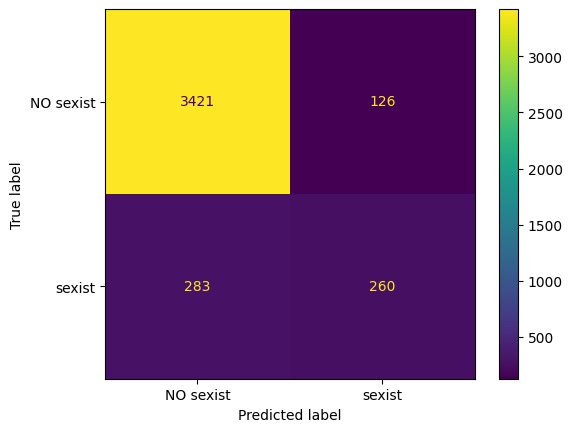

Se etiquetaron correctamente 3667 de un total de 4090 muestras.
Errores
MAE: 0.103
MSE: 0.322


              precision    recall  f1-score   support

           0       0.92      0.96      0.94      3547
           1       0.66      0.46      0.54       543

    accuracy                           0.90      4090
   macro avg       0.79      0.71      0.74      4090
weighted avg       0.89      0.90      0.89      4090



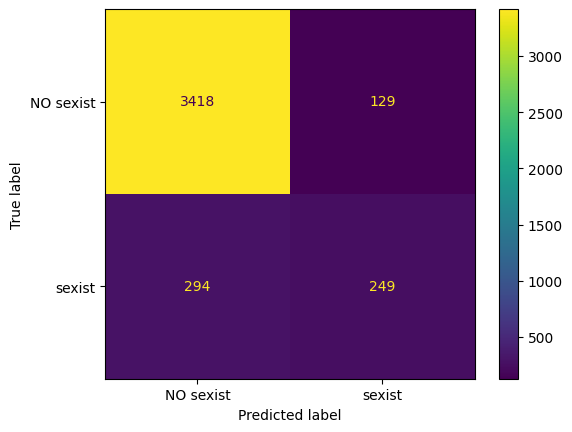

Se etiquetaron correctamente 3645 de un total de 4090 muestras.
Errores
MAE: 0.109
MSE: 0.33


              precision    recall  f1-score   support

           0       0.94      0.94      0.94      3547
           1       0.59      0.60      0.59       543

    accuracy                           0.89      4090
   macro avg       0.76      0.77      0.77      4090
weighted avg       0.89      0.89      0.89      4090



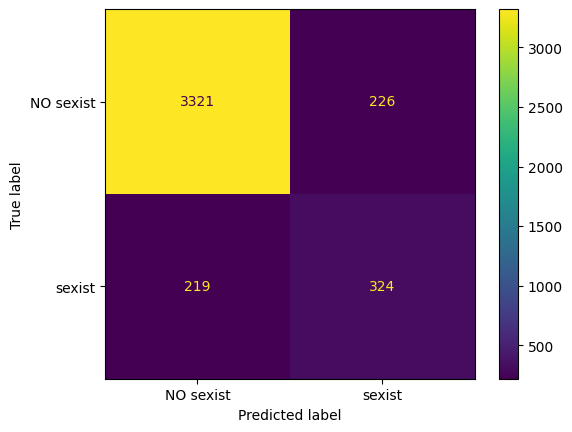

Se etiquetaron correctamente 3659 de un total de 4090 muestras.
Errores
MAE: 0.105
MSE: 0.325


              precision    recall  f1-score   support

           0       0.92      0.97      0.94      3547
           1       0.66      0.42      0.52       543

    accuracy                           0.89      4090
   macro avg       0.79      0.69      0.73      4090
weighted avg       0.88      0.89      0.88      4090



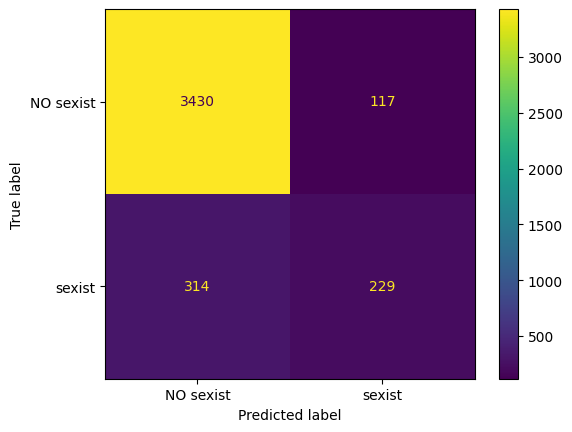

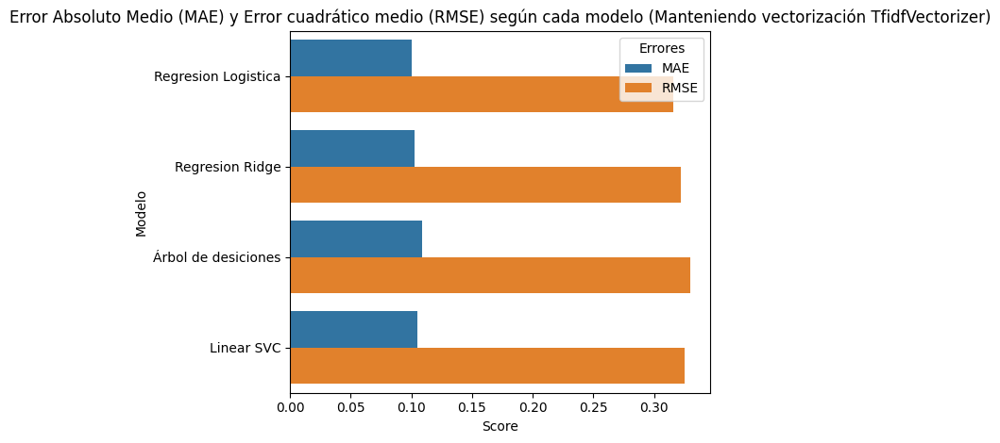

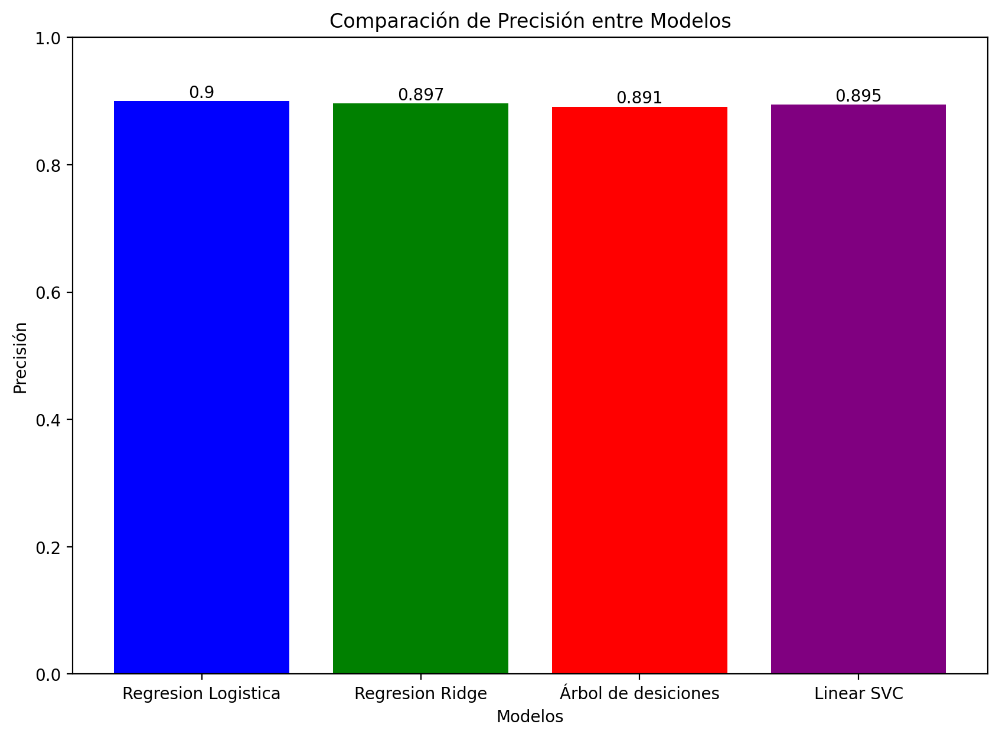

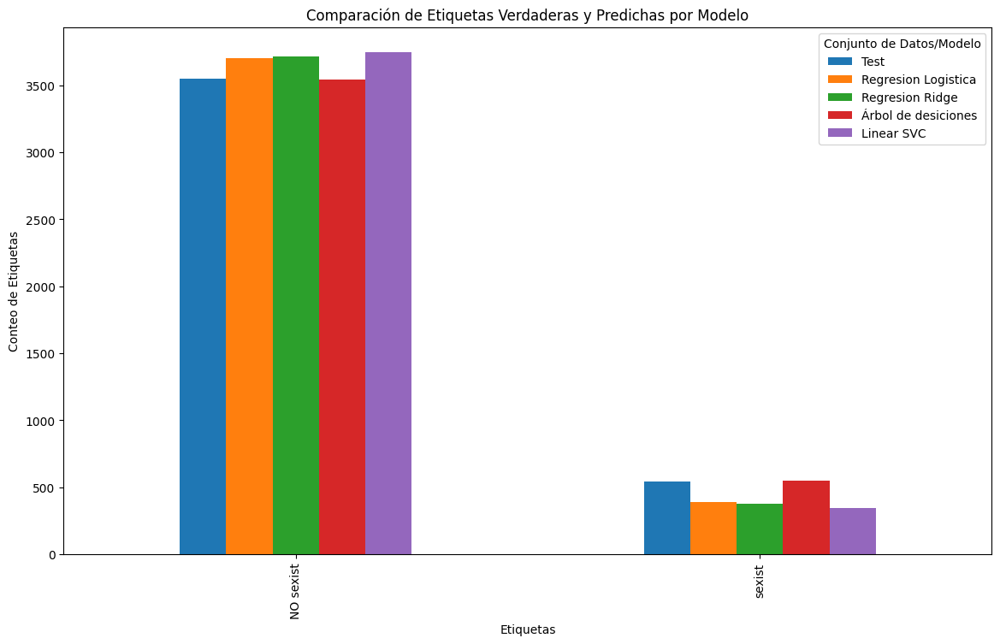

In [ ]:
categories = ["NO sexist", "sexist"]
results_VecTFIDF = train_and_evaluate_models(df = df_sexista,
                                             X = text_norm_HashingVec,
                                             labels = categories,
                                             tam_test = 0.3)

### Regresión Logaritmica

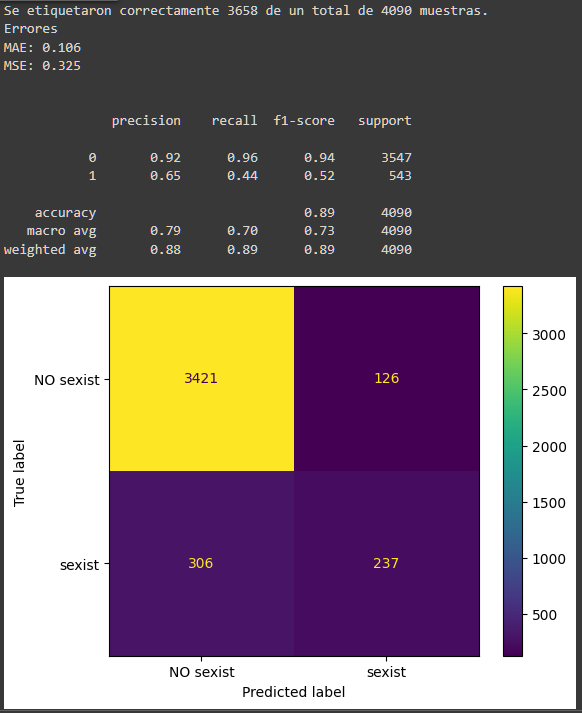

### Regresión Ridge

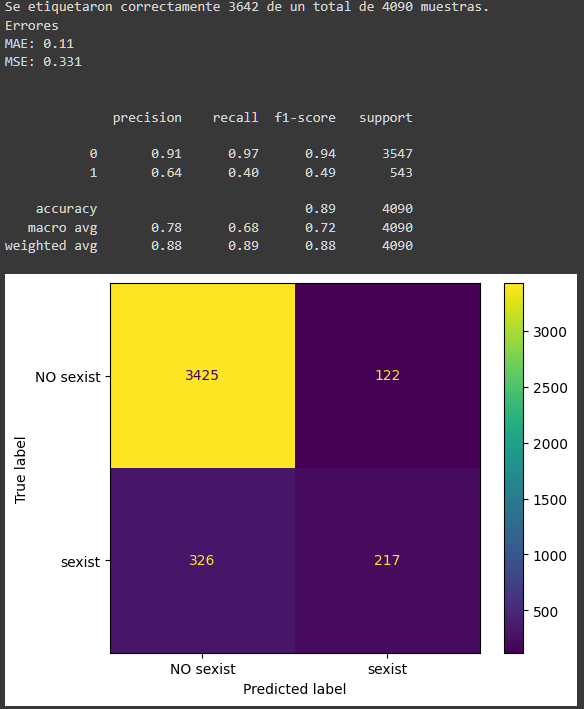

### Árboles de decisiones

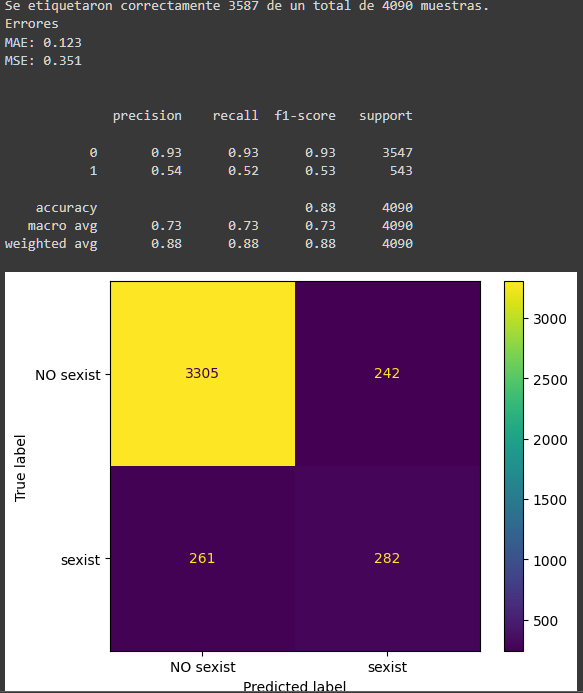

### Máquina de Soporte Vectorial Lineal Escalable

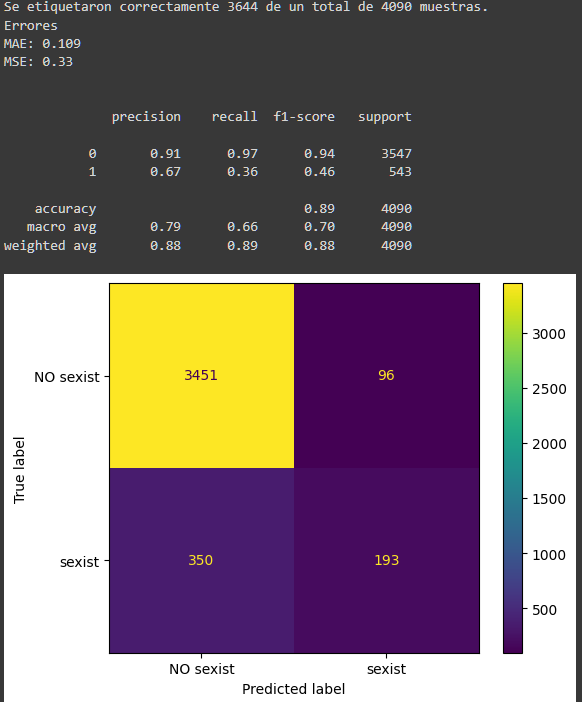

### Comparación de Métricas en modelos con normalización Tf-idf Vectorizer

#### **Errores en las predicciones**

Observemos cual de los modelos tuvo menor error en la prediccion manteniendo la normalizacion por TfidfVectorizer pues vimos que era a la que mejor le iba en cada caso

La comparación de errores en la prediccion de modelos decon normalización Tf-idf Vectorizer permitirá identificar el modelo más preciso y confiable para la tarea de predicción. La normalización Tf-idf Vectorizer garantizará una comparación justa entre los modelos y contribuirá a mejorar la calidad de las predicciones.

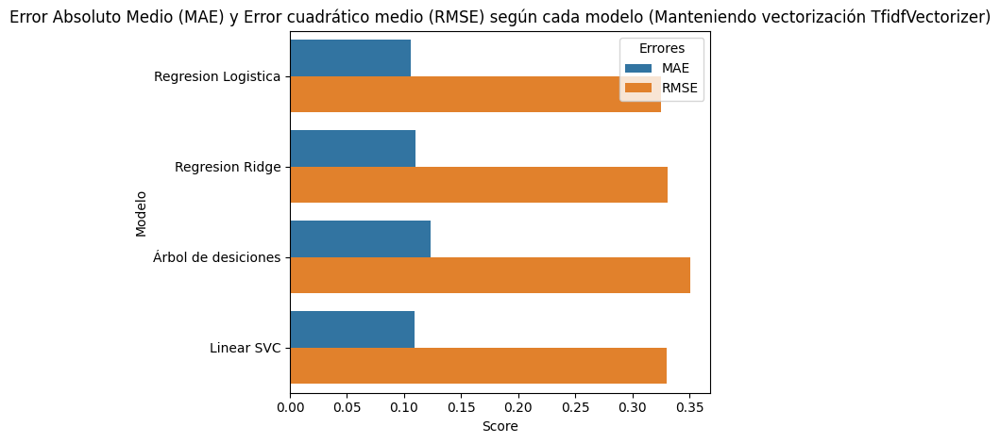

#### **Presición de las Predicciones**

Para el corpus de SEXISM, todos los modelos obtuvieron buenos resultados. Pero el modelo de clasificación con mayor precisión es Linear SCV con una precisión de 0.891.

La superioridad de la Linear SCV en este caso se puede atribuir a su capacidad para manejar la multicolinealidad, un fenómeno común en los datos de texto donde las características pueden estar altamente correlacionadas entre sí. La Linear SCV regulariza los coeficientes del modelo, lo que ayuda a evitar el sobreajuste y mejora la generalización a nuevos datos




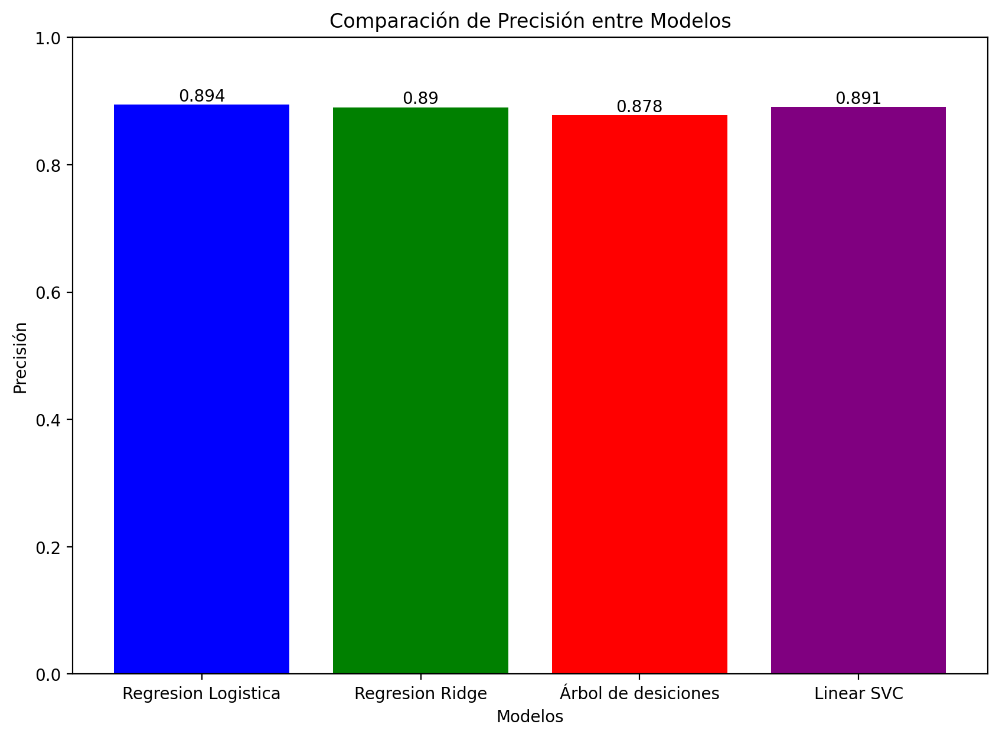

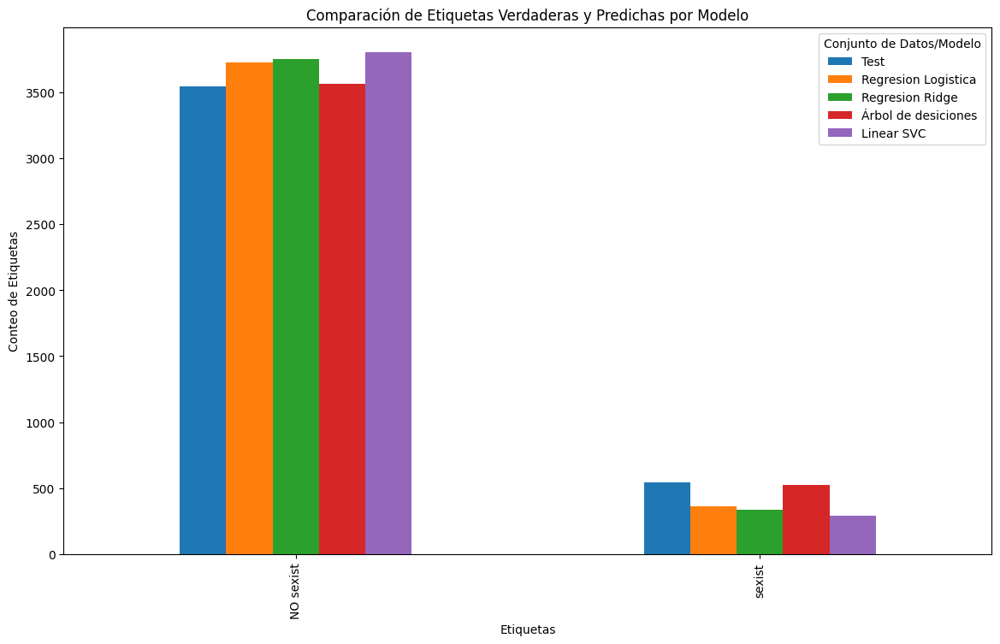

#### **Validación Cruzada**

En este apartado, llevaremos a cabo un proceso de Validación Cruzada para evaluar el desempeño del modelo de SVC Linear al enfrentarlo a datos no vistos.

Es fundamental destacar que probar un modelo de clasificación con los mismos datos utilizados para su entrenamiento representa un error metodológico. Si el modelo simplemente replica lo que ya ha aprendido, podría obtener una puntuación perfecta, pero carecería de utilidad para procesar nuevos datos. Este fenómeno se conoce como sobreajuste. La Validación Cruzada surge como una técnica efectiva para evitar este problema y obtener una estimación más precisa de cómo se comportará el modelo al ser aplicado a nuevos datos no contemplados durante la fase de entrenamiento.

¿Cómo funciona en `sklearn`?

* Divide el conjunto de datos original en k subconjuntos (folds) aleatorios y disjuntos (no comparten elementos).
* Se realiza un proceso de entrenamiento y validación en k iteraciones.
* En cada iteración:
   * Se utiliza un fold como conjunto de validación (datos que no ha visto el modelo para entrenar).
   * Los restantes k-1 folds se utilizan como conjunto de entrenamiento.
   * Se entrena el modelo con el conjunto de entrenamiento y se evalúa su rendimiento en el conjunto de validación.

`kfold = KFold(n_splits = 10, shuffle = True, random_state=123)`
* `n_splits`: (entero, por defecto 5), Número de pliegues (folds) en que se dividirá el conjunto de datos.
* `shuffle` (booleano, por defecto False), Si se barajan los datos antes de dividirlos en pliegues.
* `random_state` (entero, RandomState instance o None, por defecto None), Semilla aleatoria.

In [ ]:
print("Etiquetas del corpus SeXISM")
print(t)

Etiquetas del corpus SeXISM
0        0
1        0
2        0
3        0
4        0
        ..
13626    0
13627    0
13628    0
13629    0
13630    0
Name: label, Length: 13631, dtype: int64


In [ ]:
print("Primer elemento Corpus SEXISM Vectorizado")
print(X[1])

Primer elemento Corpus SEXISM Vectorizado
  (0, 1028)	0.22372700452848487
  (0, 697)	0.6425118359389882
  (0, 1444)	0.7328879642367051


In [ ]:
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']
kfold = KFold(n_splits = 10,
              shuffle = True,
              random_state=123)
scores = cross_validate(model_SVC, X, t, cv=kfold, scoring=scoring)
print("Accuracy:", np.round(np.mean(scores['test_accuracy']), 3))
print("Precision:", np.round(np.mean(scores['test_precision_macro']), 3))
print("Recall:", np.round(np.mean(scores['test_recall_macro']), 3))
print("F1 Score:", np.round(np.mean(scores['test_f1_macro']), 3))

Accuracy: 0.896
Precision: 0.8
Recall: 0.686
F1 Score: 0.723


#### Tiempos de Procesamiento

In [ ]:
results_VecTFIDF1 = results_VecTFIDF.copy(deep = True)
results_VecTFIDF1.head()

,model,time
0,Regresion Logistica,0.324110
1,Regresion Ridge,0.048556
2,Árbol de desiciones,1.015407
3,Linear SVC,0.023909


In [ ]:
results_VecCount = results_VecTFIDF.copy(deep = True)
results_VecCount.head()

,model,time
0,Regresion Logistica,0.804826
1,Regresion Ridge,0.084453
2,Árbol de desiciones,0.710107
3,Linear SVC,0.045701


In [ ]:
results_VecHASH = results_VecTFIDF.copy(deep = True)
results_VecHASH.head()

,model,time
0,Regresion Logistica,32.085727
1,Regresion Ridge,0.361223
2,Árbol de desiciones,30.160416
3,Linear SVC,0.632736


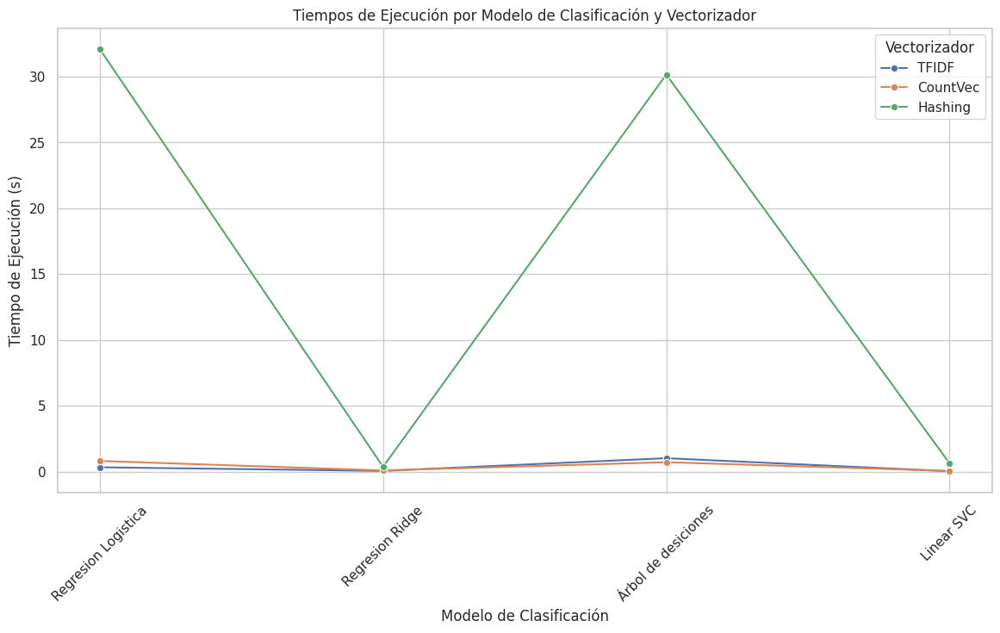

In [ ]:
# Agregar una nueva columna para indicar el tipo de vectorización
results_VecTFIDF1['vectorizer'] = 'TFIDF'
results_VecCount['vectorizer'] = 'CountVec'
results_VecHASH['vectorizer'] = 'Hashing'

# Combinar los tres DataFrames en uno solo
res = pd.concat([results_VecTFIDF1, results_VecCount, results_VecHASH])

# Configuración del estilo de los gráficos
sns.set(style="whitegrid")

# Crear el gráfico de líneas
plt.figure(figsize=(14, 7))
sns.lineplot(data=res, x='model', y='time', hue='vectorizer', marker='o')

# Añadir títulos y etiquetas
plt.title('Tiempos de Ejecución por Modelo de Clasificación y Vectorizador')
plt.xlabel('Modelo de Clasificación')
plt.ylabel('Tiempo de Ejecución (s)')
plt.xticks(rotation=45)
plt.legend(title='Vectorizador')

# Mostrar el gráfico
plt.show()

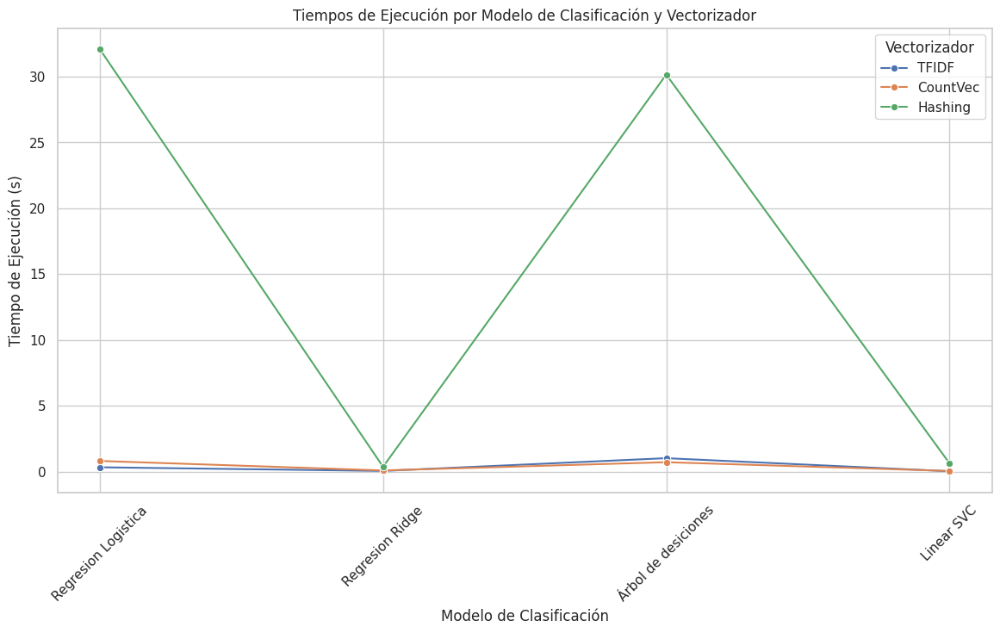

## Para ODIO `df_odio_NOrelation`



In [ ]:
# Función para evaluar el modelo

# TfidfVectorizer
vectorizer_TFIDF = TfidfVectorizer(max_df=0.3,
                             min_df=8,
                             stop_words="english",
                             lowercase=True,
                             use_idf=True,
                             norm="l2",
                             smooth_idf=True
                                   )

#CountVectorizer
vectorizer_CVec = CountVectorizer(strip_accents = "ascii",
                                  lowercase = True,
                                  stop_words = "english",
                                  max_df = 0.3)

#HashingVectorizer
vectorizer_Hashing = HashingVectorizer(lowercase = True,
                                       stop_words = "english",
                                       norm = "l2"
                                       )


def evaluate_model(y_test, y_pred, labels, display_labels):
    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))#, zero_division=0))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

# Función principal que entrena y evalúa los modelos
def train_and_evaluate_models(df, X, labels, tam_test):
    t = df["label"]
    X_train, X_test, y_train, y_test = train_test_split(X, t, test_size=tam_test, random_state=123, stratify=t, shuffle=True)

    # Definición de modelos
    models = {
        "Regresion Logistica": LogisticRegression(C=5, max_iter=10000),
        "Regresion Ridge": RidgeClassifier(tol=1e-2, solver="sparse_cg"),
        "Árbol de desiciones": DecisionTreeClassifier(),
        "Linear SVC": LinearSVC(C=0.1, dual=False, max_iter=1000)
    }

    predictions = {}
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[model_name] = y_pred
        evaluate_model(y_test, y_pred, labels=np.unique(df["label"]), display_labels=labels)

    # Calcular métricas de error
    metrics_error = pd.DataFrame({
        'Modelo': list(models.keys()),
        'MAE': [mean_absolute_error(y_test, predictions[model_name]) for model_name in models.keys()],
        'RMSE': [np.sqrt(mean_squared_error(y_test, predictions[model_name])) for model_name in models.keys()]
    })

    # Convertir los valores de MAE y RMSE a redondeo de 3 decimales
    metrics_error[['MAE', 'RMSE']] = metrics_error[['MAE', 'RMSE']].round(3)

    # Combine las métricas y renombramiento en melt
    metrics_error_combined = metrics_error.melt(id_vars='Modelo', var_name='Errores', value_name='Score')

    # Crear el gráfico de barras horizontal con Seaborn
    sns.barplot(x='Score', y='Modelo', hue='Errores', data=metrics_error_combined)
    plt.xlabel('Score')
    plt.ylabel('Modelo')
    plt.title('Error Absoluto Medio (MAE) y Error cuadrático medio (RMSE) según cada modelo (Manteniendo vectorización TfidfVectorizer)')
    plt.legend(title='Errores')
    plt.tight_layout()  # Mejorar automáticamente el diseño
    plt.show()

    # Calcular la precisión de cada modelo
    accuracies = {model_name: accuracy_score(y_test, predictions[model_name]) for model_name in models.keys()}

    # Preparar datos para la gráfica de barras
    mod = list(models.keys())
    acc = list(accuracies.values())

    # Crear gráfica de barras
    plt.figure(figsize=(10, 7), dpi=200)
    bars = plt.bar(mod, acc, color=['blue', 'green', 'red', 'purple'])

    # Añadir etiquetas y título
    plt.xlabel('Modelos')
    plt.ylabel('Precisión')
    plt.title('Comparación de Precisión entre Modelos')
    plt.ylim(0, 1)

    # Añadir etiquetas de valor en las barras
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 3), ha='center', va='bottom')

    plt.show()

    # Conteo de etiquetas en y_test
    unique_labels = np.unique(y_test)
    label_names = {0: "NO sexist", 1: "sexist"}
    y_test_counts = [np.sum(y_test == label) for label in unique_labels]

    # Conteo de etiquetas predichas por cada modelo
    pred_counts = {
        'Regresion Logistica': [np.sum(predictions['Regresion Logistica'] == label) for label in unique_labels],
        'Regresion Ridge': [np.sum(predictions['Regresion Ridge'] == label) for label in unique_labels],
        'Árbol de desiciones': [np.sum(predictions['Árbol de desiciones'] == label) for label in unique_labels],
        'Linear SVC': [np.sum(predictions['Linear SVC'] == label) for label in unique_labels]
    }

    # Crear DataFrame para graficar
    df_test_counts = pd.DataFrame({'Test': y_test_counts}, index=[label_names[label] for label in unique_labels])
    df_pred_counts = pd.DataFrame(pred_counts, index=[label_names[label] for label in unique_labels])

    # Combinar DataFrame para graficar
    df_combined = pd.concat([df_test_counts, df_pred_counts], axis=1)

    # Crear gráfica de barras agrupada por modelo
    df_combined.plot(kind='bar', figsize=(14, 8))

    # Añadir etiquetas y título
    plt.xlabel('Etiquetas')
    plt.ylabel('Conteo de Etiquetas')
    plt.title('Comparación de Etiquetas Verdaderas y Predichas por Modelo')
    plt.legend(title='Conjunto de Datos/Modelo')

    # Mostrar la gráfica
    plt.show()

    # Función para entrenar y evaluar modelos
    def train_and_evaluate_time(X_train, X_test, y_train, y_test):
        results = []

        for model_name, model in models.items():
            start_time = time.time()
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            end_time = time.time()
            results.append({
                "model": model_name,
                "time": end_time - start_time
            })

        df_tiempo = pd.DataFrame(results)
        return df_tiempo

    results = train_and_evaluate_time(X_train, X_test, y_train, y_test)

    return results

In [ ]:
df_odio_NOrelation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_NOrelation.csv")
df_odio_NOrelation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


Se etiquetaron correctamente 2891 de un total de 3211 muestras.
Errores
MAE: 0.1
MSE: 0.316


              precision    recall  f1-score   support

           0       0.91      0.98      0.95      2852
           1       0.62      0.27      0.38       359

    accuracy                           0.90      3211
   macro avg       0.77      0.63      0.66      3211
weighted avg       0.88      0.90      0.88      3211



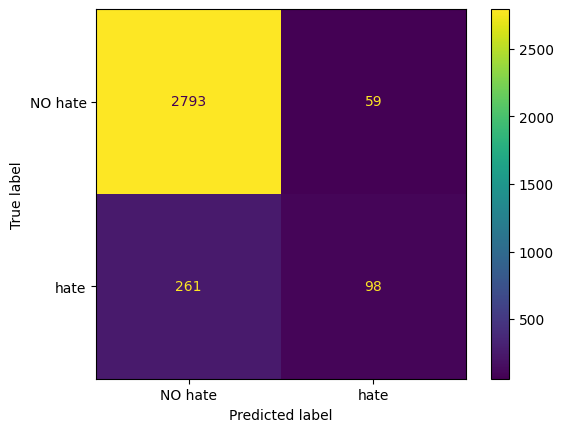

Se etiquetaron correctamente 2905 de un total de 3211 muestras.
Errores
MAE: 0.095
MSE: 0.309


              precision    recall  f1-score   support

           0       0.91      0.99      0.95      2852
           1       0.71      0.25      0.37       359

    accuracy                           0.90      3211
   macro avg       0.81      0.62      0.66      3211
weighted avg       0.89      0.90      0.88      3211



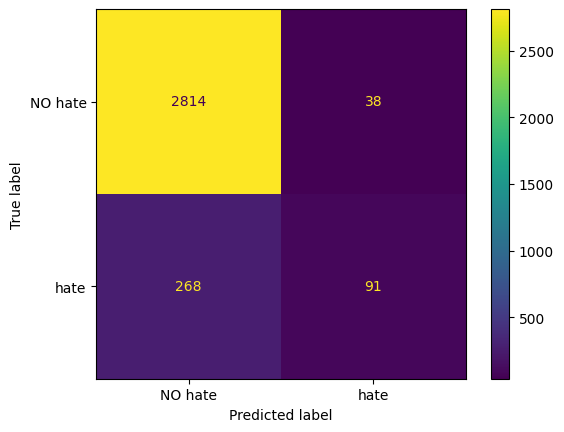

Se etiquetaron correctamente 2766 de un total de 3211 muestras.
Errores
MAE: 0.139
MSE: 0.372


              precision    recall  f1-score   support

           0       0.91      0.93      0.92      2852
           1       0.35      0.28      0.31       359

    accuracy                           0.86      3211
   macro avg       0.63      0.61      0.62      3211
weighted avg       0.85      0.86      0.85      3211



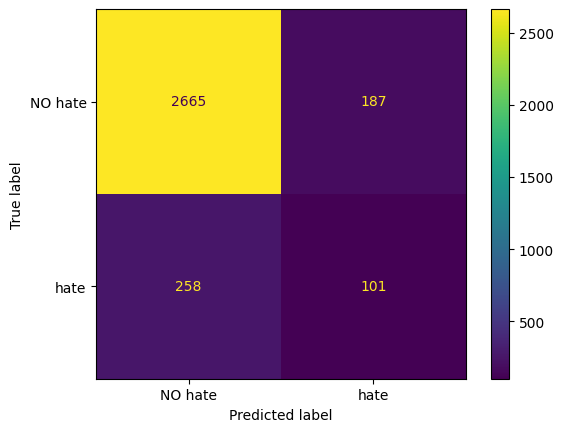

Se etiquetaron correctamente 2866 de un total de 3211 muestras.
Errores
MAE: 0.107
MSE: 0.328


              precision    recall  f1-score   support

           0       0.90      1.00      0.94      2852
           1       0.68      0.08      0.14       359

    accuracy                           0.89      3211
   macro avg       0.79      0.54      0.54      3211
weighted avg       0.87      0.89      0.85      3211



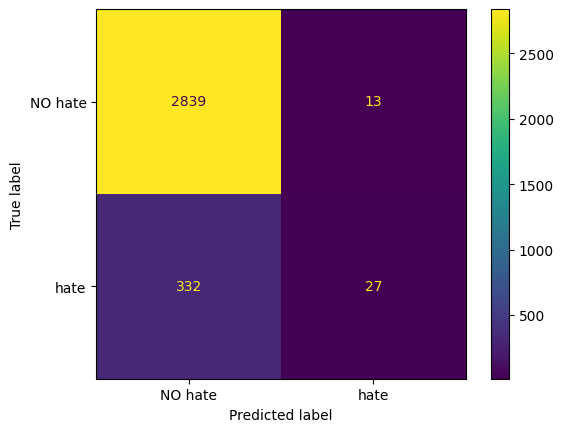

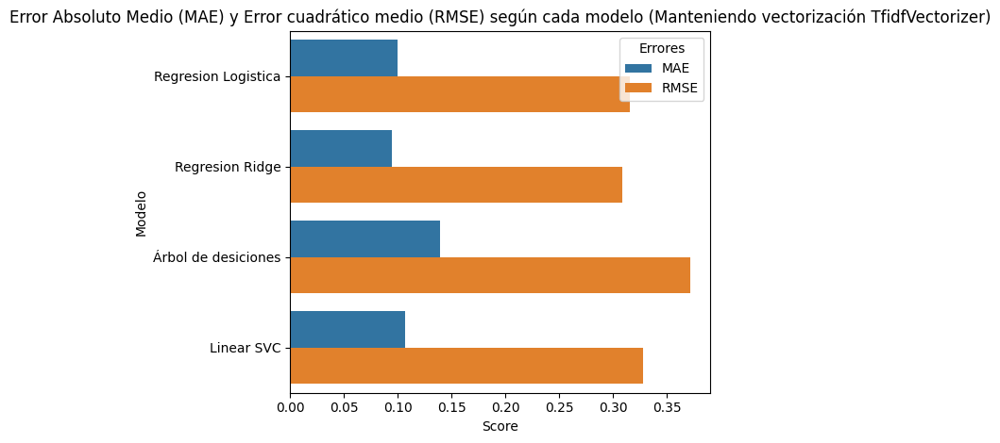

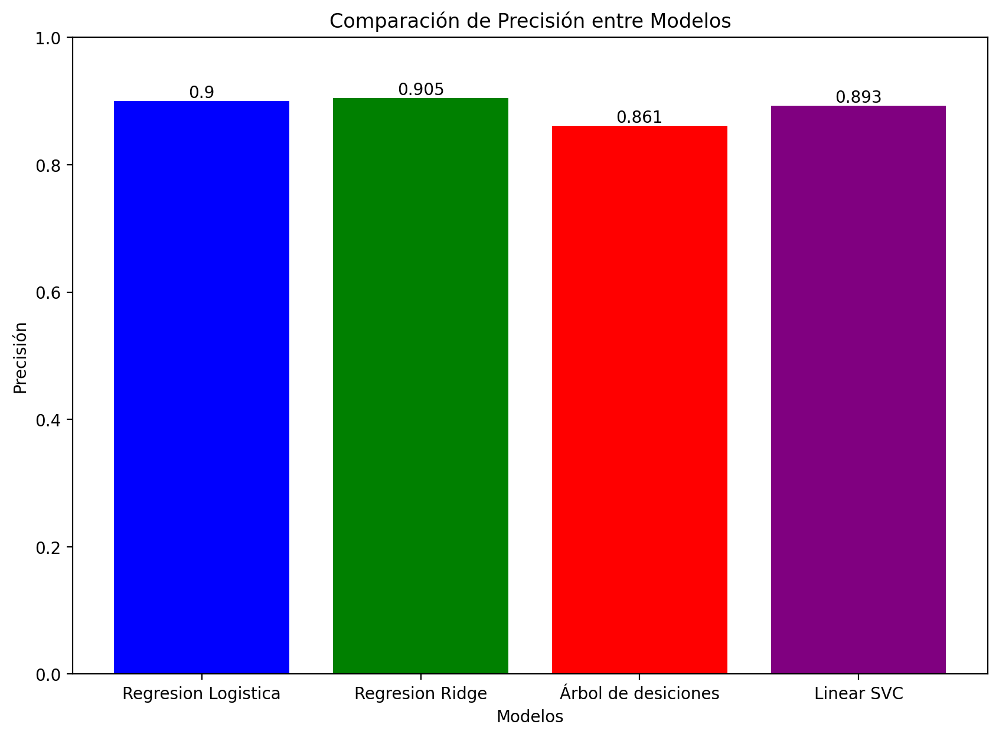

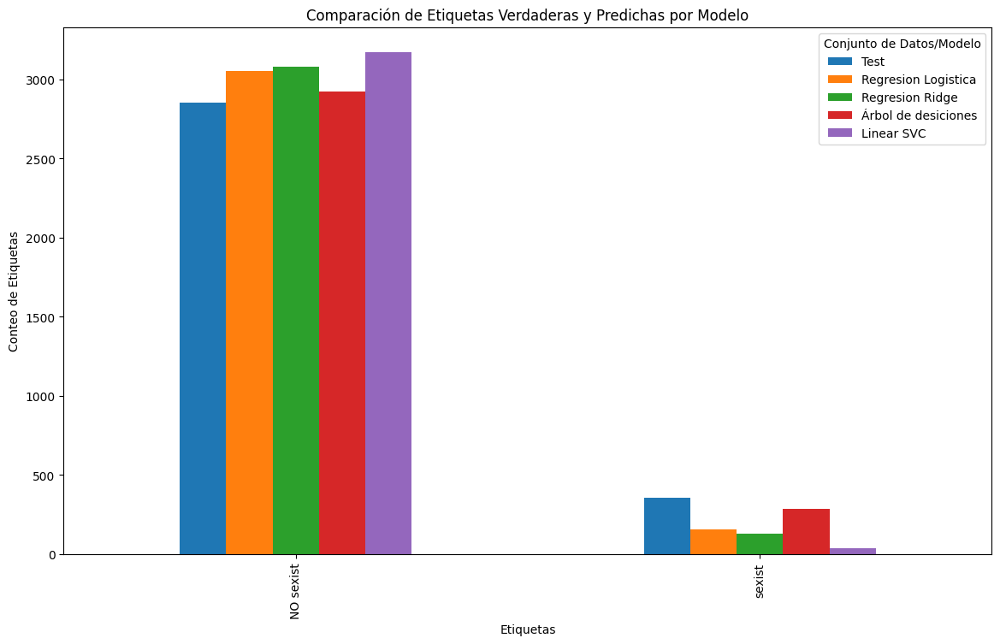

Se etiquetaron correctamente 2874 de un total de 3211 muestras.
Errores
MAE: 0.105
MSE: 0.324


              precision    recall  f1-score   support

           0       0.92      0.96      0.94      2852
           1       0.55      0.35      0.43       359

    accuracy                           0.90      3211
   macro avg       0.73      0.66      0.68      3211
weighted avg       0.88      0.90      0.88      3211



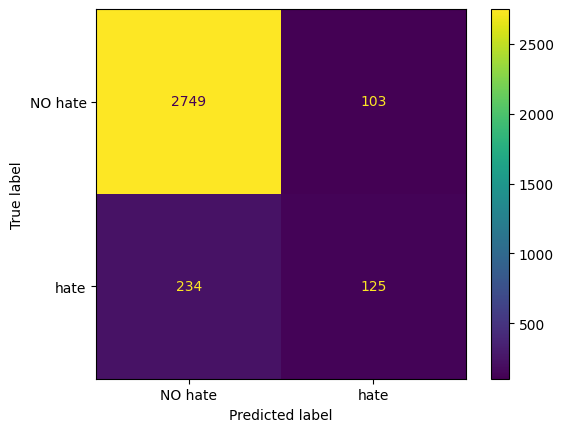

Se etiquetaron correctamente 2877 de un total de 3211 muestras.
Errores
MAE: 0.104
MSE: 0.323


              precision    recall  f1-score   support

           0       0.92      0.97      0.94      2852
           1       0.56      0.32      0.41       359

    accuracy                           0.90      3211
   macro avg       0.74      0.64      0.68      3211
weighted avg       0.88      0.90      0.88      3211



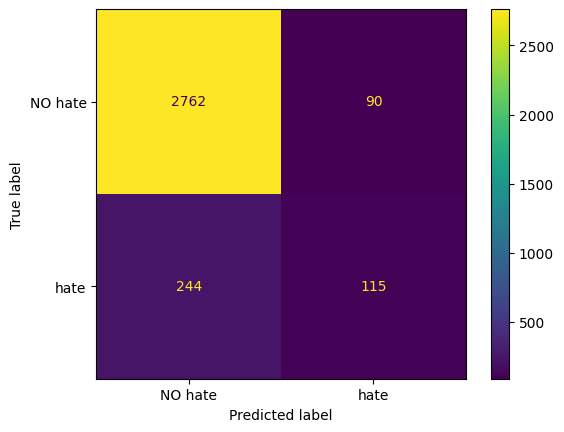

Se etiquetaron correctamente 2814 de un total de 3211 muestras.
Errores
MAE: 0.124
MSE: 0.352


              precision    recall  f1-score   support

           0       0.91      0.96      0.93      2852
           1       0.41      0.25      0.31       359

    accuracy                           0.88      3211
   macro avg       0.66      0.60      0.62      3211
weighted avg       0.85      0.88      0.86      3211



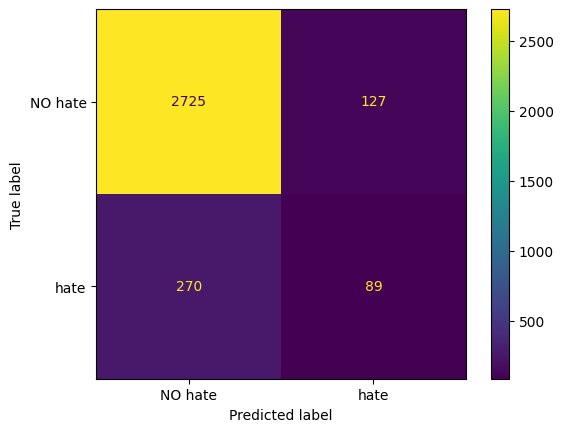

Se etiquetaron correctamente 2892 de un total de 3211 muestras.
Errores
MAE: 0.099
MSE: 0.315


              precision    recall  f1-score   support

           0       0.92      0.98      0.95      2852
           1       0.62      0.28      0.39       359

    accuracy                           0.90      3211
   macro avg       0.77      0.63      0.67      3211
weighted avg       0.88      0.90      0.88      3211



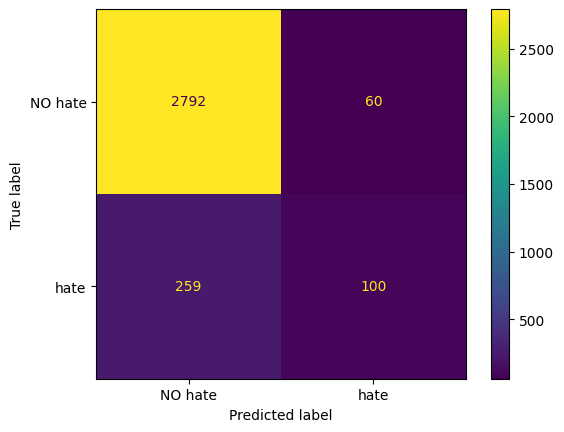

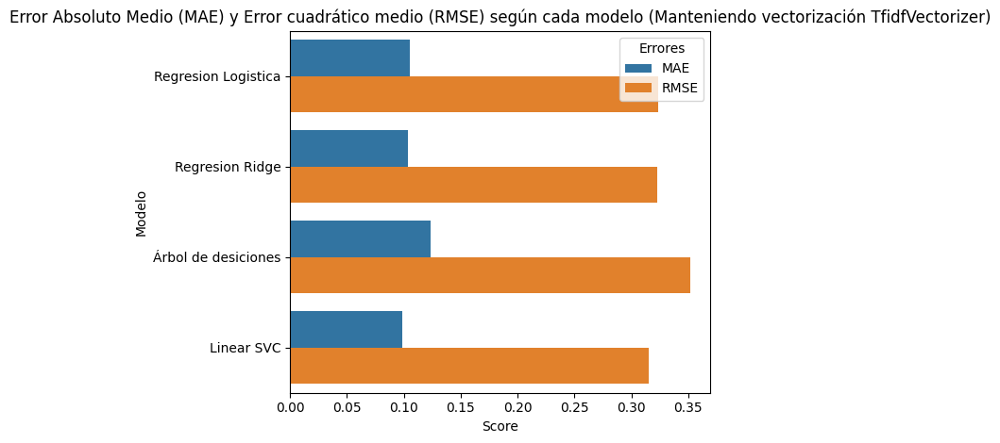

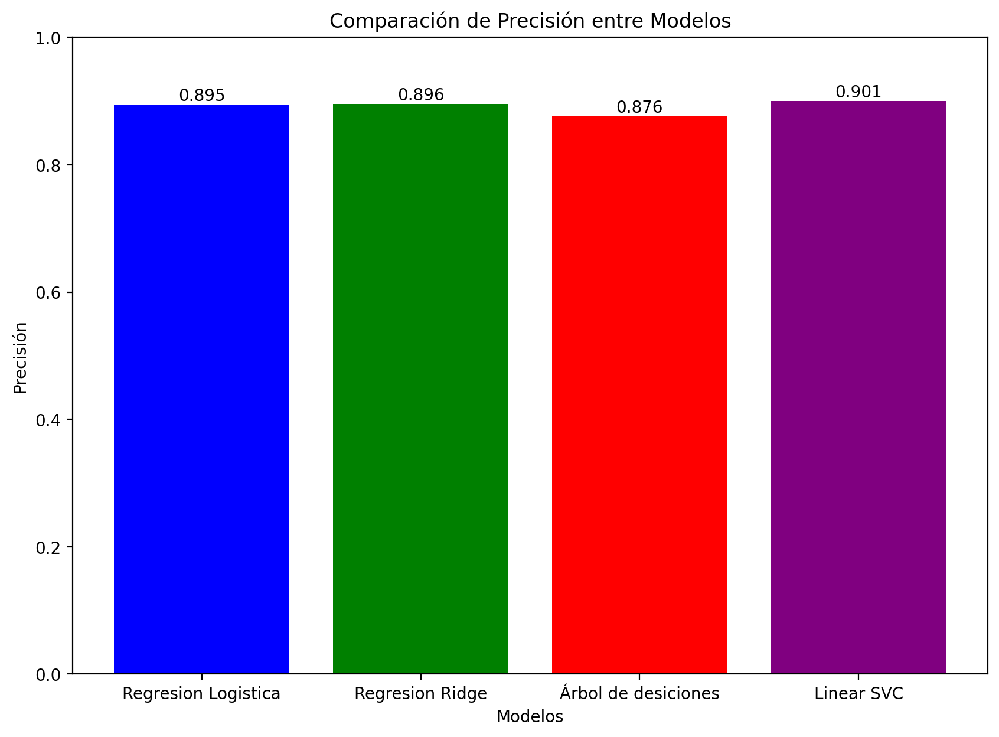

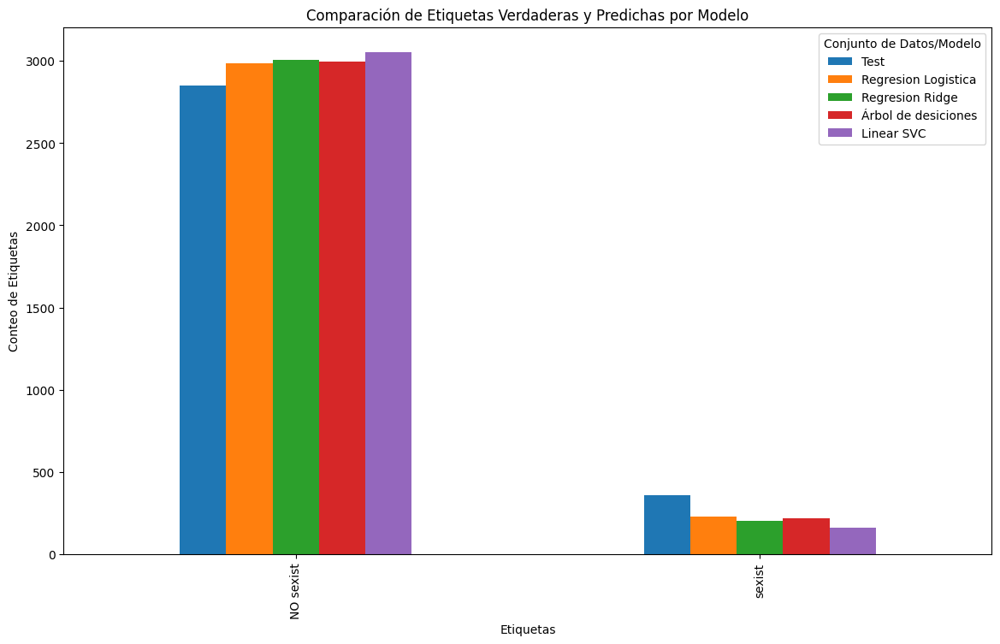

Se etiquetaron correctamente 2889 de un total de 3211 muestras.
Errores
MAE: 0.1
MSE: 0.317


              precision    recall  f1-score   support

           0       0.91      0.99      0.95      2852
           1       0.66      0.22      0.33       359

    accuracy                           0.90      3211
   macro avg       0.78      0.60      0.64      3211
weighted avg       0.88      0.90      0.88      3211



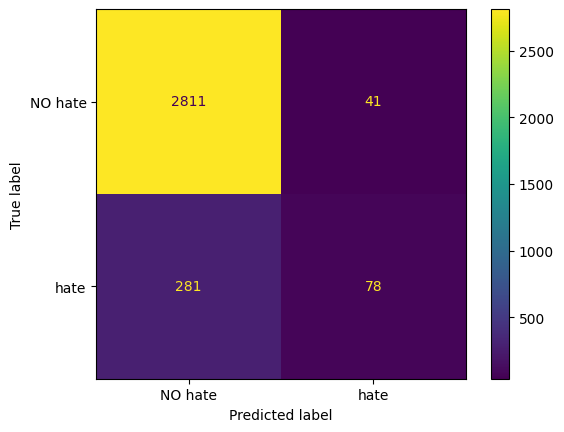

Se etiquetaron correctamente 2898 de un total de 3211 muestras.
Errores
MAE: 0.097
MSE: 0.312


              precision    recall  f1-score   support

           0       0.91      0.99      0.95      2852
           1       0.73      0.20      0.32       359

    accuracy                           0.90      3211
   macro avg       0.82      0.60      0.63      3211
weighted avg       0.89      0.90      0.88      3211



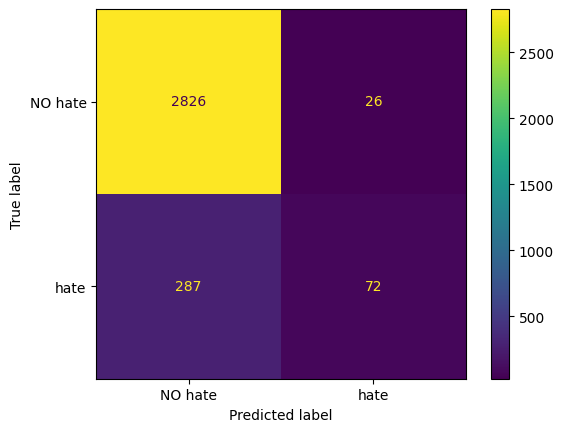

Se etiquetaron correctamente 2794 de un total de 3211 muestras.
Errores
MAE: 0.13
MSE: 0.36


              precision    recall  f1-score   support

           0       0.92      0.94      0.93      2852
           1       0.40      0.32      0.35       359

    accuracy                           0.87      3211
   macro avg       0.66      0.63      0.64      3211
weighted avg       0.86      0.87      0.86      3211



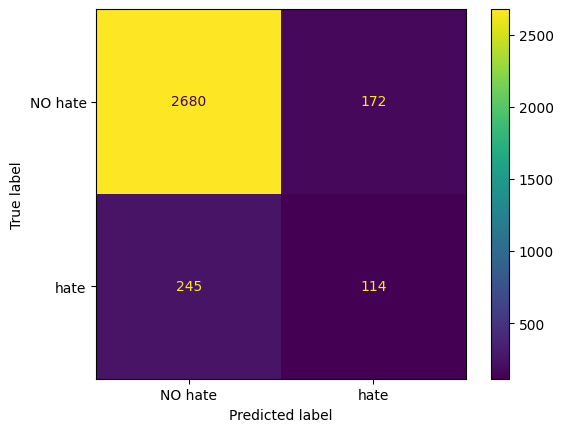

Se etiquetaron correctamente 2859 de un total de 3211 muestras.
Errores
MAE: 0.11
MSE: 0.331


              precision    recall  f1-score   support

           0       0.89      1.00      0.94      2852
           1       0.63      0.05      0.09       359

    accuracy                           0.89      3211
   macro avg       0.76      0.52      0.51      3211
weighted avg       0.86      0.89      0.85      3211



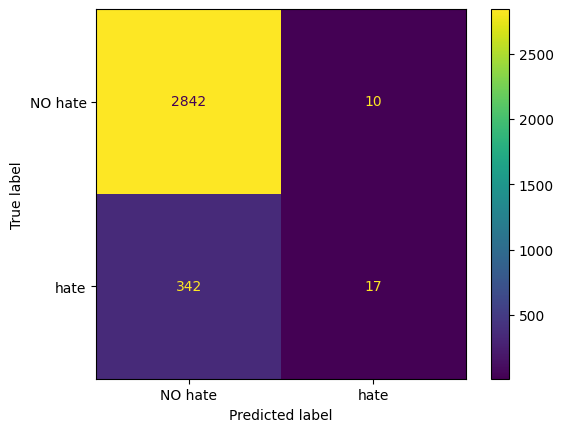

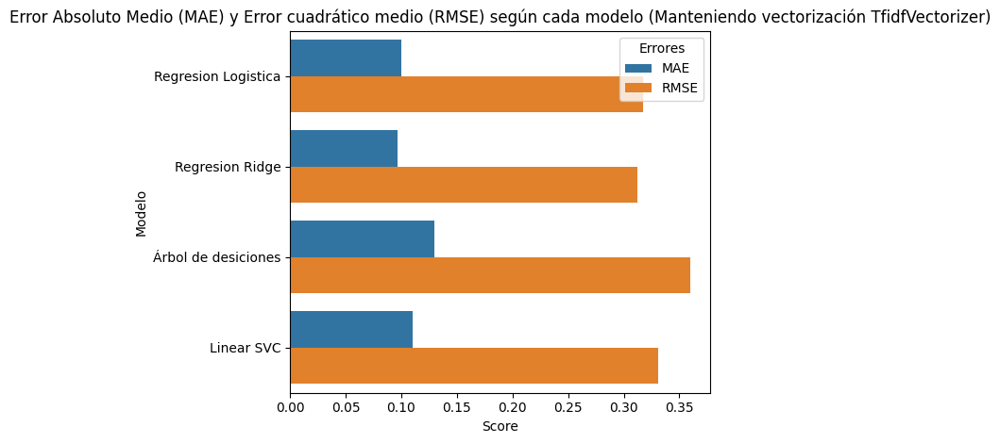

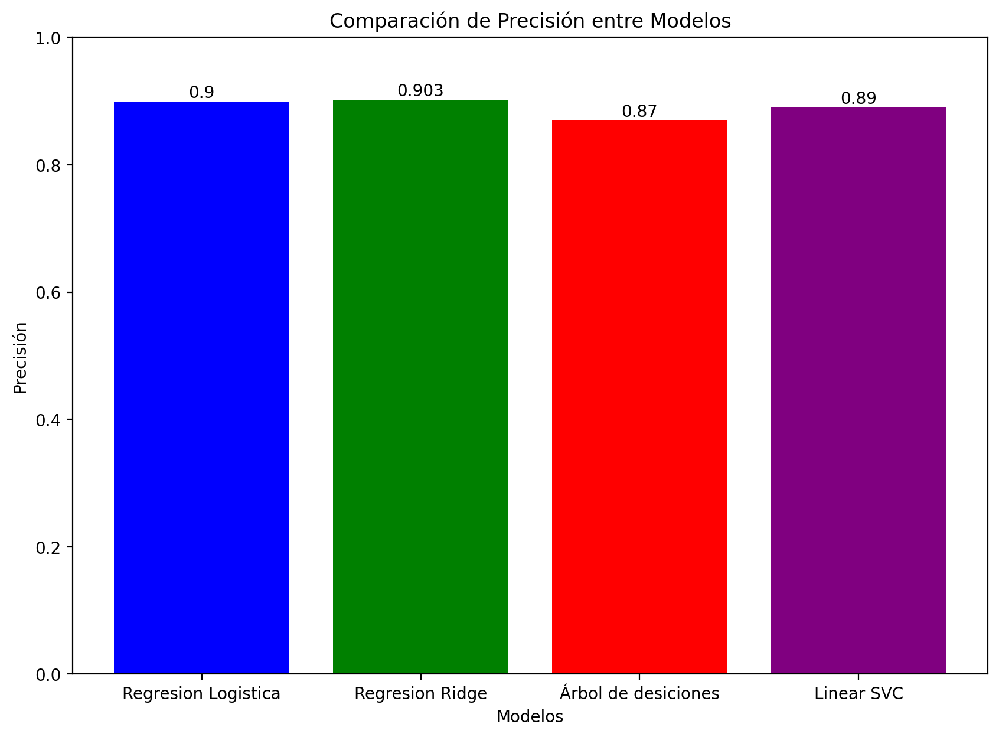

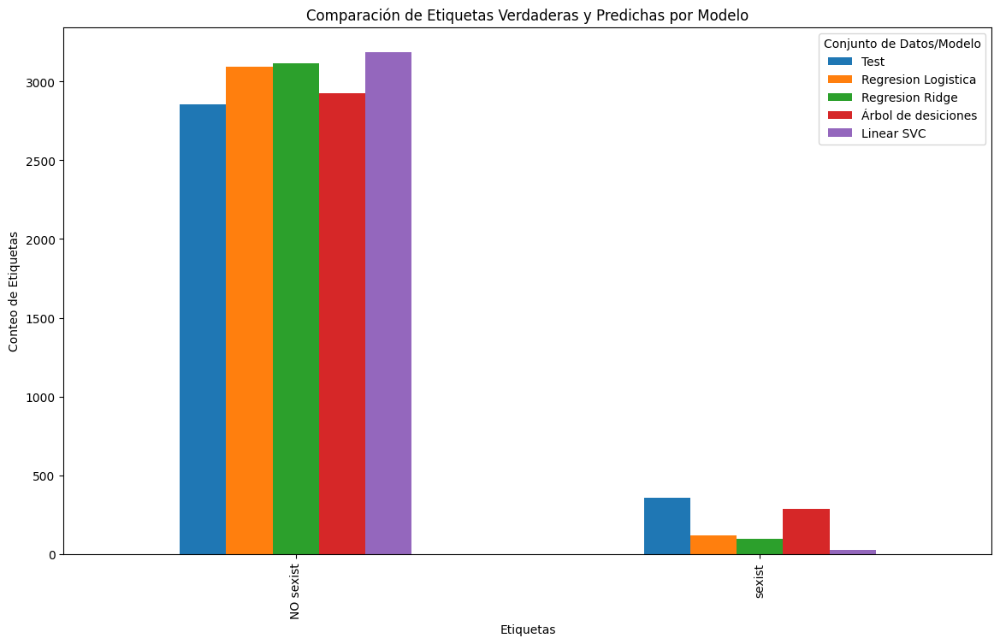

In [ ]:
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_odio_NOrelation["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_odio_NOrelation["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_odio_NOrelation["Lematizado_Stemming"])

categories = ["NO hate", "hate"]
results_VecTFIDF = train_and_evaluate_models(df = df_odio_NOrelation,
                                             X = text_norm_VecTFIDF,
                                             labels = categories,
                                             tam_test = 0.3)

### Regresión Logaritmica

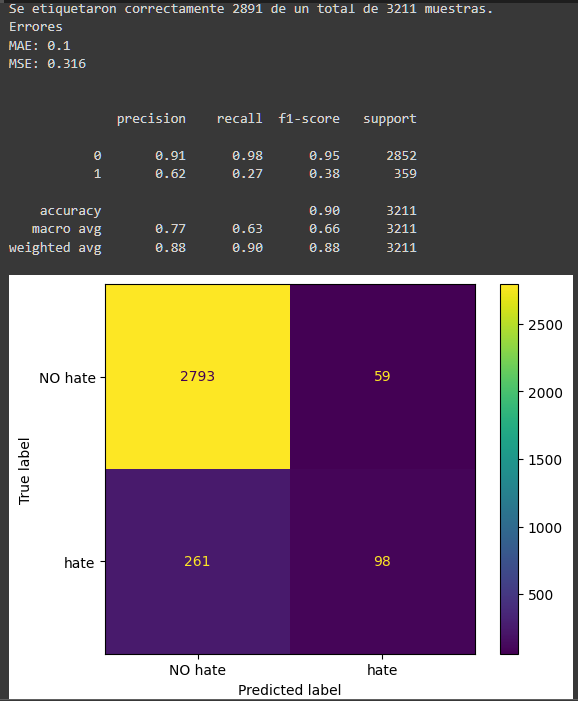

### Regresión Ridge

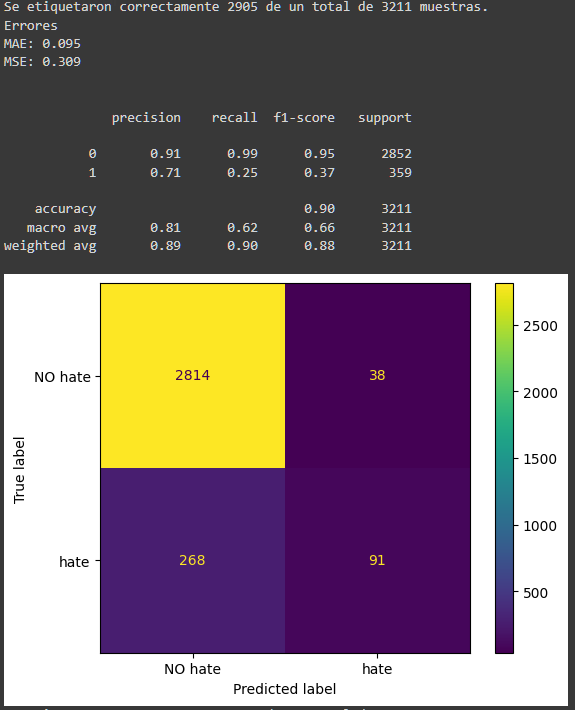

### Árboles de decisiones

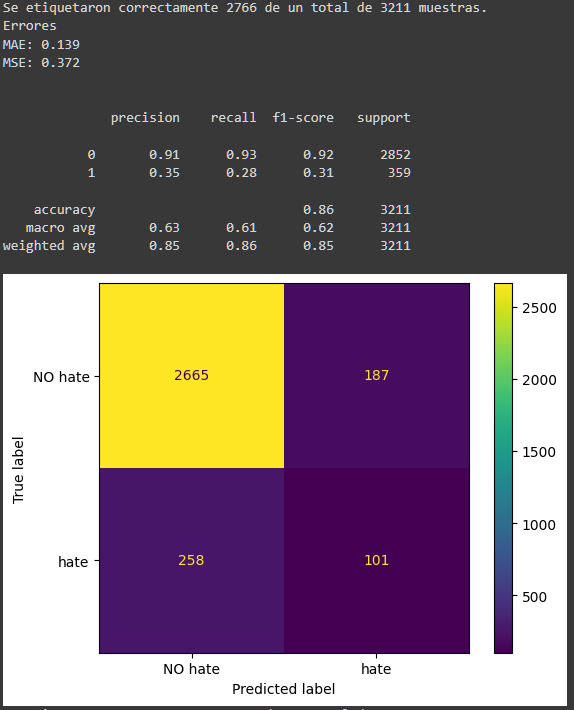

### Linear SVC

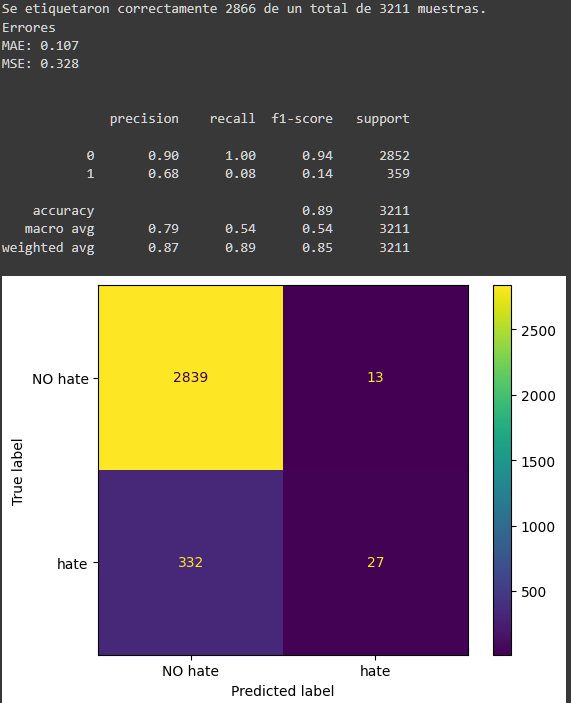

### Comparación de Métricas en modelos con normalización Tf-idf Vectorizer

#### **Errores en las predicciones**

Observemos cual de los modelos tuvo menor error en la prediccion manteniendo la normalizacion por TfidfVectorizer pues vimos que era a la que mejor le iba en cada caso

La comparación de errores en la prediccion de modelos decon normalización Tf-idf Vectorizer permitirá identificar el modelo más preciso y confiable para la tarea de predicción. La normalización Tf-idf Vectorizer garantizará una comparación justa entre los modelos y contribuirá a mejorar la calidad de las predicciones.

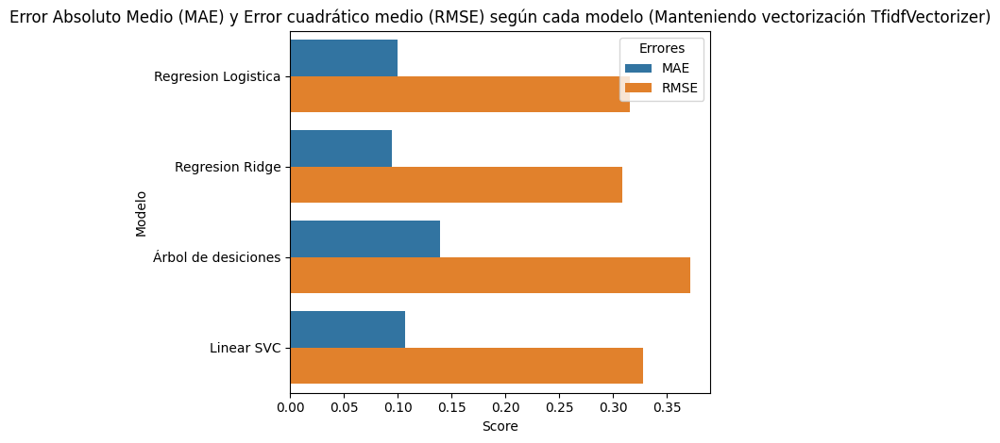

#### **Presición de las Predicciones**

Para el corpus de odio sin la etiqueta `relation`, los 4 modelos en genral obtuvieron buenos resultados. Pero el modelo de clasificación con mayor precisión es Regresión Ridge con una precisión de 0.905.

La superioridad de la Regresión Ridge en este caso se puede atribuir a su capacidad para manejar la multicolinealidad, un fenómeno común en los datos de texto donde las características pueden estar altamente correlacionadas entre sí. La Regresión Ridge regulariza los coeficientes del modelo, lo que ayuda a evitar el sobreajuste y mejora la generalización a nuevos datos




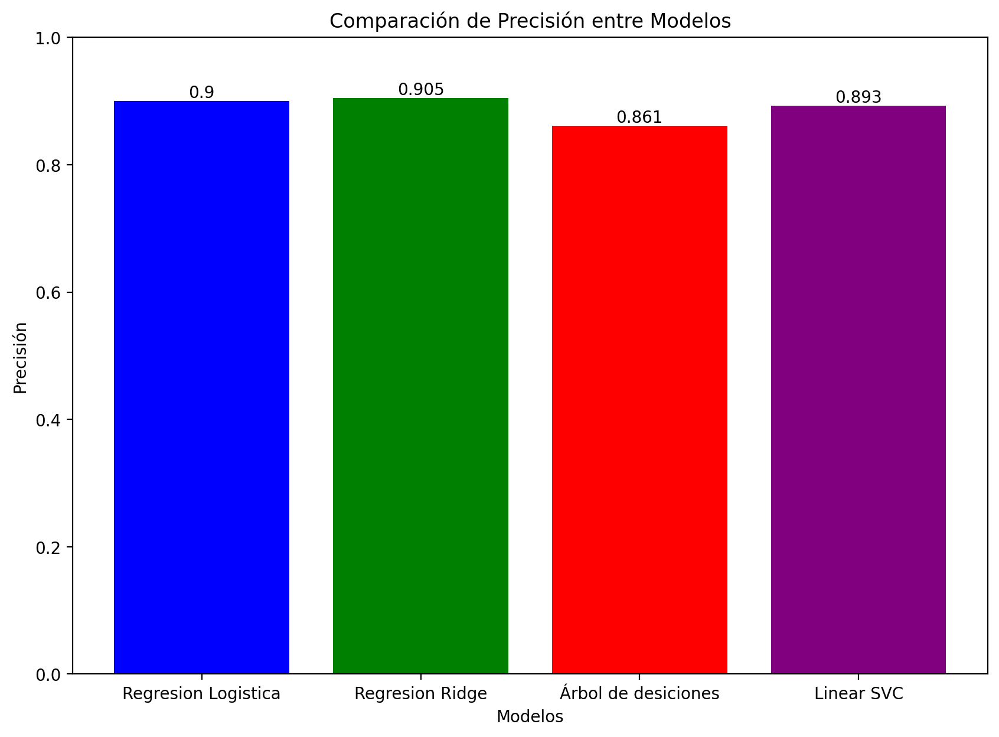

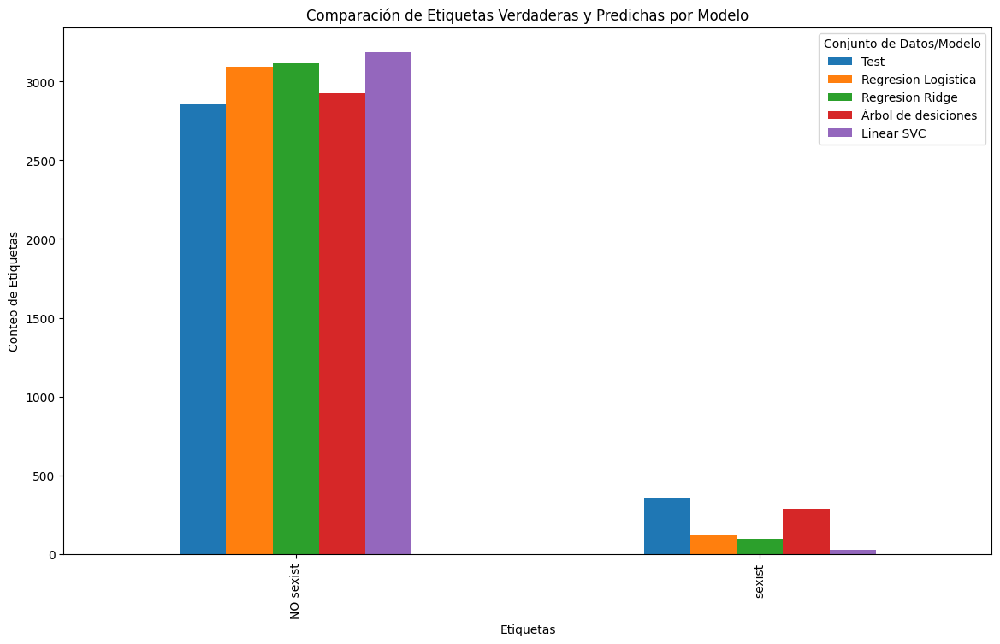

#### **Validación Cruzada**

En este apartado, llevaremos a cabo un proceso de Validación Cruzada para evaluar el desempeño del modelo de SVC Linear al enfrentarlo a datos no vistos.

Es fundamental destacar que probar un modelo de clasificación con los mismos datos utilizados para su entrenamiento representa un error metodológico. Si el modelo simplemente replica lo que ya ha aprendido, podría obtener una puntuación perfecta, pero carecería de utilidad para procesar nuevos datos. Este fenómeno se conoce como sobreajuste. La Validación Cruzada surge como una técnica efectiva para evitar este problema y obtener una estimación más precisa de cómo se comportará el modelo al ser aplicado a nuevos datos no contemplados durante la fase de entrenamiento.

¿Cómo funciona en `sklearn`?

* Divide el conjunto de datos original en k subconjuntos (folds) aleatorios y disjuntos (no comparten elementos).
* Se realiza un proceso de entrenamiento y validación en k iteraciones.
* En cada iteración:
   * Se utiliza un fold como conjunto de validación (datos que no ha visto el modelo para entrenar).
   * Los restantes k-1 folds se utilizan como conjunto de entrenamiento.
   * Se entrena el modelo con el conjunto de entrenamiento y se evalúa su rendimiento en el conjunto de validación.

`kfold = KFold(n_splits = 10, shuffle = True, random_state=123)`
* `n_splits`: (entero, por defecto 5), Número de pliegues (folds) en que se dividirá el conjunto de datos.
* `shuffle` (booleano, por defecto False), Si se barajan los datos antes de dividirlos en pliegues.
* `random_state` (entero, RandomState instance o None, por defecto None), Semilla aleatoria.

In [ ]:
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_odio_NOrelation["Lematizado_Stemming"])
t = df_odio_NOrelation["label"]
tam_test = 0.3
X_train, X_test , y_train, y_test = train_test_split(text_norm_VecTFIDF,
                                                     t,
                                                     test_size = tam_test,
                                                     random_state = 123,
                                                     stratify = t,
                                                     shuffle = True)

In [ ]:
print("Etiquetas del corpus ODIO sin Relation")
print(t)

Etiquetas del corpus ODIO sin Relation
0        0
1        0
2        0
3        1
4        0
        ..
10698    0
10699    0
10700    0
10701    1
10702    0
Name: label, Length: 10703, dtype: int64


In [ ]:
print("Primer elemento Corpus corpus ODIO sin Relation Vectorizado")
print(X[1])

Primer elemento Corpus corpus ODIO sin Relation Vectorizado
  (0, 1587)	0.18095057721498417
  (0, 1573)	0.29287745966365203
  (0, 184)	0.28054600127998136
  (0, 384)	0.29287745966365203
  (0, 1498)	0.26747412862907377
  (0, 561)	0.23245534152854547
  (0, 405)	0.2893844121314114
  (0, 9)	0.253856599352226
  (0, 1688)	0.33793301556037386
  (0, 1434)	0.21621219039829156
  (0, 632)	0.18735696765803872
  (0, 675)	0.2099855164750378
  (0, 1055)	0.23942029888617963
  (0, 423)	0.2449280303748715
  (0, 177)	0.29287745966365203


In [ ]:
model_Ridge = RidgeClassifier(tol=1e-2, solver="sparse_cg")
model_Ridge.fit(X_train, y_train)
y_pred_Ridge = model_Ridge.predict(X_test)

scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']
kfold = KFold(n_splits = 10,
              shuffle = True,
              random_state=123)
scores = cross_validate(model_Ridge, text_norm_VecTFIDF, t, cv=kfold, scoring=scoring)
print("Accuracy:", np.round(np.mean(scores['test_accuracy']), 3))
print("Precision:", np.round(np.mean(scores['test_precision_macro']), 3))
print("Recall:", np.round(np.mean(scores['test_recall_macro']), 3))
print("F1 Score:", np.round(np.mean(scores['test_f1_macro']), 3))

Accuracy: 0.903
Precision: 0.796
Recall: 0.617
F1 Score: 0.656


#### Tiempos de Procesamiento



```
# Agregar una nueva columna para indicar el tipo de vectorización
results_VecTFIDF['vectorizer'] = 'TFIDF'
results_CountVec['vectorizer'] = 'CountVec'
results_HashingVec['vectorizer'] = 'Hashing'

# Combinar los tres DataFrames en uno solo
res = pd.concat([results_VecTFIDF1, results_VecCount, results_VecHASH])

# Configuración del estilo de los gráficos
sns.set(style="whitegrid")

# Crear el gráfico de líneas
plt.figure(figsize=(14, 7))
sns.lineplot(data=res, x='model', y='time', hue='vectorizer', marker='o')

# Añadir títulos y etiquetas
plt.title('Tiempos de Ejecución por Modelo de Clasificación y Vectorizador')
plt.xlabel('Modelo de Clasificación')
plt.ylabel('Tiempo de Ejecución (s)')
plt.xticks(rotation=45)
plt.legend(title='Vectorizador')

# Mostrar el gráfico
plt.show()
```



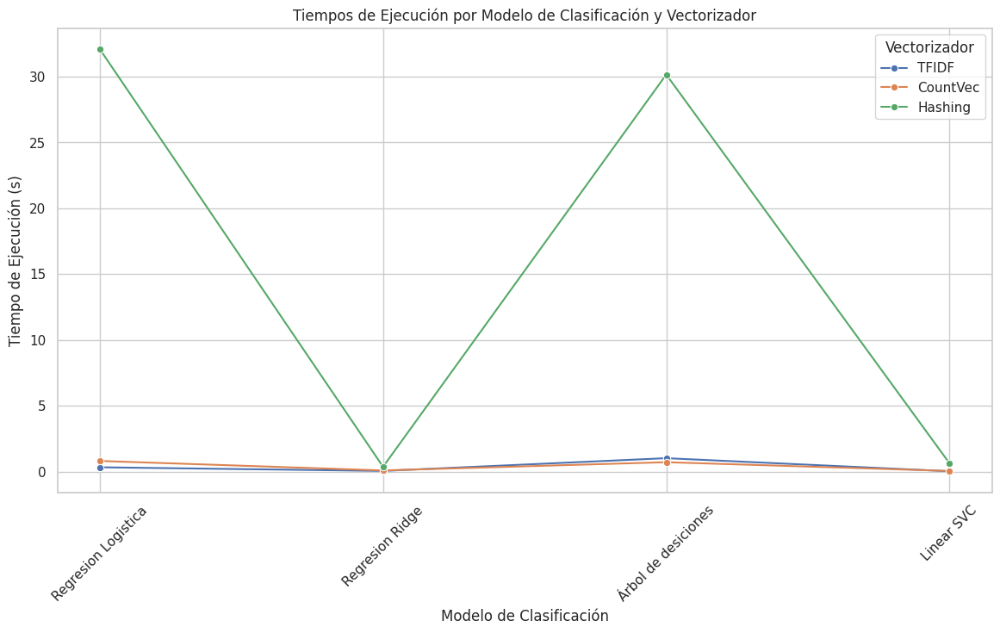

## Para ODIO `df_odio_relation`

In [ ]:
# Función para evaluar el modelo
def evaluate_model(y_test, y_pred, labels, display_labels):
    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))#, zero_division=0))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

# Función principal que entrena y evalúa los modelos
def train_and_evaluate_models(df, X, labels, tam_test):
    t = df["label"]
    X_train, X_test, y_train, y_test = train_test_split(X, t, test_size=tam_test, random_state=123, stratify=t, shuffle=True)

    # Definición de modelos
    models = {
        "Regresion Logistica": LogisticRegression(C=5, max_iter=10000),
        "Regresion Ridge": RidgeClassifier(tol=1e-2, solver="sparse_cg"),
        "Árbol de decisiones": DecisionTreeClassifier(),
        "Linear SVC": LinearSVC(C=0.1, dual=False, max_iter=1000)
    }

    predictions = {}
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[model_name] = y_pred
        evaluate_model(y_test, y_pred, labels=np.unique(df["label"]), display_labels=labels)

    # Calcular métricas de error
    metrics_error = pd.DataFrame({
        'Modelo': list(models.keys()),
        'MAE': [mean_absolute_error(y_test, predictions[model_name]) for model_name in models.keys()],
        'RMSE': [np.sqrt(mean_squared_error(y_test, predictions[model_name])) for model_name in models.keys()]
    })

    # Convertir los valores de MAE y RMSE a redondeo de 3 decimales
    metrics_error[['MAE', 'RMSE']] = metrics_error[['MAE', 'RMSE']].round(3)

    # Combine las métricas y renombramiento en melt
    metrics_error_combined = metrics_error.melt(id_vars='Modelo', var_name='Errores', value_name='Score')

    # Crear el gráfico de barras horizontal con Seaborn
    sns.barplot(x='Score', y='Modelo', hue='Errores', data=metrics_error_combined)
    plt.xlabel('Score')
    plt.ylabel('Modelo')
    plt.title('Error Absoluto Medio (MAE) y Error cuadrático medio (RMSE) según cada modelo (Manteniendo vectorización TfidfVectorizer)')
    plt.legend(title='Errores')
    plt.tight_layout()  # Mejorar automáticamente el diseño
    plt.show()

    # Calcular la precisión de cada modelo
    accuracies = {model_name: accuracy_score(y_test, predictions[model_name]) for model_name in models.keys()}

    # Preparar datos para la gráfica de barras
    mod = list(models.keys())
    acc = list(accuracies.values())

    # Crear gráfica de barras
    plt.figure(figsize=(10, 7), dpi=200)
    bars = plt.bar(mod, acc, color=['blue', 'green', 'red', 'purple'])

    # Añadir etiquetas y título
    plt.xlabel('Modelos')
    plt.ylabel('Precisión')
    plt.title('Comparación de Precisión entre Modelos')
    plt.ylim(0, 1)

    # Añadir etiquetas de valor en las barras
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 3), ha='center', va='bottom')

    plt.show()

    # Conteo de etiquetas en y_test
    unique_labels = np.unique(y_test)
    label_names = {0: "NO hate", 1: "hate"}
    y_test_counts = [np.sum(y_test == label) for label in unique_labels]

    # Conteo de etiquetas predichas por cada modelo
    pred_counts = {
        'Regresion Logistica': [np.sum(predictions['Regresion Logistica'] == label) for label in unique_labels],
        'Regresion Ridge': [np.sum(predictions['Regresion Ridge'] == label) for label in unique_labels],
        'Árbol de decisiones': [np.sum(predictions['Árbol de desiciones'] == label) for label in unique_labels],
        'Linear SVC': [np.sum(predictions['Linear SVC'] == label) for label in unique_labels]
    }

    # Crear DataFrame para graficar
    df_test_counts = pd.DataFrame({'Test': y_test_counts}, index=[label_names[label] for label in unique_labels])
    df_pred_counts = pd.DataFrame(pred_counts, index=[label_names[label] for label in unique_labels])

    # Combinar DataFrame para graficar
    df_combined = pd.concat([df_test_counts, df_pred_counts], axis=1)

    # Crear gráfica de barras agrupada por modelo
    df_combined.plot(kind='bar', figsize=(14, 8))

    # Añadir etiquetas y título
    plt.xlabel('Etiquetas')
    plt.ylabel('Conteo de Etiquetas')
    plt.title('Comparación de Etiquetas Verdaderas y Predichas por Modelo')
    plt.legend(title='Conjunto de Datos/Modelo')

    # Mostrar la gráfica
    plt.show()

    # Función para entrenar y evaluar modelos
    def train_and_evaluate_time(X_train, X_test, y_train, y_test):
        results = []

        for model_name, model in models.items():
            start_time = time.time()
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            end_time = time.time()
            results.append({
                "model": model_name,
                "time": end_time - start_time
            })

        df_tiempo = pd.DataFrame(results)
        return df_tiempo

    results = train_and_evaluate_time(X_train, X_test, y_train, y_test)

    return results

In [ ]:
df_odio_relation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_relation.csv")
df_odio_relation.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


Se etiquetaron correctamente 2912 de un total de 3262 muestras.
Errores
MAE: 0.107
MSE: 0.328


              precision    recall  f1-score   support

           0       0.91      0.98      0.94      2853
           1       0.66      0.30      0.41       409

    accuracy                           0.89      3262
   macro avg       0.78      0.64      0.67      3262
weighted avg       0.88      0.89      0.87      3262



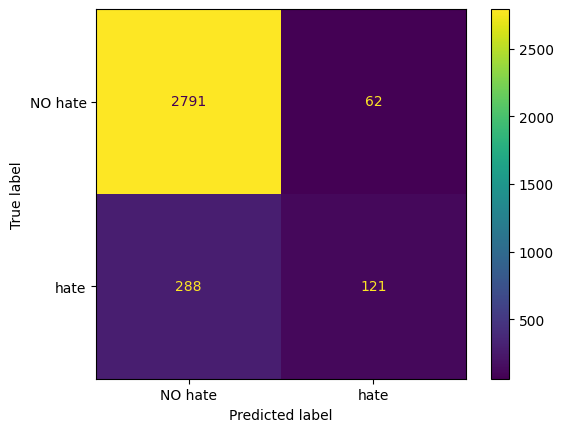

Se etiquetaron correctamente 2914 de un total de 3262 muestras.
Errores
MAE: 0.107
MSE: 0.327


              precision    recall  f1-score   support

           0       0.90      0.98      0.94      2853
           1       0.69      0.27      0.39       409

    accuracy                           0.89      3262
   macro avg       0.80      0.63      0.67      3262
weighted avg       0.88      0.89      0.87      3262



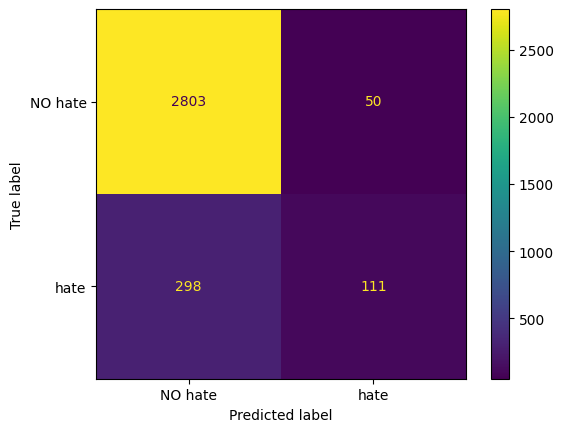

Se etiquetaron correctamente 2775 de un total de 3262 muestras.
Errores
MAE: 0.149
MSE: 0.386


              precision    recall  f1-score   support

           0       0.91      0.92      0.91      2853
           1       0.40      0.40      0.40       409

    accuracy                           0.85      3262
   macro avg       0.66      0.66      0.66      3262
weighted avg       0.85      0.85      0.85      3262



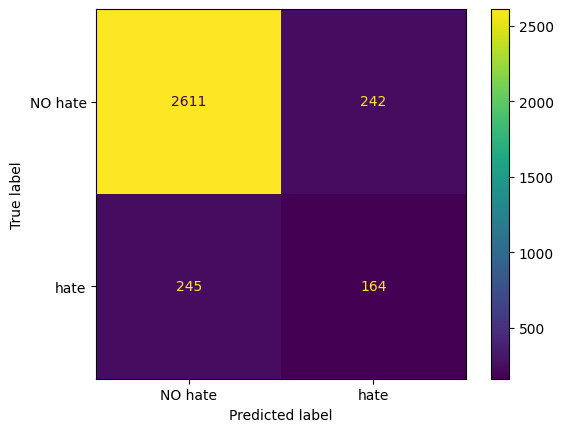

Se etiquetaron correctamente 2885 de un total de 3262 muestras.
Errores
MAE: 0.116
MSE: 0.34


              precision    recall  f1-score   support

           0       0.89      1.00      0.94      2853
           1       0.79      0.11      0.19       409

    accuracy                           0.88      3262
   macro avg       0.84      0.55      0.56      3262
weighted avg       0.87      0.88      0.84      3262



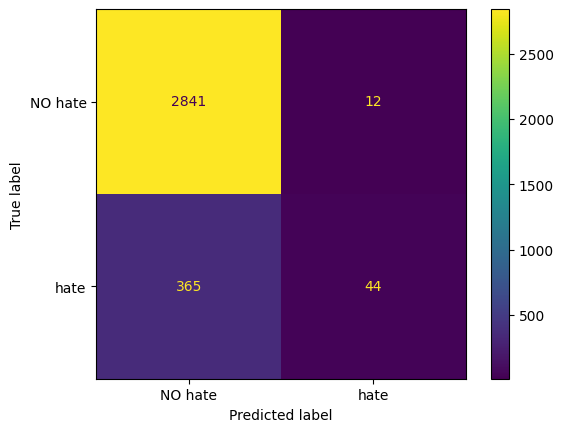

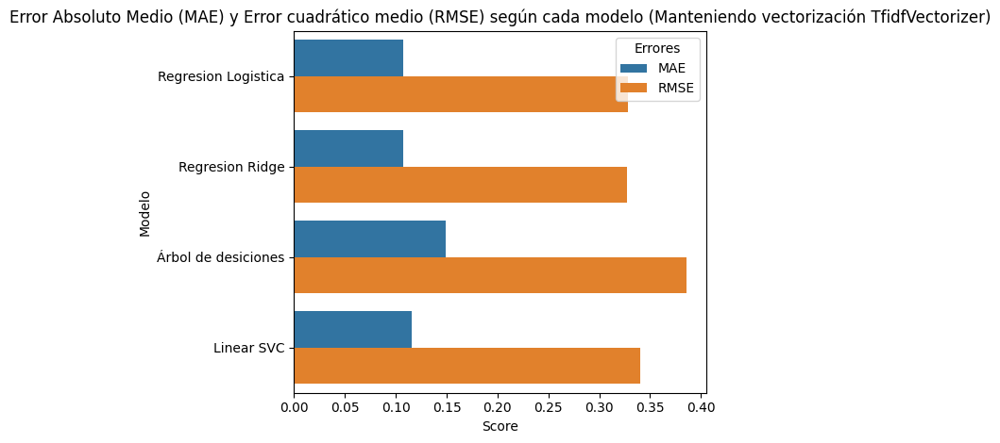

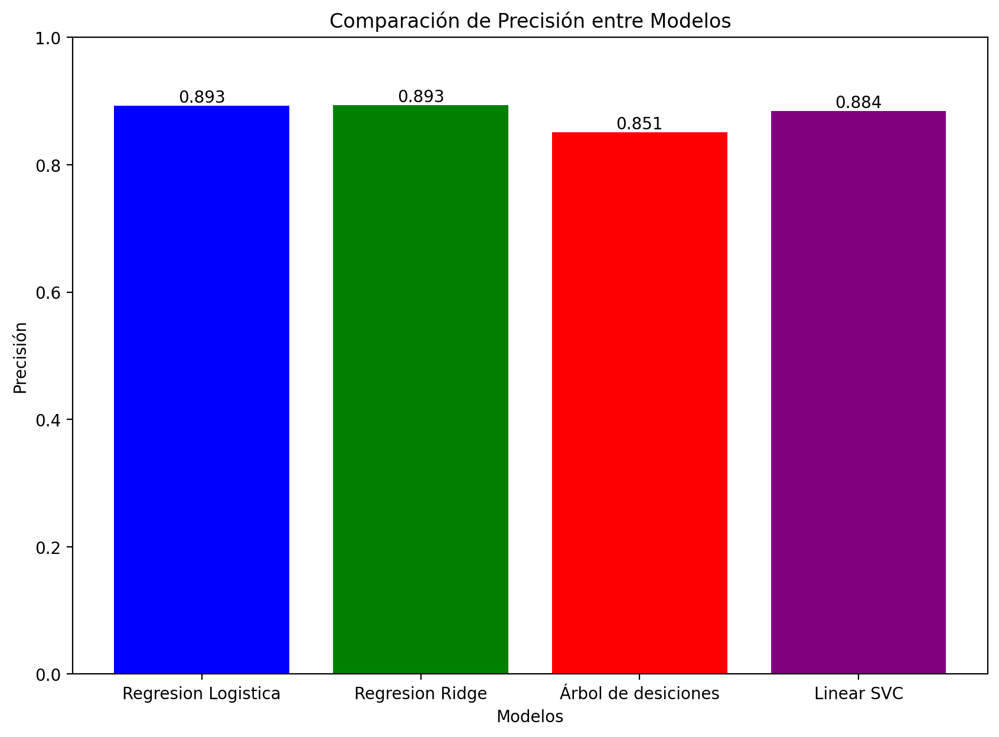

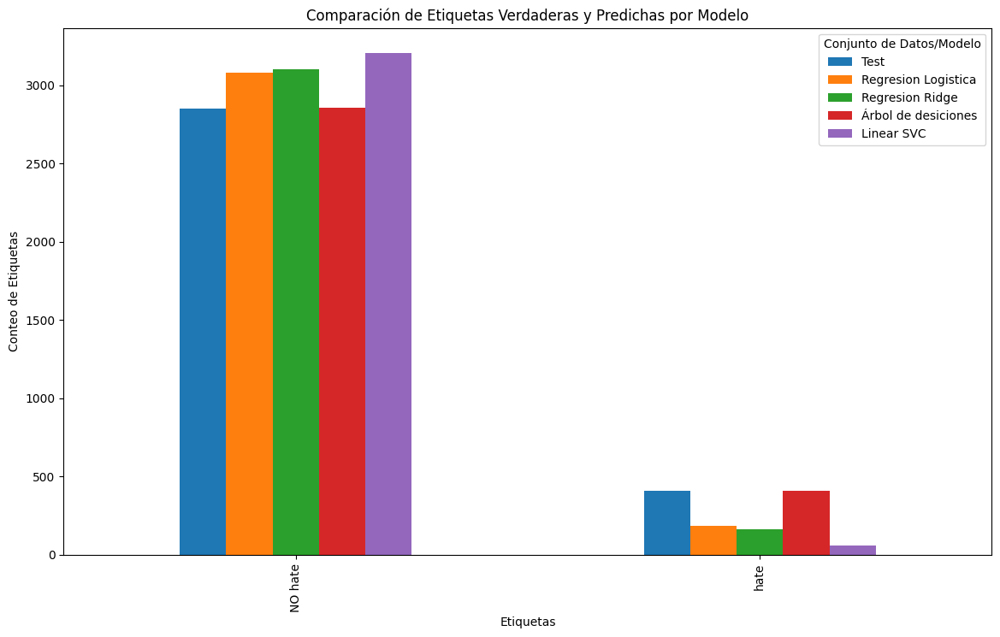

Se etiquetaron correctamente 2889 de un total de 3262 muestras.
Errores
MAE: 0.114
MSE: 0.338


              precision    recall  f1-score   support

           0       0.91      0.96      0.94      2853
           1       0.57      0.34      0.43       409

    accuracy                           0.89      3262
   macro avg       0.74      0.65      0.68      3262
weighted avg       0.87      0.89      0.87      3262



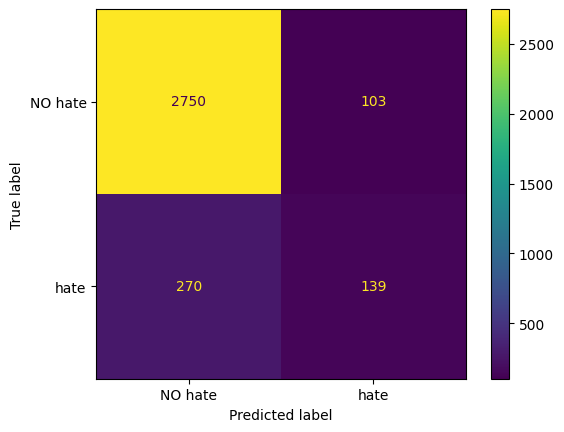

Se etiquetaron correctamente 2876 de un total de 3262 muestras.
Errores
MAE: 0.118
MSE: 0.344


              precision    recall  f1-score   support

           0       0.91      0.96      0.93      2853
           1       0.55      0.34      0.42       409

    accuracy                           0.88      3262
   macro avg       0.73      0.65      0.68      3262
weighted avg       0.86      0.88      0.87      3262



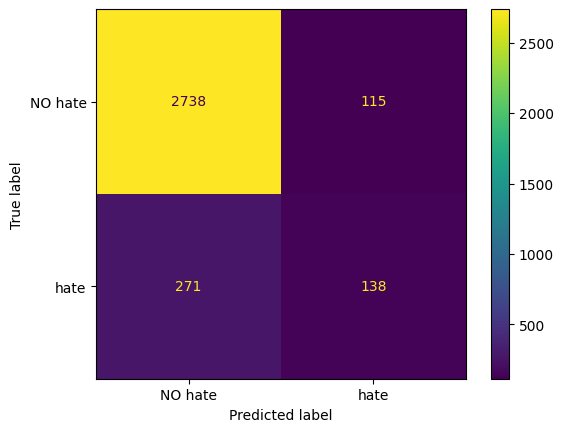

Se etiquetaron correctamente 2829 de un total de 3262 muestras.
Errores
MAE: 0.133
MSE: 0.364


              precision    recall  f1-score   support

           0       0.91      0.94      0.93      2853
           1       0.46      0.33      0.38       409

    accuracy                           0.87      3262
   macro avg       0.68      0.64      0.65      3262
weighted avg       0.85      0.87      0.86      3262



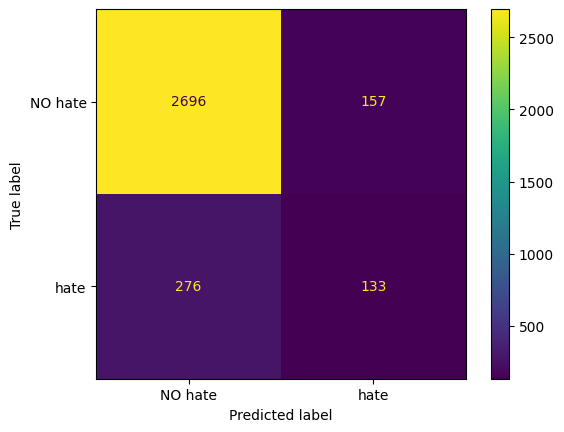

Se etiquetaron correctamente 2901 de un total de 3262 muestras.
Errores
MAE: 0.111
MSE: 0.333


              precision    recall  f1-score   support

           0       0.90      0.98      0.94      2853
           1       0.64      0.27      0.38       409

    accuracy                           0.89      3262
   macro avg       0.77      0.63      0.66      3262
weighted avg       0.87      0.89      0.87      3262



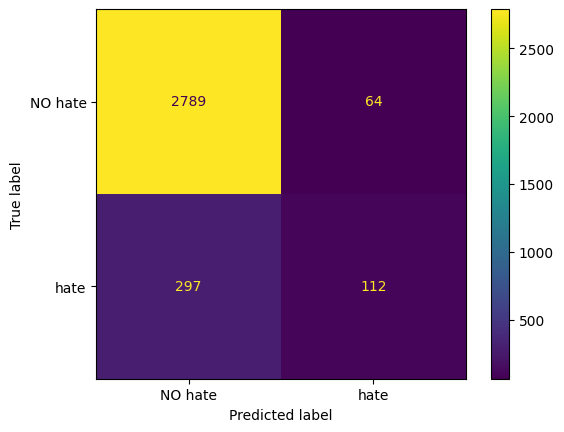

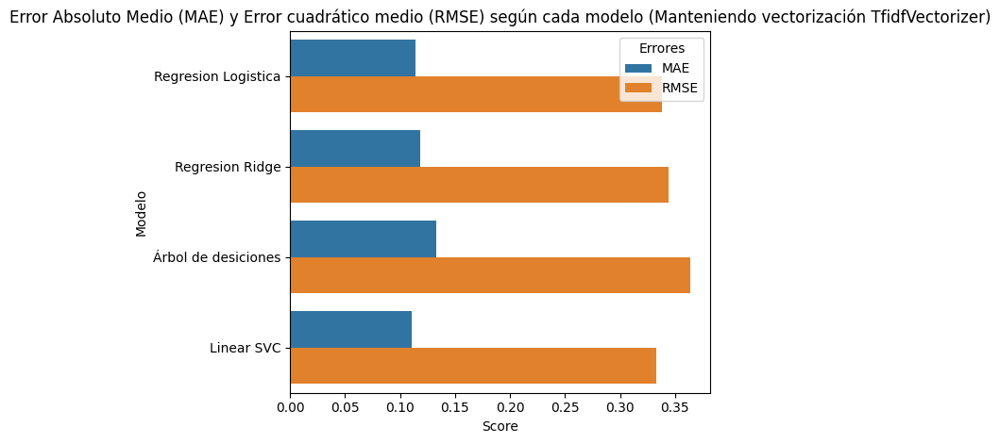

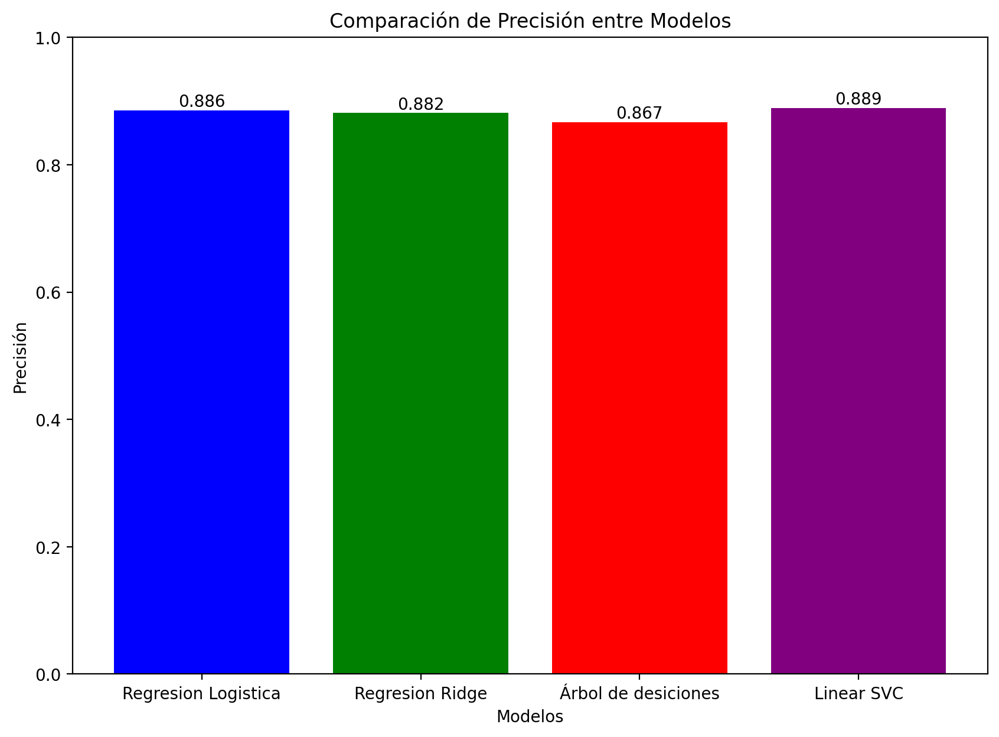

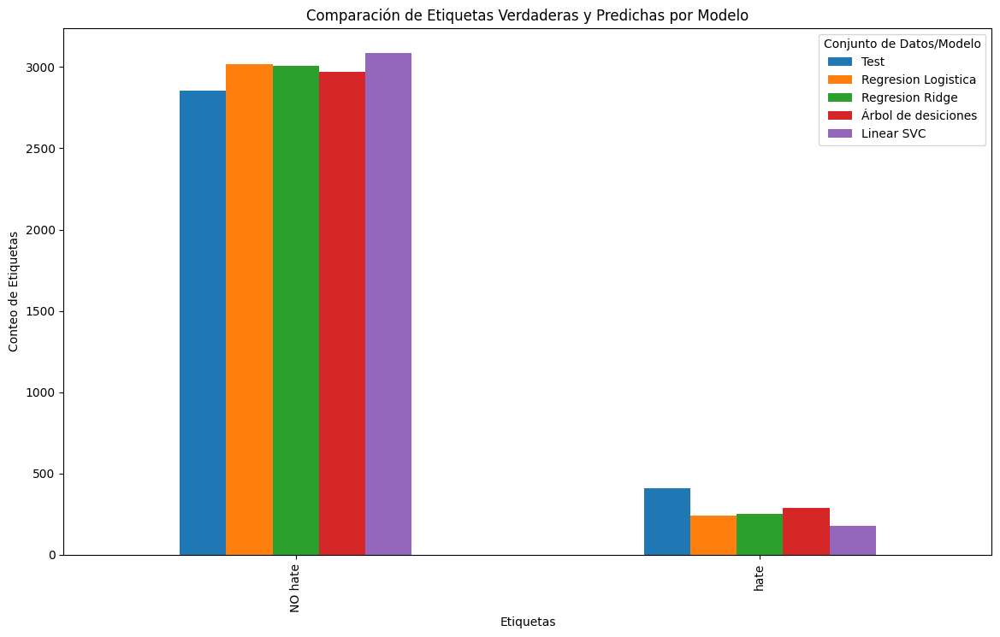

Se etiquetaron correctamente 2904 de un total de 3262 muestras.
Errores
MAE: 0.11
MSE: 0.331


              precision    recall  f1-score   support

           0       0.90      0.98      0.94      2853
           1       0.68      0.23      0.35       409

    accuracy                           0.89      3262
   macro avg       0.79      0.61      0.64      3262
weighted avg       0.87      0.89      0.87      3262



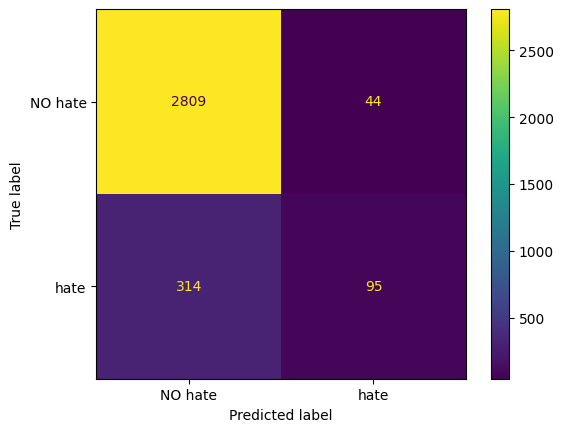

Se etiquetaron correctamente 2908 de un total de 3262 muestras.
Errores
MAE: 0.109
MSE: 0.329


              precision    recall  f1-score   support

           0       0.90      0.99      0.94      2853
           1       0.71      0.22      0.34       409

    accuracy                           0.89      3262
   macro avg       0.81      0.61      0.64      3262
weighted avg       0.88      0.89      0.87      3262



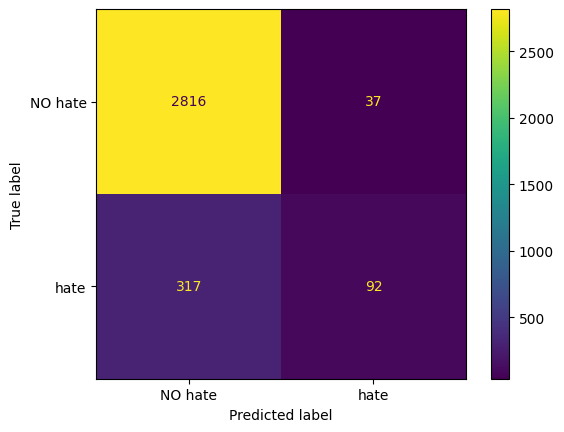

Se etiquetaron correctamente 2824 de un total de 3262 muestras.
Errores
MAE: 0.134
MSE: 0.366


              precision    recall  f1-score   support

           0       0.91      0.94      0.92      2853
           1       0.46      0.38      0.41       409

    accuracy                           0.87      3262
   macro avg       0.68      0.66      0.67      3262
weighted avg       0.86      0.87      0.86      3262



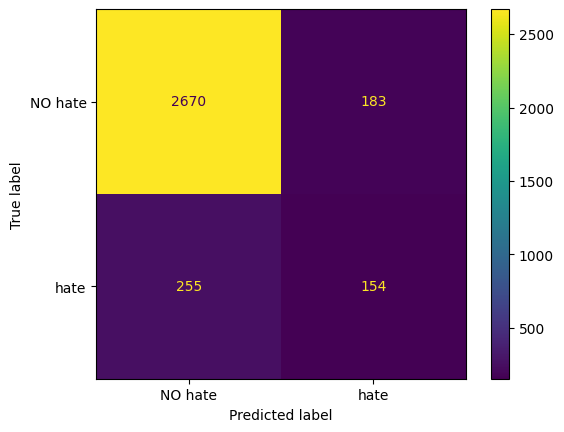

Se etiquetaron correctamente 2871 de un total de 3262 muestras.
Errores
MAE: 0.12
MSE: 0.346


              precision    recall  f1-score   support

           0       0.88      1.00      0.94      2853
           1       0.75      0.07      0.12       409

    accuracy                           0.88      3262
   macro avg       0.82      0.53      0.53      3262
weighted avg       0.87      0.88      0.83      3262



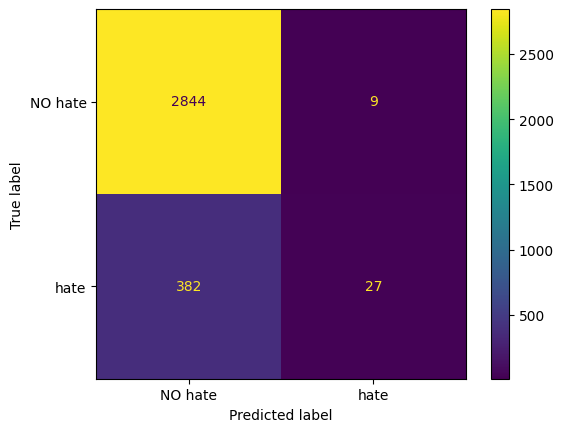

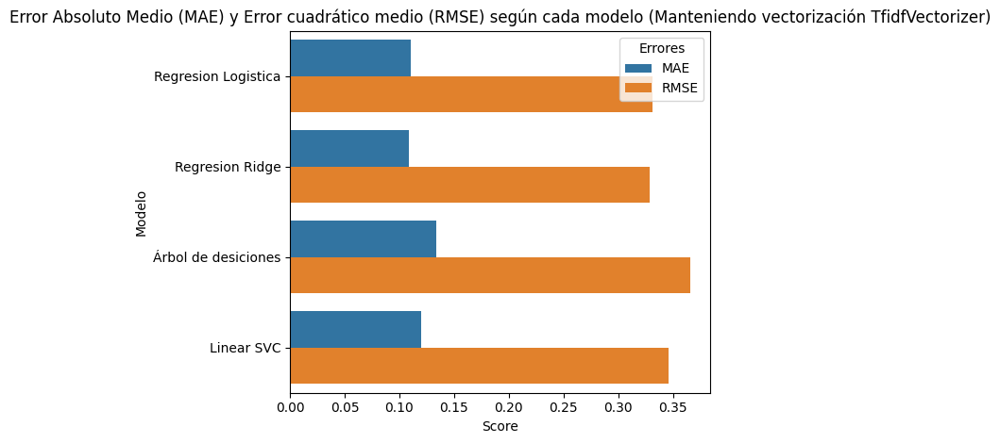

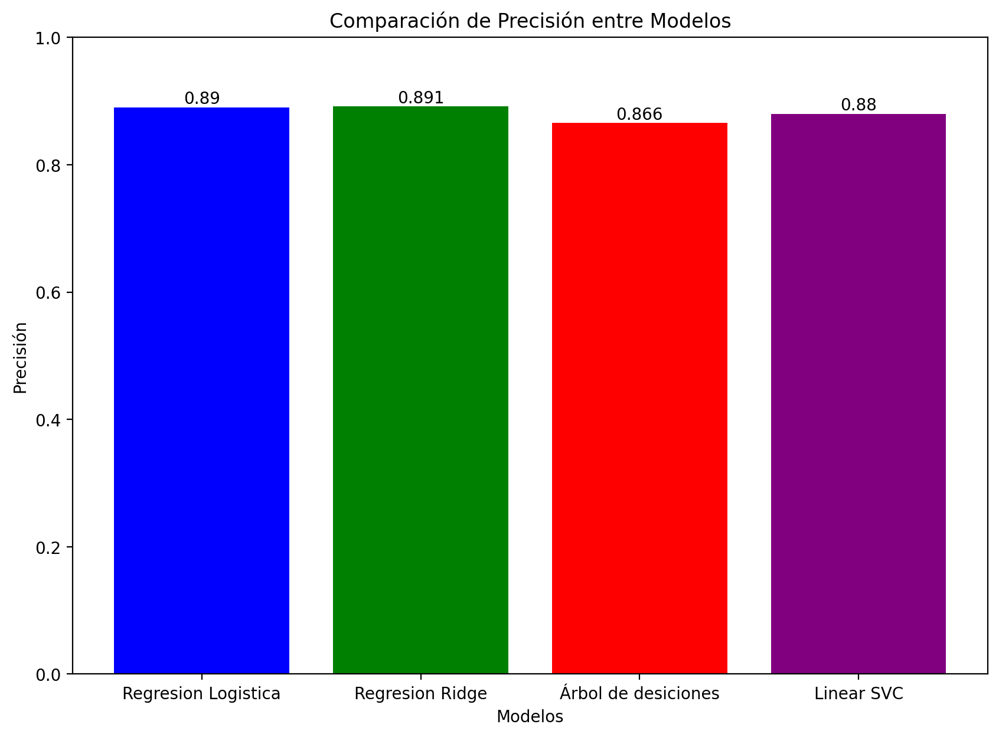

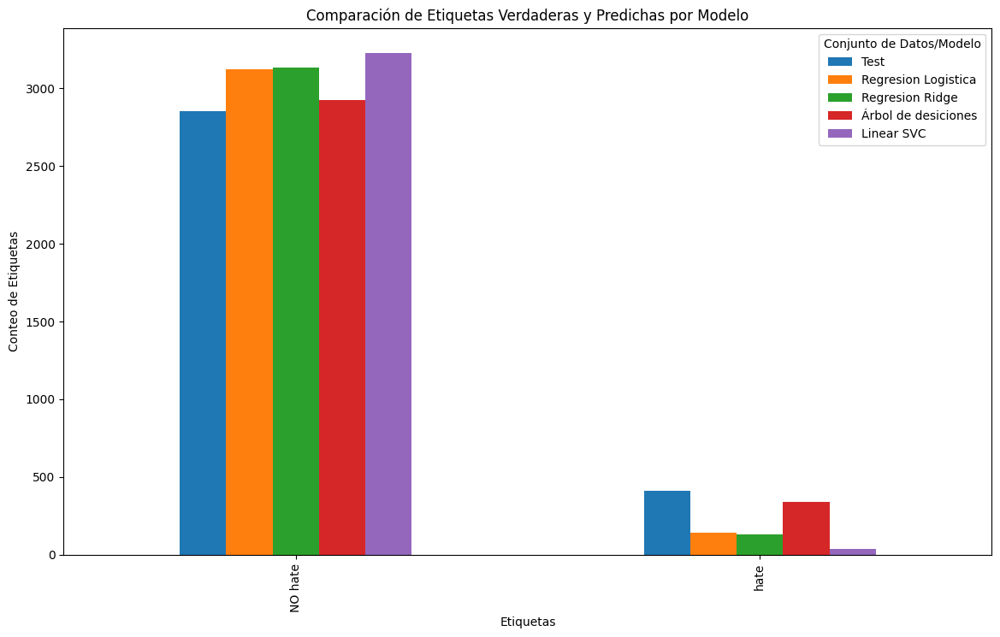

In [ ]:
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_odio_relation["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_odio_relation["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_odio_relation["Lematizado_Stemming"])

categories = ["NO hate", "hate"]

results_VecTFIDF = train_and_evaluate_models(df = df_odio_relation,
                                             X = text_norm_VecTFIDF,
                                             labels = categories,
                                             tam_test = 0.3)
results_VecCount = train_and_evaluate_models(df = df_odio_relation,
                                             X = text_norm_CountVec,
                                             labels = categories,
                                             tam_test = 0.3)
results_VecHash = train_and_evaluate_models(df = df_odio_relation,
                                             X = text_norm_HashingVec,
                                             labels = categories,
                                             tam_test = 0.3)

### Regresión Logaritmica

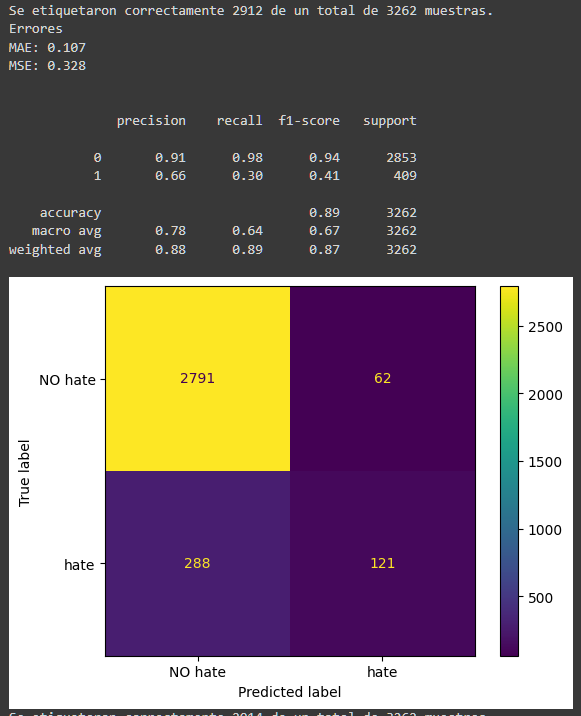

### Regresión Ridge

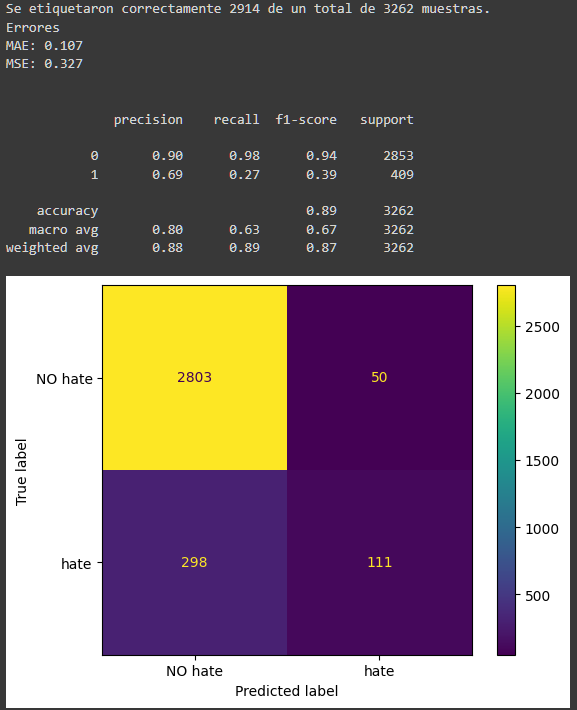

### Árboles de decisiones

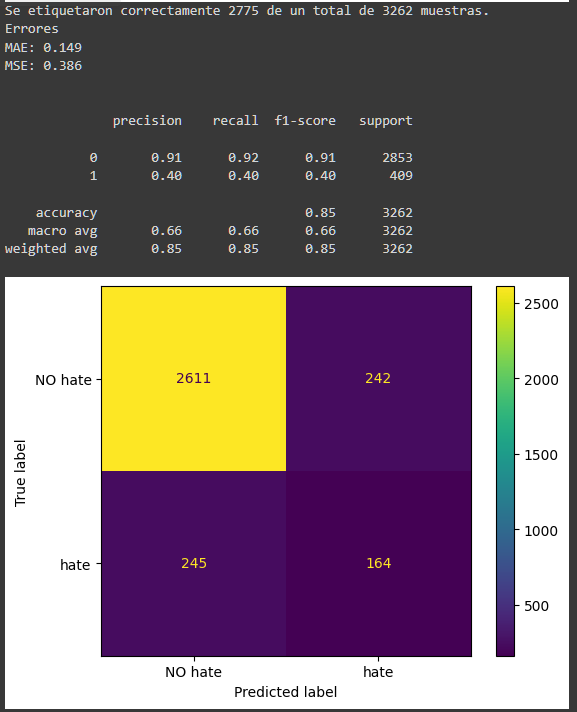

### Linear SVC

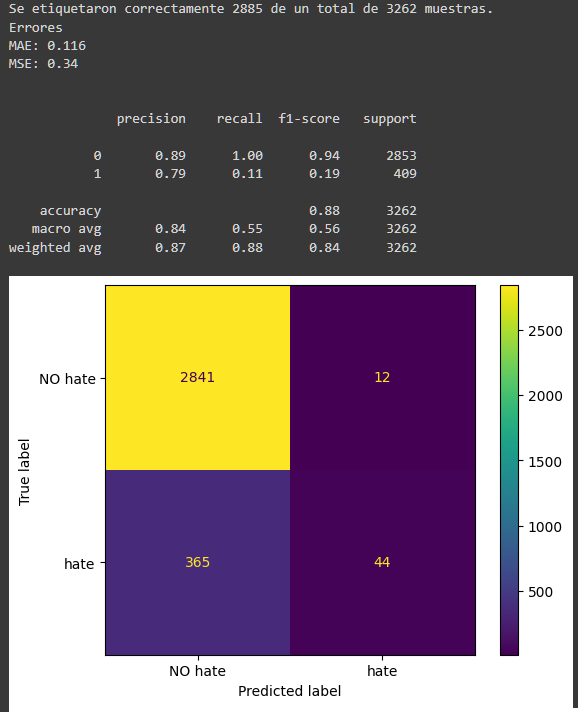

### Comparación de Métricas en modelos con normalización Tf-idf Vectorizer

#### **Errores en las predicciones**

Observemos cual de los modelos tuvo menor error en la prediccion manteniendo la normalizacion por TfidfVectorizer pues vimos que era a la que mejor le iba en cada caso

La comparación de errores en la prediccion de modelos decon normalización Tf-idf Vectorizer permitirá identificar el modelo más preciso y confiable para la tarea de predicción. La normalización Tf-idf Vectorizer garantizará una comparación justa entre los modelos y contribuirá a mejorar la calidad de las predicciones.

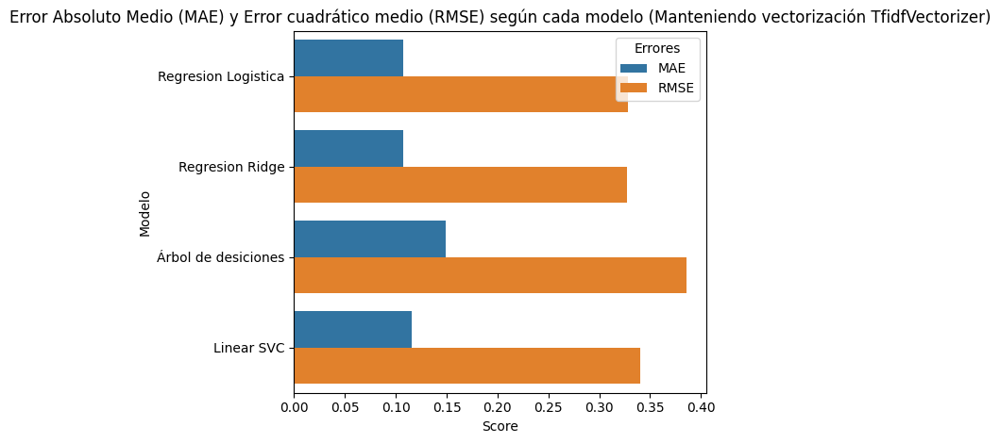

#### **Presición de las Predicciones**

Para el corpus de SPAM, todos los modelos obtuvieron buenos resultados. Pero el modelo de clasificación con mayor precisión es Regresión Ridge con una precisión de 0.987.

La superioridad de la Regresión Ridge en este caso se puede atribuir a su capacidad para manejar la multicolinealidad, un fenómeno común en los datos de texto donde las características pueden estar altamente correlacionadas entre sí. La Regresión Ridge regulariza los coeficientes del modelo, lo que ayuda a evitar el sobreajuste y mejora la generalización a nuevos datos




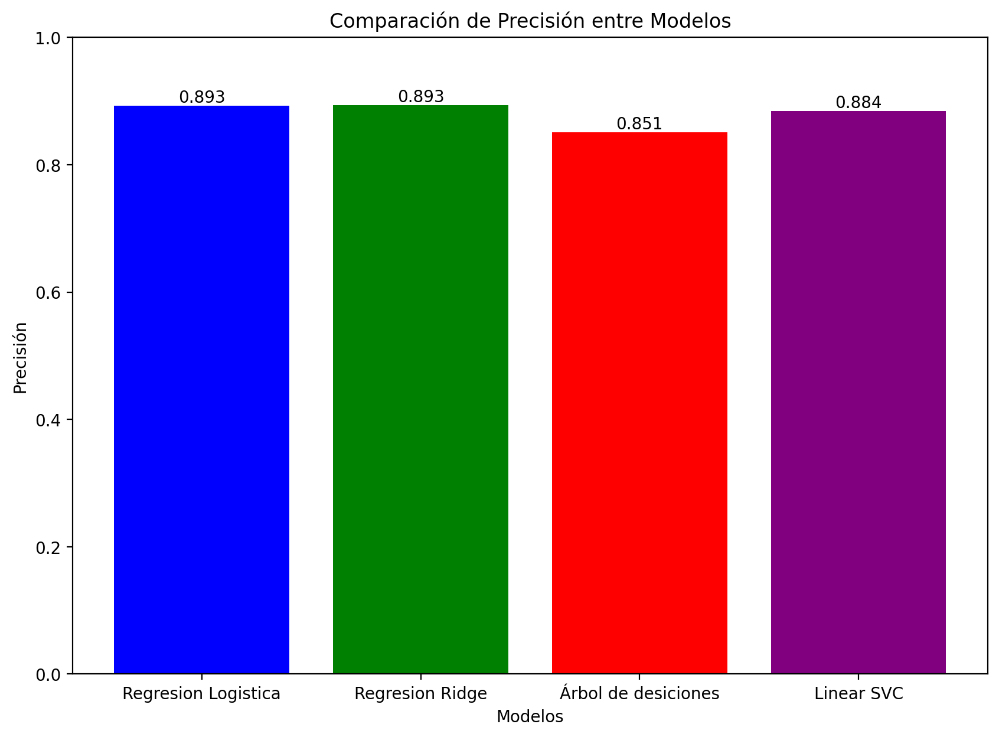

#### **Validación Cruzada**

En este apartado, llevaremos a cabo un proceso de Validación Cruzada para evaluar el desempeño del modelo de SVC Linear al enfrentarlo a datos no vistos.

Es fundamental destacar que probar un modelo de clasificación con los mismos datos utilizados para su entrenamiento representa un error metodológico. Si el modelo simplemente replica lo que ya ha aprendido, podría obtener una puntuación perfecta, pero carecería de utilidad para procesar nuevos datos. Este fenómeno se conoce como sobreajuste. La Validación Cruzada surge como una técnica efectiva para evitar este problema y obtener una estimación más precisa de cómo se comportará el modelo al ser aplicado a nuevos datos no contemplados durante la fase de entrenamiento.

¿Cómo funciona en `sklearn`?

* Divide el conjunto de datos original en k subconjuntos (folds) aleatorios y disjuntos (no comparten elementos).
* Se realiza un proceso de entrenamiento y validación en k iteraciones.
* En cada iteración:
   * Se utiliza un fold como conjunto de validación (datos que no ha visto el modelo para entrenar).
   * Los restantes k-1 folds se utilizan como conjunto de entrenamiento.
   * Se entrena el modelo con el conjunto de entrenamiento y se evalúa su rendimiento en el conjunto de validación.

`kfold = KFold(n_splits = 10, shuffle = True, random_state=123)`
* `n_splits`: (entero, por defecto 5), Número de pliegues (folds) en que se dividirá el conjunto de datos.
* `shuffle` (booleano, por defecto False), Si se barajan los datos antes de dividirlos en pliegues.
* `random_state` (entero, RandomState instance o None, por defecto None), Semilla aleatoria.

In [ ]:
print("Etiquetas del corpus SeXISM")
print(t)

Etiquetas del corpus SeXISM
0        0
1        0
2        0
3        0
4        0
        ..
13626    0
13627    0
13628    0
13629    0
13630    0
Name: label, Length: 13631, dtype: int64


In [ ]:
print("Primer elemento Corpus SEXISM Vectorizado")
print(X[1])

Primer elemento Corpus SEXISM Vectorizado
  (0, 1028)	0.22372700452848487
  (0, 697)	0.6425118359389882
  (0, 1444)	0.7328879642367051


In [ ]:
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']
kfold = KFold(n_splits = 10,
              shuffle = True,
              random_state=123)
scores = cross_validate(model_SVC, X, t, cv=kfold, scoring=scoring)
print("Accuracy:", np.round(np.mean(scores['test_accuracy']), 3))
print("Precision:", np.round(np.mean(scores['test_precision_macro']), 3))
print("Recall:", np.round(np.mean(scores['test_recall_macro']), 3))
print("F1 Score:", np.round(np.mean(scores['test_f1_macro']), 3))

Accuracy: 0.896
Precision: 0.8
Recall: 0.686
F1 Score: 0.723


#### Tiempos de Procesamiento

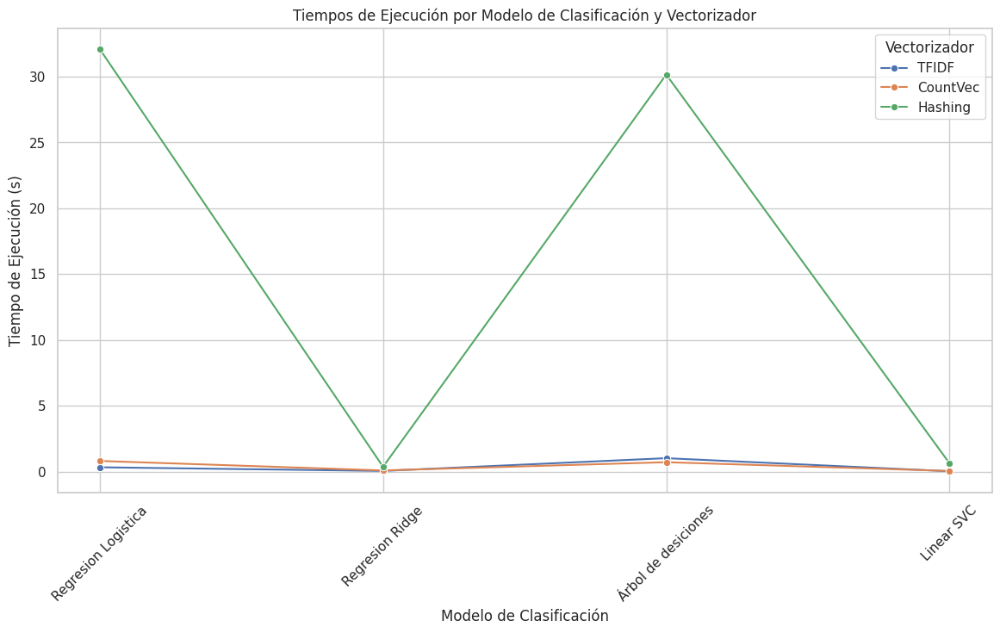

## lbl2Vec

`keywords_list` : Lista anidada iterable con palabras clave descriptivas para cada tema

`tagged_documents` : Lista iterable de elementos `gensim.models.doc2vec.TaggedDocument`. Cada elemento representa un documento.

`label_names` : Lista iterable de nombres personalizados para cada etiqueta. Los nombres de las etiquetas y las palabras clave del mismo tema deben tener el mismo índice.

`similarity_threshold` : Solo se utilizan documentos con una similitud mayor al umbral establecido con respecto a las palabras clave de descripción para calcular la incrustación de la etiqueta.

`min_num_docs` : Número mínimo de documentos utilizados para calcular la incrustación de la etiqueta.

`epochs` : Número de iteraciones sobre el corpus.



```
lbl2vec_model = Lbl2Vec(keywords_list,
                        tagged_documents,
                        label_names,
                        similarity_threshold,
                        min_num_docs,
                        epochs)
```




Durante el fit del modelo con `df_spam`, lbl2Vec imprime este warning:

```
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.
```

El warning "IOPub data rate exceeded" indica que la cantidad de datos que el servidor del notebook está tratando de enviar al cliente (tu navegador) excede el límite configurado. Esto puede suceder cuando hay una gran cantidad de datos siendo enviados a la salida (por ejemplo, al imprimir muchos datos o gráficos muy grandes), y el servidor del notebook temporalmente deja de enviar datos para evitar un posible crash.

Para resolver esto, se aumentó el límite de la tasa de datos (data rate limit) configurando el parámetro NotebookApp.iopub_data_rate_limit, y aplicando el modelo en otro [notebook: lbl2vec_lbl2TransformerVec](https://colab.research.google.com/drive/1G32yuoUijTOD1PuUvkZGZnaxeANMtADn?usp=sharing)

### Para SPAM

In [ ]:
# Función para crear documentos gensim Doc2Vec
def create_doc2vec_documents(df):
    documents = []
    for i, row in df.iterrows():
        words = row["text"].split()
        tags = [row["label"]]  # Usar una lista para la etiqueta
        document = gensim.models.doc2vec.TaggedDocument(words, tags)
        documents.append(document)
    return documents

In [ ]:
#Pasamos las func en df_sexist
df_spam1 = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_spam.csv")

# Realizar la división manteniendo la proporción de etiquetas
df_spam_A, df_spam = train_test_split(df_spam1,
                               test_size = 0.15,
                               stratify = df_spam1["label"],
                               random_state = 123)

# Verificar la proporción de etiquetas después de la división
print("Proporcion Dataframe de Juguete de SPAM")
print("- Tamaño del Corpus Original: ",df_spam1.shape[0])
print("- Tamaño del Corpus de Juguete: ",df_spam.shape[0])

Proporcion Dataframe de Juguete de SPAM
- Tamaño del Corpus Original:  83448
- Tamaño del Corpus de Juguete:  12518


In [ ]:
#Pasamos las func en
tagged_documents = create_doc2vec_documents(df_spam)
df_spam.insert(len(df_spam.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_spam["doc_key"] = df_spam.index.astype(str)
df_spam.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
7610,save escapenumber products http www xadrxsave org,1,save escapenumb product http www xadrxsav org,"([save, escapenumber, products, http, www, xad...",7610
1034,schematically intermingle bandage credulousnes...,1,schemat intermingl bandag credul broaden unful...,"([schematically, intermingle, bandage, credulo...",1034
7920,look lines points plot option add add true spe...,0,look line point plot option add add true speci...,"([look, lines, points, plot, option, add, add,...",7920
14445,easy understand exactly mean try merge cbind r...,0,easi understand exactli mean tri merg cbind rb...,"([easy, understand, exactly, mean, try, merge,...",14445
16903,never spoke unrequited passion would allow one...,1,never spoke unrequit passion would allow one e...,"([never, spoke, unrequited, passion, would, al...",16903


In [ ]:
##doc2vec_model
# Definir y entrenar el modelo Doc2Vec
model_SPAM = Doc2Vec(vector_size = 100,
                window = 5,
                min_count = 100,
                workers = 4,
                epochs = 20)
model_SPAM.build_vocab(tagged_documents)
model_SPAM.train(tagged_documents, total_examples=model_SPAM.corpus_count, epochs=model_SPAM.epochs)

# Guardar el modelo entrenado
model_SPAM.save("Doc2Vec_SPAM")

# Cargar el modelo (si es necesario)
model_SPAM = Doc2Vec.load("Doc2Vec_SPAM")

In [ ]:
# Etiquetas
label_names = {0: 'NO spam', 1: 'spam'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_spam['label'].unique():
    keywords, num_keywords = get_keywords(df_spam, label) #get_keywords(df_spam, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)
df_labels

,label,label_name,keywords,number_of_keywords
0,1,spam,"[escapenumb, escapelong, com, pill, per, x, ht...",45075
1,0,NO spam,"[escapenumb, r, struct, http, enron, ndr, c, c...",34143


In [ ]:
df_spam = df_spam.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)

In [ ]:
df_spam_train, df_spam_test = train_test_split(df_spam, test_size = 0.2, random_state = 123, stratify=df_spam["label"])

df_spam_train["data_set_type"] = "train"

df_spam_test["data_set_type"] = "test"

# concatenamos
df_spam_full = pd.concat([df_spam_train,df_spam_test]).reset_index(drop=True)
df_spam_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,tue escapenumber jun escapenumber john logsdon...,0,tue escapenumb jun escapenumb john logsdon wro...,"([tue, escapenumber, jun, escapenumber, john, ...",42832,NO spam,34143,train
1,author obnox date escapenumber escapenumber es...,0,author obnox date escapenumb escapenumb escape...,"([author, obnox, date, escapenumber, escapenum...",66820,NO spam,34143,train
2,hi everyone pointed new mockups write http wik...,0,hi everyon point new mockup write http wiki la...,"([hi, everyone, pointed, new, mockups, write, ...",37274,NO spam,34143,train
3,ðµäéìòåóóñº äúºãîòëòðöµüëïöóðáóàµäéìæïúêûþîñìã...,1,ðµäéìòåóóñº äúºãîòëòðöµüëïöóðáóàµäéìæïúêûþîñìã...,"([ðµäéìòåóóñº, äúºãîòëòðöµüëïöóðáóàµäéìæïúêûþî...",43574,spam,45075,train
4,im sure solution would complete however note v...,0,im sure solut would complet howev note vmware ...,"([im, sure, solution, would, complete, however...",77564,NO spam,34143,train


In [ ]:
df_spam_full['label'][df_spam_full['data_set_type']=='train'].value_counts()

label
1    3513
0    3163
Name: count, dtype: int64

In [ ]:
start_time = time.time()
lbl2vec_model_spam = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_spam_full['tagged_documents'][df_spam_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.5, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_spam.fit()
# test
new_docs_lbl_similarities_spam = lbl2vec_model_spam.predict_new_docs(tagged_docs = df_spam_full['tagged_documents'][df_spam_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:29:55,461 - Lbl2Vec - INFO - Train document and wo

Tiempo de ejecución: 132.38164639472961 segundos


In [ ]:
new_docs_lbl_similarities_spam.head()
new_docs_lbl_similarities_spam.value_counts("most_similar_label")
new_docs_lbl_similarities_spam.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1669 entries, 0 to 1668
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   doc_key                   1669 non-null   int64  
 1   most_similar_label        1669 non-null   object 
 2   highest_similarity_score  1669 non-null   float32
 3   spam                      1669 non-null   float32
 4   NO spam                   1669 non-null   float32
dtypes: float32(3), int64(1), object(1)
memory usage: 45.8+ KB


In [ ]:
df_pred = new_docs_lbl_similarities_spam.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO spam":0, "spam":1}, inplace = True)
df_pred["label"].value_counts()

label
1    1669
Name: count, dtype: int64

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

Se etiquetaron correctamente 878 de un total de 1669 muestras.
Errores
MAE: 0.474
MSE: 0.688


              precision    recall  f1-score   support

           0       0.00      0.00      0.00       791
           1       0.53      1.00      0.69       878

    accuracy                           0.53      1669
   macro avg       0.26      0.50      0.34      1669
weighted avg       0.28      0.53      0.36      1669



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


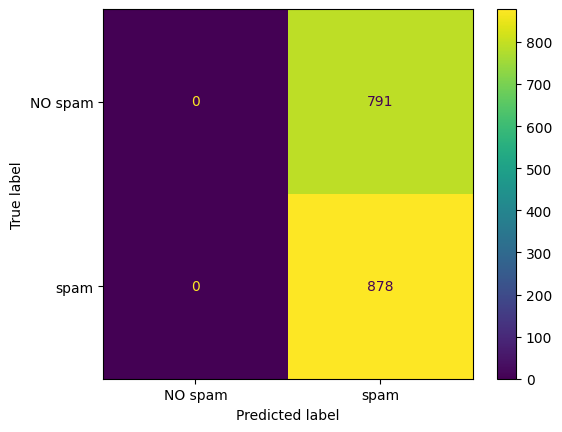

In [ ]:
categories = ["NO spam", "spam"]
y_test = df_spam_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_spam["label"]), display_labels = categories)

Como existe un desequilibrio entre etiquetas significativo, se alamcenan las métricas ponderadas (weighted avg), las cuales tienen en cuenta la importancia relativa de las clases

### Para SEXISMO

In [ ]:
# Función para crear documentos gensim Doc2Vec
def create_doc2vec_documents(df):
    documents = []
    for i, row in df.iterrows():
        words = row["text"].split()
        tags = [row["label"]]  # Usar una lista para la etiqueta
        document = gensim.models.doc2vec.TaggedDocument(words, tags)
        documents.append(document)
    return documents

In [ ]:
#Pasamos las func en df_sexist
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_sexista.csv")
df_sexista = df_sexista.rename(columns = {"sexist":"label"})
tagged_documents = create_doc2vec_documents(df_sexista)
df_sexista.insert(len(df_sexista.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_sexista["doc_key"] = df_sexista.index.astype(str)
df_sexista.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,mention didnt even know random option,0,mention didnt even know random option,"([mention, didnt, even, know, random, option],...",0
1,bottom two shouldve gone mkr,0,bottom two shouldv gone mkr,"([bottom, two, shouldve, gone, mkr], [0])",1
2,mention mention ladyboner deserves much credit...,0,mention mention ladybon deserv much credit dud...,"([mention, mention, ladyboner, deserves, much,...",2
3,shall known sourpuss mkr katandre failedfoodies,0,shall known sourpuss mkr katandr failedfoodi,"([shall, known, sourpuss, mkr, katandre, faile...",3
4,tarah w threw bunch women bus could get wadhwa...,0,tarah w threw bunch woman bu could get wadhwa ...,"([tarah, w, threw, bunch, women, bus, could, g...",4


In [ ]:
##doc2vec_model
# Definir y entrenar el modelo Doc2Vec
model = Doc2Vec(vector_size = 100,
                window = 5,
                min_count = 100,
                workers = 4,
                epochs = 20)
model.build_vocab(tagged_documents)
model.train(tagged_documents, total_examples=model.corpus_count, epochs=model.epochs)

# Guardar el modelo entrenado
model.save("Doc2Vec_Sexism")

# Cargar el modelo (si es necesario)
model = Doc2Vec.load("Doc2Vec_Sexism")

In [ ]:
# Etiquetas
label_names = {0: 'NO sexist', 1: 'sexist'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_sexista['label'].unique():
    keywords, num_keywords = get_keywords(df_sexista, label) #get_keywords(df_sexista, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)
df_labels

,label,label_name,keywords,number_of_keywords
0,0,NO sexist,"[mention, mkr, woman, like, im, dont, peopl, g...",11736
1,1,sexist,"[woman, mention, men, girl, man, like, im, don...",3222


In [ ]:
df_sexista = df_sexista.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)

In [ ]:
df_sexista_train, df_sexista_test = train_test_split(df_sexista, test_size = 0.2, random_state = 123, stratify=df_sexista["label"])

df_sexista_train["data_set_type"] = "train"

df_sexista_test["data_set_type"] = "test"

# concatenamos
df_sexista_full = pd.concat([df_sexista_train,df_sexista_test]).reset_index(drop=True)
df_sexista_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,man sometimes justified hitting wife,1,man sometim justifi hit wife,"([man, sometimes, justified, hitting, wife], [1])",5072,sexist,3222,train
1,cant wait vic girls ash camilla wreck kats ass...,0,cant wait vic girl ash camilla wreck kat as li...,"([cant, wait, vic, girls, ash, camilla, wreck,...",9330,NO sexist,11736,train
2,omg im done show torturous id rather syria mkr,0,omg im done show tortur id rather syria mkr,"([omg, im, done, show, torturous, id, rather, ...",6633,NO sexist,11736,train
3,man birth women feel preferment womenwomensday,0,man birth woman feel prefer womenwomensday,"([man, birth, women, feel, preferment, womenwo...",4074,NO sexist,11736,train
4,mention mention going perfect got record thoug...,0,mention mention go perfect got record thought ...,"([mention, mention, going, perfect, got, recor...",6875,NO sexist,11736,train


In [ ]:
start_time = time.time()
lbl2vec_model_sexism = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_sexista_full['tagged_documents'][df_sexista_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.9, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_sexism.fit()
# test
new_docs_lbl_similarities_sexism = lbl2vec_model_sexism.predict_new_docs(tagged_docs = df_sexista_full['tagged_documents'][df_sexista_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 20:49:20,223 - Lbl2Vec - INFO - Train document and wo

Tiempo de ejecución: 14.026894330978394 segundos


In [ ]:
new_docs_lbl_similarities_sexism.head()
new_docs_lbl_similarities_sexism.value_counts("most_similar_label")
new_docs_lbl_similarities_sexism.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2727 entries, 0 to 2726
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   doc_key                   2727 non-null   int64  
 1   most_similar_label        2727 non-null   object 
 2   highest_similarity_score  2727 non-null   float32
 3   NO sexist                 2727 non-null   float32
 4   sexist                    2727 non-null   float32
dtypes: float32(3), int64(1), object(1)
memory usage: 74.7+ KB


In [ ]:
df_pred = new_docs_lbl_similarities_sexism.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO sexist":0, "sexist":1}, inplace = True)
df_pred["label"].value_counts()

label
0    2727
Name: count, dtype: int64

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

Se etiquetaron correctamente 2365 de un total de 2727 muestras.
Errores
MAE: 0.133
MSE: 0.364


              precision    recall  f1-score   support

           0       0.87      1.00      0.93      2365
           1       0.00      0.00      0.00       362

    accuracy                           0.87      2727
   macro avg       0.43      0.50      0.46      2727
weighted avg       0.75      0.87      0.81      2727



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


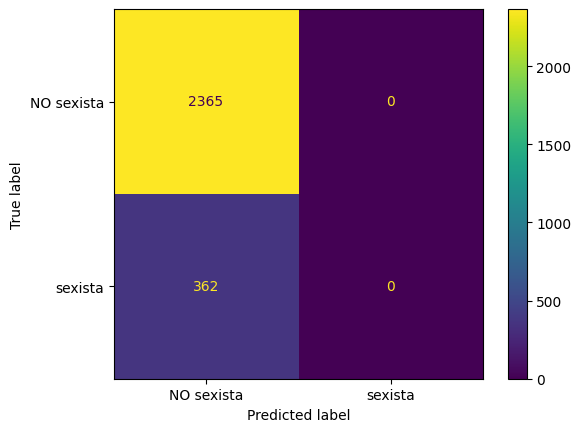

In [ ]:
categories = ["NO sexista", "sexista"]
y_test = df_sexista_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_sexista_full["label"]), display_labels = categories)

Como existe un desequilibrio entre etiquetas significativo, se alamcenan las métricas ponderadas (weighted avg), las cuales tienen en cuenta la importancia relativa de las clases

### Para ODIO `df_odio_relation`

In [ ]:
# Función para crear documentos gensim Doc2Vec
def create_doc2vec_documents(df):
    documents = []
    for i, row in df.iterrows():
        words = row["text"].split()
        tags = [row["label"]]  # Usar una lista para la etiqueta
        document = gensim.models.doc2vec.TaggedDocument(words, tags)
        documents.append(document)
    return documents

In [ ]:
#Pasamos las func en df_sexist
df_odio_relation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_relation.csv")

In [ ]:
#Pasamos las func en
tagged_documents = create_doc2vec_documents(df_odio_relation)
df_odio_relation.insert(len(df_odio_relation.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_odio_relation["doc_key"] = df_odio_relation.index.astype(str)
df_odio_relation.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,march th booklet downloaded times counting,0,march th booklet download time count,"([march, th, booklet, downloaded, times, count...",0
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...,"([order, help, increase, booklets, downloads, ...",1
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...,"([simply, copy, paste, following, text, youtub...",2
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...,"([click, free, download, colorfully, illustrat...",3
4,click download mb green banner link,0,click download mb green banner link,"([click, download, mb, green, banner, link], [0])",4


In [ ]:
##doc2vec_model
# Definir y entrenar el modelo Doc2Vec
model_odio_rel = Doc2Vec(vector_size = 100,
                window = 5,
                min_count = 100,
                workers = 4,
                epochs = 20)
model_odio_rel.build_vocab(tagged_documents)
model_odio_rel.train(tagged_documents, total_examples=model_odio_rel.corpus_count, epochs=model_odio_rel.epochs)

# Guardar el modelo entrenado
model_odio_rel.save("Doc2Vec_ODIO_REL")

# Cargar el modelo (si es necesario)
model_odio_rel = Doc2Vec.load("Doc2Vec_ODIO_REL")

In [ ]:
# Etiquetas
label_names = {0: 'NO hate', 1: 'hate'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_odio_relation['label'].unique():
    keywords, num_keywords = get_keywords(df_odio_relation, label) #get_keywords(df_odio_relation, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)
df_labels

,label,label_name,keywords,number_of_keywords
0,0,NO hate,"[white, like, nt, peopl, get, one, youtub, wou...",10581
1,1,hate,"[white, black, like, nt, jew, peopl, get, woul...",3576


In [ ]:
df_odio_relation = df_odio_relation.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)

In [ ]:
df_odio_relation_train, df_odio_relation_test = train_test_split(df_odio_relation, test_size = 0.2, random_state = 123, stratify=df_odio_relation["label"])

df_odio_relation_train["data_set_type"] = "train"

df_odio_relation_test["data_set_type"] = "test"

# concatenamos
df_odio_relation_full = pd.concat([df_odio_relation_train,df_odio_relation_test]).reset_index(drop=True)
df_odio_relation_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,certain circumstances would agree europe prese...,0,certain circumst would agre europ preserv nati...,"([certain, circumstances, would, agree, europe...",2510,NO hate,10581,train
1,good reasoning bitch hungry dickforget let per...,1,good reason bitch hungri dickforget let perish...,"([good, reasoning, bitch, hungry, dickforget, ...",7375,hate,3576,train
2,please put pictures average people models,0,plea put pictur averag peopl model,"([please, put, pictures, average, people, mode...",3509,NO hate,10581,train
3,feel sorry people living texas live australia ...,0,feel sorri peopl live texa live australia alwa...,"([feel, sorry, people, living, texas, live, au...",3483,NO hate,10581,train
4,image melvin weiss,0,imag melvin wei,"([image, melvin, weiss], [0])",2375,NO hate,10581,train


In [ ]:
df_odio_relation_full['label'][df_odio_relation_full['data_set_type']=='train'].value_counts()

label
0    7605
1    1091
Name: count, dtype: int64

In [ ]:
start_time = time.time()

lbl2vec_model_odio_relation = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_odio_relation_full['tagged_documents'][df_odio_relation_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.9, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_odio_relation.fit()
# test
new_docs_lbl_similarities_odio_relation = lbl2vec_model_odio_relation.predict_new_docs(tagged_docs = df_odio_relation_full['tagged_documents'][df_odio_relation_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 22:53:16,098 - Lbl2Vec - INFO - Train document and wo

Tiempo de ejecución: 12.699588537216187 segundos


In [ ]:
#new_docs_lbl_similarities_odio_relation.head()
new_docs_lbl_similarities_odio_relation.value_counts("most_similar_label")
#new_docs_lbl_similarities_odio_relation.info()

most_similar_label
NO hate    2175
Name: count, dtype: int64

In [ ]:
df_pred = new_docs_lbl_similarities_odio_relation.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO hate":0, "hate":1}, inplace = True)
df_pred["label"].value_counts()

label
0    2175
Name: count, dtype: int64

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

Se etiquetaron correctamente 1902 de un total de 2175 muestras.
Errores
MAE: 0.126
MSE: 0.354


              precision    recall  f1-score   support

           0       0.87      1.00      0.93      1902
           1       0.00      0.00      0.00       273

    accuracy                           0.87      2175
   macro avg       0.44      0.50      0.47      2175
weighted avg       0.76      0.87      0.82      2175



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


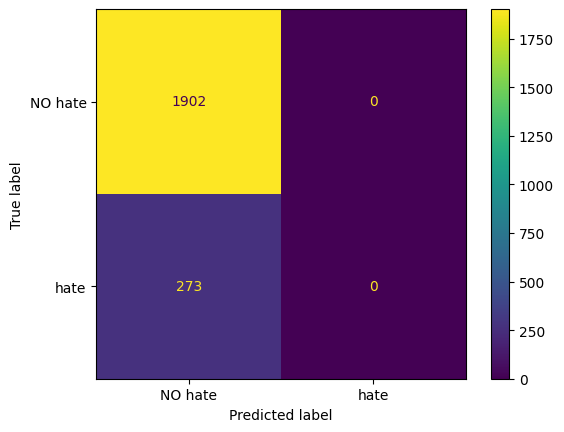

In [ ]:
categories = ["NO hate", "hate"]
y_test = df_odio_relation_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_odio_relation["label"]), display_labels = categories)

Como existe un desequilibrio entre etiquetas significativo, se alamcenan las métricas ponderadas (weighted avg), las cuales tienen en cuenta la importancia relativa de las clases

### Para ODIO `df_odio_NOrelation`

In [ ]:
# Función para crear documentos gensim Doc2Vec
def create_doc2vec_documents(df):
    documents = []
    for i, row in df.iterrows():
        words = row["text"].split()
        tags = [row["label"]]  # Usar una lista para la etiqueta
        document = gensim.models.doc2vec.TaggedDocument(words, tags)
        documents.append(document)
    return documents

In [ ]:
#Pasamos las func en df_sexist
df_odio_NOrelation = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio_NOrelation.csv")

In [ ]:
#Pasamos las func en
tagged_documents = create_doc2vec_documents(df_odio_NOrelation)
df_odio_NOrelation.insert(len(df_odio_NOrelation.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_odio_NOrelation["doc_key"] = df_odio_NOrelation.index.astype(str)
df_odio_NOrelation.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,march th booklet downloaded times counting,0,march th booklet download time count,"([march, th, booklet, downloaded, times, count...",0
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...,"([order, help, increase, booklets, downloads, ...",1
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...,"([simply, copy, paste, following, text, youtub...",2
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...,"([click, free, download, colorfully, illustrat...",3
4,click download mb green banner link,0,click download mb green banner link,"([click, download, mb, green, banner, link], [0])",4


In [ ]:
##doc2vec_model
# Definir y entrenar el modelo Doc2Vec
model_odio_rel = Doc2Vec(vector_size = 100,
                window = 5,
                min_count = 100,
                workers = 4,
                epochs = 20)
model_odio_rel.build_vocab(tagged_documents)
model_odio_rel.train(tagged_documents, total_examples=model_odio_rel.corpus_count, epochs=model_odio_rel.epochs)

# Guardar el modelo entrenado
model_odio_rel.save("Doc2Vec_ODIO_NOREL")

# Cargar el modelo (si es necesario)
model_odio_rel = Doc2Vec.load("Doc2Vec_ODIO_NOREL")

In [ ]:
# Etiquetas
label_names = {0: 'NO hate', 1: 'hate'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_odio_NOrelation['label'].unique():
    keywords, num_keywords = get_keywords(df_odio_NOrelation, label) #get_keywords(df_odio_relation, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)
df_labels

,label,label_name,keywords,number_of_keywords
0,0,NO hate,"[white, like, nt, peopl, get, one, youtub, wou...",10527
1,1,hate,"[white, black, like, nt, jew, peopl, get, woul...",3432


In [ ]:
df_odio_NOrelation = df_odio_NOrelation.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)

In [ ]:
df_odio_NOrelation_train, df_odio_NOrelation_test = train_test_split(df_odio_NOrelation, test_size = 0.2, random_state = 123, stratify=df_odio_NOrelation["label"])

df_odio_NOrelation_train["data_set_type"] = "train"

df_odio_NOrelation_test["data_set_type"] = "test"

# concatenamos
df_odio_NOrelation_full = pd.concat([df_odio_NOrelation_train,df_odio_NOrelation_test]).reset_index(drop=True)
df_odio_NOrelation_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,bible though full contradictions misjudge thin...,0,bibl though full contradict misjudg thing meant,"([bible, though, full, contradictions, misjudg...",2547,NO hate,10527,train
1,hello thomas welcome sfbritain good another yo...,0,hello thoma welcom sfbritain good anoth young ...,"([hello, thomas, welcome, sfbritain, good, ano...",3666,NO hate,10527,train
2,youth future indeed hitler youth must addresse...,0,youth futur inde hitler youth must address ear...,"([youth, future, indeed, hitler, youth, must, ...",9157,NO hate,10527,train
3,bet single one dirty africanthey well taken ca...,1,bet singl one dirti africanthey well taken car...,"([bet, single, one, dirty, africanthey, well, ...",4599,hate,3432,train
4,practice use lr learn,0,practic use lr learn,"([practice, use, lr, learn], [0])",5207,NO hate,10527,train


In [ ]:
df_odio_NOrelation_full['label'][df_odio_NOrelation_full['data_set_type']=='train'].value_counts()

label
0    7605
1     957
Name: count, dtype: int64

In [ ]:
start_time = time.time()

lbl2vec_model_odio_NOrelation = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_odio_NOrelation_full['tagged_documents'][df_odio_NOrelation_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.5, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_odio_NOrelation.fit()
# test
new_docs_lbl_similarities_odio_NOrelation = lbl2vec_model_odio_NOrelation.predict_new_docs(tagged_docs = df_odio_NOrelation_full['tagged_documents'][df_odio_NOrelation_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-11 23:08:19,139 - Lbl2Vec - INFO - Train document and wo

Tiempo de ejecución: 13.735555171966553 segundos


In [ ]:
#new_docs_lbl_similarities_odio_relation.head()
new_docs_lbl_similarities_odio_relation.value_counts("most_similar_label")
#new_docs_lbl_similarities_odio_relation.info()

most_similar_label
NO hate    2175
Name: count, dtype: int64

In [ ]:
df_pred = new_docs_lbl_similarities_odio_NOrelation.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO hate":0, "hate":1}, inplace = True)
df_pred["label"].value_counts()

label
0    2141
Name: count, dtype: int64

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

In [ ]:
df_odio_NOrelation_test["label"].shape

(2141,)

Se etiquetaron correctamente 1902 de un total de 2141 muestras.
Errores
MAE: 0.112
MSE: 0.334


              precision    recall  f1-score   support

           0       0.89      1.00      0.94      1902
           1       0.00      0.00      0.00       239

    accuracy                           0.89      2141
   macro avg       0.44      0.50      0.47      2141
weighted avg       0.79      0.89      0.84      2141



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


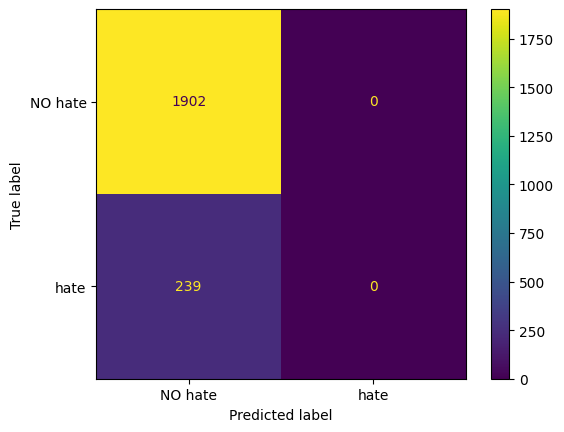

In [ ]:
categories = ["NO hate", "hate"]
y_test = df_odio_NOrelation_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_odio_NOrelation["label"]), display_labels = categories)

Como existe un desequilibrio entre etiquetas significativo, se alamcenan las métricas ponderadas (weighted avg), las cuales tienen en cuenta la importancia relativa de las clases

## Data Augmentation

No se suele realizar la técnica de data augmentation en corpus balanceados como `df_spam` debido a la redundancia, ya que en un corpus balanceado las clases ya están representadas de manera uniforme, lo que puede generar sobreajuste y afectar negativamente el rendimiento del modelo en datos no vistos; el efecto diluido, porque el aumento de datos puede diluir la información original, especialmente si las técnicas utilizadas no son adecuadas para el tipo de datos o la tarea específica, dificultando que el modelo aprenda las características relevantes y afecte su capacidad de generalización; el coste computacional, ya que estas técnicas pueden ser costosas, especialmente para conjuntos de datos grandes o complejos, y en el caso de corpus balanceados, este costo adicional puede no estar justificado; y el enfoque en la calidad de los datos, ya que es más efectivo limpiar los datos, eliminar el ruido y garantizar que sean precisos y representativos de la tarea en cuestión en lugar de aumentar artificialmente la cantidad de datos.

**Balanceo de Datos para `df_spam`**

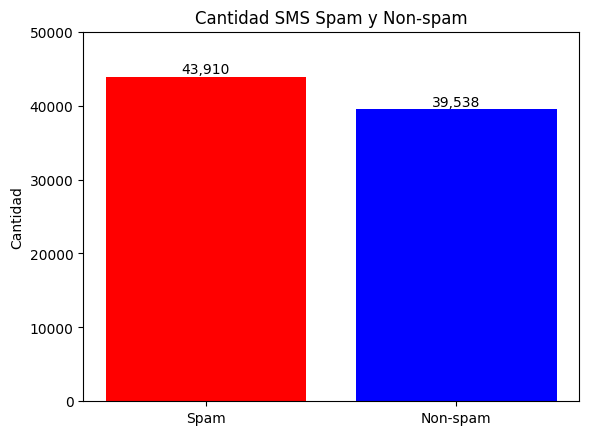

Sin embargo, como se observó en el preprocesamiento del corpus, los datasets df_sexista y df_odio están desbalanceados. En df_sexista, cada post está etiquetado como "True" o "False" en la columna "sexism", con una distribución desequilibrada de tweets sexistas y no sexistas (13.35% vs. 86.65%). En `df_odio`, hay una gran mayoría de oraciones sin discurso de odio (aproximadamente 87%) y una minoría con discurso de odio (aproximadamente 13%), lo cual es bueno para la humanidad, malo para nuestro modelo de clasificación.

Por lo tanto, se realizará un proceso de data augmentation para equilibrar las etiquetas en ambos corpus. Esto se logra mediante la creación de nuevos ejemplos de texto a partir de los datos existentes, sin necesidad de recopilar nuevos datos manualmente.

Las técnicas comunes de aumento de datos de texto incluyen parafraseo, retrotraducción, adición de ruido, uso de sinónimos, eliminación de palabras, inserción de palabras y mezcla de oraciones o párrafos de diferentes ejemplos de texto.

Para nuestro caso, se usarán sinónimos mediante la librería [`nlpaug`](https://github.com/makcedward/nlpaug), que reemplaza palabras en el texto con sinónimos basados en [WordNet](WordNet), una base de datos léxica. Con esto, se calcula la cantidad de datos en la etiqueta mayoritaria y la etiqueta minoritaria para crear un conjunto de datos balanceado donde ambas clases tengan aproximadamente la misma cantidad de muestras.

Aunque el aumento de datos puede ser una herramienta valiosa para mejorar el rendimiento de los modelos de NLP, no siempre es recomendable. A pesar de que las técnicas de aumento de datos se implementan cuidadosamente, siempre generarán una clase de ruido en los modelos de clasificación, pues no son datos reales. Pueden generar textos que no sean gramaticalmente correctos o que no tengan sentido. Además, si se utiliza un exceso de aumento de datos, el modelo puede aprender a depender demasiado de los datos aumentados y no generalizarse bien a los datos no aumentados.

## Clasificacion

### Para SEXISMO

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/sexism_data.csv")
df = df.drop(columns=["toxicity","id", "dataset", "of_id"]) #no son nenecsarias
df["sexist"].replace({True:1, False:0},inplace=True)#reemplazamos 1 = True, 0=false
df = df.rename(columns = {"sexist":"label"})
# Revisamos la distribución de las etiquetas
print(df['label'].value_counts())

label
0    11822
1     1809
Name: count, dtype: int64


In [ ]:
#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority
print("Diferencia entre clases: ",num_augmentations)

# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_sexism = df[df['label'] == 1]
augmented_texts = []

for text in df_sexism['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_balanced = pd.concat([df, df_augmented])

#Ejemplo texto
print("Ejemplo texto generado:", df_augmented["text"].iloc[5])

# Revisamos la nueva distribución de las etiquetas
print("Etiquetas balanceadas:")
print(df_balanced['label'].value_counts())

Diferencia entre clases:  10013
Ejemplo texto generado: Women have more than suspicion than mankind.
Etiquetas balanceadas:
label
0    11822
1    10854
Name: count, dtype: int64


In [ ]:
#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_balanced = preprocess_text(df_balanced)
# Función para hacer stemming y lematización
df_balanced['Lematizado_Stemming'] = df_balanced['text'].apply(stem_and_lemmatize)
df_balanced.head()

,text,label,Lematizado_Stemming
0,mention didnt even know random option,0,mention didnt even know random option
1,bottom two shouldve gone mkr,0,bottom two shouldv gone mkr
2,mention mention ladyboner deserves much credit...,0,mention mention ladybon deserv much credit dud...
3,shall known sourpuss mkr katandre failedfoodies,0,shall known sourpuss mkr katandr failedfoodi
4,tarah w threw bunch women bus could get wadhwa...,0,tarah w threw bunch woman bu could get wadhwa ...


In [ ]:
print(df_balanced.isnull().sum())

text                   0
label                  0
Lematizado_Stemming    0
dtype: int64


Se etiquetaron correctamente 6310 de un total de 6803 muestras.
Errores
MAE: 0.072
MSE: 0.269


              precision    recall  f1-score   support

           0       0.94      0.92      0.93      3547
           1       0.92      0.93      0.92      3256

    accuracy                           0.93      6803
   macro avg       0.93      0.93      0.93      6803
weighted avg       0.93      0.93      0.93      6803



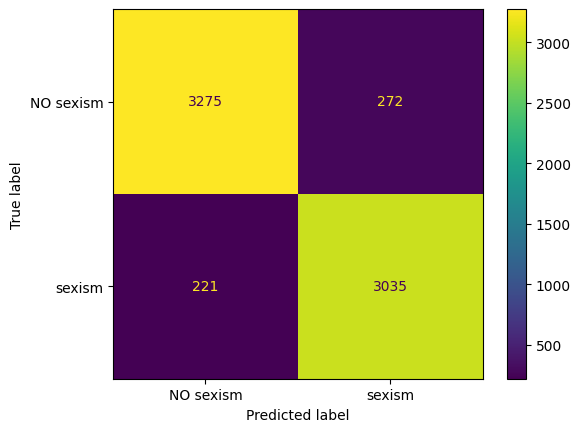

Se etiquetaron correctamente 6292 de un total de 6803 muestras.
Errores
MAE: 0.075
MSE: 0.274


              precision    recall  f1-score   support

           0       0.94      0.91      0.93      3547
           1       0.91      0.94      0.92      3256

    accuracy                           0.92      6803
   macro avg       0.92      0.93      0.92      6803
weighted avg       0.93      0.92      0.92      6803



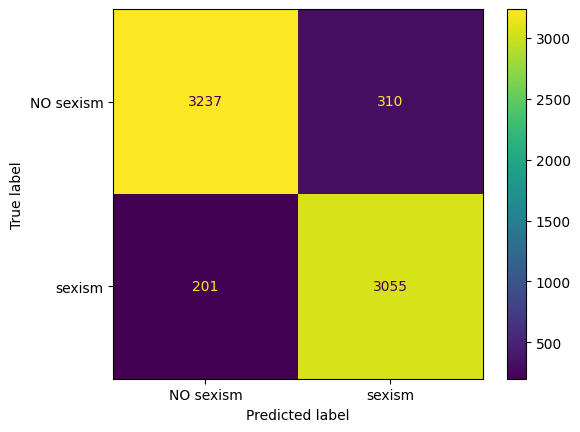

Se etiquetaron correctamente 6152 de un total de 6803 muestras.
Errores
MAE: 0.096
MSE: 0.309


              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3547
           1       0.89      0.91      0.90      3256

    accuracy                           0.90      6803
   macro avg       0.90      0.90      0.90      6803
weighted avg       0.90      0.90      0.90      6803



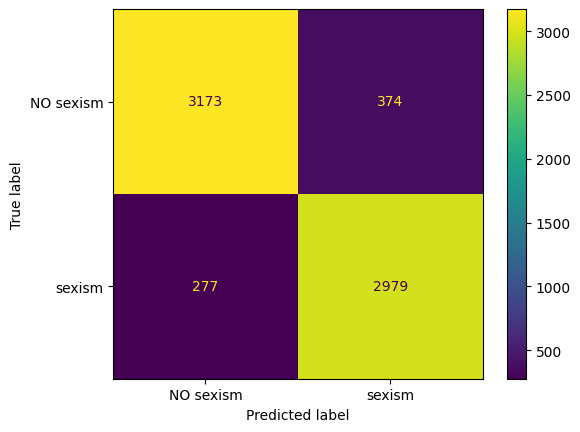

Se etiquetaron correctamente 6276 de un total de 6803 muestras.
Errores
MAE: 0.077
MSE: 0.278


              precision    recall  f1-score   support

           0       0.94      0.91      0.92      3547
           1       0.91      0.93      0.92      3256

    accuracy                           0.92      6803
   macro avg       0.92      0.92      0.92      6803
weighted avg       0.92      0.92      0.92      6803



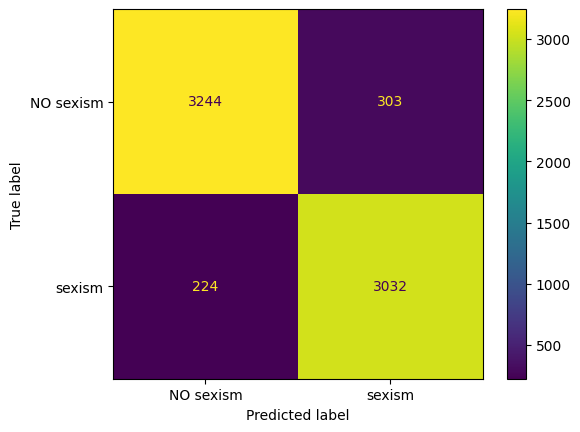

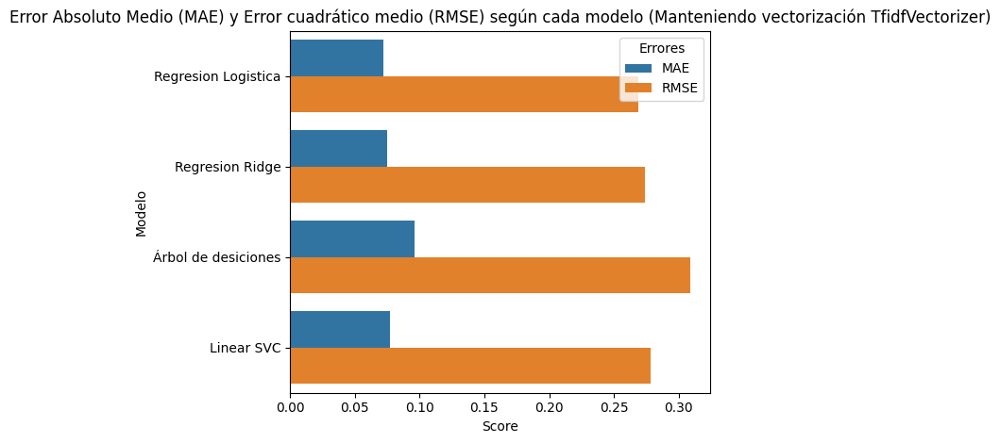

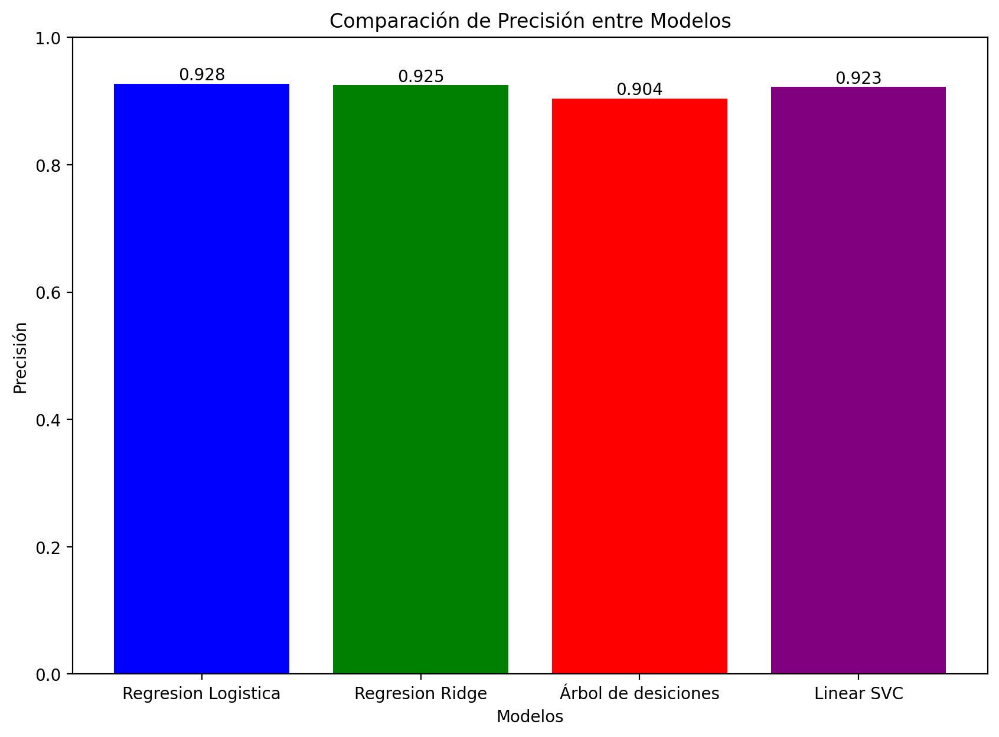

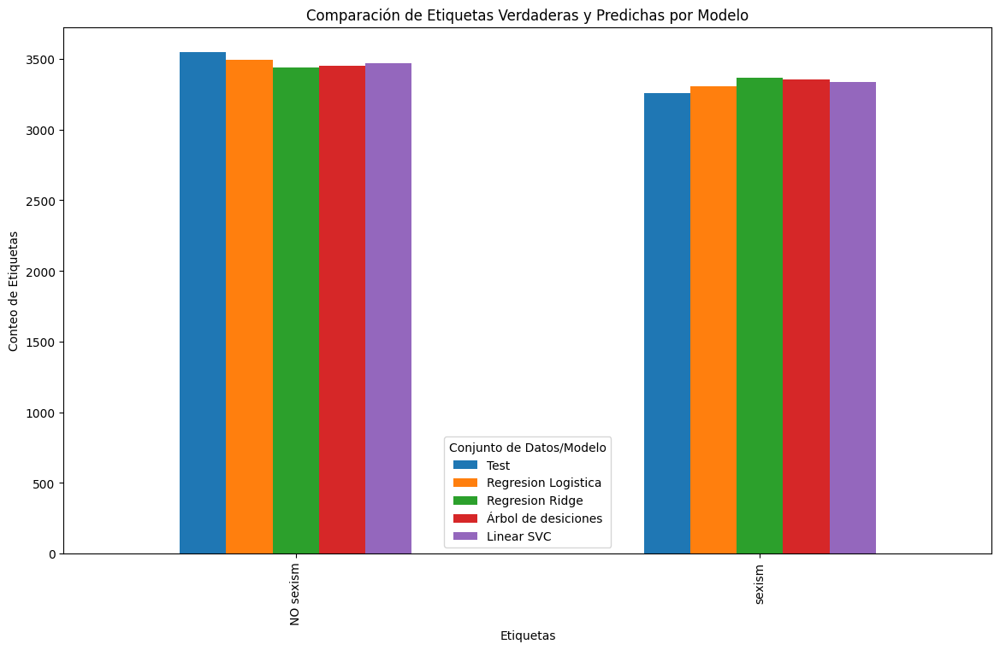

Se etiquetaron correctamente 6319 de un total de 6803 muestras.
Errores
MAE: 0.071
MSE: 0.267


              precision    recall  f1-score   support

           0       0.94      0.92      0.93      3547
           1       0.92      0.93      0.93      3256

    accuracy                           0.93      6803
   macro avg       0.93      0.93      0.93      6803
weighted avg       0.93      0.93      0.93      6803



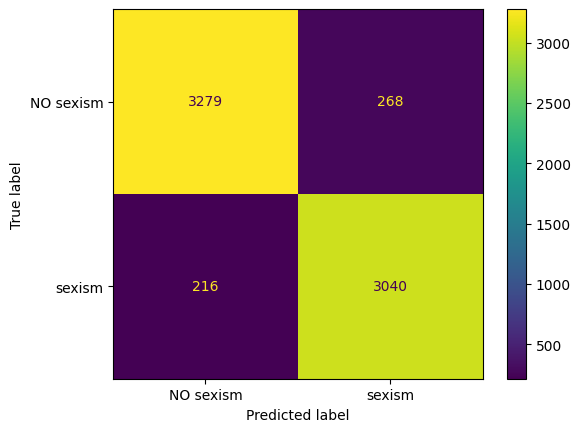

Se etiquetaron correctamente 6277 de un total de 6803 muestras.
Errores
MAE: 0.077
MSE: 0.278


              precision    recall  f1-score   support

           0       0.94      0.91      0.92      3547
           1       0.90      0.94      0.92      3256

    accuracy                           0.92      6803
   macro avg       0.92      0.92      0.92      6803
weighted avg       0.92      0.92      0.92      6803



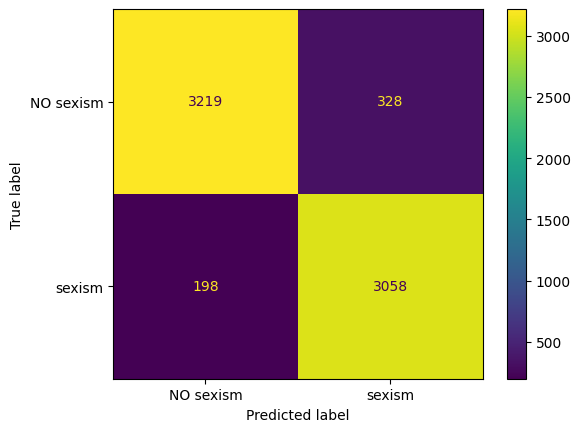

Se etiquetaron correctamente 6161 de un total de 6803 muestras.
Errores
MAE: 0.094
MSE: 0.307


              precision    recall  f1-score   support

           0       0.93      0.88      0.91      3547
           1       0.88      0.93      0.90      3256

    accuracy                           0.91      6803
   macro avg       0.91      0.91      0.91      6803
weighted avg       0.91      0.91      0.91      6803



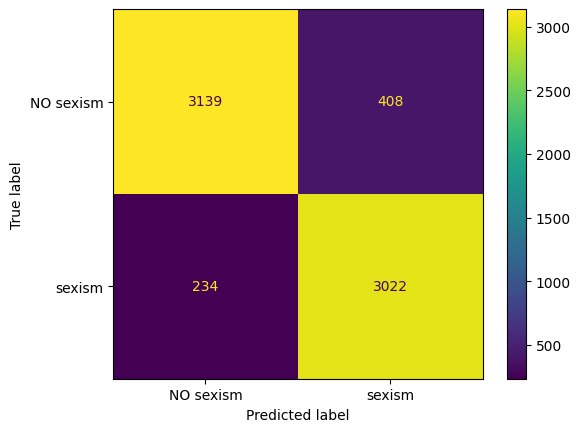

Se etiquetaron correctamente 6330 de un total de 6803 muestras.
Errores
MAE: 0.07
MSE: 0.264


              precision    recall  f1-score   support

           0       0.94      0.92      0.93      3547
           1       0.92      0.94      0.93      3256

    accuracy                           0.93      6803
   macro avg       0.93      0.93      0.93      6803
weighted avg       0.93      0.93      0.93      6803



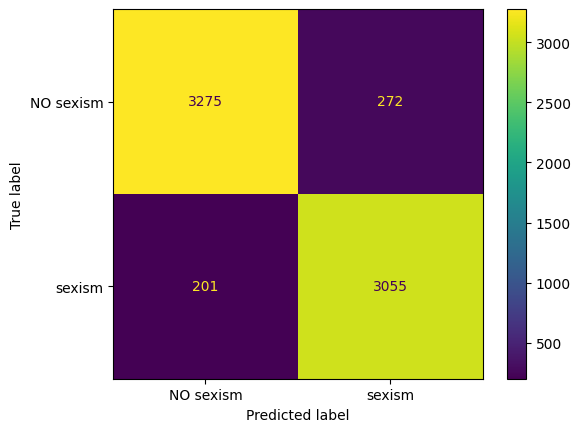

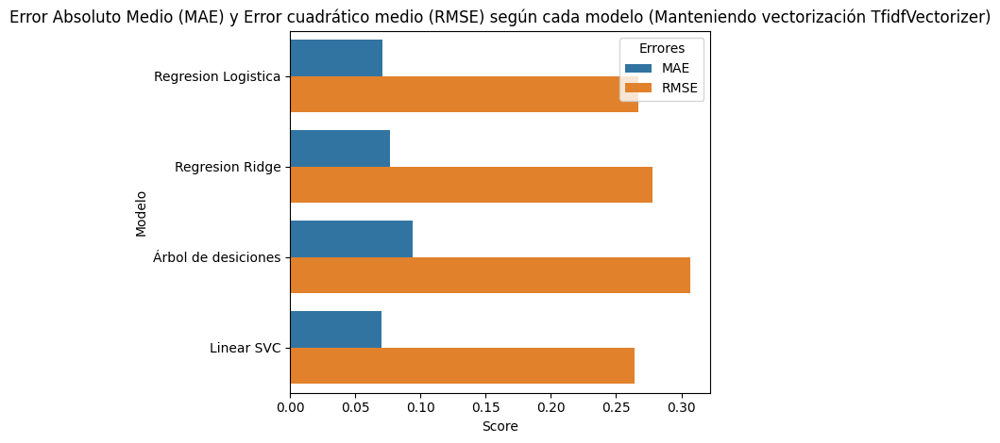

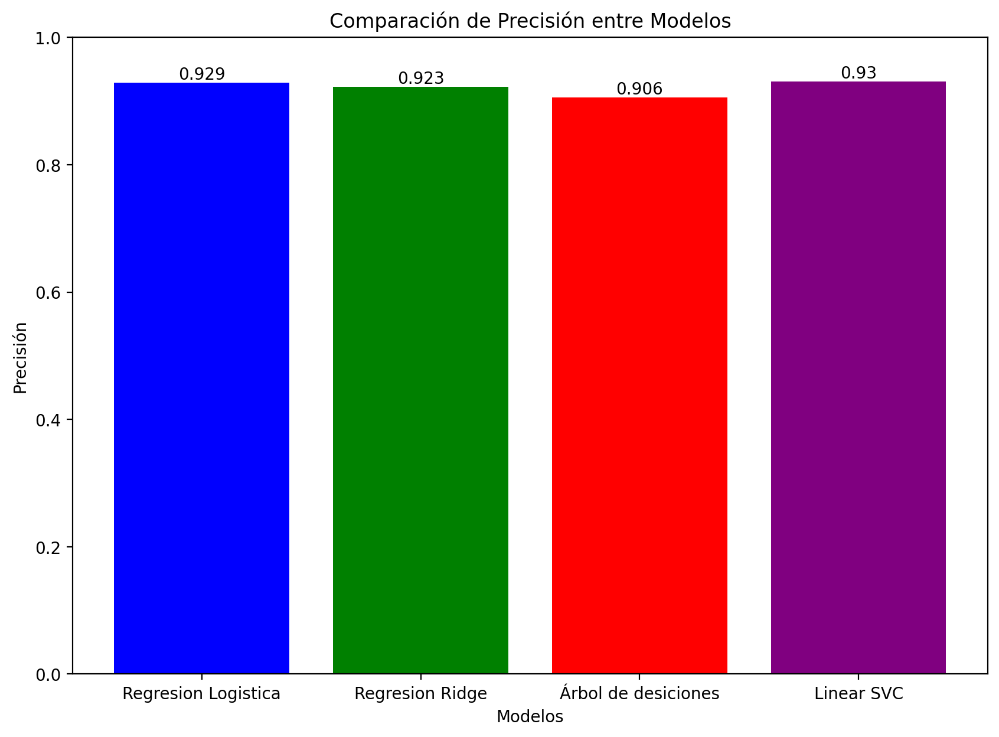

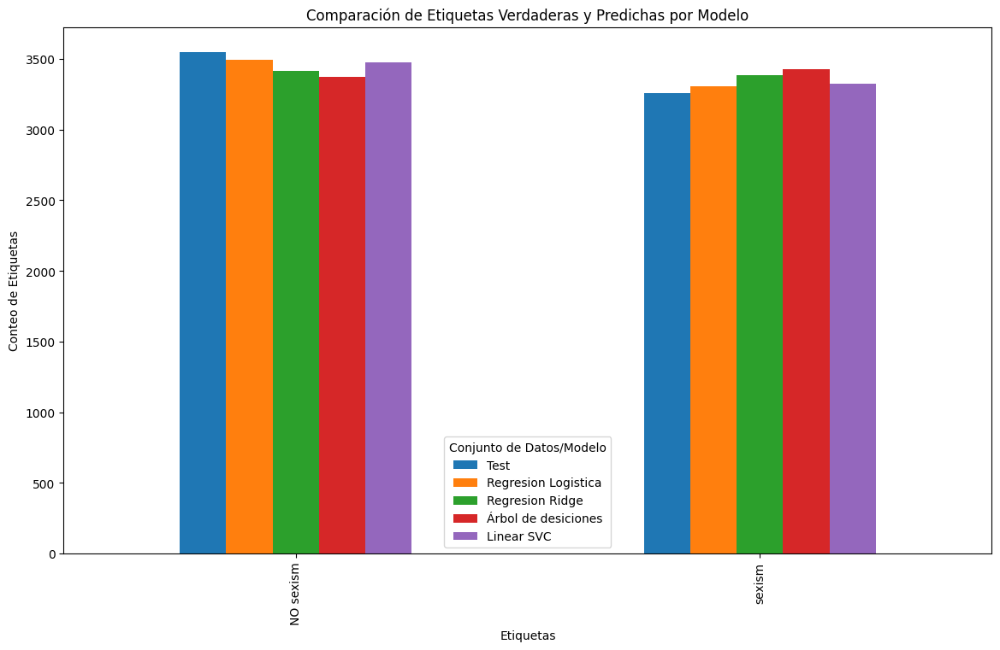

Se etiquetaron correctamente 6321 de un total de 6803 muestras.
Errores
MAE: 0.071
MSE: 0.266


              precision    recall  f1-score   support

           0       0.94      0.92      0.93      3547
           1       0.92      0.94      0.93      3256

    accuracy                           0.93      6803
   macro avg       0.93      0.93      0.93      6803
weighted avg       0.93      0.93      0.93      6803



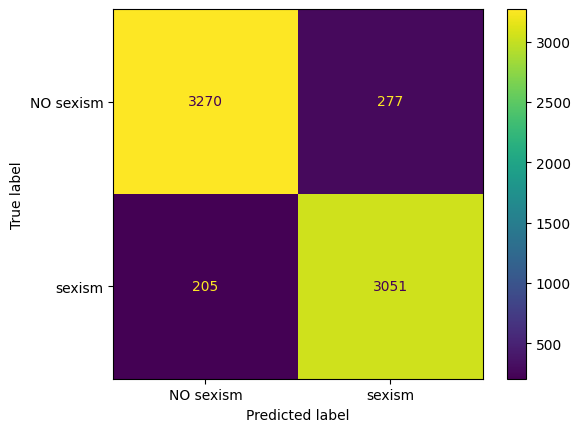

Se etiquetaron correctamente 6343 de un total de 6803 muestras.
Errores
MAE: 0.068
MSE: 0.26


              precision    recall  f1-score   support

           0       0.95      0.92      0.93      3547
           1       0.91      0.95      0.93      3256

    accuracy                           0.93      6803
   macro avg       0.93      0.93      0.93      6803
weighted avg       0.93      0.93      0.93      6803



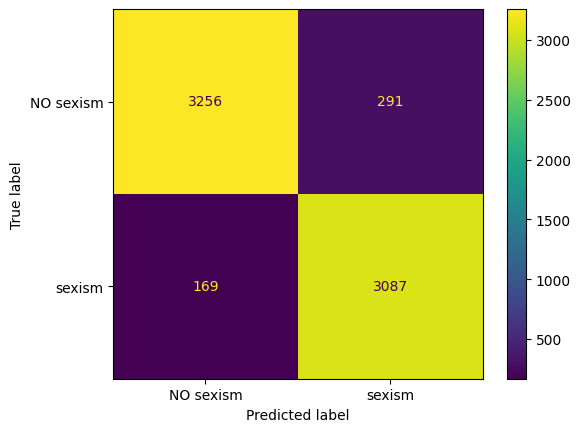

Se etiquetaron correctamente 6168 de un total de 6803 muestras.
Errores
MAE: 0.093
MSE: 0.306


              precision    recall  f1-score   support

           0       0.93      0.89      0.91      3547
           1       0.89      0.93      0.90      3256

    accuracy                           0.91      6803
   macro avg       0.91      0.91      0.91      6803
weighted avg       0.91      0.91      0.91      6803



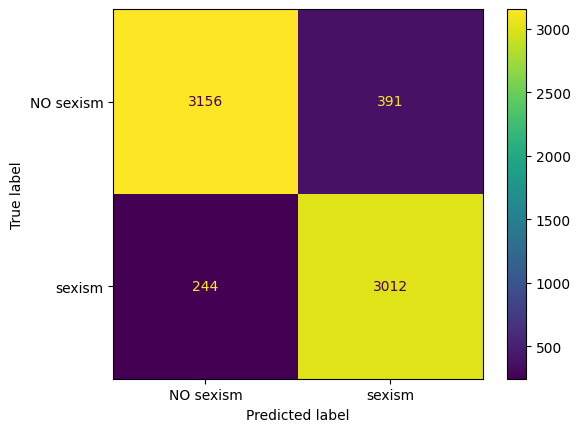

Se etiquetaron correctamente 6253 de un total de 6803 muestras.
Errores
MAE: 0.081
MSE: 0.284


              precision    recall  f1-score   support

           0       0.94      0.91      0.92      3547
           1       0.90      0.93      0.92      3256

    accuracy                           0.92      6803
   macro avg       0.92      0.92      0.92      6803
weighted avg       0.92      0.92      0.92      6803



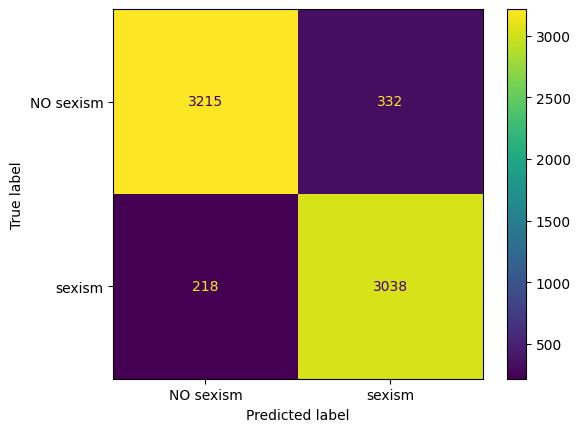

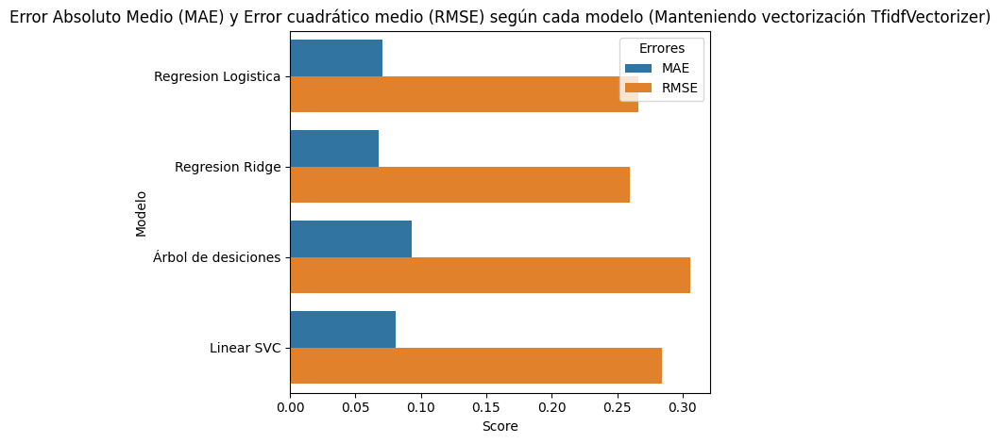

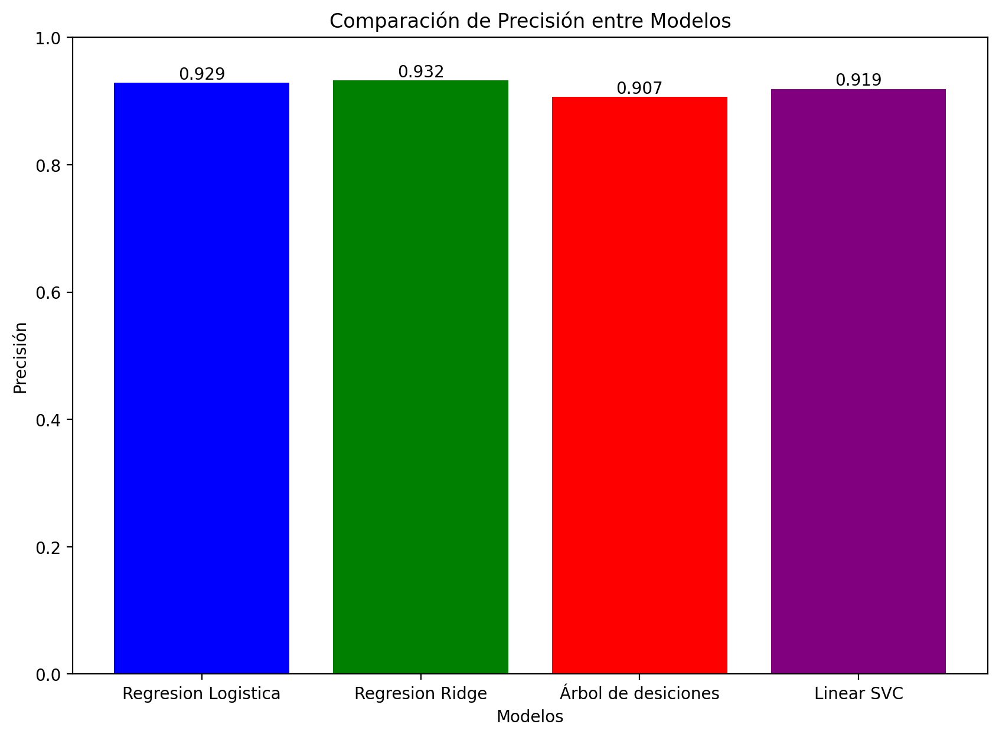

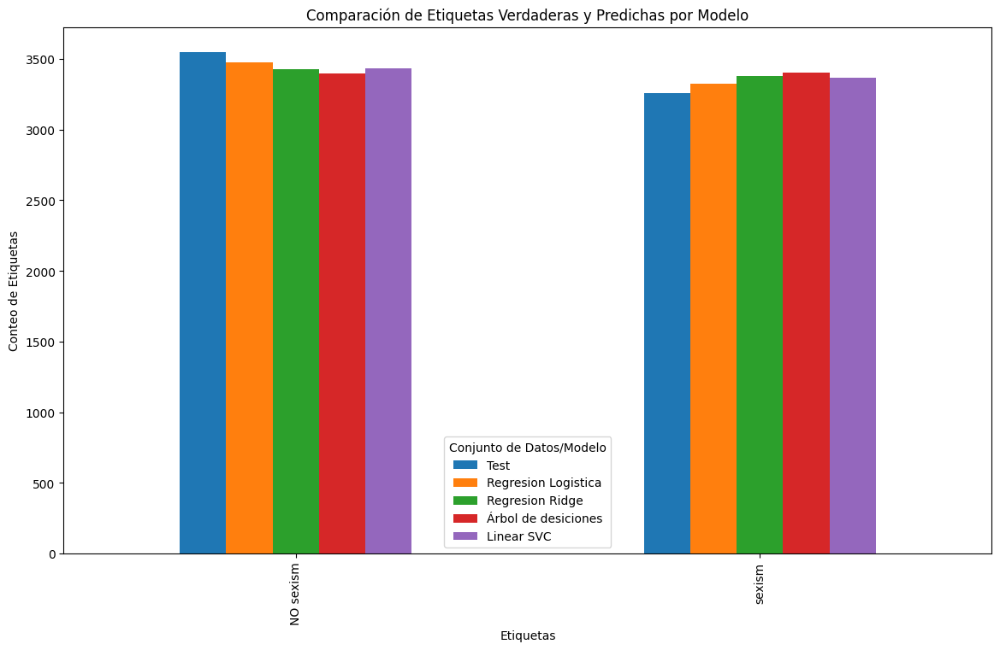

In [ ]:
#Classification babeh
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_balanced["Lematizado_Stemming"])

categories = ["NO sexism", "sexism"]

results_VecTFIDF = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_VecTFIDF,
                                             labels = categories,
                                             tam_test = 0.3)

results_CountVec = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_CountVec,
                                             labels = categories,
                                             tam_test = 0.3)

results_HashingVec = train_and_evaluate_models(df = df_balanced,
                                               X = text_norm_HashingVec,
                                               labels = categories,
                                               tam_test = 0.3)

### Para ODIO `df_odio_relation`

In [ ]:
#df ODIO REL
df_odio = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df_odio = df_odio.drop(columns=["user_id", "subforum_id", "num_contexts"])
df_odio = df_odio.drop((df_odio[df_odio["label"] == 2]).index)

df = df_odio.copy(deep=True)
df['label'].replace(3, 1, inplace = True) #Le decimos al sistema que trate la etiqueta Relation como Hate
# Revisamos la distribución de las etiquetas
print(df['label'].value_counts())

label
0    9507
1    1364
Name: count, dtype: int64


In [ ]:
#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority
print("Diferencia entre clases: ",num_augmentations)
#Data Augmentation
# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_hate = df[df['label'] == 1]
augmented_texts = []

for text in df_hate['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_balanced = pd.concat([df, df_augmented])

#Ejemplo texto
print("Ejemplo texto generado:", df_augmented["text"].iloc[5])

# Revisamos la nueva distribución de las etiquetas
print("Etiquetas balanceadas:")
print(df_balanced['label'].value_counts())

Diferencia entre clases:  8143
Ejemplo texto generado: She may or may non be a Jew but she ' s certainly stupid, she seems to imagine the Black wo n ' thyroxin kill her alongside every other Stanford white they can get their dirty hands on, what a muppet!
Etiquetas balanceadas:
label
0    9507
1    8184
Name: count, dtype: int64


In [ ]:
#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_balanced = preprocess_text(df_balanced)
# Función para hacer stemming y lematización
df_balanced['Lematizado_Stemming'] = df_balanced['text'].apply(stem_and_lemmatize)
df_balanced.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


Se etiquetaron correctamente 4700 de un total de 5308 muestras.
Errores
MAE: 0.115
MSE: 0.338


              precision    recall  f1-score   support

           0       0.89      0.90      0.89      2852
           1       0.88      0.87      0.87      2456

    accuracy                           0.89      5308
   macro avg       0.89      0.88      0.88      5308
weighted avg       0.89      0.89      0.89      5308



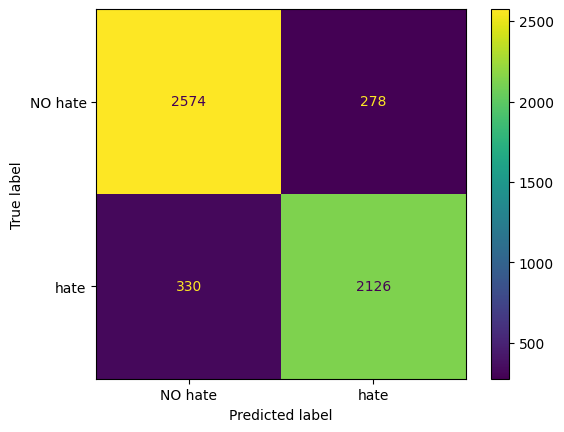

Se etiquetaron correctamente 4718 de un total de 5308 muestras.
Errores
MAE: 0.111
MSE: 0.333


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      2852
           1       0.89      0.87      0.88      2456

    accuracy                           0.89      5308
   macro avg       0.89      0.89      0.89      5308
weighted avg       0.89      0.89      0.89      5308



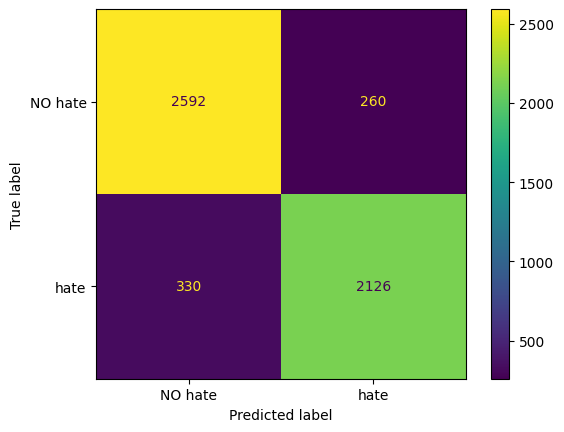

Se etiquetaron correctamente 4370 de un total de 5308 muestras.
Errores
MAE: 0.177
MSE: 0.42


              precision    recall  f1-score   support

           0       0.85      0.82      0.83      2852
           1       0.80      0.83      0.81      2456

    accuracy                           0.82      5308
   macro avg       0.82      0.82      0.82      5308
weighted avg       0.82      0.82      0.82      5308



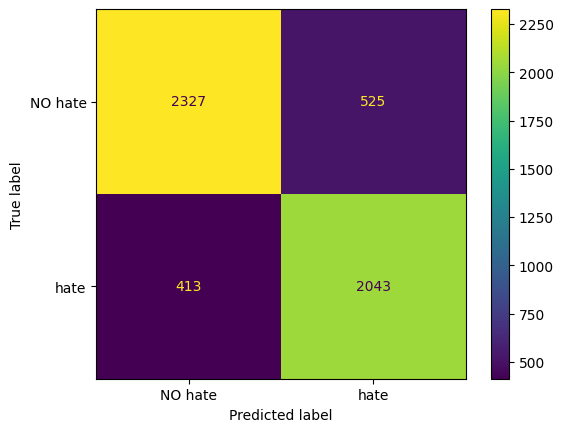

Se etiquetaron correctamente 4613 de un total de 5308 muestras.
Errores
MAE: 0.131
MSE: 0.362


              precision    recall  f1-score   support

           0       0.85      0.91      0.88      2852
           1       0.89      0.82      0.85      2456

    accuracy                           0.87      5308
   macro avg       0.87      0.87      0.87      5308
weighted avg       0.87      0.87      0.87      5308



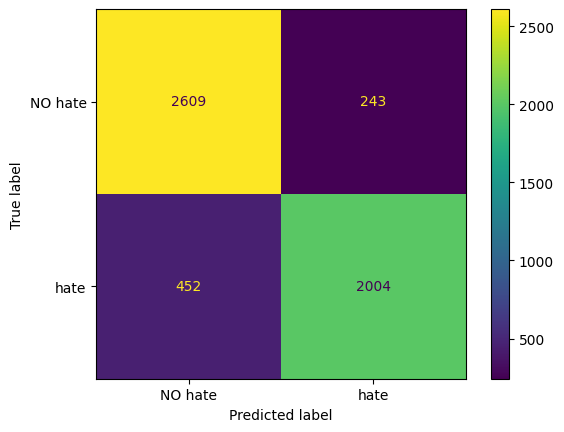

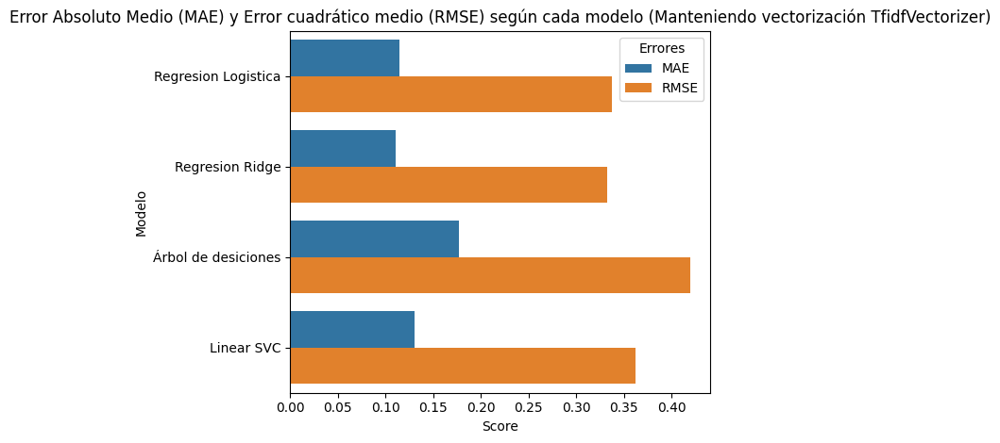

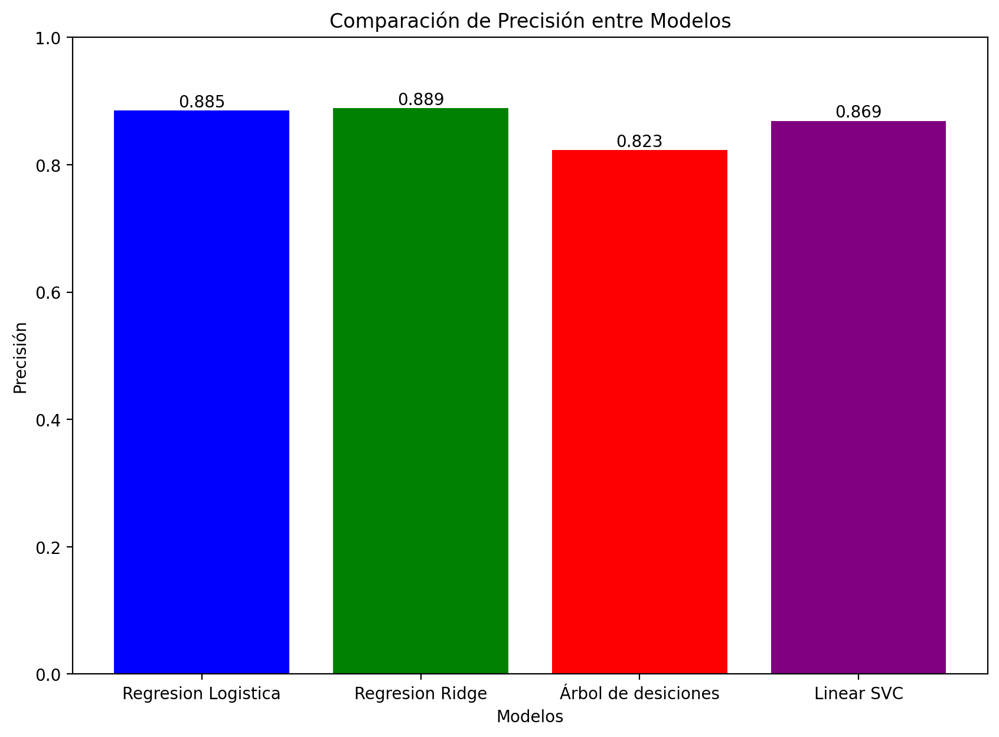

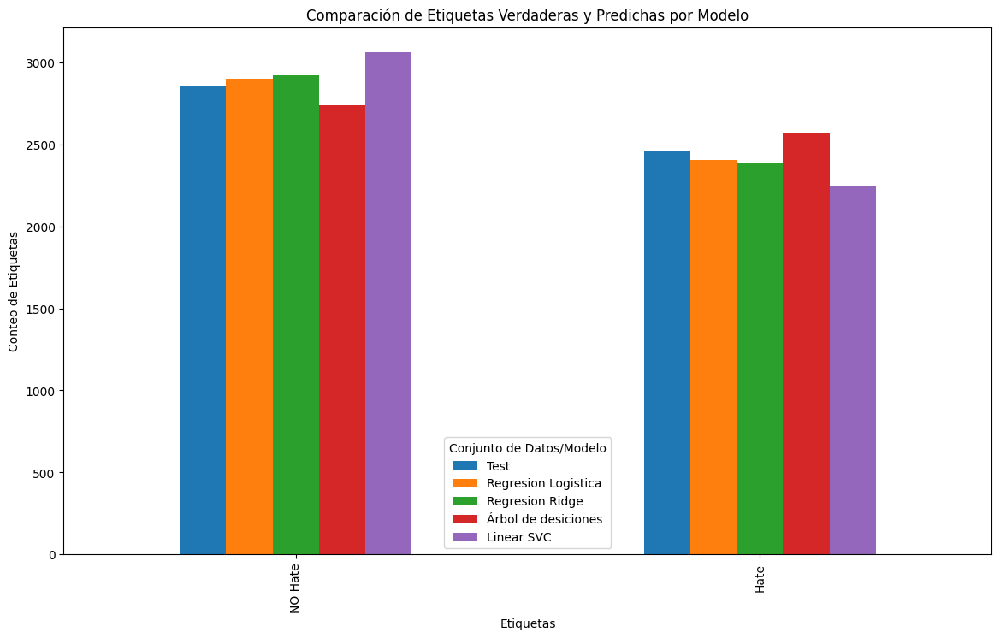

Se etiquetaron correctamente 4798 de un total de 5308 muestras.
Errores
MAE: 0.096
MSE: 0.31


              precision    recall  f1-score   support

           0       0.90      0.92      0.91      2852
           1       0.91      0.88      0.89      2456

    accuracy                           0.90      5308
   macro avg       0.90      0.90      0.90      5308
weighted avg       0.90      0.90      0.90      5308



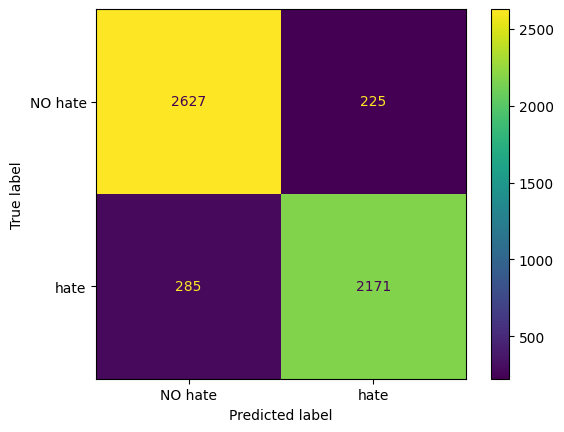

Se etiquetaron correctamente 4778 de un total de 5308 muestras.
Errores
MAE: 0.1
MSE: 0.316


              precision    recall  f1-score   support

           0       0.89      0.93      0.91      2852
           1       0.92      0.86      0.89      2456

    accuracy                           0.90      5308
   macro avg       0.90      0.90      0.90      5308
weighted avg       0.90      0.90      0.90      5308



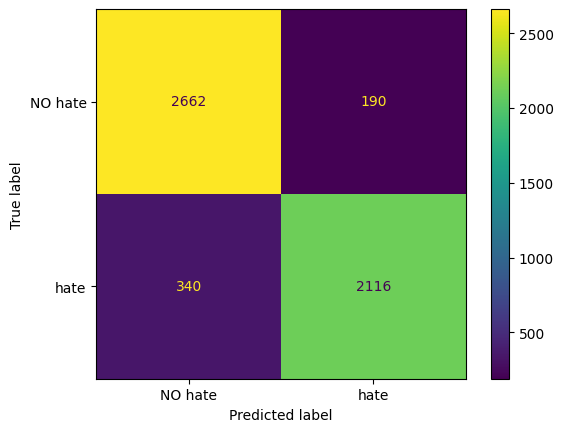

Se etiquetaron correctamente 4497 de un total de 5308 muestras.
Errores
MAE: 0.153
MSE: 0.391


              precision    recall  f1-score   support

           0       0.84      0.88      0.86      2852
           1       0.85      0.81      0.83      2456

    accuracy                           0.85      5308
   macro avg       0.85      0.84      0.85      5308
weighted avg       0.85      0.85      0.85      5308



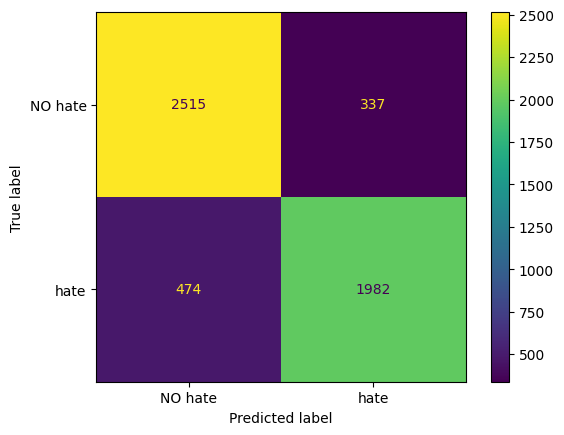

Se etiquetaron correctamente 4783 de un total de 5308 muestras.
Errores
MAE: 0.099
MSE: 0.314


              precision    recall  f1-score   support

           0       0.89      0.93      0.91      2852
           1       0.91      0.87      0.89      2456

    accuracy                           0.90      5308
   macro avg       0.90      0.90      0.90      5308
weighted avg       0.90      0.90      0.90      5308



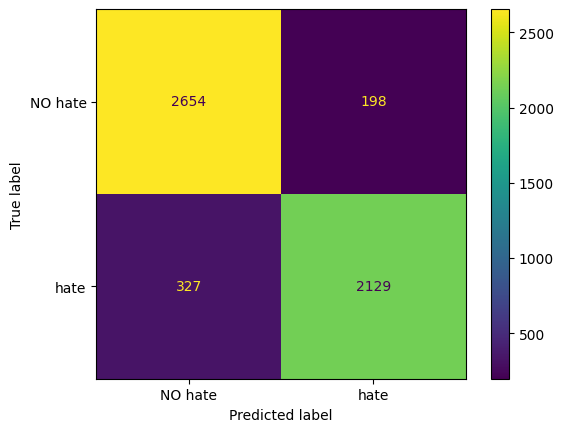

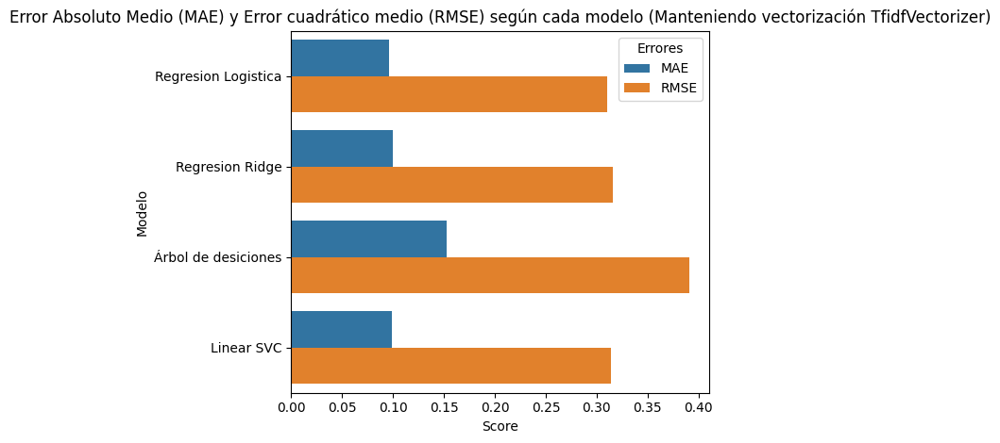

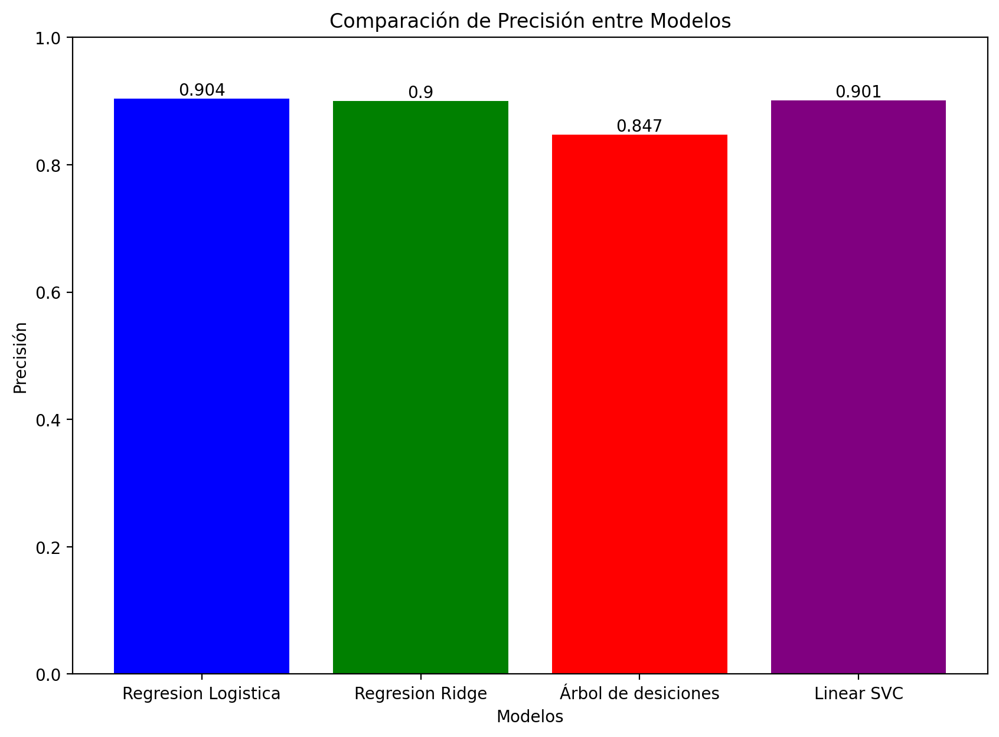

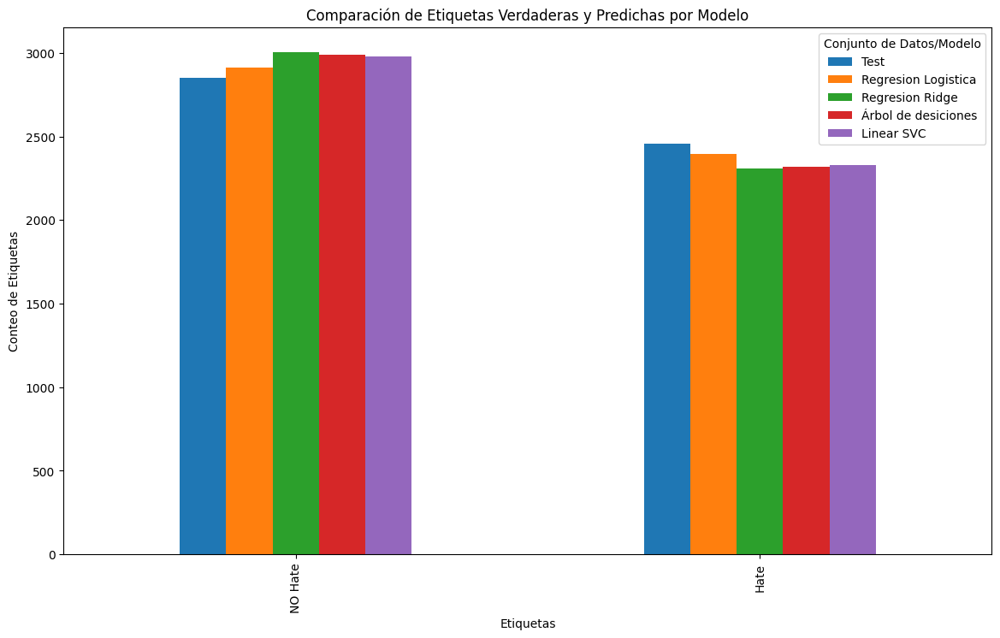

Se etiquetaron correctamente 4739 de un total de 5308 muestras.
Errores
MAE: 0.107
MSE: 0.327


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      2852
           1       0.90      0.87      0.88      2456

    accuracy                           0.89      5308
   macro avg       0.89      0.89      0.89      5308
weighted avg       0.89      0.89      0.89      5308



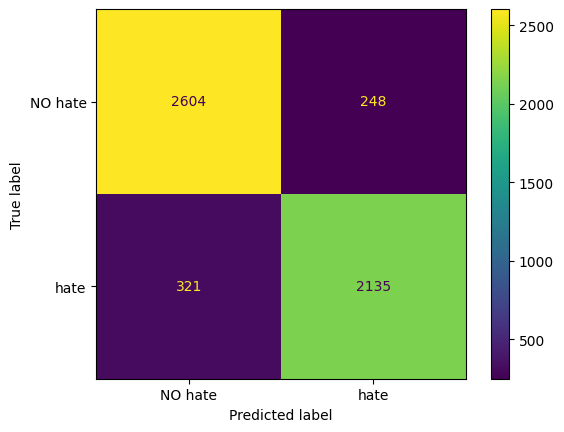

Se etiquetaron correctamente 4785 de un total de 5308 muestras.
Errores
MAE: 0.099
MSE: 0.314


              precision    recall  f1-score   support

           0       0.90      0.92      0.91      2852
           1       0.91      0.88      0.89      2456

    accuracy                           0.90      5308
   macro avg       0.90      0.90      0.90      5308
weighted avg       0.90      0.90      0.90      5308



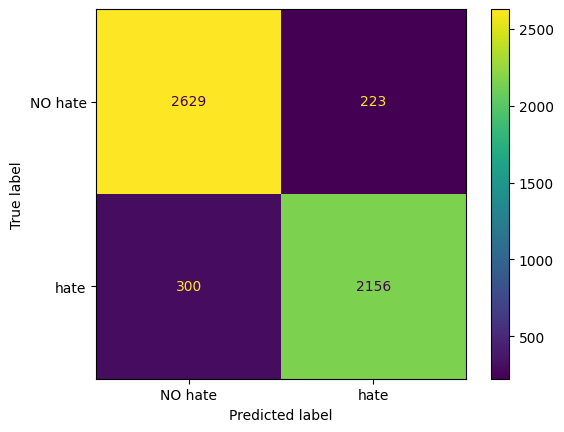

Se etiquetaron correctamente 4505 de un total de 5308 muestras.
Errores
MAE: 0.151
MSE: 0.389


              precision    recall  f1-score   support

           0       0.87      0.85      0.86      2852
           1       0.83      0.85      0.84      2456

    accuracy                           0.85      5308
   macro avg       0.85      0.85      0.85      5308
weighted avg       0.85      0.85      0.85      5308



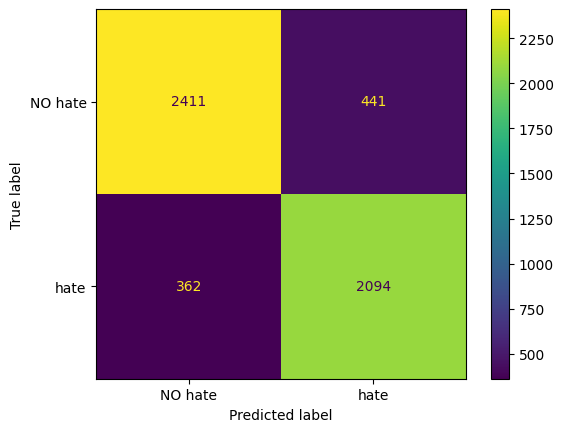

Se etiquetaron correctamente 4583 de un total de 5308 muestras.
Errores
MAE: 0.137
MSE: 0.37


              precision    recall  f1-score   support

           0       0.85      0.91      0.88      2852
           1       0.89      0.81      0.85      2456

    accuracy                           0.86      5308
   macro avg       0.87      0.86      0.86      5308
weighted avg       0.87      0.86      0.86      5308



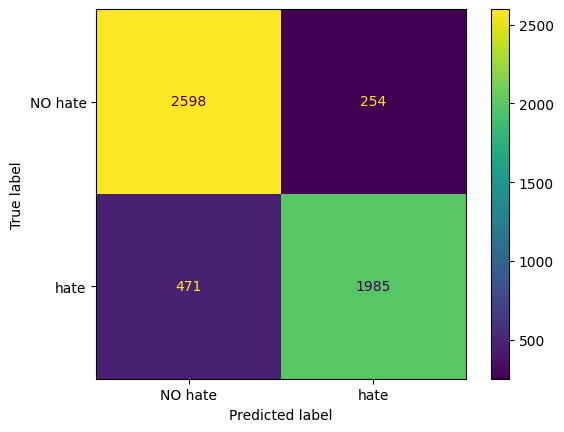

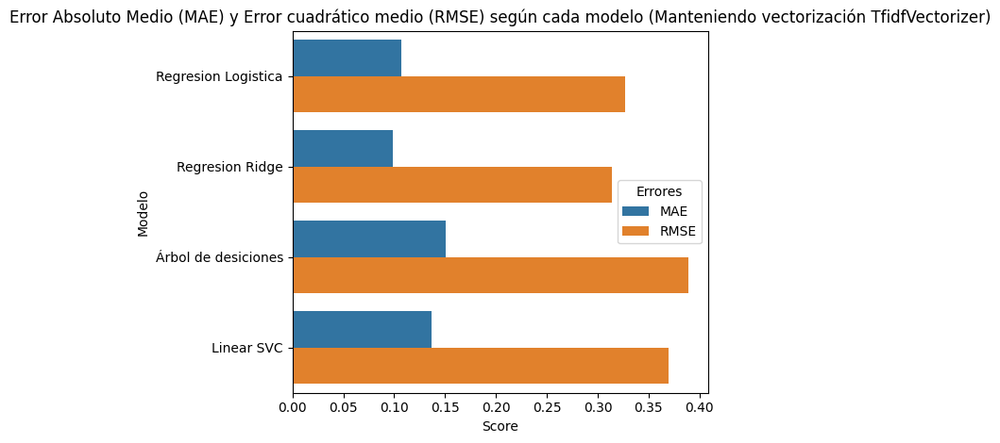

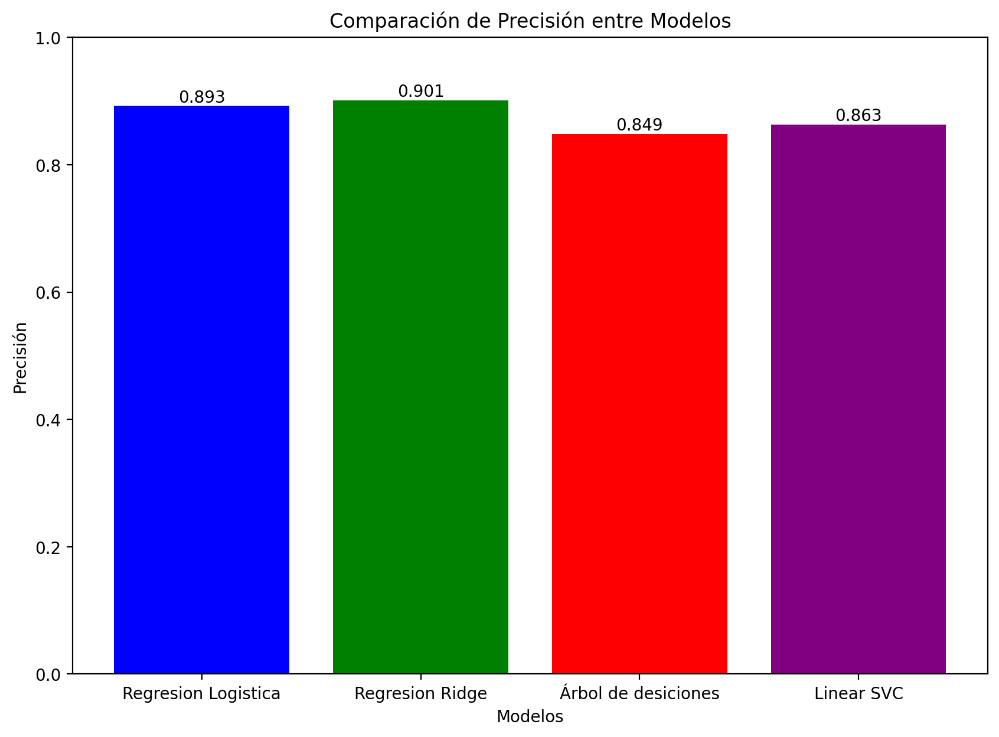

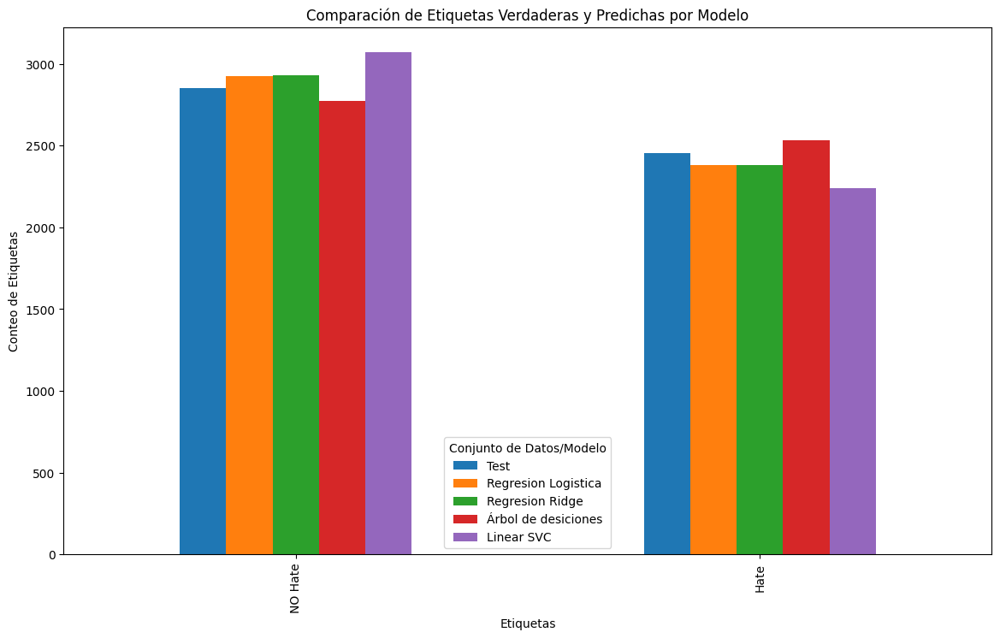

In [ ]:
#Classification babeh
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_balanced["Lematizado_Stemming"])

categories = ["NO hate", "hate"]

results_VecTFIDF = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_VecTFIDF,
                                             labels = categories,
                                             tam_test = 0.3)

results_CountVec = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_CountVec,
                                             labels = categories,
                                             tam_test = 0.3)

results_HashingVec = train_and_evaluate_models(df = df_balanced,
                                               X = text_norm_HashingVec,
                                               labels = categories,
                                               tam_test = 0.3)

### Para ODIO `df_odio_NOrelation`

In [ ]:
#df ODIO NO REL
df_odio = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df_odio = df_odio.drop(columns=["user_id", "subforum_id", "num_contexts"])
df_odio = df_odio.drop((df_odio[df_odio["label"] == 2]).index)

df = df_odio.copy(deep=True)
df = df.drop((df[df["label"] >= 2]).index)

# Revisamos la distribución de las etiquetas
print(df['label'].value_counts())

label
0    9507
1    1196
Name: count, dtype: int64


In [ ]:
#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority
print("Diferencia entre clases: ",num_augmentations)
#Data Augmentation
# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_hate = df[df['label'] == 1]
augmented_texts = []

for text in df_hate['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_balanced = pd.concat([df, df_augmented])

#Ejemplo texto
print("Ejemplo texto generado:", df_augmented["text"].iloc[5])

# Revisamos la nueva distribución de las etiquetas
print("Etiquetas balanceadas:")
print(df_balanced['label'].value_counts())

Diferencia entre clases:  8311
Ejemplo texto generado: Click below for a free people download of a colorfully illustrated 132 page e - book on the Zionist - engineered INTENTIONAL destruction of Western civilisation.
Etiquetas balanceadas:
label
0    9507
1    8372
Name: count, dtype: int64


In [ ]:
#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_balanced = preprocess_text(df_balanced)
# Función para hacer stemming y lematización
df_balanced['Lematizado_Stemming'] = df_balanced['text'].apply(stem_and_lemmatize)
df_balanced.head()

,text,label,Lematizado_Stemming
0,march th booklet downloaded times counting,0,march th booklet download time count
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...
4,click download mb green banner link,0,click download mb green banner link


Se etiquetaron correctamente 4835 de un total de 5364 muestras.
Errores
MAE: 0.099
MSE: 0.314


              precision    recall  f1-score   support

           0       0.90      0.91      0.91      2852
           1       0.90      0.89      0.89      2512

    accuracy                           0.90      5364
   macro avg       0.90      0.90      0.90      5364
weighted avg       0.90      0.90      0.90      5364



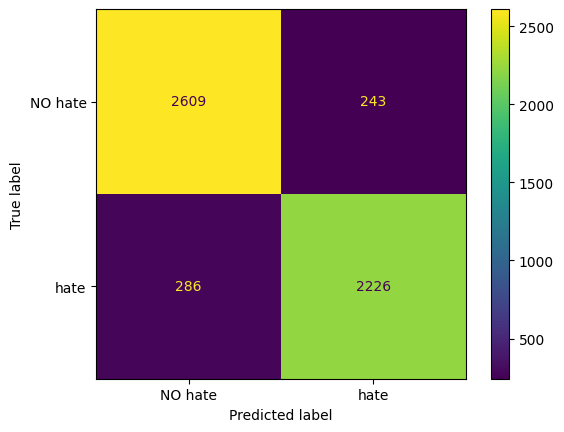

Se etiquetaron correctamente 4849 de un total de 5364 muestras.
Errores
MAE: 0.096
MSE: 0.31


              precision    recall  f1-score   support

           0       0.90      0.92      0.91      2852
           1       0.91      0.89      0.90      2512

    accuracy                           0.90      5364
   macro avg       0.90      0.90      0.90      5364
weighted avg       0.90      0.90      0.90      5364



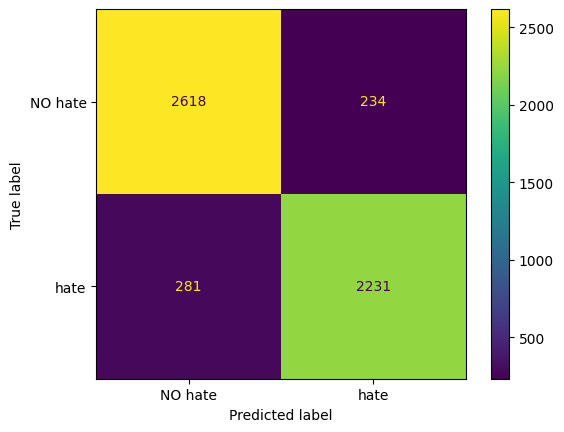

Se etiquetaron correctamente 4611 de un total de 5364 muestras.
Errores
MAE: 0.14
MSE: 0.375


              precision    recall  f1-score   support

           0       0.88      0.86      0.87      2852
           1       0.84      0.86      0.85      2512

    accuracy                           0.86      5364
   macro avg       0.86      0.86      0.86      5364
weighted avg       0.86      0.86      0.86      5364



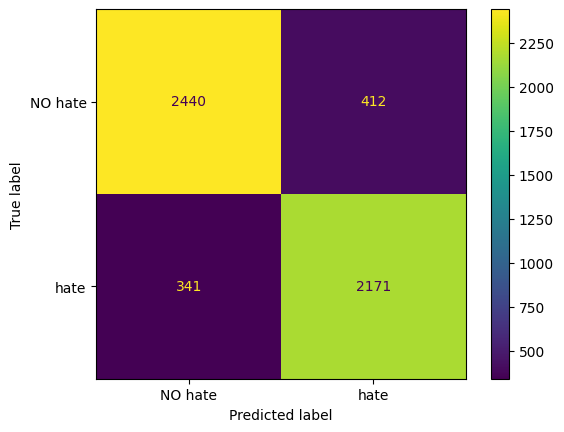

Se etiquetaron correctamente 4742 de un total de 5364 muestras.
Errores
MAE: 0.116
MSE: 0.341


              precision    recall  f1-score   support

           0       0.87      0.91      0.89      2852
           1       0.90      0.85      0.87      2512

    accuracy                           0.88      5364
   macro avg       0.89      0.88      0.88      5364
weighted avg       0.88      0.88      0.88      5364



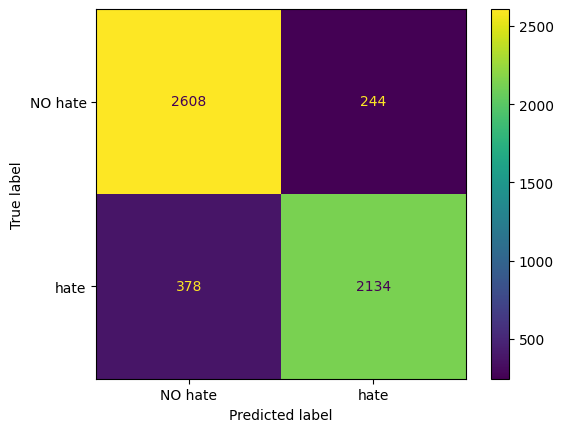

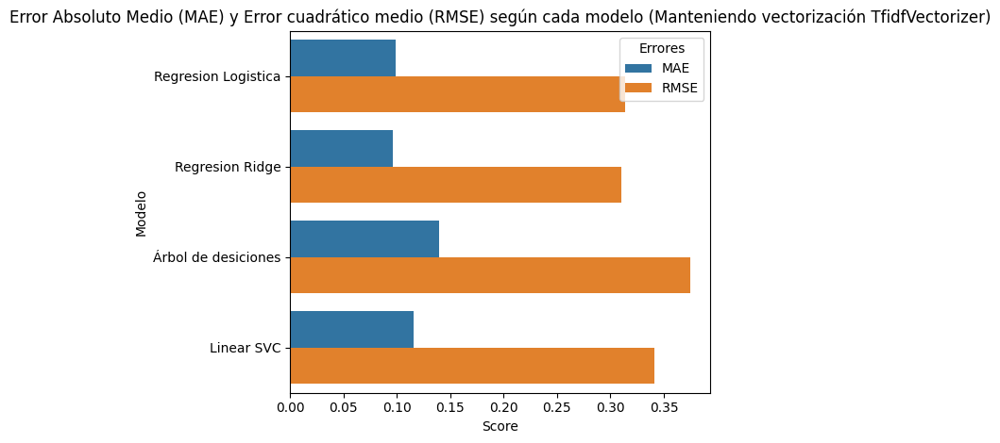

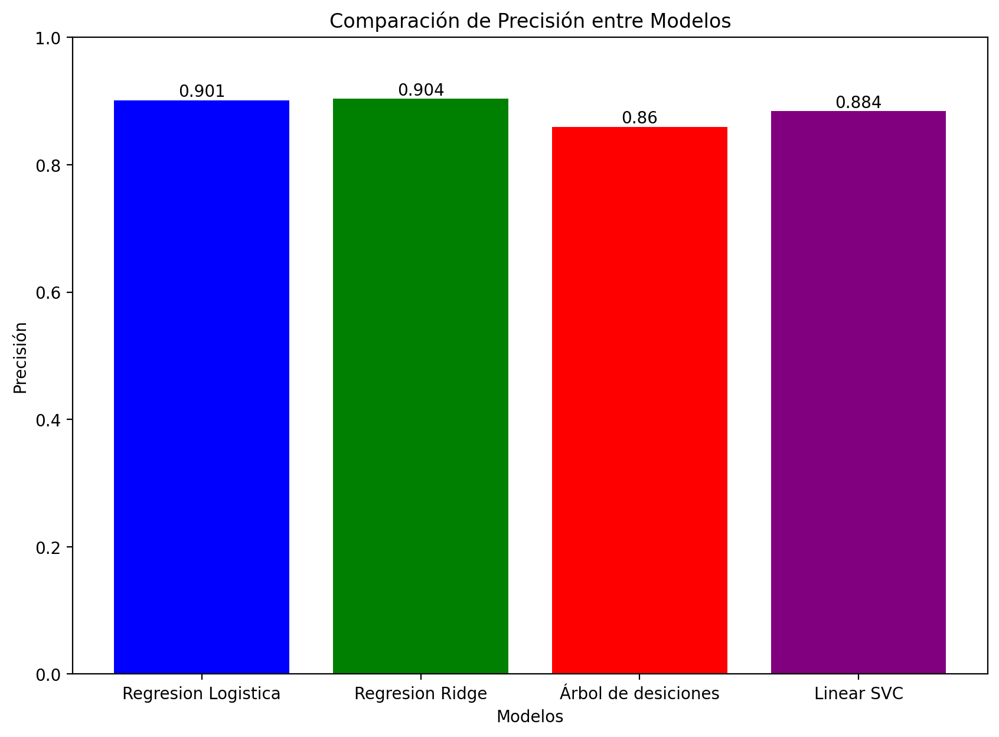

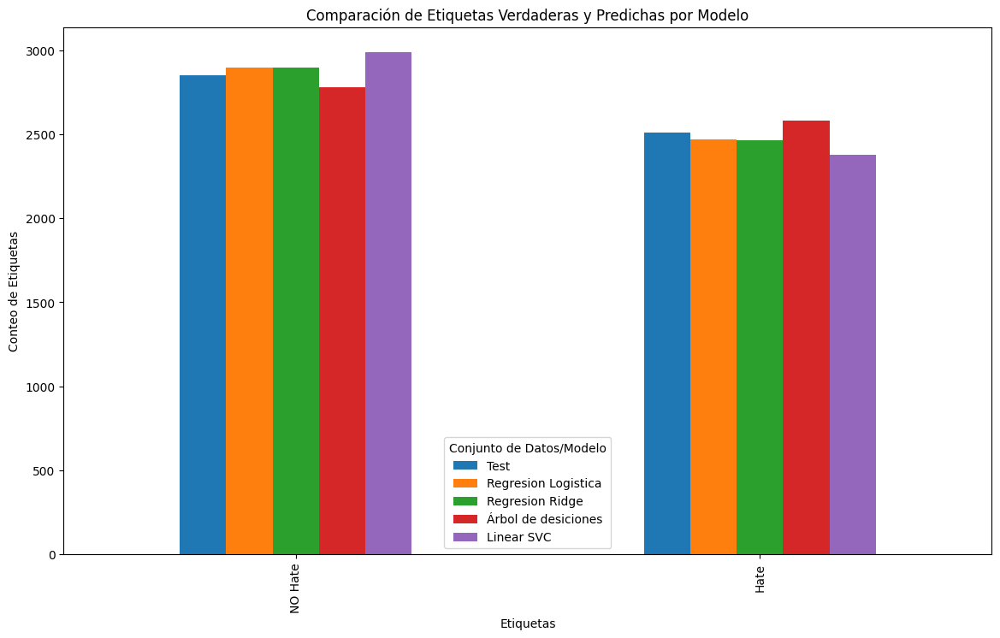

Se etiquetaron correctamente 4914 de un total de 5364 muestras.
Errores
MAE: 0.084
MSE: 0.29


              precision    recall  f1-score   support

           0       0.92      0.93      0.92      2852
           1       0.92      0.90      0.91      2512

    accuracy                           0.92      5364
   macro avg       0.92      0.92      0.92      5364
weighted avg       0.92      0.92      0.92      5364



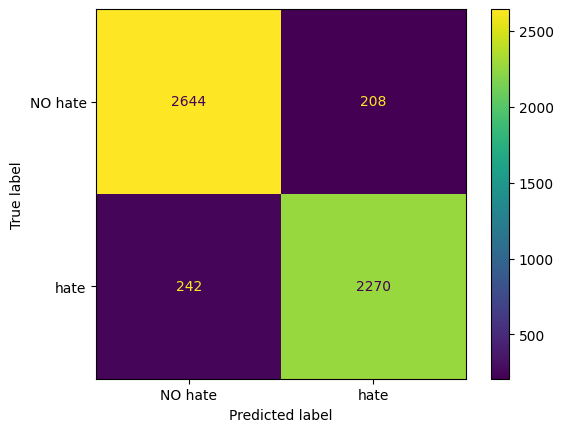

Se etiquetaron correctamente 4928 de un total de 5364 muestras.
Errores
MAE: 0.081
MSE: 0.285


              precision    recall  f1-score   support

           0       0.91      0.94      0.92      2852
           1       0.93      0.90      0.91      2512

    accuracy                           0.92      5364
   macro avg       0.92      0.92      0.92      5364
weighted avg       0.92      0.92      0.92      5364



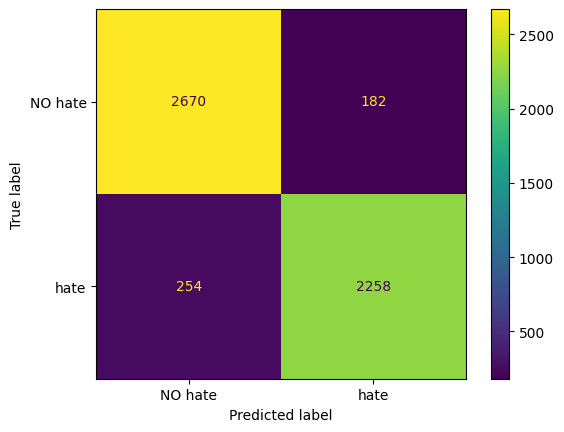

Se etiquetaron correctamente 4694 de un total de 5364 muestras.
Errores
MAE: 0.125
MSE: 0.353


              precision    recall  f1-score   support

           0       0.87      0.90      0.88      2852
           1       0.88      0.85      0.86      2512

    accuracy                           0.88      5364
   macro avg       0.88      0.87      0.87      5364
weighted avg       0.88      0.88      0.87      5364



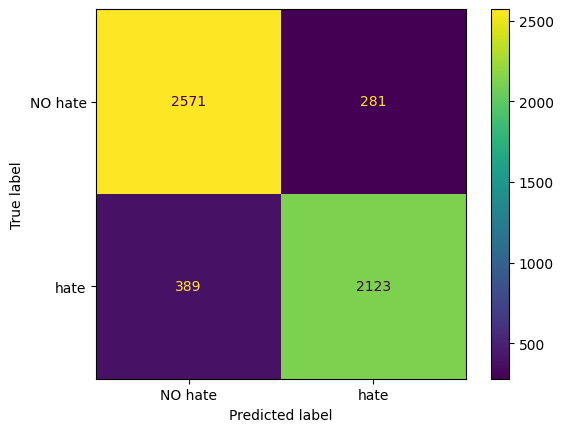

Se etiquetaron correctamente 4914 de un total de 5364 muestras.
Errores
MAE: 0.084
MSE: 0.29


              precision    recall  f1-score   support

           0       0.91      0.94      0.92      2852
           1       0.92      0.89      0.91      2512

    accuracy                           0.92      5364
   macro avg       0.92      0.91      0.92      5364
weighted avg       0.92      0.92      0.92      5364



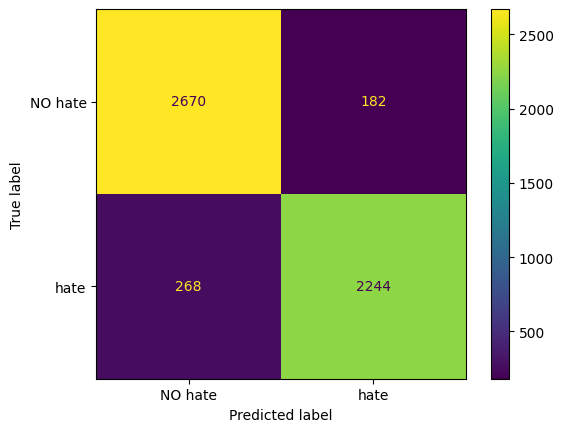

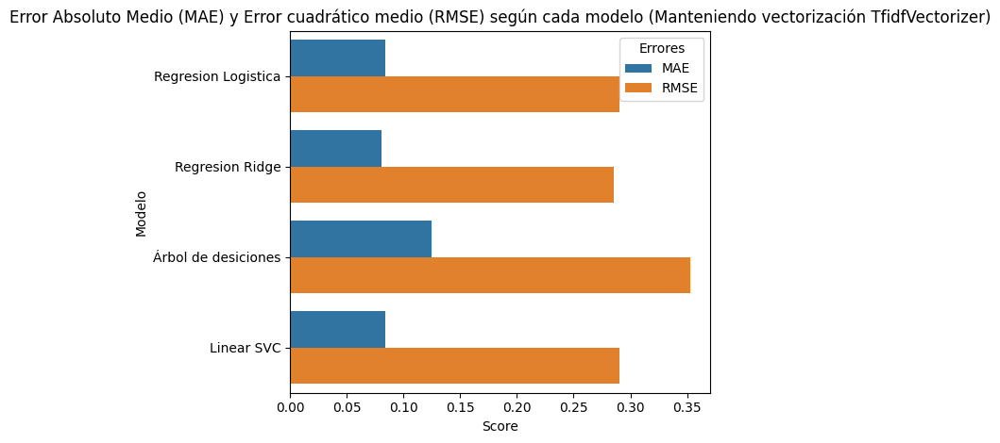

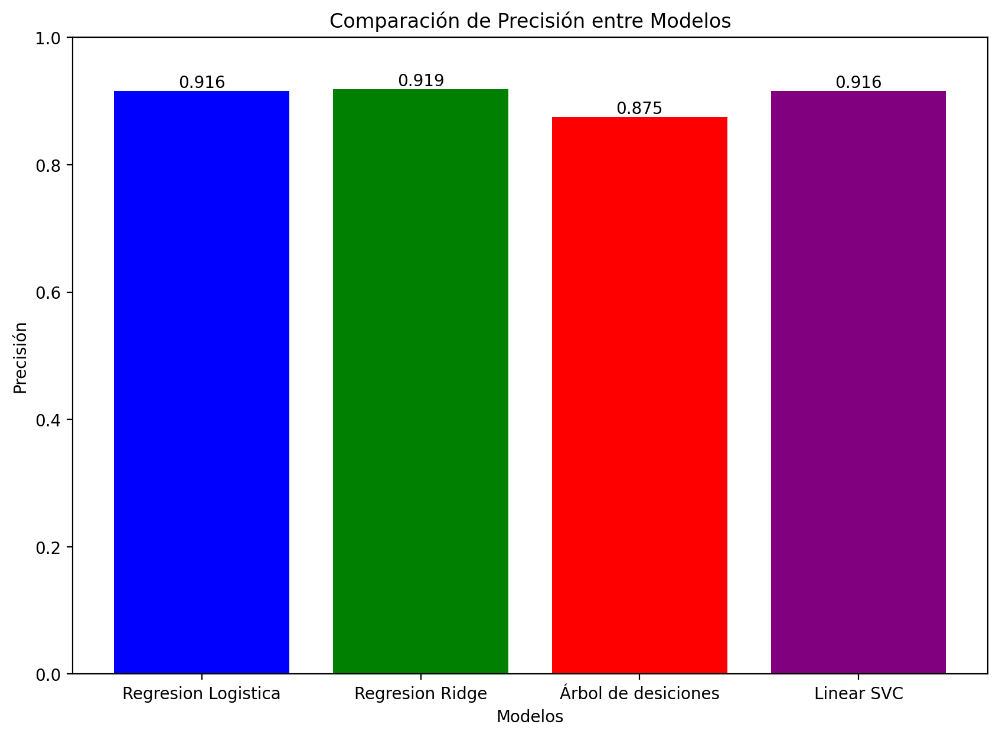

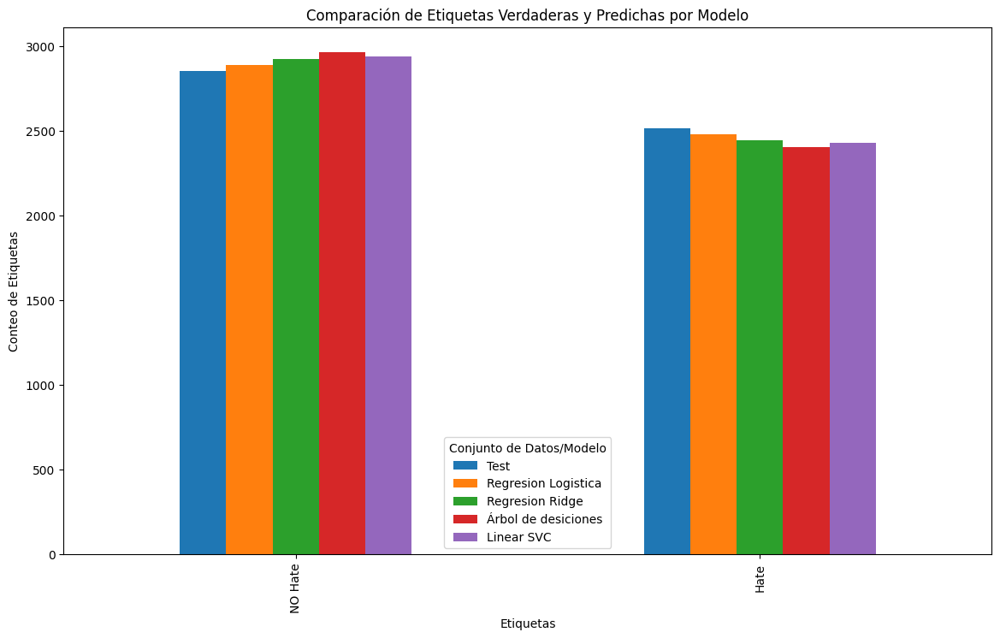

Se etiquetaron correctamente 4869 de un total de 5364 muestras.
Errores
MAE: 0.092
MSE: 0.304


              precision    recall  f1-score   support

           0       0.91      0.92      0.91      2852
           1       0.91      0.89      0.90      2512

    accuracy                           0.91      5364
   macro avg       0.91      0.91      0.91      5364
weighted avg       0.91      0.91      0.91      5364



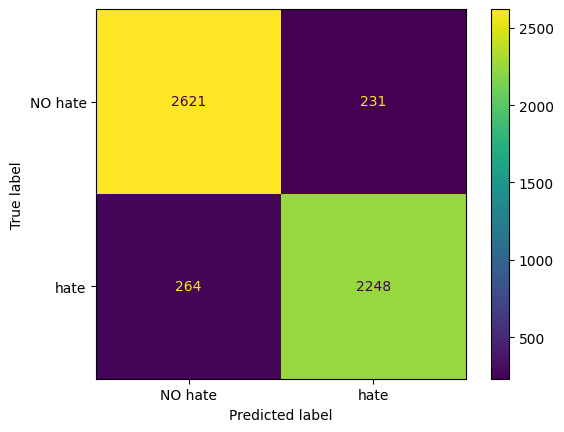

Se etiquetaron correctamente 4918 de un total de 5364 muestras.
Errores
MAE: 0.083
MSE: 0.288


              precision    recall  f1-score   support

           0       0.92      0.93      0.92      2852
           1       0.92      0.91      0.91      2512

    accuracy                           0.92      5364
   macro avg       0.92      0.92      0.92      5364
weighted avg       0.92      0.92      0.92      5364



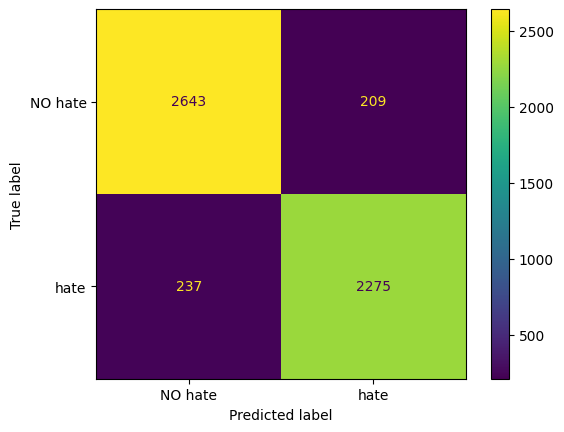

Se etiquetaron correctamente 4663 de un total de 5364 muestras.
Errores
MAE: 0.131
MSE: 0.362


              precision    recall  f1-score   support

           0       0.88      0.87      0.88      2852
           1       0.86      0.87      0.86      2512

    accuracy                           0.87      5364
   macro avg       0.87      0.87      0.87      5364
weighted avg       0.87      0.87      0.87      5364



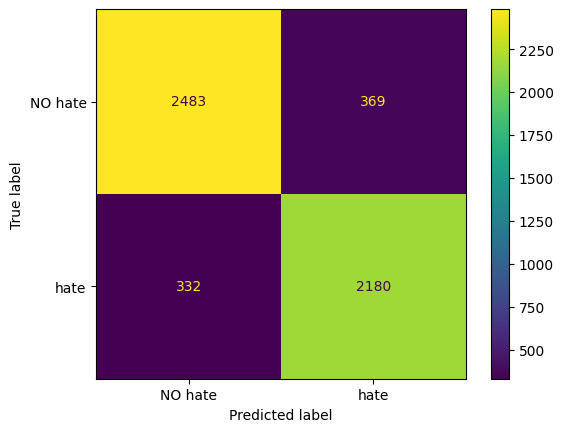

Se etiquetaron correctamente 4739 de un total de 5364 muestras.
Errores
MAE: 0.117
MSE: 0.341


              precision    recall  f1-score   support

           0       0.87      0.91      0.89      2852
           1       0.90      0.85      0.87      2512

    accuracy                           0.88      5364
   macro avg       0.88      0.88      0.88      5364
weighted avg       0.88      0.88      0.88      5364



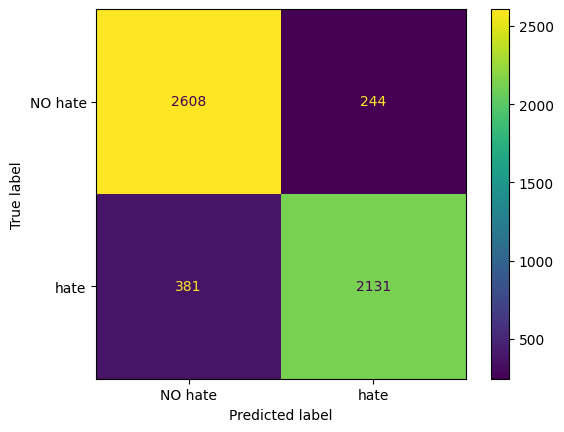

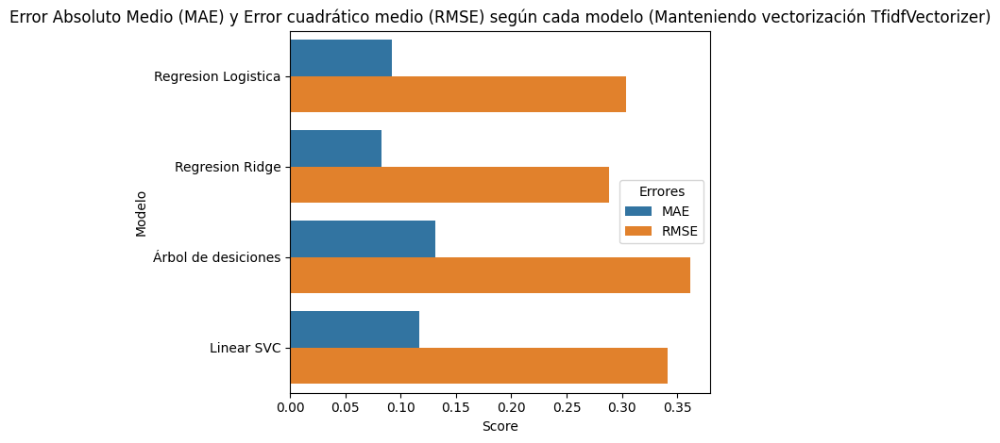

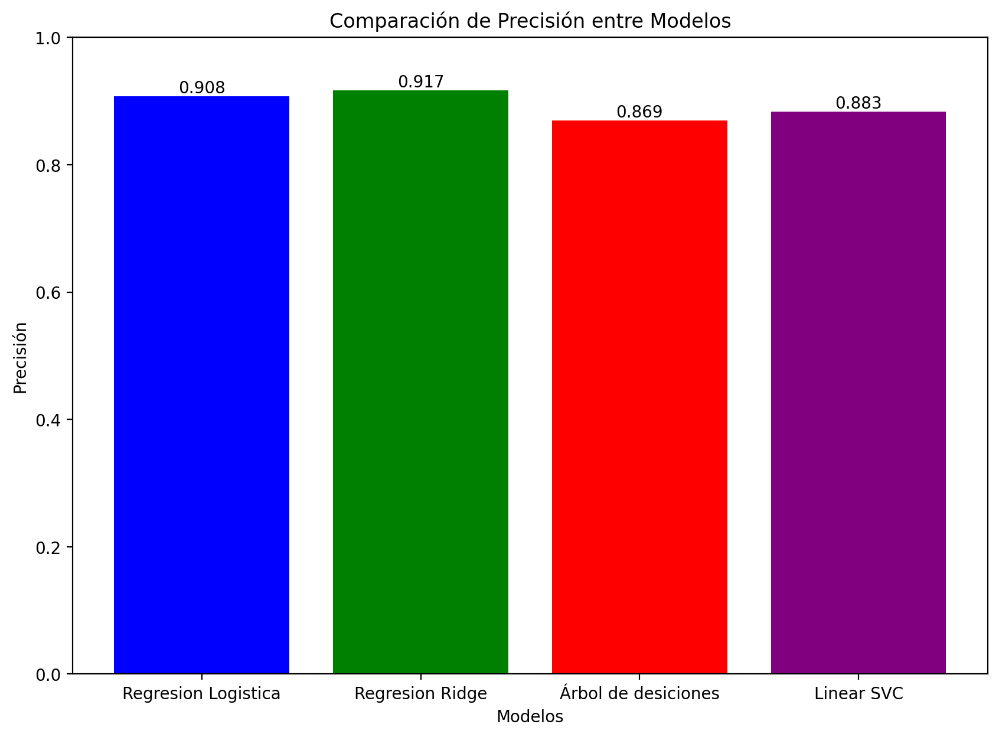

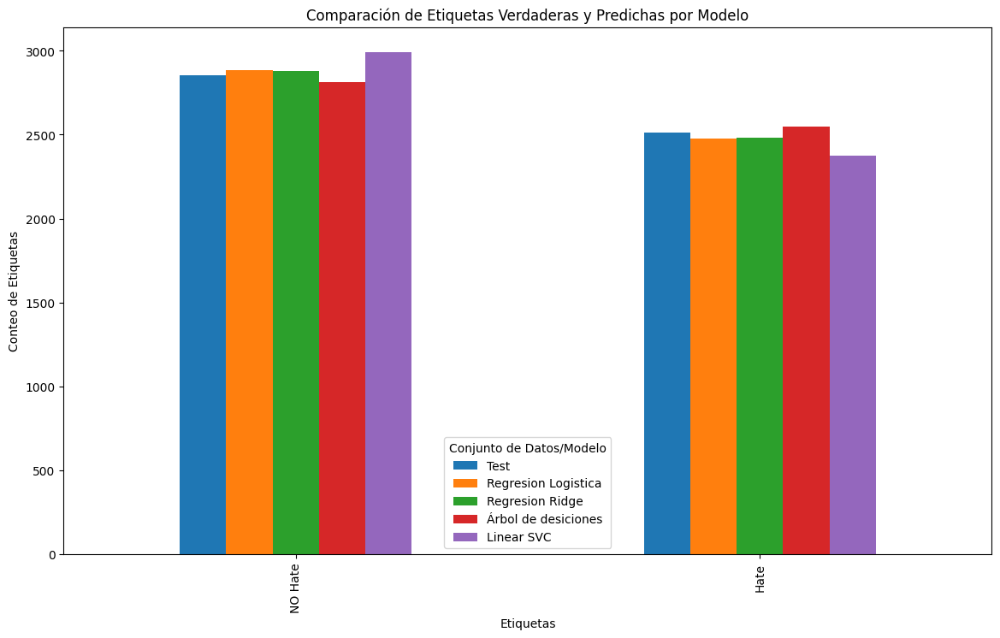

In [ ]:
#Classification babeh
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_balanced["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_balanced["Lematizado_Stemming"])

categories = ["NO hate", "hate"]

results_VecTFIDF = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_VecTFIDF,
                                             labels = categories,
                                             tam_test = 0.3)

results_CountVec = train_and_evaluate_models(df = df_balanced,
                                             X = text_norm_CountVec,
                                             labels = categories,
                                             tam_test = 0.3)

results_HashingVec = train_and_evaluate_models(df = df_balanced,
                                               X = text_norm_HashingVec,
                                               labels = categories,
                                               tam_test = 0.3)

## lbl2Vec para Corpus Balanceados

In [ ]:
# Función para crear documentos gensim Doc2Vec
def create_doc2vec_documents(df):
    documents = []
    for i, row in df.iterrows():
        words = row["text"].split()
        tags = [row["label"]]  # Usar una lista para la etiqueta
        document = gensim.models.doc2vec.TaggedDocument(words, tags)
        documents.append(document)
    return documents
def remove_non_alphabetic(text):
    return ''.join([char for char in text if char.isalpha() or char.isspace() or emoji.is_emoji(char)])

# Algoritmo de preprocesamiento
def preprocess_text(df):

    stop_words = set(stopwords.words('english'))

    # Convertir los textos a minúsculas
    df["text"] = df["text"].str.lower()

    # Eliminar caracteres no alfabéticos, manteniendo emojis
    df["text"] = df["text"].apply(remove_non_alphabetic)

    # Eliminar stop-words
    df["text"] = df["text"].apply(lambda x: ' '.join([word for word in x.split() if word not in stop_words]))

    return df

# Aplicar el preprocesamiento al DataFrame
#df = preprocess_text(df)

# Inicializar Stemmer y Lemmatizer
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

# Función para hacer stemming y lematización
def stem_and_lemmatize(text):
    tokens = nltk.word_tokenize(text)
    stemmed = [stemmer.stem(token) for token in tokens]
    lemmatized = [lemmatizer.lemmatize(token) for token in stemmed]
    return ' '.join(lemmatized)

# Aplicar stemming y lematización al DataFrame
#df["text"] = df["text"].apply(stem_and_lemmatize)
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

### Para SEXISMO

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/sexism_data.csv")
df = df.drop(columns=["toxicity","id", "dataset", "of_id"]) #no son nenecsarias
df["sexist"].replace({True:1, False:0},inplace=True)#reemplazamos 1 = True, 0=false
df = df.rename(columns = {"sexist":"label"})

#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority

# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_sexism = df[df['label'] == 1]
augmented_texts = []

for text in df_sexism['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_sexista = pd.concat([df, df_augmented])


#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_sexista = preprocess_text(df_sexista)
# Función para hacer stemming y lematización
df_sexista['Lematizado_Stemming'] = df_sexista['text'].apply(stem_and_lemmatize)

tagged_documents = create_doc2vec_documents(df_sexista)
df_sexista.insert(len(df_sexista.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_sexista["doc_key"] = df_sexista.index.astype(str)
df_sexista.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,mention didnt even know random option,0,mention didnt even know random option,"([mention, didnt, even, know, random, option],...",0
1,bottom two shouldve gone mkr,0,bottom two shouldv gone mkr,"([bottom, two, shouldve, gone, mkr], [0])",1
2,mention mention ladyboner deserves much credit...,0,mention mention ladybon deserv much credit dud...,"([mention, mention, ladyboner, deserves, much,...",2
3,shall known sourpuss mkr katandre failedfoodies,0,shall known sourpuss mkr katandr failedfoodi,"([shall, known, sourpuss, mkr, katandre, faile...",3
4,tarah w threw bunch women bus could get wadhwa...,0,tarah w threw bunch woman bu could get wadhwa ...,"([tarah, w, threw, bunch, women, bus, could, g...",4


In [ ]:
# Etiquetas
label_names = {0: 'NO sexist', 1: 'sexist'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_sexista['label'].unique():
    keywords, num_keywords = get_keywords(df_sexista, label) #get_keywords(df_sexista, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)


In [ ]:
df_sexista = df_sexista.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)
df_sexista.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords
0,mention didnt even know random option,0,mention didnt even know random option,"([mention, didnt, even, know, random, option],...",0,NO sexist,11736
1,bottom two shouldve gone mkr,0,bottom two shouldv gone mkr,"([bottom, two, shouldve, gone, mkr], [0])",1,NO sexist,11736
2,mention mention ladyboner deserves much credit...,0,mention mention ladybon deserv much credit dud...,"([mention, mention, ladyboner, deserves, much,...",2,NO sexist,11736
3,shall known sourpuss mkr katandre failedfoodies,0,shall known sourpuss mkr katandr failedfoodi,"([shall, known, sourpuss, mkr, katandre, faile...",3,NO sexist,11736
4,tarah w threw bunch women bus could get wadhwa...,0,tarah w threw bunch woman bu could get wadhwa ...,"([tarah, w, threw, bunch, women, bus, could, g...",4,NO sexist,11736


In [ ]:
df_sexista_train, df_sexista_test = train_test_split(df_sexista, test_size = 0.2, random_state = 123, stratify=df_sexista["label"])

df_sexista_train["data_set_type"] = "train"

df_sexista_test["data_set_type"] = "test"

# concatenamos
df_sexista_full = pd.concat([df_sexista_train,df_sexista_test]).reset_index(drop=True)
df_sexista_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,place mkr mkr,0,place mkr mkr,"([place, mkr, mkr], [0])",9037,NO sexist,11736,train
1,drasko steve david margret restaurant reviews mkr,0,drasko steve david margret restaur review mkr,"([drasko, steve, david, margret, restaurant, r...",12667,NO sexist,11736,train
2,heres review games ive ever played fuck misogy...,0,here review game ive ever play fuck misogynist...,"([heres, review, games, ive, ever, played, fuc...",1787,NO sexist,11736,train
3,creates isolation needed longerterm campaigns ...,0,creat isol need longerterm campaign threaten a...,"([creates, isolation, needed, longerterm, camp...",2634,NO sexist,11736,train
4,deconstructed lemon tart plate crushed biscuit...,0,deconstruct lemon tart plate crush biscuit mkr,"([deconstructed, lemon, tart, plate, crushed, ...",12935,NO sexist,11736,train


In [ ]:
start_time = time.time()
lbl2vec_model_sexism = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_sexista_full['tagged_documents'][df_sexista_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.9, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_sexism.fit()
# test
new_docs_lbl_similarities_sexism = lbl2vec_model_sexism.predict_new_docs(tagged_docs = df_sexista_full['tagged_documents'][df_sexista_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-13 17:10:09,190 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:10:09,190 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:10:09,190 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:10:09,190 - Lbl2Vec - INFO - Train document and word embeddings
INFO:Lbl2Vec:Train document and word embeddings
2024-06-13 17:10:27,753 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:10:27,753 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:10:27,753 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:10:27,753 - Lbl2Vec - INFO - Train label embeddings
INFO:Lbl2Vec:Train label embeddings
2024-06-13 17:10:28,147 - Lbl2Vec - WARNING - The following keywords from the 'keywords_list' are unknown to the Doc2Vec model and therefore not used to train the model: peopl realli andr that your someon tri pretti everi footbal mani sorri someth anoth happi alway anyon ye actual gamerg comment there theyr rooki harass restaur happen not

Tiempo de ejecución: 40.07835936546326 segundos


In [ ]:
df_pred = new_docs_lbl_similarities_sexism.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO sexist":0, "sexist":1}, inplace = True)
df_pred["label"].value_counts()

label
0    4536
Name: count, dtype: int64

Se etiquetaron correctamente 2365 de un total de 4536 muestras.
Errores
MAE: 0.479
MSE: 0.692


              precision    recall  f1-score   support

           0       0.52      1.00      0.69      2365
           1       0.00      0.00      0.00      2171

    accuracy                           0.52      4536
   macro avg       0.26      0.50      0.34      4536
weighted avg       0.27      0.52      0.36      4536



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


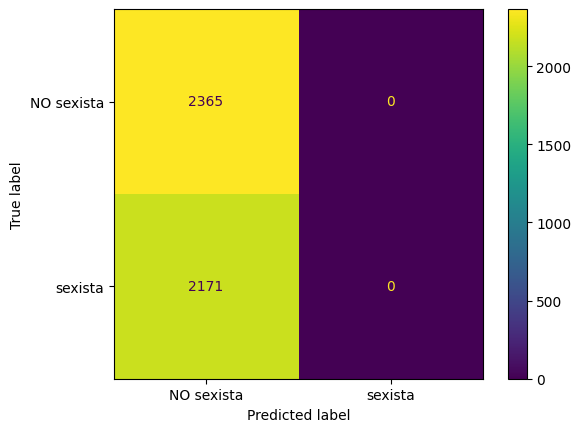

In [ ]:
categories = ["NO sexista", "sexista"]
y_test = df_sexista_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_sexista_full["label"]), display_labels = categories)

### Para Odio RELATION

In [ ]:
#df ODIO REL
df = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df = df.drop(columns=["user_id", "subforum_id", "num_contexts"])
df = df.drop((df[df["label"] == 2]).index)
df['label'].replace(3, 1, inplace = True) #Le decimos al sistema que trate la etiqueta Relation como Hate

#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority

# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_sexism = df[df['label'] == 1]
augmented_texts = []

for text in df_sexism['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_odio_relation = pd.concat([df, df_augmented])


#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_odio_relation = preprocess_text(df_odio_relation)
# Función para hacer stemming y lematización
df_odio_relation['Lematizado_Stemming'] = df_odio_relation['text'].apply(stem_and_lemmatize)

tagged_documents = create_doc2vec_documents(df_odio_relation)
df_odio_relation.insert(len(df_odio_relation.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_odio_relation["doc_key"] = df_odio_relation.index.astype(str)
df_odio_relation.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,march th booklet downloaded times counting,0,march th booklet download time count,"([march, th, booklet, downloaded, times, count...",0
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...,"([order, help, increase, booklets, downloads, ...",1
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...,"([simply, copy, paste, following, text, youtub...",2
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...,"([click, free, download, colorfully, illustrat...",3
4,click download mb green banner link,0,click download mb green banner link,"([click, download, mb, green, banner, link], [0])",4


In [ ]:
# Etiquetas
label_names = {0: 'NO hate', 1: 'hate'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_odio_relation['label'].unique():
    keywords, num_keywords = get_keywords(df_odio_relation, label) #get_keywords(df_odio_relation, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)

In [ ]:
df_odio_relation = df_odio_relation.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)
df_odio_relation_train, df_odio_relation_test = train_test_split(df_odio_relation, test_size = 0.2, random_state = 123, stratify=df_odio_relation["label"])

df_odio_relation_train["data_set_type"] = "train"

df_odio_relation_test["data_set_type"] = "test"

# concatenamos
df_odio_relation_full = pd.concat([df_odio_relation_train,df_odio_relation_test]).reset_index(drop=True)
df_odio_relation_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,httpwwwvgnopubvgarthbs artid suspected warcrim...,0,httpwwwvgnopubvgarthb artid suspect warcrim se...,"([httpwwwvgnopubvgarthbs, artid, suspected, wa...",1410,NO hate,10580,train
1,surprisingly one said anything,0,surprisingli one said anyth,"([surprisingly, one, said, anything], [0])",8254,NO hate,10580,train
2,hiring someone website ensure practise n hire ...,1,hire someon websit ensur practis n hire undesir,"([hiring, someone, website, ensure, practise, ...",374,hate,7097,train
3,looking day realized kids probably get go get ...,0,look day realiz kid probabl get go get check e...,"([looking, day, realized, kids, probably, get,...",3299,NO hate,10580,train
4,matter greater extent disgusting white adult f...,1,matter greater extent disgust white adult fema...,"([matter, greater, extent, disgusting, white, ...",2486,hate,7097,train


In [ ]:
start_time = time.time()

lbl2vec_model_odio_relation = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_odio_relation_full['tagged_documents'][df_odio_relation_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.9, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_odio_relation.fit()
# test
new_docs_lbl_similarities_odio_relation = lbl2vec_model_odio_relation.predict_new_docs(tagged_docs = df_odio_relation_full['tagged_documents'][df_odio_relation_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-13 17:12:46,261 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:12:46,261 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:12:46,261 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:12:46,261 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:12:46,261 - Lbl2Vec - INFO - Train document and word embeddings
INFO:Lbl2Vec:Train document and word embeddings
2024-06-13 17:12:56,056 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:12:56,056 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:12:56,056 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:12:56,056 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:12:56,056 - Lbl2Vec - INFO - Train label embeddings
INFO:Lbl2Vec:Train label embeddings
2024-06-13 17:12:56,328 - Lbl2Vec - WARNING - The following keywords from the 'keywords_list' are unknown to the Doc2Vec model and therefore not used to train the model: peopl youtub mani tri anyo

Tiempo de ejecución: 18.843857288360596 segundos


In [ ]:
df_pred = new_docs_lbl_similarities_odio_relation.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO hate":0, "hate":1}, inplace = True)
df_pred["label"].value_counts()

label
0    3539
Name: count, dtype: int64

Se etiquetaron correctamente 1902 de un total de 3539 muestras.
Errores
MAE: 0.463
MSE: 0.68


              precision    recall  f1-score   support

           0       0.54      1.00      0.70      1902
           1       0.00      0.00      0.00      1637

    accuracy                           0.54      3539
   macro avg       0.27      0.50      0.35      3539
weighted avg       0.29      0.54      0.38      3539



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


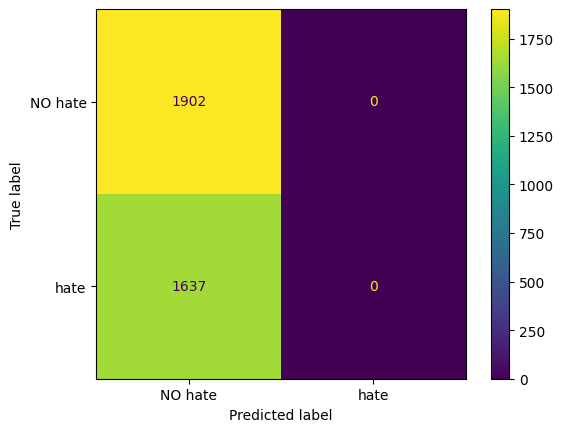

In [ ]:
categories = ["NO hate", "hate"]
y_test = df_odio_relation_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_odio_relation["label"]), display_labels = categories)

### Para ODIO SIN RELATION

In [ ]:
#Pasamos las func en df_sexist
df = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_odio.csv")
df = df.drop(columns=["user_id", "subforum_id", "num_contexts"])
df = df.drop((df[df["label"] == 2]).index)
df = df.drop((df[df["label"] >= 2]).index)

#Data Augmentation
# Calculamos el número de augmentaciones necesarias
num_majority = df['label'].value_counts()[0]
num_minority = df['label'].value_counts()[1]
num_augmentations = num_majority - num_minority

# Usamos nlpaug para hacer data augmentation en la columna 'text'
aug = naw.SynonymAug(aug_src='wordnet')

def augment_text(text, augmenter, n_augmentations=1):
    augmented_texts = [augmenter.augment(text) for _ in range(n_augmentations)]
    return augmented_texts

# Aplicamos augmentación a los textos etiquetados como 'Hate'
df_sexism = df[df['label'] == 1]
augmented_texts = []

for text in df_sexism['text']:
    augmented_texts.extend(augment_text(text, aug, n_augmentations=int(num_augmentations/num_minority)))

# Creamos un DataFrame con los textos aumentados
df_augmented = pd.DataFrame(augmented_texts, columns=['text'])
df_augmented['label'] = 1

# Concatenar los textos aumentados con el dataset original
df_odio_NOrelation = pd.concat([df, df_augmented])


#limpiamos texto para cubrirnos en salud y aplicamos lematizado y stemming
df_odio_NOrelation = preprocess_text(df_odio_NOrelation)
# Función para hacer stemming y lematización
df_odio_NOrelation['Lematizado_Stemming'] = df_odio_NOrelation['text'].apply(stem_and_lemmatize)

#Pasamos las func en
tagged_documents = create_doc2vec_documents(df_odio_NOrelation)
df_odio_NOrelation.insert(len(df_odio_NOrelation.columns),"tagged_documents", tagged_documents)
# add doc_key column
df_odio_NOrelation["doc_key"] = df_odio_NOrelation.index.astype(str)
df_odio_NOrelation.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key
0,march th booklet downloaded times counting,0,march th booklet download time count,"([march, th, booklet, downloaded, times, count...",0
1,order help increase booklets downloads would g...,0,order help increas booklet download would grea...,"([order, help, increase, booklets, downloads, ...",1
2,simply copy paste following text youtube video...,0,simpli copi past follow text youtub video desc...,"([simply, copy, paste, following, text, youtub...",2
3,click free download colorfully illustrated pag...,1,click free download color illustr page ebook z...,"([click, free, download, colorfully, illustrat...",3
4,click download mb green banner link,0,click download mb green banner link,"([click, download, mb, green, banner, link], [0])",4


In [ ]:
##doc2vec_model
# Definir y entrenar el modelo Doc2Vec
model_odio_rel = Doc2Vec(vector_size = 100,
                window = 5,
                min_count = 100,
                workers = 4,
                epochs = 20)
model_odio_rel.build_vocab(tagged_documents)
model_odio_rel.train(tagged_documents, total_examples=model_odio_rel.corpus_count, epochs=model_odio_rel.epochs)

# Guardar el modelo entrenado
model_odio_rel.save("Doc2Vec_ODIO_NOREL")

# Cargar el modelo (si es necesario)
model_odio_rel = Doc2Vec.load("Doc2Vec_ODIO_NOREL")

In [ ]:
# Etiquetas
label_names = {0: 'NO hate', 1: 'hate'}

# Función para obtener las palabras clave
def get_keywords(df, label):
    texts = df[df['label'] == label]['Lematizado_Stemming']
    all_words = ' '.join(texts).split()   # Concatenar todos los textos y separar las palabras
    freq_dist = FreqDist(all_words) # Calcular la distribución de frecuencia de las palabras
    common_words = freq_dist.most_common() #freq_dist.most_common(n) get_keywords(df, label, n)
    keywords = [word for word, _ in common_words]
    return keywords, len(keywords)


# Crear el DataFrame final
label_data = []
for label in df_odio_NOrelation['label'].unique():
    keywords, num_keywords = get_keywords(df_odio_NOrelation, label) #get_keywords(df_odio_relation, label,n)
    label_data.append({
        'label': label,
        'label_name': label_names[label],
        'keywords': keywords,
        'number_of_keywords': num_keywords
    })

df_labels = pd.DataFrame(label_data)
df_labels

,label,label_name,keywords,number_of_keywords
0,0,NO hate,"[white, like, nt, peopl, get, one, youtub, wou...",10580
1,1,hate,"[white, black, n, inform, technolog, like, get...",7129


In [ ]:
df_odio_NOrelation = df_odio_NOrelation.merge(df_labels, left_on="label", right_on="label", how="left").drop(['keywords'], axis=1)

In [ ]:
df_odio_NOrelation_train, df_odio_NOrelation_test = train_test_split(df_odio_NOrelation, test_size = 0.2, random_state = 123, stratify=df_odio_NOrelation["label"])

df_odio_NOrelation_train["data_set_type"] = "train"

df_odio_NOrelation_test["data_set_type"] = "test"

# concatenamos
df_odio_NOrelation_full = pd.concat([df_odio_NOrelation_train,df_odio_NOrelation_test]).reset_index(drop=True)
df_odio_NOrelation_full.head()

,text,label,Lematizado_Stemming,tagged_documents,doc_key,label_name,number_of_keywords,data_set_type
0,hell cares kosher,1,hell care kosher,"([hell, cares, kosher], [1])",195,hate,7129,train
1,dont really blacks schools round,0,dont realli black school round,"([dont, really, blacks, schools, round], [0])",6605,NO hate,10580,train
2,like always said say till dying day beyond,0,like alway said say till die day beyond,"([like, always, said, say, till, dying, day, b...",6977,NO hate,10580,train
3,yeah possibly jewish warm old money impression...,1,yeah possibl jewish warm old money impress pre...,"([yeah, possibly, jewish, warm, old, money, im...",3800,hate,7129,train
4,always considered teaching one professions one...,1,alway consid teach one profess one would like ...,"([always, considered, teaching, one, professio...",13,hate,7129,train


In [ ]:
df_odio_NOrelation_full['label'][df_odio_NOrelation_full['data_set_type']=='train'].value_counts()

label
0    7605
1    6698
Name: count, dtype: int64

In [ ]:
start_time = time.time()

lbl2vec_model_odio_NOrelation = Lbl2Vec(keywords_list = list(df_labels["keywords"]),
                          tagged_documents = df_odio_NOrelation_full['tagged_documents'][df_odio_NOrelation_full['data_set_type']=='train'],
                         label_names = list(df_labels["label_name"]),
                         similarity_threshold = 0.5, #0.001, 0.01, 0.1, 0.5, 0.9
                         epochs = 10
                         )
# train model
lbl2vec_model_odio_NOrelation.fit()
# test
new_docs_lbl_similarities_odio_NOrelation = lbl2vec_model_odio_NOrelation.predict_new_docs(tagged_docs = df_odio_NOrelation_full['tagged_documents'][df_odio_NOrelation_full['data_set_type']=='test'])
end_time = time.time()
print(f"Tiempo de ejecución: {end_time - start_time} segundos")

2024-06-13 17:01:20,942 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:01:20,942 - Lbl2Vec - INFO - Train document and word embeddings
2024-06-13 17:01:20,942 - Lbl2Vec - INFO - Train document and word embeddings
INFO:Lbl2Vec:Train document and word embeddings
2024-06-13 17:01:33,641 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:01:33,641 - Lbl2Vec - INFO - Train label embeddings
2024-06-13 17:01:33,641 - Lbl2Vec - INFO - Train label embeddings
INFO:Lbl2Vec:Train label embeddings
2024-06-13 17:01:33,972 - Lbl2Vec - WARNING - The following keywords from the 'keywords_list' are unknown to the Doc2Vec model and therefore not used to train the model: peopl youtub mani tri anyon countri everi friend alway eye realli someth someon anyth mayb littl happen ye actual http anoth noth famili plea citi pictur hous stori welcom gun differ interest brother sinc el believ togeth pretti commun colleg seem polic student member idea messag report parent cultur mix chang be

Tiempo de ejecución: 19.97380495071411 segundos


In [ ]:
#new_docs_lbl_similarities_odio_relation.head()
new_docs_lbl_similarities_odio_relation.value_counts("most_similar_label")
#new_docs_lbl_similarities_odio_relation.info()

most_similar_label
NO hate    2175
Name: count, dtype: int64

In [ ]:
df_pred = new_docs_lbl_similarities_odio_NOrelation.copy(deep = True)
df_pred.rename(columns = {"most_similar_label":"label"}, inplace = True)
df_pred["label"].replace({"NO hate":0, "hate":1}, inplace = True)
df_pred["label"].value_counts()

label
0    3576
Name: count, dtype: int64

In [ ]:
def evaluate_model(y_test, y_pred, labels, display_labels):
    # Reset indices to ensure alignment
    y_test = y_test.reset_index(drop = True)
    y_pred = y_pred.reset_index(drop = True)

    correct_labels = sum(y_test == y_pred)
    print("Se etiquetaron correctamente %d de un total de %d muestras." % (correct_labels, y_test.size))
    # Imprimir MAE y RMSE
    print("Errores")
    print(f"MAE: {np.round(mean_absolute_error(y_test, y_pred), 3)}")
    print(f"MSE: {np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3)}")
    print("\n")

    # Imprimir el reporte de clasificación
    print(classification_report(y_test, y_pred))

    # Mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred, labels=labels)
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels).plot()
    plt.show()

In [ ]:
df_odio_NOrelation_test["label"].shape

(2141,)

Se etiquetaron correctamente 1902 de un total de 3576 muestras.
Errores
MAE: 0.468
MSE: 0.684


              precision    recall  f1-score   support

           0       0.53      1.00      0.69      1902
           1       0.00      0.00      0.00      1674

    accuracy                           0.53      3576
   macro avg       0.27      0.50      0.35      3576
weighted avg       0.28      0.53      0.37      3576



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


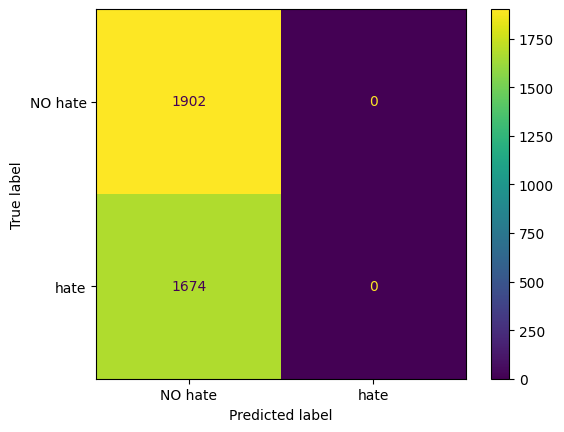

In [ ]:
categories = ["NO hate", "hate"]
y_test = df_odio_NOrelation_test["label"].astype(int)
y_pred_test = df_pred["label"].astype(int)

evaluate_model(y_test, y_pred_test, labels= np.unique(df_odio_NOrelation["label"]), display_labels = categories)

# Reduccion de Dimensiones

* **Análisis de normalización y reducción de dimensionalidad**

 Se procederá a extraer los valores de varianza explicada y coherencia semántica para cada proceso de normalización, evaluando diferentes números de componentes. Adicionalmente, se realizará un análisis gráfico con dos componentes para ilustrar los resultados.

 Cabe destacar que, debido a la ausencia del método `get_feature_names_out` en la clase `HashingVectorizer`, no es posible utilizar este vectorizador específico para evaluar la cohesión del texto. Sin embargo, se emplearán métodos alternativos para este propósito en un análisis posterior.

* **Análisis de varianza explicada**

 La varianza explicada es un indicador de la capacidad del espacio LSA para representar la información contenida en los datos. Un valor alto de varianza explicada denota que el espacio LSA captura adecuadamente la información relevante, mientras que un valor bajo sugiere que el espacio no es efectivo para representar la información.

* **Análisis de coherencia semántica**
 La coherencia semántica evalúa si las palabras que se encuentran cercanas en el espacio LSA también están relacionadas semánticamente. Un valor alto de coherencia semántica indica que las palabras cercanas en el espacio LSA también tienen un significado similar, mientras que un valor bajo sugiere que las palabras cercanas no están relacionadas semánticamente.

* **Análisis gráfico**
 Se realizará un análisis gráfico con dos componentes para visualizar la distribución de las palabras en el espacio LSA. Este análisis permitirá observar el comportamiento de las componentes generadas por LSA y obtener una mejor comprensión de la estructura de los datos.

In [ ]:
def calculate_coherences(df, n_components):
    """
    Función para calcular la coherencia de los tópicos generados por LSA para diferentes vectorizadores.

    Parámetros:
        - df: DataFrame que contiene el texto a analizar.
        - n_components: Número de componentes a generar con LSA.

    Devuelve:
        - Un diccionario que contiene las coherencias para cada vectorizador.
    """
    # Crear vectorizadores
    vectorizers = {
        'TFIDF': TfidfVectorizer(max_df=0.3, min_df=8, stop_words="english", lowercase=True, use_idf=True, norm="l2", smooth_idf=True),
        'CVec': CountVectorizer(strip_accents="ascii", lowercase=True, stop_words="english", max_df=0.3)
    }

    no_top_words = 10 #int(np.floor(np.sqrt(len(df)))) #288
    coherences = {}

    # Aplicar LSA y calcular coherencia para cada vectorizador
    for name, vectorizer in vectorizers.items():
        # Ajustar el vectorizador
        text_norm = vectorizer.fit_transform(df['Lematizado_Stemming'])

        # Aplicar LSA
        lsa = TruncatedSVD(n_components=n_components)
        lsa_matrix = lsa.fit_transform(text_norm)

        # Obtener las palabras más importantes de cada tópico
        topics = []
        for topic_idx, topic in enumerate(lsa.components_):
            top_words = [vectorizer.get_feature_names_out()[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
            topics.append(top_words)

        # Calcular la coherencia
        coherence_model = CoherenceModel(topics=topics, texts=df['Lematizado_Stemming'].apply(word_tokenize).tolist(), dictionary=Dictionary(df['Lematizado_Stemming'].apply(word_tokenize)), coherence='c_v')
        coherences[name] = coherence_model.get_coherence()

    return coherences

In [ ]:
def calculate_explained_variances(df, n_components):
    """
    Función para calcular la varianza explicada por los componentes generados por LSA para diferentes vectorizadores.

    Parámetros:
        - df: DataFrame que contiene el texto a analizar.
        - n_components: Número de componentes a generar con LSA.

    Devuelve:
        - Un diccionario que contiene la varianza explicada para cada vectorizador.
    """
    # Crear vectorizadores
    vectorizers = {
        'TFIDF': TfidfVectorizer(max_df=0.3,
                                 min_df=8,
                                 stop_words="english",
                                 lowercase=True,
                                 use_idf=True,
                                 norm="l2",
                                 smooth_idf=True
                                 ),

        'CVec': CountVectorizer(strip_accents = "ascii",
                                lowercase = True,
                                stop_words = "english",
                                 max_df = 0.3),

        'Hashing': HashingVectorizer(lowercase = True,
                                     stop_words = "english",
                                     norm = "l2"
                                     )
    }

    explained_variances = {}

    # Aplicar LSA y calcular varianza para cada vectorizador
    for name, vectorizer in vectorizers.items():
        # Ajustar el vectorizador
        text_norm = vectorizer.fit_transform(df)

        # Aplicar LSA
        lsa = TruncatedSVD(n_components=n_components)
        lsa_matrix = lsa.fit_transform(text_norm)

        # Calcular la varianza explicada
        explained_variance = lsa.explained_variance_ratio_.sum()
        explained_variances[name] = explained_variance

    return explained_variances

In [ ]:
def calculate_lda_metrics(df, n_components):
    """
    Función para calcular la coherencia y log-verosimilitud de los tópicos generados por LDA para diferentes vectorizadores.

    Parámetros:
        - df: DataFrame que contiene el texto a analizar.
        - n_components: Número de componentes a generar con LDA.

    Devuelve:
        - Un diccionario que contiene las coherencias y log-verosimilitud para cada vectorizador.
    """
    vectorizers = {
        'TFIDF': TfidfVectorizer(max_df = 0.3,
                                 min_df = 8,
                                 stop_words = "english",
                                 lowercase = True,
                                 use_idf = True,
                                 norm = "l2",
                                 smooth_idf = True),
        'CVec': CountVectorizer(strip_accents = "ascii",
                                lowercase = True,
                                stop_words = "english",
                                max_df = 0.3)
    }

    no_top_words = 10
    metrics = {}

    for name, vectorizer in vectorizers.items():
        text_norm = vectorizer.fit_transform(df['Lematizado_Stemming'])
        lda = LatentDirichletAllocation(n_components=n_components, random_state=42)
        lda_matrix = lda.fit_transform(text_norm)

        topics = []
        for topic_idx, topic in enumerate(lda.components_):
            top_words = [vectorizer.get_feature_names_out()[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
            topics.append(top_words)

        coherence_model = CoherenceModel(topics=topics, texts=df['Lematizado_Stemming'].apply(word_tokenize).tolist(), dictionary=Dictionary(df['Lematizado_Stemming'].apply(word_tokenize)), coherence='c_v')
        coherence = coherence_model.get_coherence()

        log_likelihood = lda.score(text_norm)

        metrics[name] = {'Coherence': coherence, 'Log Likelihood': log_likelihood}

    return metrics

## Para SPAM

### Latent Semantic Sanalysis (LSA)

Al tratar con conjuntos de datos de alta dimensionalidad, el proceso de graficado y procesado se vuelve más exigente y requiere mayor tiempo de procesamiento.


¿Cuá debería ser el tamaño del corpus de jugueta según el tamñao del corpus original? No existe una regla fija y universalmente aplicable para determinar el tamaño óptimo de un corpus de juguete, ya que esto depende del contexto específico del análisis y los objetivos del estudio.

Sin embargo, se pude utilizar la clase `train_test_split`, la cual contiene un parametro llamado `stratify` que segura la división mantenga la proporción de etiquetas en ambos conjuntos, evitando que queden únicamente datos de una sola etiqueta en un conjunto `lsa_A` o `lsa_B`.

Se utilizara el `test_size` del corpus original.


In [ ]:
df_spam = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_spam.csv")

In [ ]:
# Realizar la división manteniendo la proporción de etiquetas
lsa_A, lsa_B = train_test_split(df_spam,
                               test_size = 0.2,
                               stratify = df_spam["label"],
                               random_state = 123)

# Verificar la proporción de etiquetas después de la división
print("Proporcion Dataframe de Juguete de SPAM")
print("- Tamaño del Corpus Original en LSA ",df_spam.shape[0])
print("- Tamaño del Corpus de Juguete: ",lsa_B.shape[0])

Proporcion Dataframe de Juguete de SPAM
- Tamaño del Corpus Original en LSA  83448
- Tamaño del Corpus de Juguete:  16690


In [ ]:
#Componentes
n = 2

# coherencias
coherences = calculate_coherences(df_spam, n_components = n)
# varianza
explained_variances = calculate_explained_variances(df_spam["Lematizado_Stemming"], n_components = n)


# Imprimir las coherencias
for name, coherence in coherences.items():
    print(f'Coherencia de los Componentes con {name}: {coherence}')

print("\n")

# Imprimir las varianzas explicadas
for name, var in explained_variances.items():
    print(f'Varianza Explicada de los Componentes con {name}: {var}')

Coherencia de los Componentes con TFIDF: 0.4161011073045945
Coherencia de los Componentes con CVec: 0.4558354451669041


Varianza Explicada de los Componentes con TFIDF: 0.19606687473648804
Varianza Explicada de los Componentes con CVec: 0.8747186698330321
Varianza Explicada de los Componentes con Hashing: 0.3605660862063028


**Cohesión**

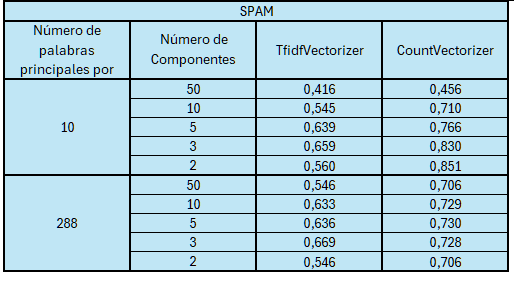

Los resultados muestran que el método de normalización CountVectorizer obtiene mejores valores de coherencia en general. Esto se debe a que este método no tiene en cuenta la frecuencia de las palabras en el corpus, lo que permite que las palabras menos comunes tengan un mayor impacto en la representación semántica de los documentos.

En cuanto al número de componentes, los resultados muestran que el mejor número de componentes varía según el método de normalización. Para el método TfidfVectorizer, el mejor número de componentes es de 50, mientras que para el método CountVectorizer, el mejor número de componentes es de 3.

Según los resultados de estas pruebas, se recomienda utilizar el método CountVectorizer y un número de componentes de 3 para el análisis de un corpus de clasificación de SPAM en SMSs.

Es mejor utilizar 10 palabras principales por componente para un análisis LDA. Esto se debe a que el método CountVectorizer con 10 palabras principales por componente obtiene el valor de coherencia más alto (0,729).

**Varianza Explicada (VE)**

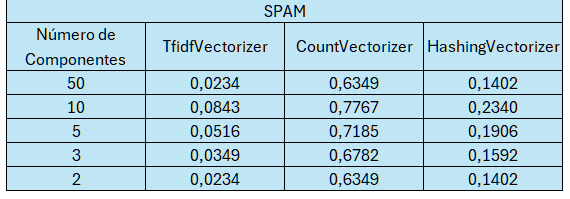

En general, los valores de VE son más altos para los métodos de normalización TfidfVectorizer y CountVectorizer que para HashingVectorizer. Esto sugiere que los primeros métodos son más efectivos para representar la información relevante en el texto para el proceso de LSA.

Los valores de VE tienden a aumentar a medida que se reduce el número de componentes LSA. Esto indica que los primeros componentes capturan la información más importante en el texto, mientras que los componentes posteriores representan información más específica o menos relevante.

Los resultados de este análisis sugieren que los métodos de normalización TfidfVectorizer y CountVectorizer son más adecuados para el proceso de LSA en el corpus de clasificación de SPAM. Además, se observa que un número menor de componentes LSA (por ejemplo, 2 o 3) puede ser suficiente para capturar la información relevante en el texto para esta tarea.

**Análsis por metodos graficos**

In [ ]:
# DataFrame para visualizar las componentes
# aplicar LSA para reducir la dimensionalidad (reducir a 2 dimensiones)

df_spam = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_spam.csv")

text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_spam["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_spam["Lematizado_Stemming"])

X = text_norm_VecTFIDF #text_norm_CountVec #text_norm_CountVec #text_norm_CountVec, text_norm_HashingVec

n_components = 2
lsa = TruncatedSVD(n_components = n_components)
lsa_matrix = lsa.fit_transform(X)

lsa_df = pd.DataFrame(lsa_matrix,
                      columns = [f"Componente {i+1}" for i in range(n_components)])
lsa_df.insert(0, "SMS", [f"SMS {i+1}" for i in range(lsa_df.shape[0])])
lsa_df.insert(1, "text", df_spam["text"])
lsa_df.insert(4, "label", df_spam["label"])
print(f" LSA en {n_components} Componentes")
print(f" Tamaño LSA en {n_components} Componentes", lsa_df.shape)
lsa_df.head()

 LSA en 2 Componentes
 Tamaño LSA en 2 Componentes (83448, 5)


,SMS,text,Componente 1,Componente 2,label
0,SMS 1,ounce feather bowl hummingbird opec moment ala...,0.002706,-0.000367,1
1,SMS 2,wulvob get medircations online qnb ikud viagra...,0.058266,-0.004566,1
2,SMS 3,computer connection cnn com wednesday escapenu...,0.212617,0.039533,0
3,SMS 4,university degree obtain prosperous future mon...,0.087803,-0.006617,1
4,SMS 5,thanks answers guys know checked rsync manual ...,0.112888,0.066800,0


Al tratar con conjuntos de datos de alta dimensionalidad, el proceso de graficado y procesado se vuelve más exigente y requiere mayor tiempo de procesamiento.

Por tanto, en nuestro primer acercamiento al analsis gráfico del metodo, se dividira `lsa_df`. Para esto, se utilizará la clase `train_test_split`, la cual contiene un parametro llamado `stratify` que segura la división mantenga la proporción de etiquetas en ambos conjuntos, evitando que queden únicamente datos de una sola etiqueta en un conjunto `lsa_A` o `lsa_B`.

¿Cuá debería ser su tamaño según el tamaño del corpus?

Esta recomendación se basa en la regla general que sugiere generar alrededor de la raíz cuadrada del tamaño del corpus original.

[Chapter 3. N-gram Language Models. Speech and Language Processing. Daniel Jurafsky & James H. Martin.](
https://web.stanford.edu/~jurafsky/slp3/3.pdf)

In [ ]:
# Realizar la división manteniendo la proporción de etiquetas
lsa_A, lsa_B = train_test_split(lsa_df,
                               test_size = int(np.floor(np.sqrt(len(lsa_df)))),
                               stratify = lsa_df["label"],
                               random_state = 123)

# Verificar la proporción de etiquetas después de la división
print("Proporcion etiquetas Corpus generado en LSA ")
print("- Tamaño del Corpus generado en LSA ",lsa_df.shape[0])

print("Proporcion etiquetas Corpus generado en LSA ")
print("- Tamaño Caracteristicas de X_B: ",lsa_B.shape[0])

Proporcion etiquetas Corpus generado en LSA 
- Tamaño del Corpus generado en LSA  83448
Proporcion etiquetas Corpus generado en LSA 
- Tamaño Caracteristicas de X_B:  288


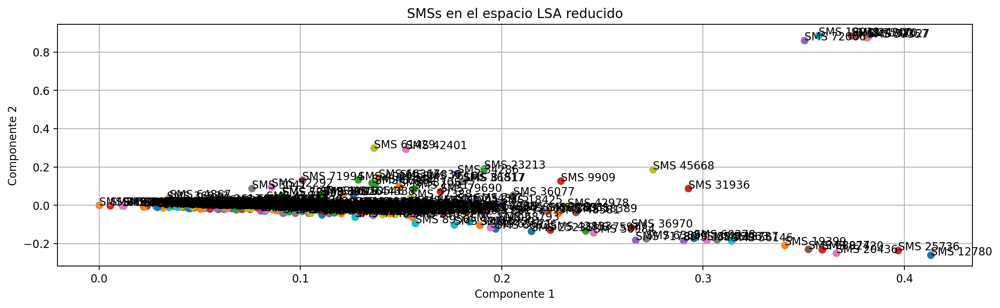

In [ ]:
# graficar los dos componentes obtenidos anteriormente
plt.figure(figsize=(15, 4), dpi=200)

# Iterar sobre las filas del DataFrame
for index, row in lsa_B.iterrows():
    plt.scatter(row["Componente 1"], row["Componente 2"])
    plt.text(row["Componente 1"], row["Componente 2"], str(row["SMS"]))

plt.xlabel("Componente 1")
plt.grid(True, which="both")
plt.ylabel("Componente 2")
plt.title('SMSs en el espacio LSA reducido')
plt.show()

* **Resultado con `TfidfVectorizer`**






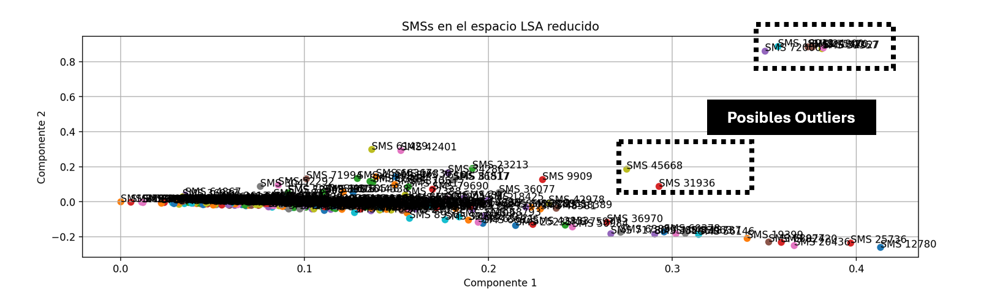

* **Resultado con `CountVectorizer`**

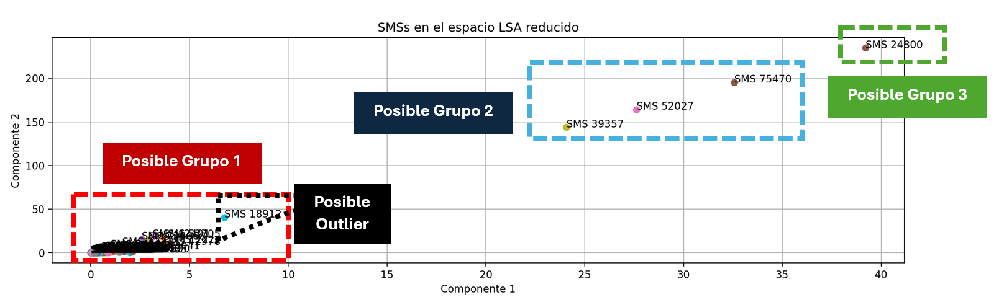

In [ ]:
print("Para posible Agrupacion 1")
condicion = (lsa_B["Componente 1"] < 10) & (lsa_B["Componente 2"] < 50) & (lsa_B["SMS"] != "SMS 18912")
lsa_B[condicion].head()

                 Para posible Agrupacion 1


,SMS,text,Componente 1,Componente 2,label
80027,SMS 80028,stinson looks like split costs class george co...,0.091495,0.098010,0
43393,SMS 43394,agree eol group responsible point clicking eol...,0.271230,0.299946,0
23212,SMS 23213,internet patrol internet safety windows update...,1.591622,8.848129,0
72904,SMS 72905,please see attach http ptn heropopotamus com k...,0.001912,0.017192,1
64866,SMS 64867,http tubethis hk escapenumberd like present sp...,0.487143,2.933331,1


In [ ]:
condicion = (lsa_B["Componente 1"] < 10) & (lsa_B["Componente 2"] < 50) & (lsa_B["SMS"] != "SMS 18912")
texto = lsa_B["text"][condicion]

print("Cantidad de valores: ", lsa_B["text"][condicion].shape[0])
print("Cantidad por etiquetas Tipo SPAM:", lsa_B["label"][condicion & (lsa_B["label"] == 1)].count())
print("Ejemplo: \n" , texto.iloc[5])

print("Cantidad por etiquetas Tipo NO SPAM:", lsa_B["label"][condicion & (lsa_B["label"] == 0)].count())
print("Ejemplo: \n" , texto.iloc[36])

Cantidad de valores:  283
Cantidad por etiquetas Tipo SPAM: 147
Ejemplo: 
 virility patch rx penis enlargement product enhance penis length escapenumber girth without damagining health feel free turn new page life order
Cantidad por etiquetas Tipo NO SPAM: 136
Ejemplo: 
 escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd escapenumberd cbs news coverage breaking space news last updated escapenumber escapenumber escapenumber escapenumber escapenumber times eastern william harwood cbs news space consultant changes additions escapenumber escapenumber escapenumber escapenumber escapenumber p station c

In [ ]:
print("Para Posible Agrupacion 2:")
lsa_B["label"][(lsa_B["Componente 1"] < 20) & (lsa_B["Componente 2"] < 100) & (lsa_B["SMS"] != "SMS 24800")].value_counts()

Para pposible Agrupacion 2:


label
1    148
0    136
Name: count, dtype: int64

In [ ]:
print("Para pposible Agrupacion 3:")
lsa_B[(lsa_B["SMS"] == "SMS 24800")]

Para pposible Agrupacion 3:


,SMS,text,Componente 1,Componente 2,label
24799,SMS 24800,may high expectations associates also give hig...,39.210483,234.70765,1


Resultado con `HashingVectorizer`

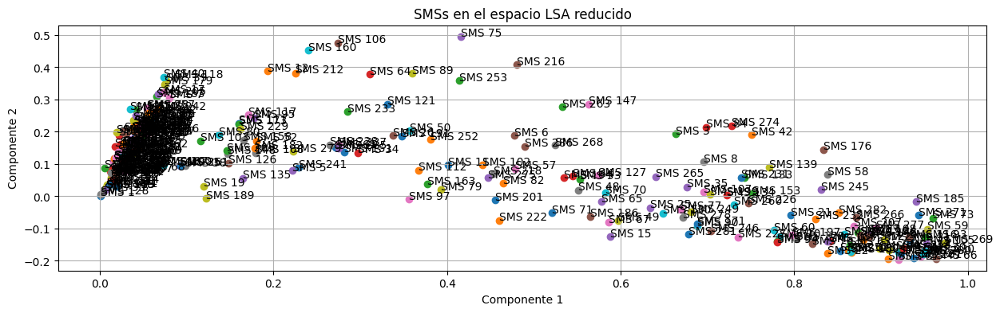

### Latent Dirichlet Allocation (LDA)

Para este análsiis de reduccion de dimensiones no seutilizara `HashingVectorizer`, pues este no mantiene un diccionario de palabras, lo que significa que no se puede mapear fácilmente las características generadas de vuelta a las palabras originales. Esto es crucial para LDA, ya que la interpretabilidad de los tópicos es una parte esencial del análisis.

La varianza explicada, tal como se entiende en métodos lineales como la PCA (Análisis de Componentes Principales) o LSA (Análisis Semántico Latente), no se calcula de la misma manera para LDA. En lugar de varianza explicada, el enfoque en LDA es evaluar la calidad y la coherencia de los tópicos. Por esto ultimo se tiene la funcion `calculate_lda_metrics`.

Los resultados para LSA indicaron que seria mejor continuar con 10 números de palabras principales por tópico y el vectorizador `CountVectorizer`. Sin embargo, se adjuntaran los resultados para estas metrícas.

In [ ]:
n = 2

metrics = calculate_lda_metrics(df_spam, n_components = n)

for name, metric in metrics.items():
    print(f'{name} - Coherencia: {metric["Coherence"]}, Log Verosimilitud: {metric["Log Likelihood"]}')

TFIDF - Coherencia: 0.6556253909925442, Log Verosimilitud: -4680574.330774512
CVec - Coherencia: 0.35118233134828813, Log Verosimilitud: -100208680.44587275


In [ ]:
def calculate_lda_coherences(df, n_components):
    """
    Función para calcular la coherencia de los tópicos generados por LDA para diferentes vectorizadores.

    Parámetros:
        - df: DataFrame que contiene el texto a analizar.
        - n_components: Número de componentes a generar con LDA.

    Devuelve:
        - Un diccionario que contiene las coherencias para cada vectorizador.
    """
    # Crear vectorizadores
    vectorizers = {
        'TFIDF': TfidfVectorizer(max_df=0.3, min_df=8, stop_words="english", lowercase=True, use_idf=True, norm="l2", smooth_idf=True),
        'CVec': CountVectorizer(strip_accents="ascii", lowercase=True, stop_words="english", max_df=0.3)
    }

    no_top_words = 10
    coherences = {}

    # Aplicar LDA y calcular coherencia para cada vectorizador
    for name, vectorizer in vectorizers.items():
        # Ajustar el vectorizador
        text_norm = vectorizer.fit_transform(df['Lematizado_Stemming'])

        # Aplicar LDA
        lda = LatentDirichletAllocation(n_components=n_components, random_state=42)
        lda_matrix = lda.fit_transform(text_norm)

        # Obtener las palabras más importantes de cada tópico
        topics = []
        for topic_idx, topic in enumerate(lda.components_):
            top_words = [vectorizer.get_feature_names_out()[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
            topics.append(top_words)

        # Calcular la coherencia
        coherence_model = CoherenceModel(topics=topics, texts=df['Lematizado_Stemming'].apply(word_tokenize).tolist(), dictionary=Dictionary(df['Lematizado_Stemming'].apply(word_tokenize)), coherence='c_v')
        coherences[name] = coherence_model.get_coherence()

    return coherences

In [ ]:
# Ejemplo de uso de la función

coherences = calculate_lda_coherences(df_spam, n_components=5)

# Imprimir las coherencias
for name, coherence in coherences.items():
    print(f'Coherencia de los Componentes con {name}: {coherence}')

In [ ]:
n_topics = 2
lda = LatentDirichletAllocation(n_components = n_topics,
                                learning_method="online",
                                random_state = 123)
lda_matrix = lda.fit_transform(X)
lda_matrix

array([[0.81961075, 0.18038925],
       [0.85062762, 0.14937238],
       [0.44592913, 0.55407087],
       ...,
       [0.52491007, 0.47508993],
       [0.98953311, 0.01046689],
       [0.25013541, 0.74986459]])

has no se puede realizar porque genero datos negatios que la matrz no los acpepta

In [ ]:
df_spam['Lematizado_Stemming'].tolist()

['ounc feather bowl hummingbird opec moment alabast valkyri dyad bread flack desper iambic hadron heft quell yoghurt bunkmat divert afterimag',
 'wulvob get medirc onlin qnb ikud viagra escapenumb escapenumb levitra escapenumb escapenumb ciali escapenumb escapenumb imitrex escapenumb escapenumb flonax escapenumb escapenumb ultram escapenumb escapenumb vioxx escapenumb escapenumb ambien escapenumb escapenumb valium escapenumb escapenumb xannax escapenumb escapenumb soma escapenumb meridia escapenumb escapenumb escapenumb escapenumb cysfrt ever stop wonder much averag man pay mediecin ap painkil drug improv qualiti life weight reduc tablet mani escapenumb what wors mediucin cost lot brand rfwur intrest http dmvrwm remunerativ net dfuaeirxygiq visit websit escapenumb',
 'comput connect cnn com wednesday escapenumb may escapenumb escapenumb escapenumb escapenumb pm edt report next gener toy read brain wave googl expand person youtub win webbi old fashion rabbit ear laptop review next gener

In [ ]:
import ast

In [ ]:
df_spam["Lematizado_Stemming_Tokenized"] = df_spam["Lematizado_Stemming"].apply(word_tokenize)
#df_spam["Lematizado_Stemming_Tokenized"] = df_spam['Lematizado_Stemming'].apply(ast.literal_eval)
# Obtener las listas de palabras
texts = df_spam["Lematizado_Stemming_Tokenized"].tolist()
dictionary = Dictionary(texts)
corpus = [dictionary.doc2bow(text) for text in texts]

SyntaxError: invalid syntax (<unknown>, line 1)

In [ ]:
texts = df_spam["Lematizado_Stemming_Tokenized"].tolist()

In [ ]:
dictionary = Dictionary(texts)

In [ ]:
corpus = [dictionary.doc2bow(text) for text in texts]

In [ ]:
num_topics = 2
LDA_GENSIM = gensim.models.ldamodel.LdaModel(corpus,
                                            num_topics=num_topics,
                                            id2word=dictionary,
                                            passes=15,
                                            random_state=42)

# Paso 5: Cálculo de la coherencia del modelo
coherence_model_lda = CoherenceModel(model=LDA_GENSIM, texts=texts, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print(f'Coherencia del modelo LDA con GENSIM: {coherence_lda}')

Coherencia del modelo LDA con GENSIM: 0.4323302024670538


In [ ]:
texts = df_spam["Lematizado_Stemming"].str.split().tolist()
texts = df_spam['Lematizado_Stemming'].apply(eval).tolist()
dictionary = Dictionary(texts)
corpus = [dictionary.doc2bow(text) for text in texts]

num_topics = 2
LDA_GENSIM = gensim.models.ldamodel.LdaModel(corpus,
                                            num_topics=num_topics,
                                            id2word=dictionary,
                                            passes=15,
                                            random_state=42)

# Paso 5: Cálculo de la coherencia del modelo
coherence_model_lda = CoherenceModel(model=LDA_GENSIM, texts=texts, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print(f'Coherencia del modelo LDA con GENSIM: {coherence_lda}')

# Opcional: Graficar la coherencia para diferentes números de tópicos
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus, num_topics=num_topics, id2word=dictionary, passes=15, random_state=42)
        model_list.append(model)
        coherence_model = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherence_model.get_coherence())
    return model_list, coherence_values

model_list, coherence_values = compute_coherence_values(dictionary=dictionary, corpus=corpus, texts=texts, start=2, limit=20, step=2)

# Graficar la coherencia
x = range(2, 20, 2)
plt.plot(x, coherence_values)
plt.xlabel("Número de Tópicos")
plt.ylabel("Coherencia")
plt.legend(("coherencia"), loc='best')
plt.show()

SyntaxError: invalid syntax (<string>, line 1)

In [ ]:
print("Tamaño del corpus Original:", df_spam.shape[0])
print("Tamaño del corpus Vectorizado:", X.shape[0])
print("Tamaño del corpus despues de un proceso LDA:", lda_matrix.shape)

Tamaño del corpus Original: 83417
Tamaño del corpus Vectorizado: 83417
Tamaño del corpus despues de un proceso LDA: (83417, 2)


El resultado de `lda_matrix` es  una matriz donde cada fila representa un mensaje del corpus vectorizado y cada columna representa la probabilidad de que ese mensaje pertenezca a uno de los dos tópicos generados por el modelo LDA.

La matriz `lda_matrix` guarda en sus posiciones los pesos para cada tópico o, en nuestro caso, etiqueta. Aquí, ya que n_topics es igual al número de etiquetas, se obtuvo que `lda_matrix[:,0] = Spam` y `lda_matrix[:,1] = No Spam`.

Cada fila de la matriz de temas corresponde a una etiqueta y cada columna corresponde a una palabra. El valor en la celda (i, j) de la matriz representa la probabilidad de que la palabra j aparezca en la etiqueta i.

In [ ]:
# DataFrame para visualizar los Tópics
lda_df = pd.DataFrame(lda_matrix,
                      columns = [f"Pesos Tópic {i+1}" for i in range(n_topics)])
lda_df.insert(0, "SMS", [f"SMS {i+1}" for i in range(lda_df.shape[0])])
lda_df.insert(1, "text", df_spam["text"])
print(f" LDA en {n_topics} Tópics")
print(f" Tamaño LDA en {n_topics} Tópics", lda_df.shape[0])
lda_df.head()

 LDA en 2 Tópics
 Tamaño LDA en 2 Tópics 83448


,SMS,text,Pesos Tópic 1,Pesos Tópic 2
0,SMS 1,ounce feather bowl hummingbird opec moment ala...,0.819611,0.180389
1,SMS 2,wulvob get medircations online qnb ikud viagra...,0.850628,0.149372
2,SMS 3,computer connection cnn com wednesday escapenu...,0.445929,0.554071
3,SMS 4,university degree obtain prosperous future mon...,0.209508,0.790492
4,SMS 5,thanks answers guys know checked rsync manual ...,0.215655,0.784345


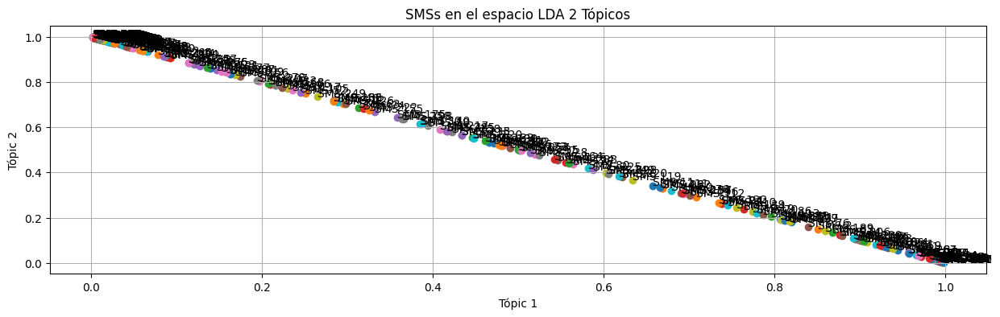

In [ ]:
n = range(int(np.floor(np.sqrt(len(lda_df))))) #FULL range(len(lsa_df))
plt.figure(figsize=(15, 4))
for i in n:
    plt.scatter(lda_df.loc[i, "Pesos Tópic 1"], lda_df.loc[i, "Pesos Tópic 2"])
    plt.text(lda_df.loc[i, "Pesos Tópic 1"], lda_df.loc[i, "Pesos Tópic 2"], lda_df.loc[i, "SMS"])

plt.xlabel("Tópic 1")
plt.grid(True, which = "both")
plt.ylabel("Tópic 2")
plt.title('SMSs en el espacio LDA 2 Tópicos')
plt.show()

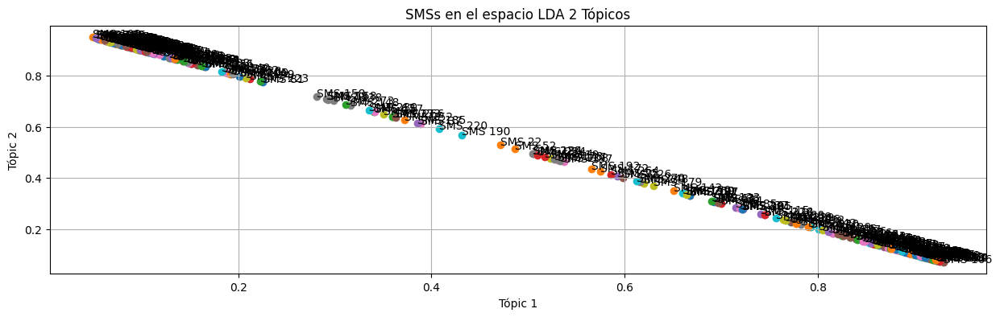

El primer tópico (etiquetado en la gráfica como "Tópic 1") es el más probable que sea spam. Esto significa que los documentos que tienen una puntuación alta en este tópico tienen más probabilidades de ser mensajes de spam. El segundo tópico (etiquetado en la gráfica como "Tópic 2") es el menos probable que sea spam. Esto significa que los documentos que tienen una puntuación alta en este tópico tienen menos probabilidades de ser mensajes de spam. Se debe resalatar que esta es solo para los primeros 288 mensajes.

vector count

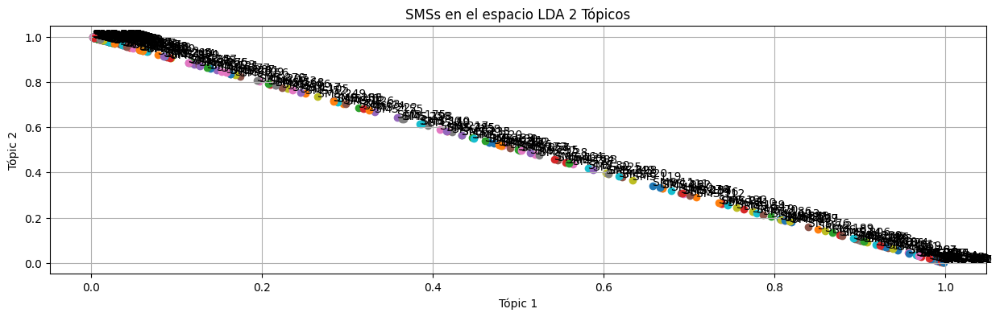

Observemos cómo se comporta este sí en lugar de 2 topics se piden tres.

In [ ]:
n_topics = 3
lda = LatentDirichletAllocation(n_components = n_topics,
                                learning_method="online",
                                random_state = 123)
lda_matrix = lda.fit_transform(X)
lda_matrix

array([[0.67462586, 0.06841421, 0.25695994],
       [0.05091394, 0.05058206, 0.898504  ],
       [0.06129366, 0.15811319, 0.78059315],
       ...,
       [0.05453468, 0.05400492, 0.8914604 ],
       [0.06517773, 0.06916609, 0.86565618],
       [0.08298434, 0.08739904, 0.82961661]])

Nuestro corpus esta organizado en solo dos tópicos o etiquetas, pero como se le está pidiendo al modelo LDA que identifique tres tópicos `(n_components = 3)`, el modelo tratará de ajustar tres tópicos a los datos. Esto significa que el modelo intenta encontrar tres agrupaciones distintas de palabras y documentos.


En este caso, es posible que el modelo LDA identifique dos tópicos que corresponden a los temas presentes en el corpus y un tercer tópico que puede no tener una interpretación clara o significativa en términos del contenido real de los documentos. Este tercer tópico podría ser una combinación de palabras que no representan un tema coherente, o podría estar asociado con la variabilidad dentro de los documentos que no se puede atribuir a los dos tópicos principales

In [ ]:
# DataFrame para visualizar las componentes
lda_df = pd.DataFrame(lda_matrix,
                      columns = [f"Label  {i+1}" for i in range(n_components)])
lda_df.insert(0, "SMS", [f"SMS {i+1}" for i in range(lda_df.shape[0])])
lda_df.insert(1, "text", df_spam["text"])
print(f" LDA  en {n_components} Componentes")
print(f" Tamaño LDA en {n_components} Componentes", lda_df.shape)
lda_df.head()

In [ ]:
n = range(int(np.floor(np.sqrt(len(lda_df))))) #FULL range(len(lsa_df))
plt.figure(figsize=(15, 4))
for i in n:
    plt.scatter(lda_df.loc[i, "Componente 1"], lda_df.loc[i, "Componente 2"])
    plt.text(lda_df.loc[i, "Componente 1"], lda_df.loc[i, "Componente 2"], lda_df.loc[i, "SMS"])

plt.xlabel("Componente 1")
plt.grid(True, which = "both")
plt.ylabel("Componente 2")
plt.title('SMSs en el espacio LDA reducido')
plt.show()

Para una comparación precisa entre LDA y LSA, retomemos la matriz temática y la proyectemos nuevamente en dos dimensiones.

In [ ]:
lda_matrix

array([[0.10655131, 0.89344869],
       [0.0785353 , 0.9214647 ],
       [0.19220751, 0.80779249],
       ...,
       [0.30471938, 0.69528062],
       [0.13179844, 0.86820156],
       [0.1460687 , 0.8539313 ]])

In [ ]:
tsne_lda_model = TSNE(n_components = 2,
                      perplexity = 30, #50
                      learning_rate=100,
                      n_iter=2000,
                      verbose=1,
                      random_state=123,
                      angle=0.75)
tsne_lda_vectors = tsne_lda_model.fit_transform(lda_matrix)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 83448 samples in 0.047s...
[t-SNE] Computed neighbors for 83448 samples in 1.409s...
[t-SNE] Computed conditional probabilities for sample 1000 / 83448
[t-SNE] Computed conditional probabilities for sample 2000 / 83448
[t-SNE] Computed conditional probabilities for sample 3000 / 83448
[t-SNE] Computed conditional probabilities for sample 4000 / 83448
[t-SNE] Computed conditional probabilities for sample 5000 / 83448
[t-SNE] Computed conditional probabilities for sample 6000 / 83448
[t-SNE] Computed conditional probabilities for sample 7000 / 83448
[t-SNE] Computed conditional probabilities for sample 8000 / 83448
[t-SNE] Computed conditional probabilities for sample 9000 / 83448
[t-SNE] Computed conditional probabilities for sample 10000 / 83448
[t-SNE] Computed conditional probabilities for sample 11000 / 83448
[t-SNE] Computed conditional probabilities for sample 12000 / 83448
[t-SNE] Computed conditional probabilities for sam

El algoritmo t-SNE no ha convergido a una representación ideal de los datos. Se observan dos problemas principales:

1. Separación de los puntos: Los puntos de datos están demasiado juntos en la representación de baja dimensión, lo que indica que la estructura original de los datos podría estar perdiéndose. Esto se refleja en un valor de sigma muy pequeño.

2. Alta divergencia KL: La divergencia de Kullback-Leibler (KL) es una medida de la diferencia entre la distribución de similitudes en los datos originales y la distribución de similitudes en la representación de baja dimensión. Un valor de KL alto (en este caso, 1.046528) indica que las dos distribuciones son muy diferentes, lo que sugiere que la representación actual no captura bien las relaciones entre los puntos de datos.

[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 103.006264
[t-SNE] KL divergence after 2000 iterations: 1.285504

In [ ]:
tsne_lda = pd.DataFrame(tsne_lda_vectors,
                      columns = [f"Componente {i+1}" for i in range(n_components)])
tsne_lda.insert(0, "SMS", [f"SMS {i+1}" for i in range(tsne_lda.shape[0])])
tsne_lda.insert(1, "text", df_spam["text"])
print(f" LDA en {n_components} Componentes")
print(f" Tamaño LDA despues de TSNE en {n_components} Componentes", tsne_lda.shape)
tsne_lda.head()

 LDA en 2 Componentes
 Tamaño LDA despues de TSNE en 2 Componentes (83448, 4)


,SMS,text,Componente 1,Componente 2
0,SMS 1,ounce feather bowl hummingbird opec moment ala...,48.648220,81.293205
1,SMS 2,wulvob get medircations online qnb ikud viagra...,72.957817,-42.530960
2,SMS 3,computer connection cnn com wednesday escapenu...,15.554461,-18.650040
3,SMS 4,university degree obtain prosperous future mon...,7.183479,100.334045
4,SMS 5,thanks answers guys know checked rsync manual ...,-4.543291,93.687614


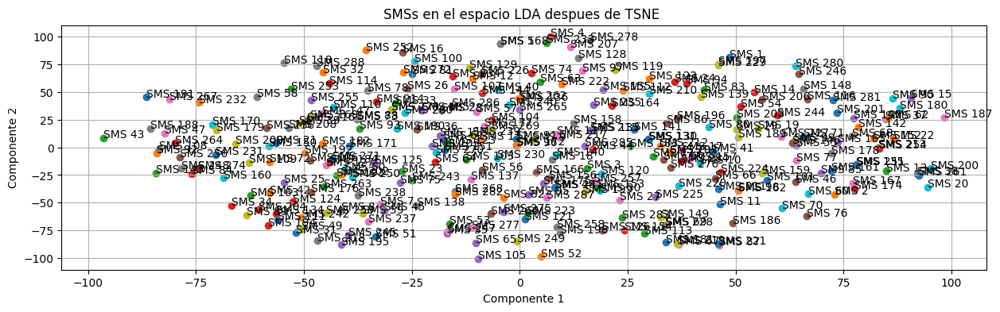

In [ ]:
n = range(int(np.floor(np.sqrt(len(tsne_lda))))) #FULL range(len(lsa_df))
plt.figure(figsize=(15, 4))
for i in n:
    plt.scatter(tsne_lda.loc[i, "Componente 1"], tsne_lda.loc[i, "Componente 2"])
    plt.text(tsne_lda.loc[i, "Componente 1"], tsne_lda.loc[i, "Componente 2"], tsne_lda.loc[i, "SMS"])

plt.xlabel("Componente 1")
plt.grid(True, which = "both")
plt.ylabel("Componente 2")
plt.title('SMSs en el espacio LDA despues de TSNE ')
plt.show()

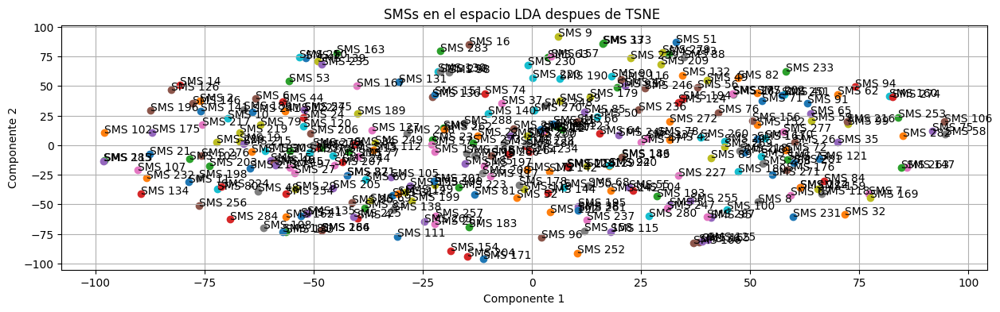

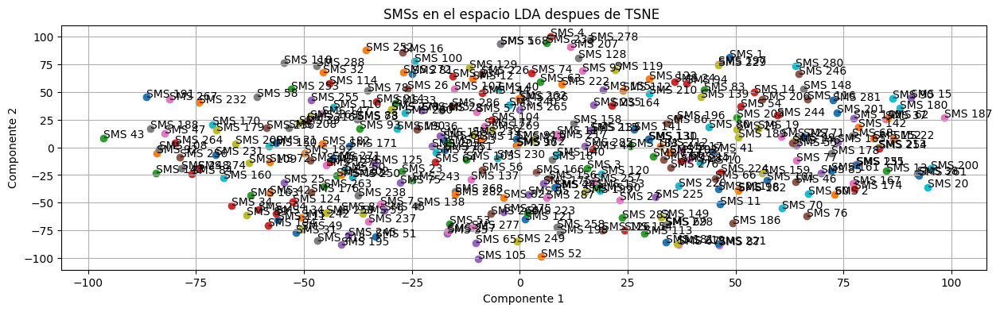

## Para SEXISM

In [ ]:
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_sexista.csv")
df_sexista = df_sexista.rename(columns = {"sexist":"label"})

### Latent Semantic Analysis (LSA)

In [ ]:
#Componentes
n = 10

# coherencias
coherences = calculate_coherences(df_sexista, n_components = n)
# varianza
explained_variances = calculate_explained_variances(df_sexista["Lematizado_Stemming"], n_components = n)


# Imprimir las coherencias
for name, coherence in coherences.items():
    print(f'Coherencia de los Componentes con {name}: {coherence}')

print("\n")

# Imprimir las varianzas explicadas
for name, var in explained_variances.items():
    print(f'Varianza Explicada de los Componentes con {name}: {var}')

Coherencia de los Componentes con TFIDF: 0.3739895043768614
Coherencia de los Componentes con CVec: 0.3956229856522189


Varianza Explicada de los Componentes con TFIDF: 0.07533559302588573
Varianza Explicada de los Componentes con CVec: 0.1327193247788942
Varianza Explicada de los Componentes con Hashing: 0.18886198730890152


**Varianza Explicada (VE)**

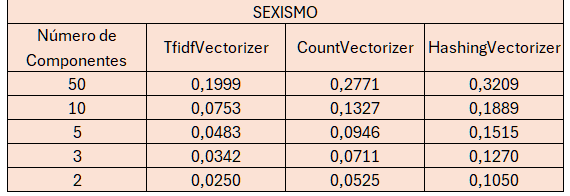

Los resultados indican que el `TfidfVectorizer` alcanza los valores de Varianza Explicada (VE) más altos en todos los números de componentes, excepto cuando se utilizan 50 componentes, caso en el cual el `CountVectorizer` logra el valor más elevado. Esto sugiere que el `TfidfVectorizer` es el método de normalización más efectivo para captar la información relevante en el texto durante el proceso de LSA en este corpus.

Por otro lado, los resultados muestran que el `HashingVectorizer` obtiene los valores de VE más bajos para todos los números de componentes. Esto implica que el `HashingVectorizer` no es tan efectivo como el `TfidfVectorizer` o el `CountVectorizer` para representar la información relevante en el texto en el contexto del proceso de LSA en este corpus.

En resumen, este análisis sugiere que los métodos de normalización `TfidfVectorizer` y `CountVectorizer` son más adecuados para el proceso de LSA en el corpus de clasificación de sexismo en tweets. Además, se observa que un número menor de componentes LSA (por ejemplo, 2 o 3) puede ser suficiente para capturar la información relevante en el texto para esta tarea.

**Análsis por metodos graficos**

In [ ]:
text_norm_VecTFIDF = vectorizer_TFIDF.fit_transform(df_sexista["Lematizado_Stemming"])
text_norm_CountVec = vectorizer_CVec.fit_transform(df_sexista["Lematizado_Stemming"])
text_norm_HashingVec = vectorizer_Hashing.fit_transform(df_sexista["Lematizado_Stemming"])

X = text_norm_VecTFIDF #text_norm_CountVec #text_norm_CountVec #text_norm_CountVec, text_norm_HashingVec

n_components = 2
lsa = TruncatedSVD(n_components = n_components)
lsa_matrix = lsa.fit_transform(X)

lsa_df = pd.DataFrame(lsa_matrix,
                      columns = [f"Componente {i+1}" for i in range(n_components)])
lsa_df.insert(0, "Posts", [f"Post {i+1}" for i in range(lsa_df.shape[0])])
lsa_df.insert(1, "text", df_sexista["text"])
lsa_df.insert(4, "label", df_sexista["label"])
print(f" LSA en {n_components} Componentes")
print(f" Tamaño LSA en {n_components} Componentes", lsa_df.shape)
lsa_df.head()

In [ ]:
#graficar en 2D (solo voy a graficar 103 primeros v':)
n = range(int(np.floor(np.sqrt(len(lsa_df))))) #FULL range(len(lsa_df))
plt.figure(figsize=(15, 4))
for i in n:
    plt.scatter(lsa_df.loc[i, "Componente 1"], lsa_df.loc[i, "Componente 2"])
    plt.text(lsa_df.loc[i, "Componente 1"], lsa_df.loc[i, "Componente 2"], lsa_df.loc[i, "Post"])

plt.xlabel("Componente 1")
plt.grid(True, which = "both")
plt.ylabel("Componente 2")
plt.title('Posts en el espacio LSA reducido')
plt.show()

### Latent Dirichlet Allocation (LDA)

In [ ]:
df_sexista = pd.read_csv("/content/drive/MyDrive/NLP/Corpus/df_sexista.csv")
df_sexista = df_sexista.rename(columns = {"sexist":"label"})

In [ ]:
n_topics = 10
metrics = calculate_lda_metrics(df_sexista, n_components = n_topics)

for name, metric in metrics.items():
    print(f'{name} - Coherencia: {metric["Coherence"]}, Log Verosimilitud: {metric["Log Likelihood"]}')

In [ ]:
# DataFrame para visualizar los Tópics
lda = LatentDirichletAllocation(n_components = n_topics,
                                learning_method="online",
                                random_state = 123)
lda_matrix = lda.fit_transform(X)
lda_df = pd.DataFrame(lda_matrix,
                      columns = [f"Pesos Tópic {i+1}" for i in range(n_topics)])
lda_df.insert(0, "Posts", [f"Post {i+1}" for i in range(lda_df.shape[0])])
lda_df.insert(1, "text", df_sexista["text"])
print(f" LDA en {n_topics} Tópics")
print(f" Tamaño LDA en {n_topics} Tópics", lda_df.shape[0])
lda_df.head()

In [ ]:
tsne_lda_model = TSNE(n_components = 2,
                      perplexity = 30, #50
                      learning_rate=100,
                      n_iter=2000,
                      verbose=1,
                      random_state=123,
                      angle=0.75)
tsne_lda_vectors = tsne_lda_model.fit_transform(lda_matrix)

## Para ODIO: `df_odio_NOrelation`

### Latent Semantic Sanalysis (LSA)

In [ ]:
#Componentes
n = 5

# coherencias
coherences = calculate_coherences(df_odio_NOrelation, n_components = n)
# varianza
explained_variances = calculate_explained_variances(df_odio_NOrelation["Lematizado_Stemming"], n_components = n)


# Imprimir las coherencias
for name, coherence in coherences.items():
    print(f'Coherencia de los Componentes con {name}: {coherence}')

print("\n")

# Imprimir las varianzas explicadas
for name, var in explained_variances.items():
    print(f'Varianza Explicada de los Componentes con {name}: {var}')

Coherencia de los Componentes con TFIDF: 0.334185424725476
Coherencia de los Componentes con CVec: 0.4259227422476818


Varianza Explicada de los Componentes con TFIDF: 0.032506070623757294
Varianza Explicada de los Componentes con CVec: 0.07160985465140701
Varianza Explicada de los Componentes con Hashing: 0.04892108944052867


### Latent Dirichlet Allocation (LDA)

## Para ODIO: `df_odio_relation`

### Latent Semantic Sanalysis (LSA)

In [ ]:
#Componentes
n = 2

# coherencias
coherences = calculate_coherences(df_odio_relation, n_components = n)
# varianza
explained_variances = calculate_explained_variances(df_odio_relation["Lematizado_Stemming"], n_components = n)


# Imprimir las coherencias
for name, coherence in coherences.items():
    print(f'Coherencia de los Componentes con {name}: {coherence}')

print("\n")

# Imprimir las varianzas explicadas
for name, var in explained_variances.items():
    print(f'Varianza Explicada de los Componentes con {name}: {var}')

Coherencia de los Componentes con TFIDF: 0.343575485299491
Coherencia de los Componentes con CVec: 0.4340746031632535


Varianza Explicada de los Componentes con TFIDF: 0.013334321786429508
Varianza Explicada de los Componentes con CVec: 0.034927666148147817
Varianza Explicada de los Componentes con Hashing: 0.02541548130038107


### Latent Dirichlet Allocation (LDA)